In [46]:
import re
import os
import glob
import scipy
import matplotlib.pyplot as plt
import scipy.io.wavfile
import numpy as np
import matplotlib.cm as cm
from music21 import stream, note, midi, instrument, converter, chord
from music21.pitch import PitchException, AccidentalException
from music21.instrument import *
from music21.midi import MidiException
import time
import signal
import sys
import warnings

def gen_missing_spectrogram(source_file, dest_file, start_index, end_index):
    sample_rate, X = scipy.io.wavfile.read(source_file)
    fig = plt.figure()
    plt.specgram(X[:,0], Fs=sample_rate, xextent=(0,20),cmap=cm.get_cmap('jet'), NFFT=256)
    plt.axis(ymin=0, ymax=5000, xmin=0, xmax=20)
    plt.xticks(range(0,21))
    rectangle = plt.Rectangle((6, 0), 8, 5000, fc='#000080')
    plt.gca().add_patch(rectangle)
    plt.xlabel('Time')
    plt.ylabel('Frequency')
    plt.show()
    fig.savefig(dest_file)
    

def gen_filled_spectrogram(source_file, dest_file):
    sample_rate, X = scipy.io.wavfile.read(source_file)
    t = np.arange(0, 20, 2)
    fig = plt.figure()
    plt.specgram(X[:,0], Fs=sample_rate, xextent=(0,20),cmap=cm.get_cmap('jet'), NFFT=256)
    plt.axis(ymin=0, ymax=5000, xmin=0, xmax=20)
    plt.xticks(range(0,21))
    plt.xlabel('Time')
    plt.ylabel('Frequency')
    plt.show()
    fig.savefig(dest_file)
    
def convertToSpectrogram(note_lines, tag, dest_dir, notelength='eighth', output_instrument=Piano()):
    if not os.path.exists(dest_dir):
        os.makedirs(dest_dir)
    
    cnt = 1
    for line in note_lines:
        s1 = stream.Stream()
        s1.voices
        for token in line.split(' '):
            try:
                s1.append(note.Note(token, type=notelength))
            except (PitchException, AccidentalException):
                continue
        s1.insert(0, output_instrument)
        midiFile = dest_dir + tag + '-' + str(cnt) + '.mid'
        wavFile = dest_dir + tag + '-' + str(cnt) + '.wav'
        specFile = dest_dir + tag + '-' + str(cnt) + '.png'
        s1.write('midi', midiFile)
        print("Created midi file ", midiFile)
        os.system('C:/fluidsynth-1.1.10/usr/bin/fluidsynth -F ' + wavFile + ' my_sound_font.sf2 ' + midiFile)
        print("Created wav file ", wavFile)
        if tag == 'orig':
            gen_missing_spectrogram(wavFile, specFile, 6, 13)
        else:
            gen_filled_spectrogram(wavFile, specFile)
            
        cnt = cnt + 1
    
def createOrigAndTestPiece(tokenFile, testLogFile, origNoteFile, filledNoteFile):
    allLines = ""
    with open(tokenFile, 'r') as fp:
        content = fp.readline().strip()
        while content:
            if len(allLines) == 0:
                allLines = content
            else:
                allLines = allLines + " <eos> " + content
            content = fp.readline()

    i = 0
    j = 0
    pat1 = ""
    pat2 = ""
    pat1done = 0
    content = ""
    zeropattern = ""
    zerolen = 0
    origLines = []
    newLines = []
    with open(testLogFile, 'r') as fp:
        content = fp.readline()
        while content:
            pattern = " Sample " + str(i) + "."
            pattern1 = 'Samples'
            if re.match(pattern, content) or re.match(pattern1, content):
                if i > 0:
                    #search and replace
                    pat1 = pat1.strip()
                    pat2 = pat2.strip()
                    zeropattern = zeropattern.strip()
                    idx11 = allLines.find(pat1)
                    if idx11 >= 0:
                        idx1 = idx11 + len(pat1) + 1
                        idx2 = re.search(r"[A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7]", allLines[idx1:]).start()
                        idx3 = re.search(r"[A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7] [A-G][#-]?[0-7]", allLines[idx1:]).end()
                        idx4 = allLines[idx1 + idx3:].find(pat2)
                        if idx2 == 0 and idx4 >= 0:
                            print("Found: replacing " + str(idx1+idx2) + ":" + str(idx1+idx3) + ", "+ allLines[idx1+idx2:idx1+idx3] + " with " + zeropattern)
                            print("orig: " + allLines[idx11:idx1+idx3+1+len(pat2)] + ", new: " + allLines[idx11:idx1+idx2] + zeropattern + allLines[idx1+idx3:idx1+idx3+1+len(pat2)])
                            origLines.append(allLines[idx11:idx1+idx3+1+len(pat2)])
                            newLines.append(allLines[idx11:idx1+idx2] + zeropattern + allLines[idx1+idx3:idx1+idx3+1+len(pat2)])
                            allLines = allLines[0:idx1+idx2] + " " + zeropattern + " " + allLines[idx1+idx3:len(allLines)]
                        else:
                            print("Not found1: ", pat1, "|", pat2, "|", str(zerolen))
                    else:
                        print("Not found: ", pat1, "|", pat2, "|", str(zerolen))

                if len(content) > 20:
                    break
                j = i
                i = i + 1
                pat1 = ""
                pat2 = ""
                pat1done = 0
                zerolen = 0
                zeropattern = ""
            elif i > 0 and i <= 20:
                print(content)
                masked, note, p, logp = content.split()
                if masked == "[1]":
                    if pat1done == 0:
                        pat1 = pat1 + " " + note
                    else:
                        pat2 = pat2 + " " + note
                elif masked == "[0]":
                    zeropattern = zeropattern + " " + note
                    zerolen = zerolen + 1
                    if pat1done == 0:
                        pat1done = 1
            content = fp.readline()

    with open(origNoteFile, 'w') as fp:
        for origLine in origLines:
            fp.write(origLine + "\n")
        fp.close()
    
    with open(filledNoteFile, 'w') as fp:
        for newLine in newLines:
            fp.write(newLine + "\n")
        fp.close()


In [42]:
composers = ['bach','beethoven','brahms','haydn','handel','mozart','schubert']
#composers = ['vivaldi']
types = ['split','holdout']
for composer in composers:
    for typ in types:
        tokenFile = './train-test/' + composer + '_mono_' + typ + '.txt'
        testLogFile = './maskgan-result/test-' + composer + '-' + typ + '.txt'
        origNoteFile = './maskgan-result/' + typ + '/' + composer + '/mono_orig.txt'
        filledNoteFile = './maskgan-result/' + typ + '/' + composer + '/mono_filled.txt'
        if not os.path.exists(specDir):
            os.makedirs(specDir)
    
        createOrigAndTestPiece(tokenFile, testLogFile, origNoteFile, filledNoteFile)
        


  [1]  C#4                   0.151   0.000  

  [1]  F4                    0.359   0.000  

  [1]  G4                    0.594   0.000  

  [1]  F4                    0.688   0.000  

  [1]  D4                    0.731   0.000  

  [1]  E4                    0.519   0.000  

  [0]  B4                    0.183   4.885  

  [0]  G#4                   0.118   6.578  

  [0]  F4                    0.149   3.698  

  [0]  E4                    0.190   1.603  

  [0]  E4                    0.124   3.701  

  [0]  A3                    0.135   4.946  

  [0]  E4                    0.084   4.680  

  [0]  E5                    0.045   6.612  

  [1]  C#4                   0.125   0.000  

  [1]  G3                    0.179   0.000  

  [1]  F3                    0.121   0.000  

  [1]  E3                    0.122   0.000  

  [1]  D4                    0.124   0.000  

  [1]  A3                    0.114   0.000  

Found: replacing 2324:2348, C#4 E3 D4 E4 D4 F3 D3 E3 with B4 G#4 F4 E4 E4 A3 E4 

  [0]  B-4                   0.369   3.208  

  [0]  B-4                   0.301   2.465  

  [0]  B-6                   0.223   3.578  

  [0]  D5                    0.263   2.465  

  [0]  A4                    0.240   3.498  

  [0]  B-3                   0.165   2.479  

  [0]  F6                    0.160   2.976  

  [0]  B-4                   0.220   2.974  

  [1]  D5                    0.142   0.000  

  [1]  G5                    0.277   0.000  

  [1]  G4                    0.401   0.000  

  [1]  G4                    0.572   0.000  

  [1]  D5                    0.611   0.000  

  [1]  D5                    0.481   0.000  

Found: replacing 3176:3199, G5 D5 G4 D5 G4 D5 D4 D4 with B-4 B-4 B-6 D5 A4 B-3 F6 B-4
orig: D6 D4 A4 E4 D6 F#4 G5 D5 G4 D5 G4 D5 D4 D4 D5 G5 G4 G4 D5 D5, new: D6 D4 A4 E4 D6 F#4 B-4 B-4 B-6 D5 A4 B-3 F6 B-4 D5 G5 G4 G4 D5 D5
  [1]  D5                    0.078   0.000  

  [1]  D5                    0.112   0.000  

  [1]  B-4                   0.206   0.


  [0]  C3                    0.065   4.305  

  [0]  <eos>G#4              0.000   5.399  

  [0]  F#4                   0.000   5.419  

  [0]  <eos>D5               0.000   5.445  

  [0]  F6                    0.000   5.479  

  [0]  <eos>G4               0.000   3.858  

  [0]  <eos>E-3              0.000   4.591  

  [0]  B-4                   0.000   3.857  

  [1]  F4                    0.000   0.000  

  [1]  E-4                   0.000   0.000  

  [1]  D4                    0.000   0.000  

  [1]  C4                    0.000   0.000  

  [1]  B-3                   0.000   0.000  

  [1]  B-3                   0.001   0.000  

Found: replacing 8744:8772, G3 G#4 G#4 G#4 G#4 G4 F#4 G4 with C3 <eos>G#4 F#4 <eos>D5 F6 <eos>G4 <eos>E-3 B-4
orig: B-3 B-3 B-3 B-3 G3 A3 G3 G#4 G#4 G#4 G#4 G4 F#4 G4 F4 E-4 D4 C4 B-3 B-3, new: B-3 B-3 B-3 B-3 G3 A3 C3 <eos>G#4 F#4 <eos>D5 F6 <eos>G4 <eos>E-3 B-4 F4 E-4 D4 C4 B-3 B-3
  [1]  C5                    0.175   0.000  

  [1]  G#4              

read ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/mono_orig.txt
C#4 F4 G4 F4 D4 E4 C#4 E3 D4 E4 D4 F3 D3 E3 C#4 G3 F3 E3 D4 A3
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-1.wav


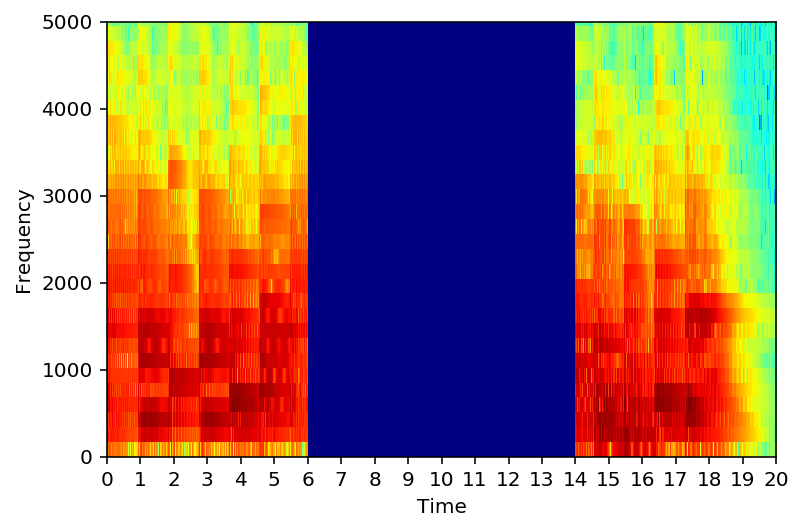

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-2.wav


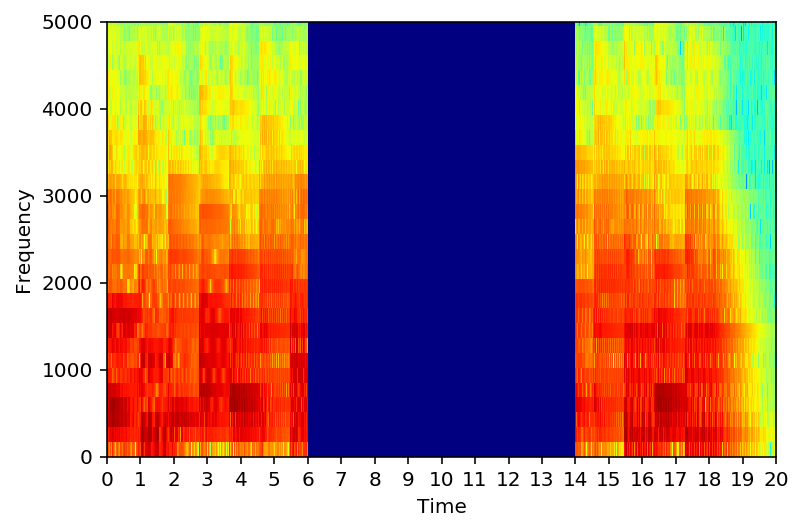

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-3.wav


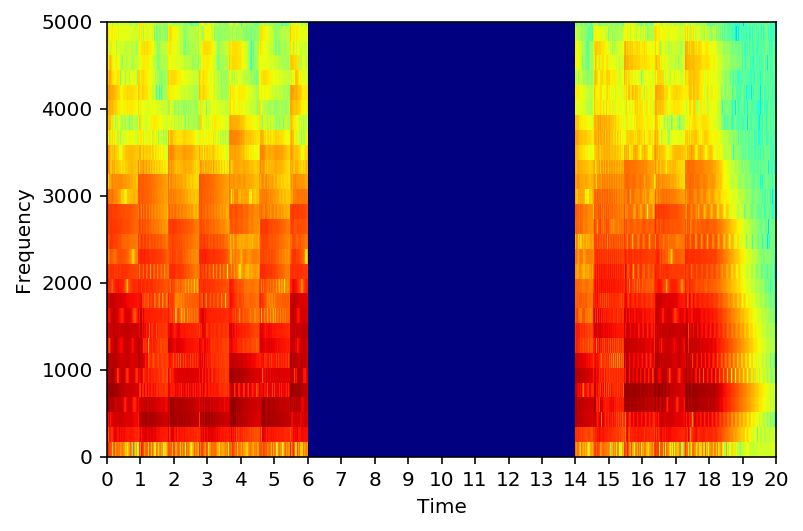

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-4.wav


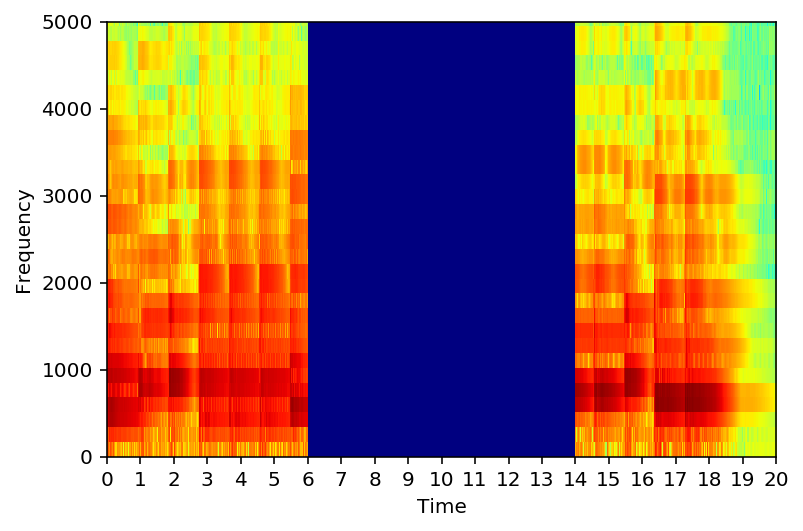

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-5.wav


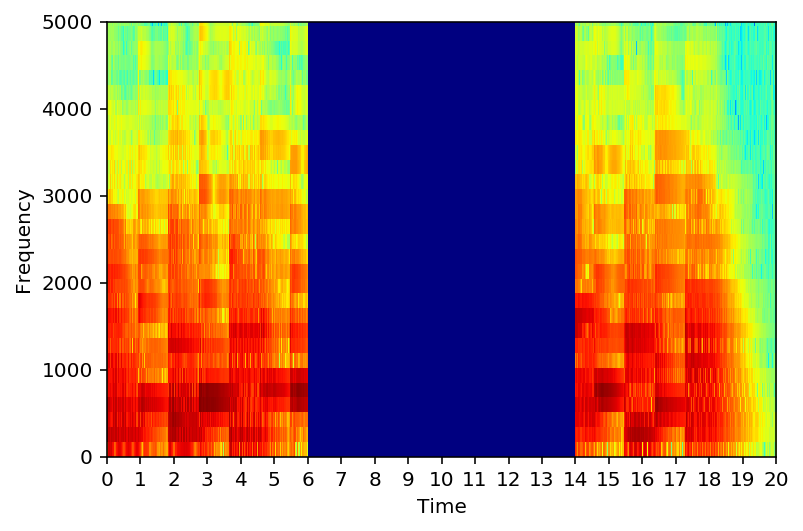

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-6.wav


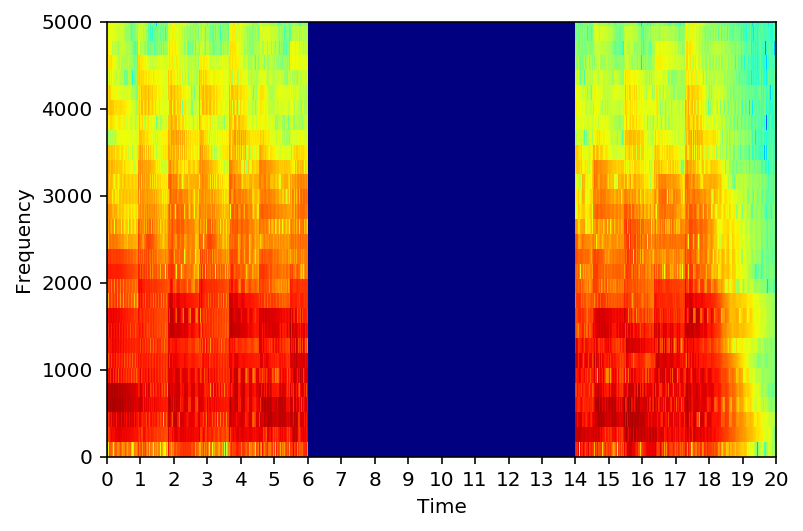

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-7.wav


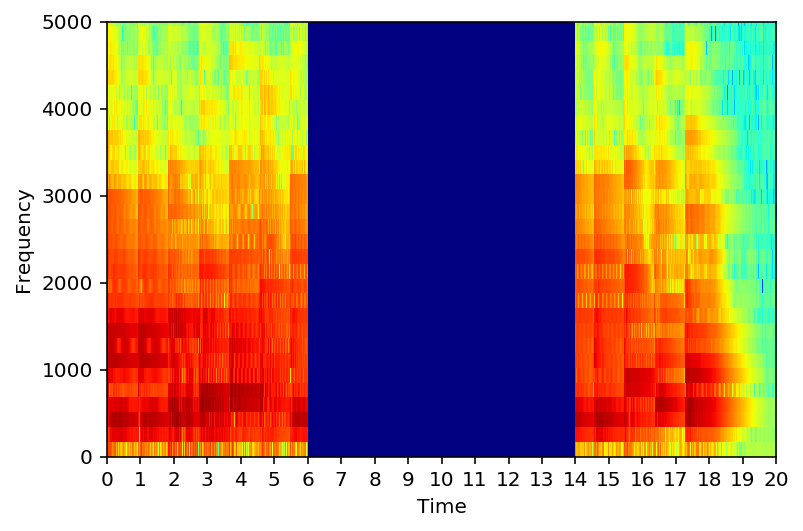

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-8.wav


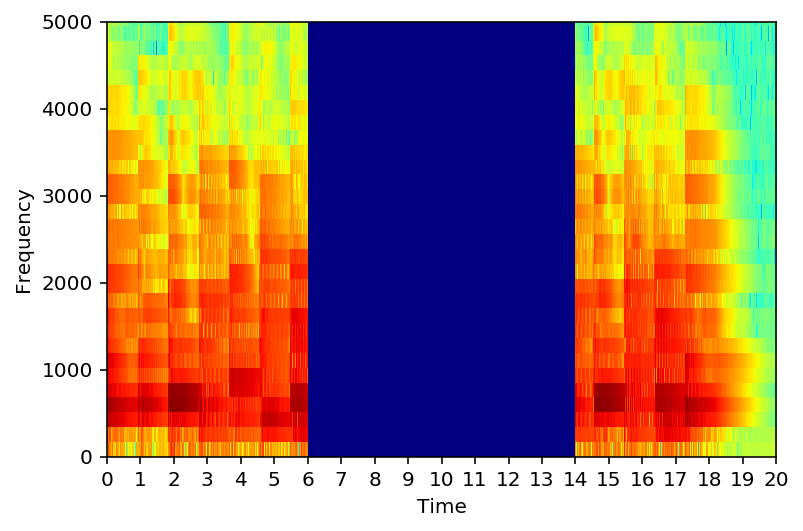

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-9.wav


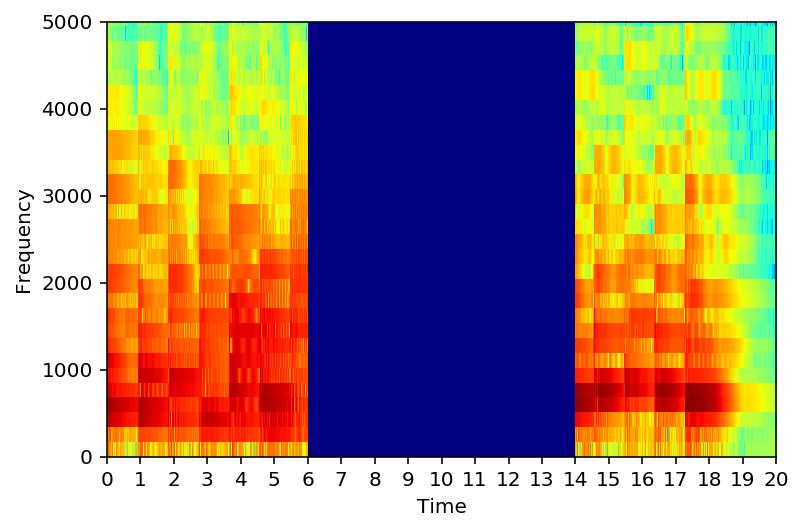

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-10.wav


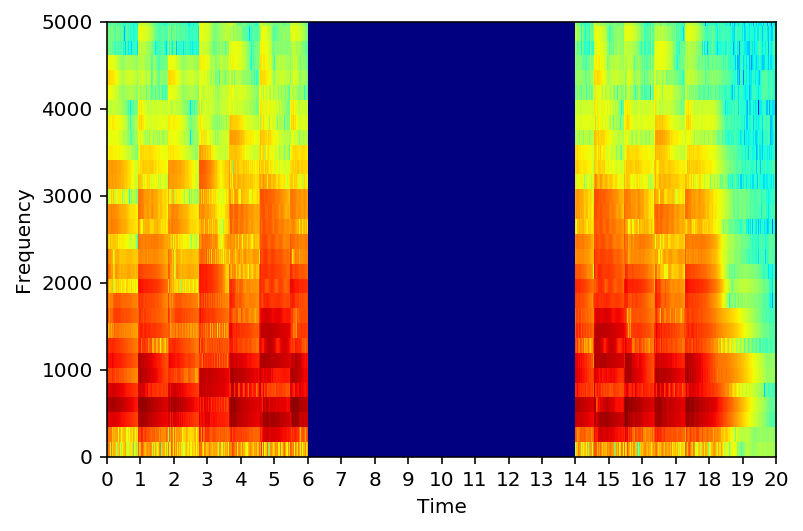

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-11.wav


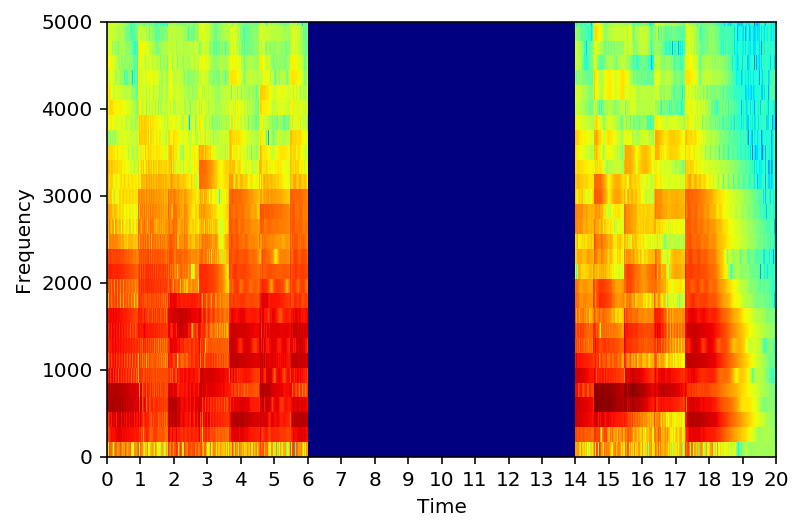

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-12.wav


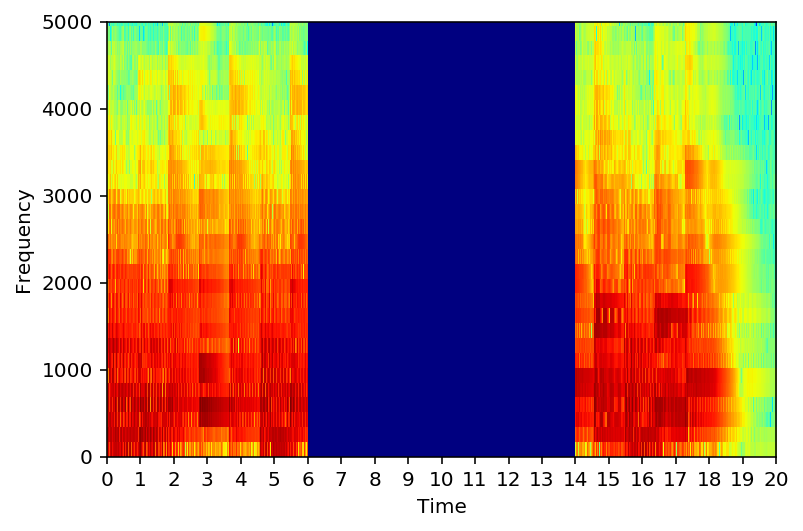

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-13.wav


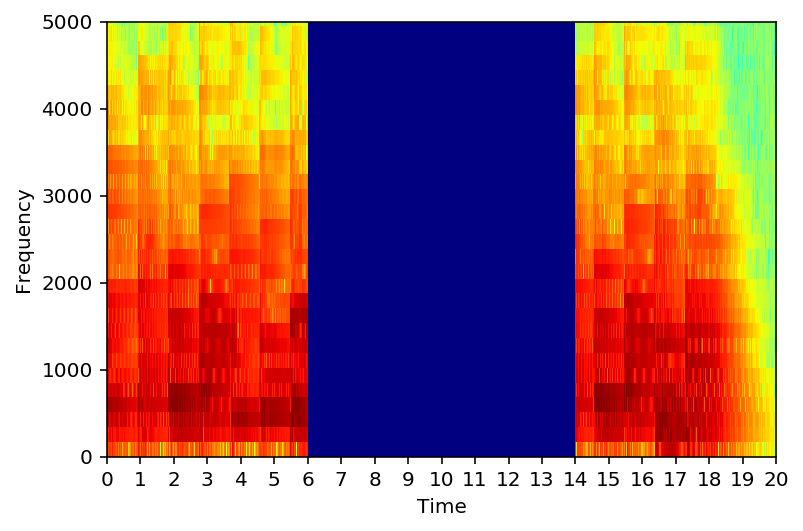

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-14.wav


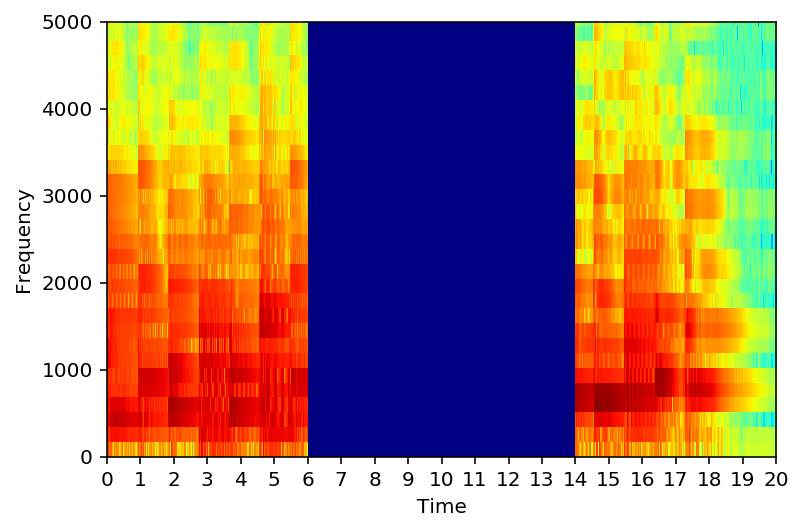

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-15.wav


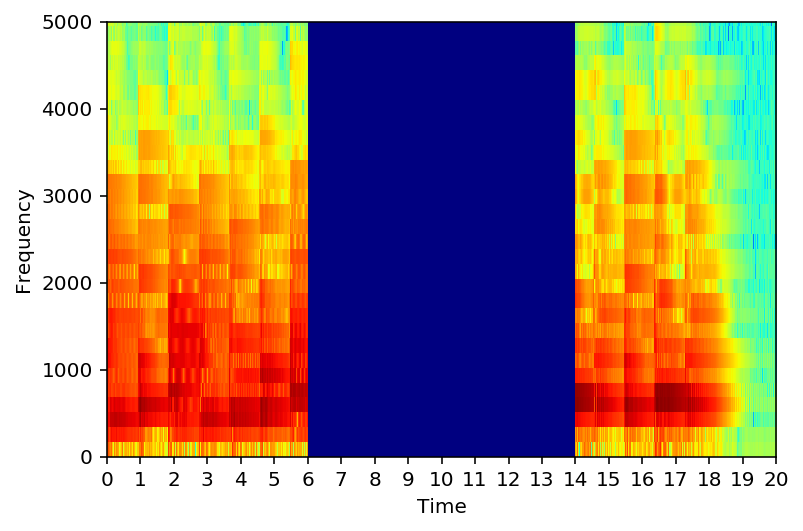

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-16.wav


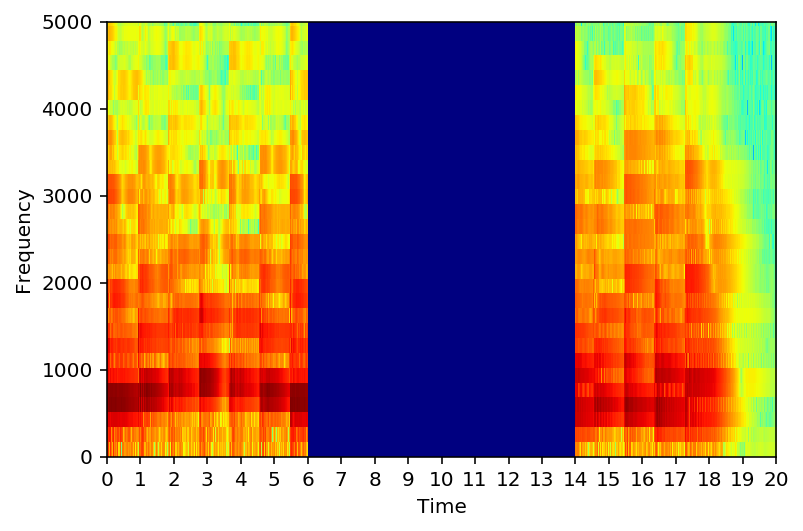

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/orig-17.wav


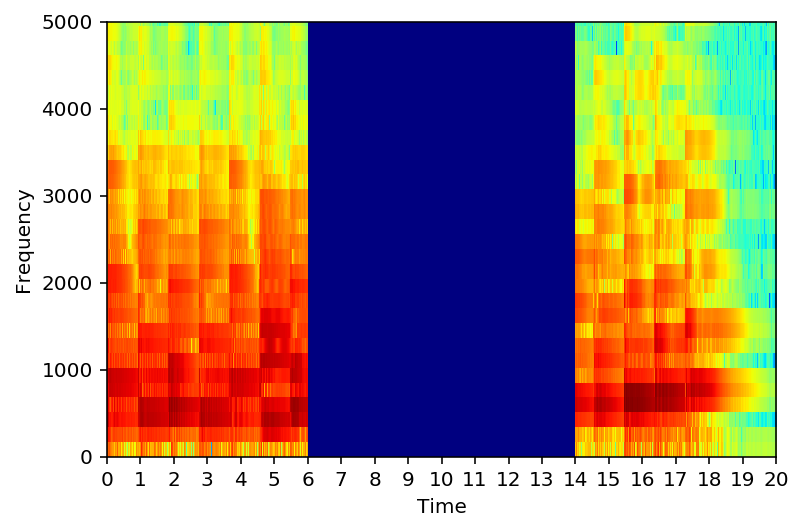

read ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-1.wav


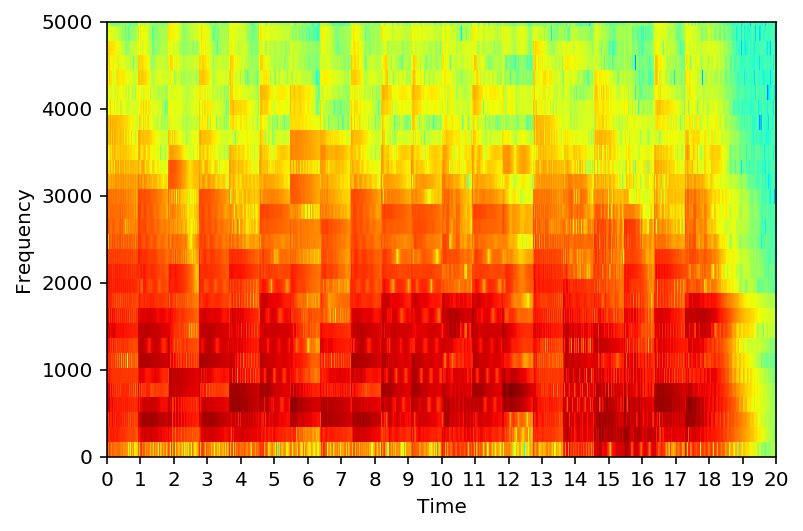

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-2.wav


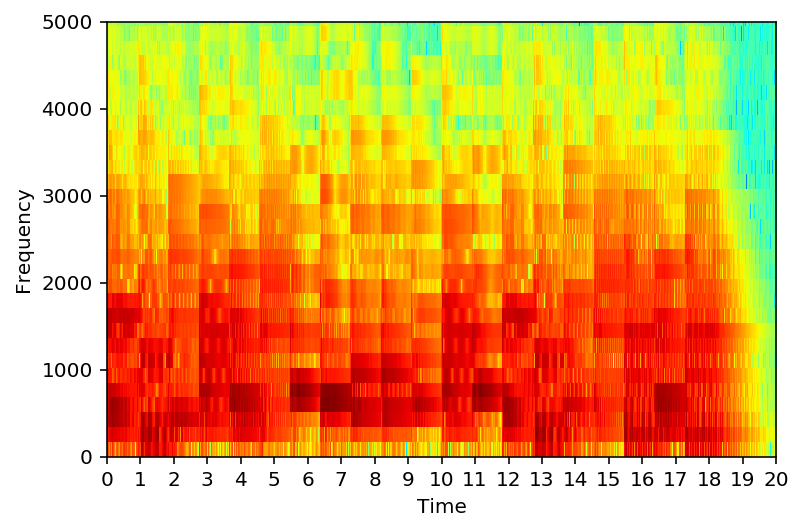

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-3.wav


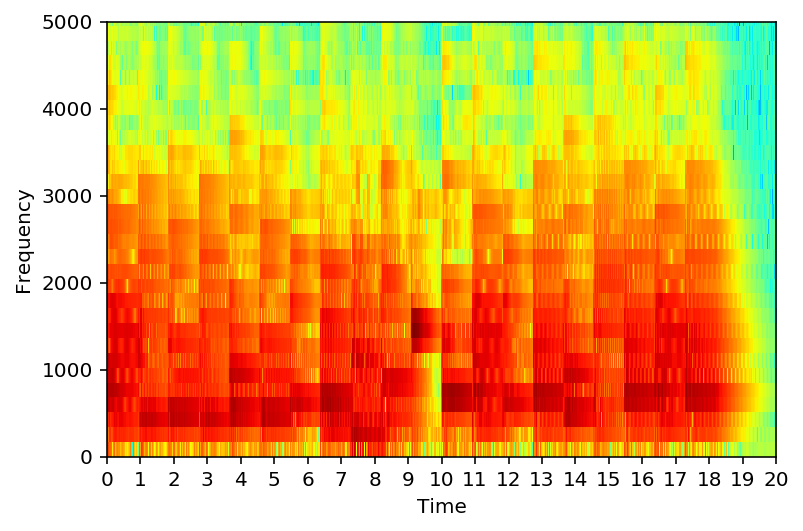

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-4.wav


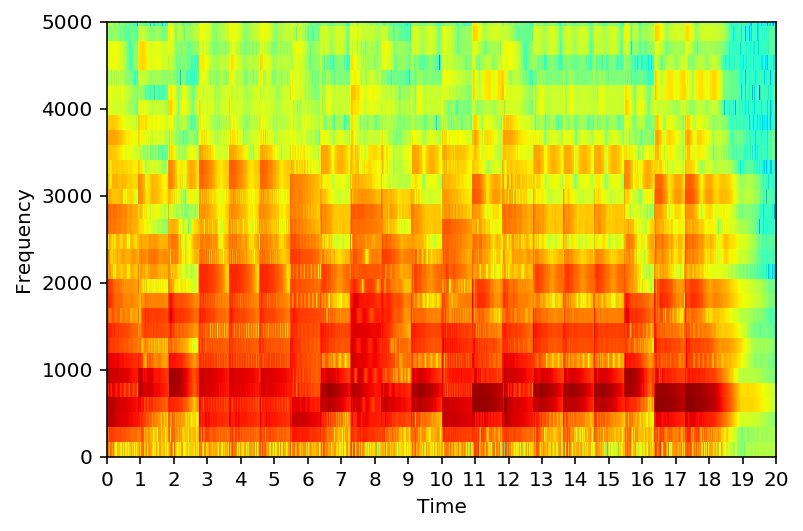

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-5.wav


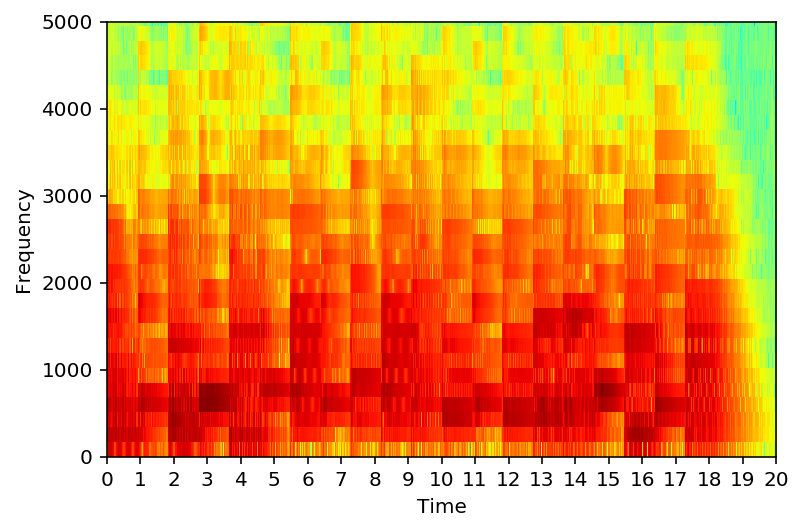

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-6.wav


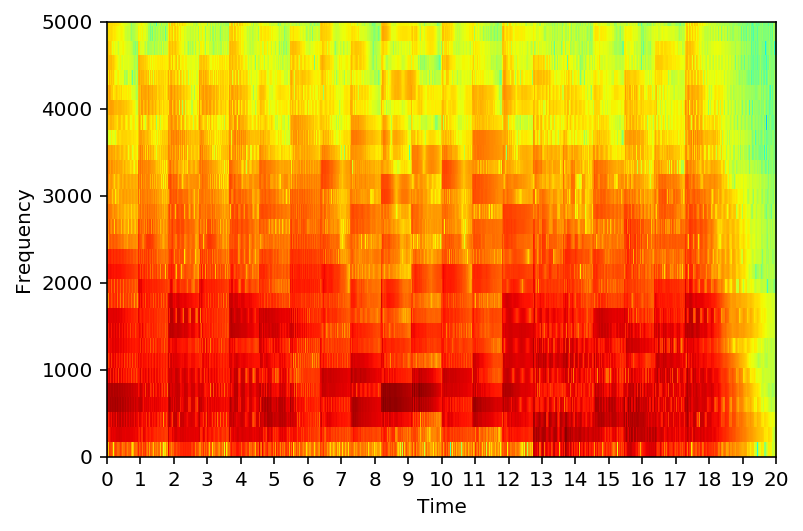

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-7.wav


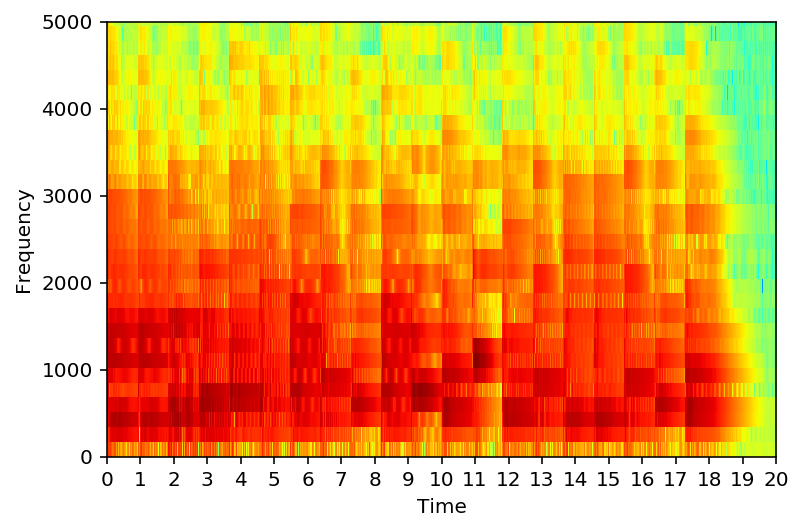

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-8.wav


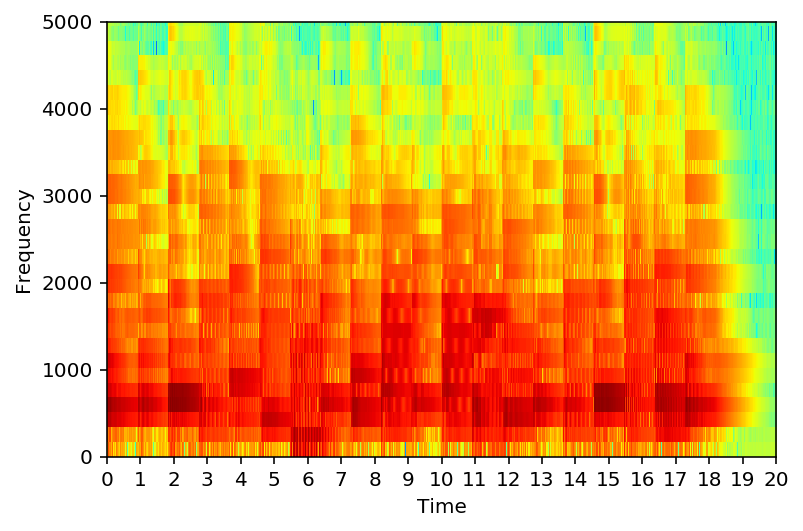

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-9.wav


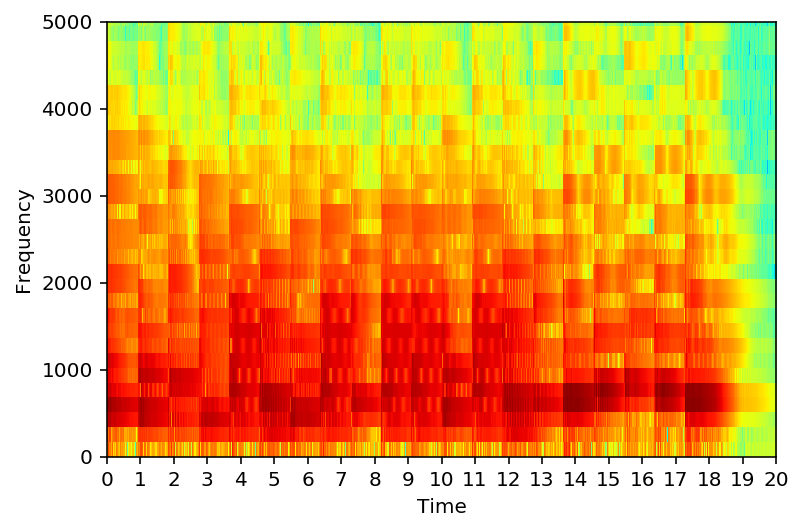

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-10.wav


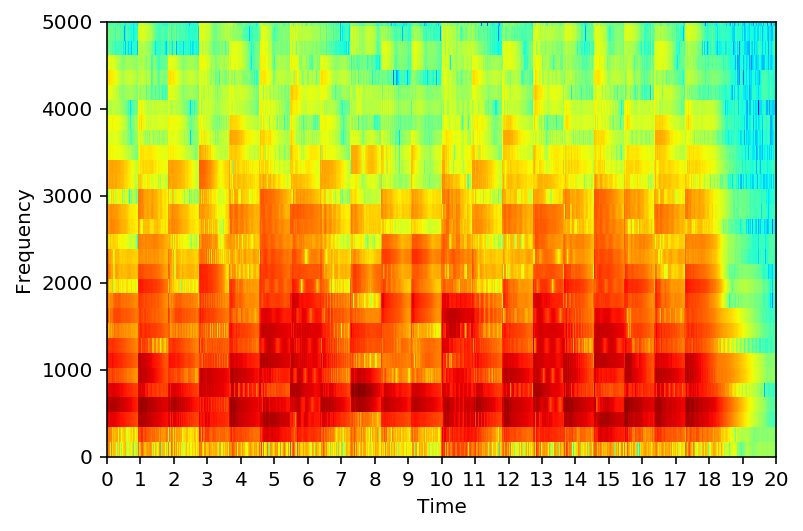

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-11.wav


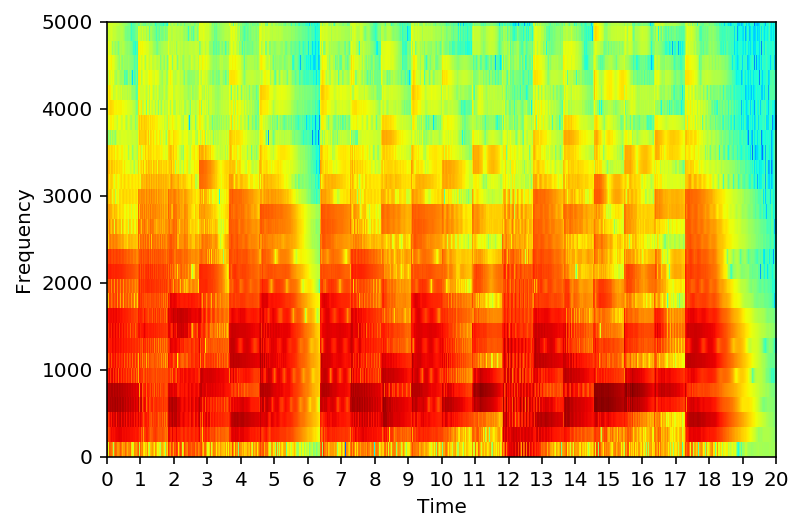

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-12.wav


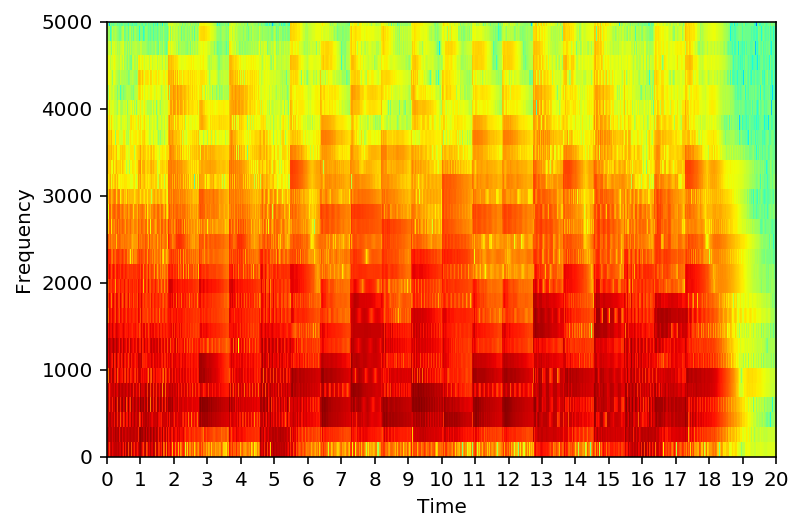

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-13.wav


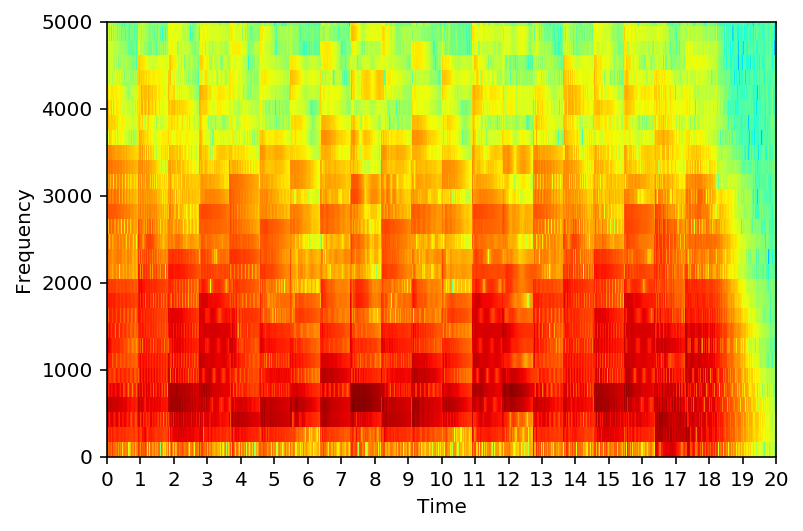

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-14.wav


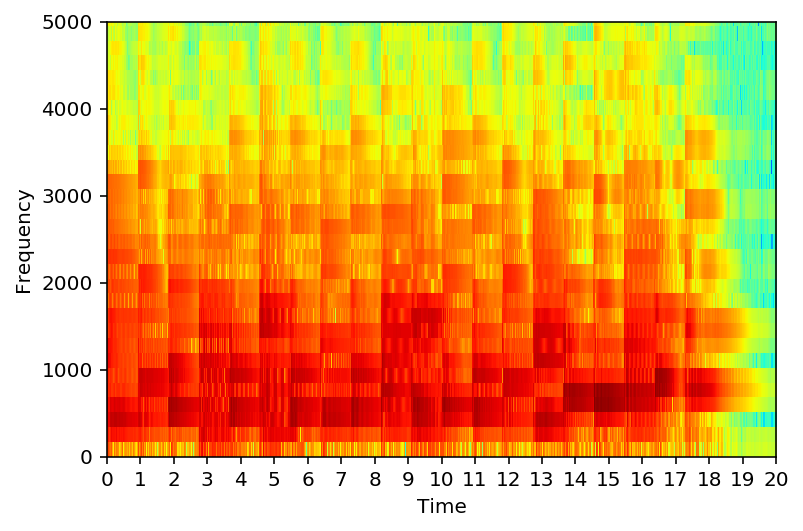

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-15.wav


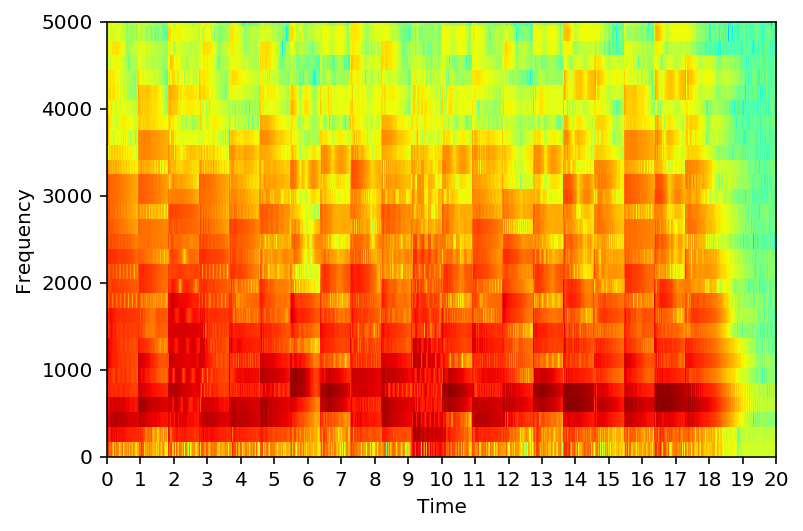

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-16.wav


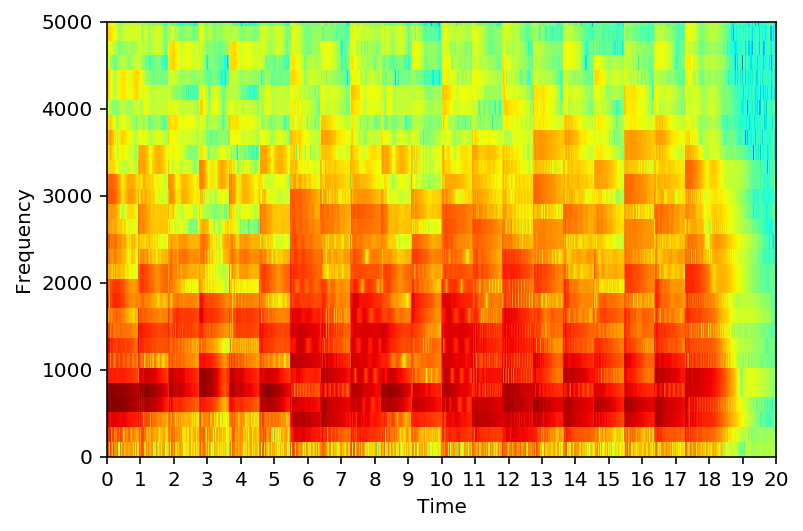

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/bach/filled-17.wav


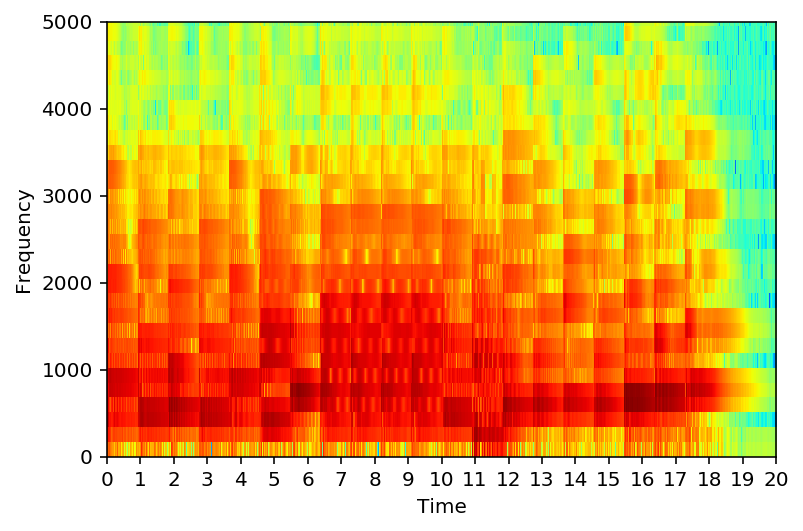

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/mono_orig.txt
A2 F#3 G3 C3 F#3 D3 E3 A3 C3 D3 D4 B2 D3 B3 C3 D3 G3 E3 F3 B3
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-1.wav


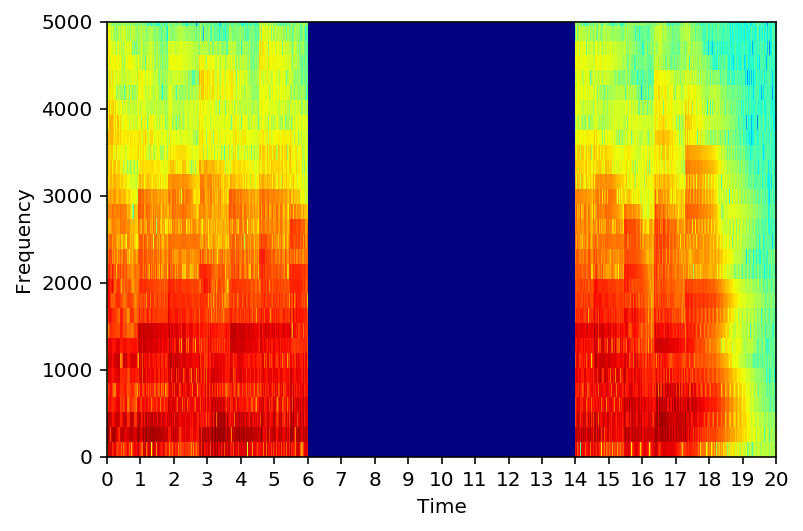

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-2.wav


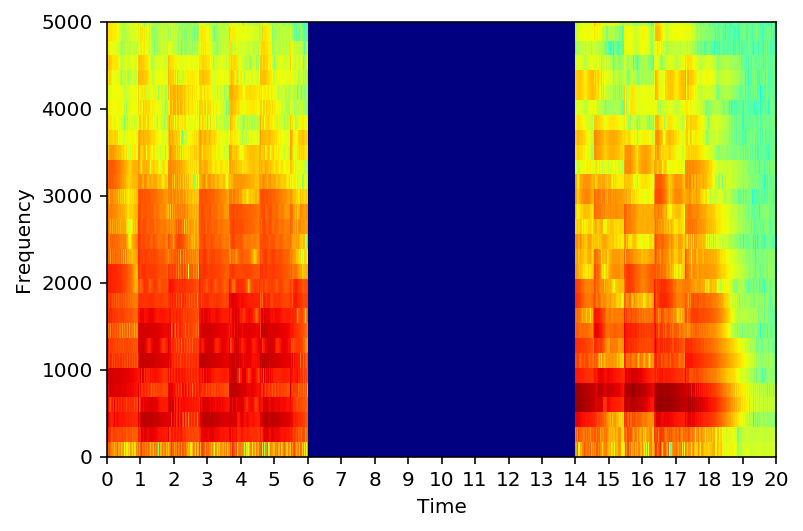

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-3.wav


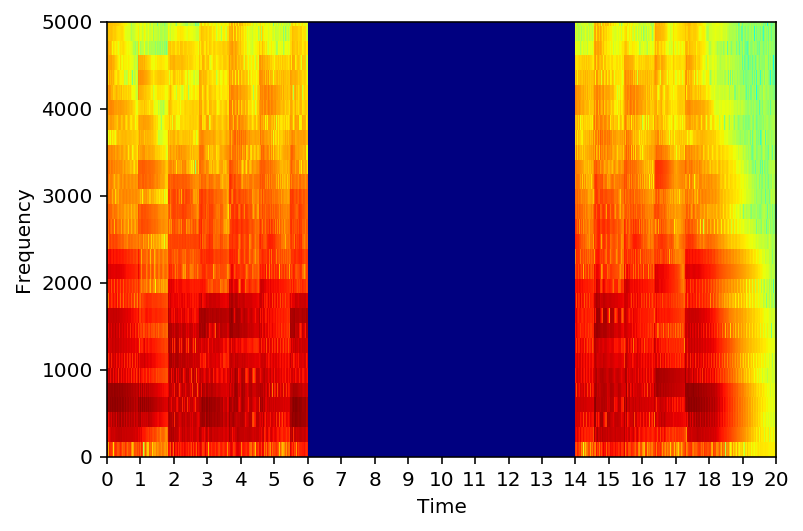

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-4.wav


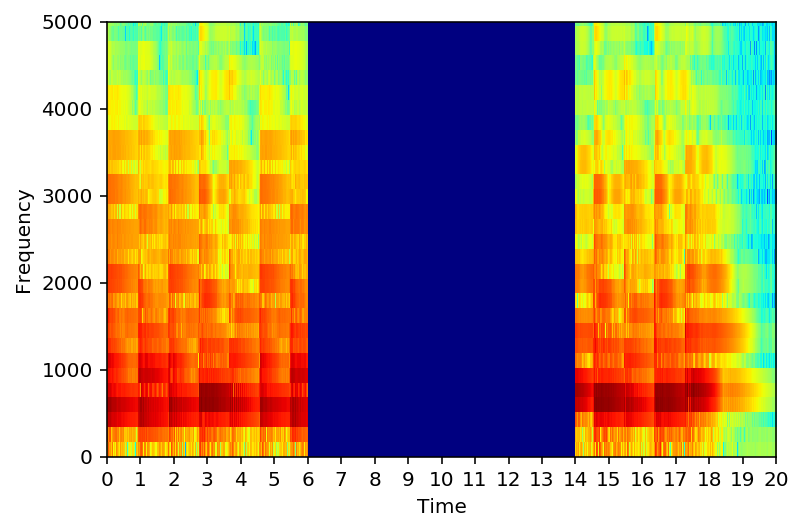

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-5.wav


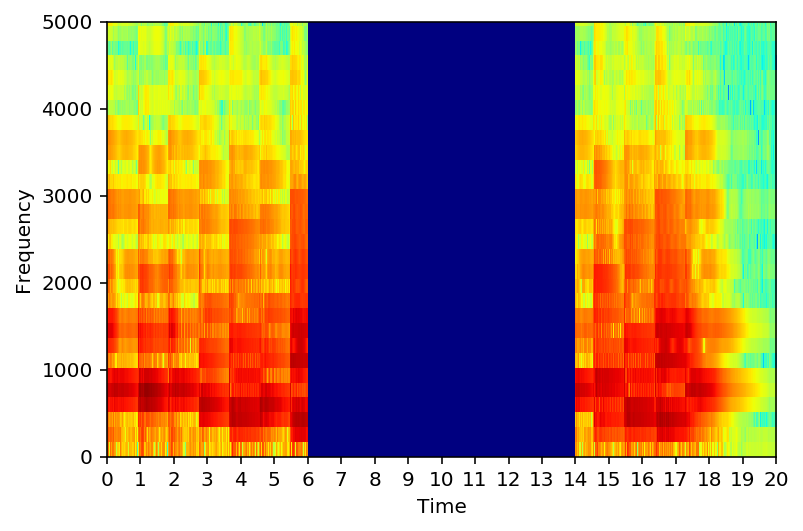

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-6.wav


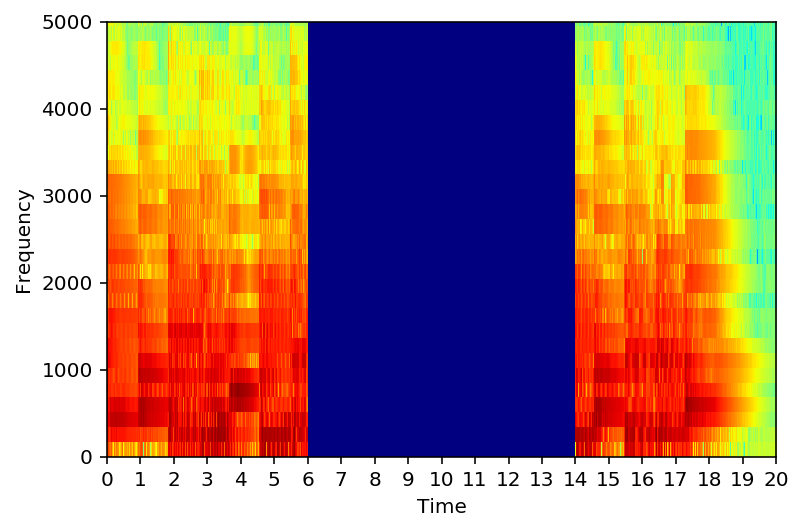

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-7.wav


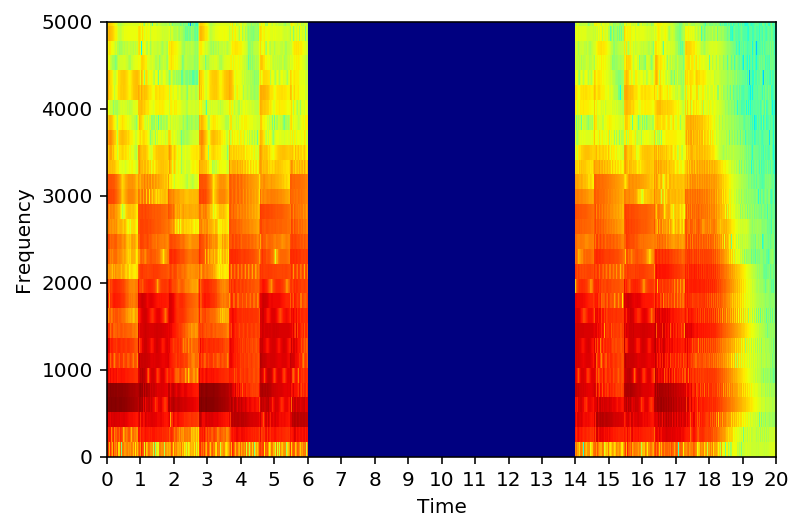

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-8.wav


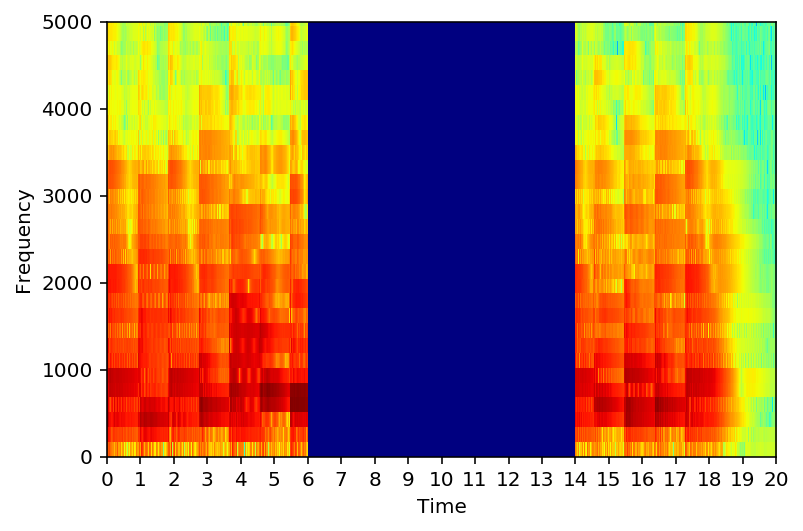

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-9.wav


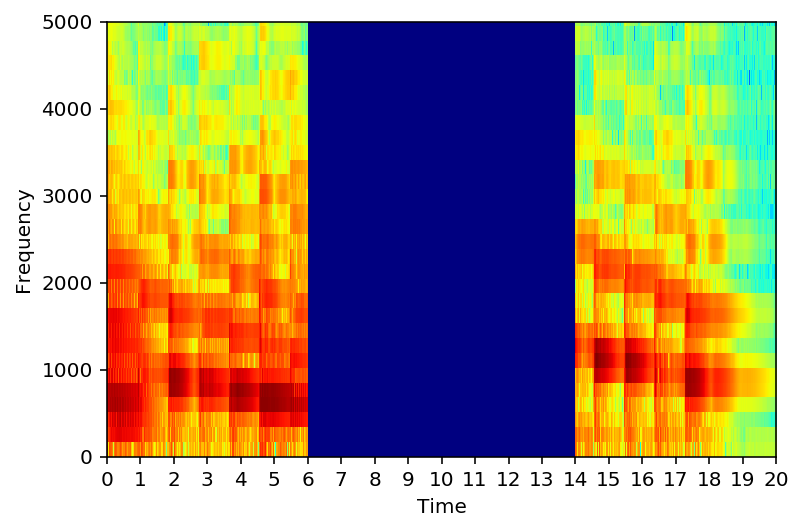

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-10.wav


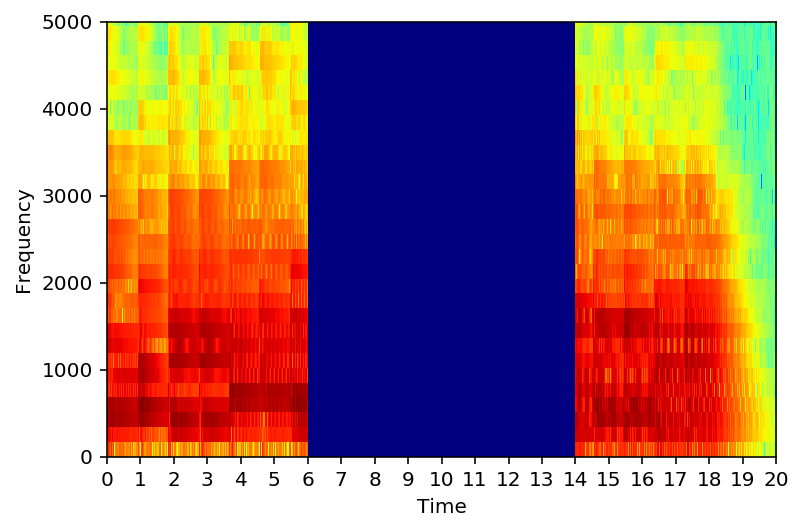

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-11.wav


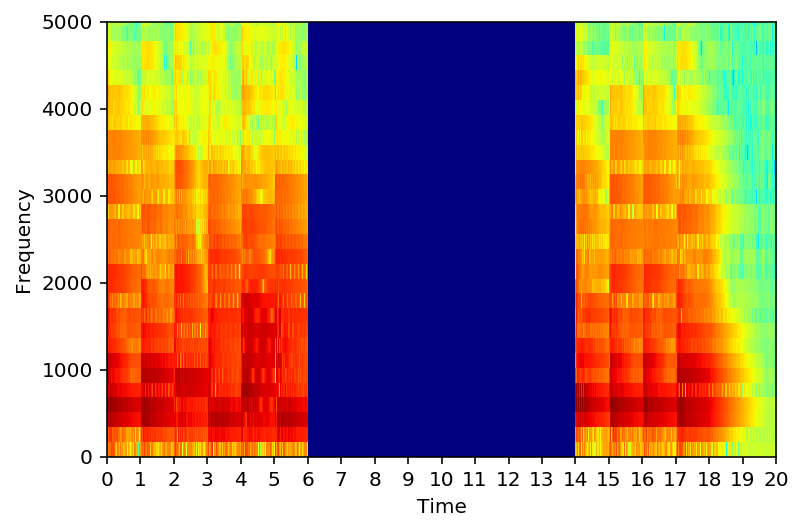

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-12.wav


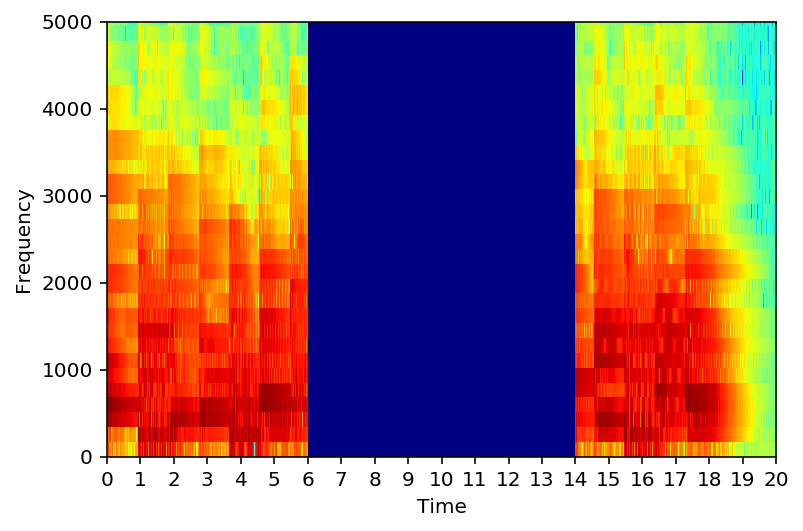

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-13.wav


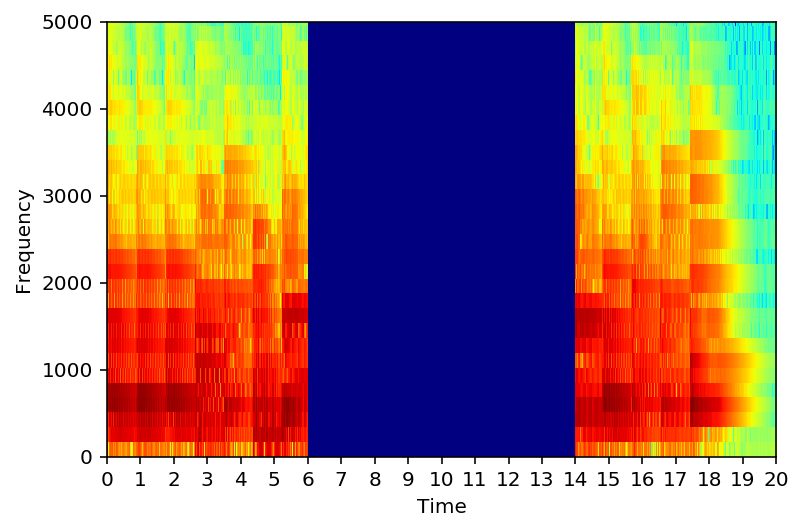

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-14.wav


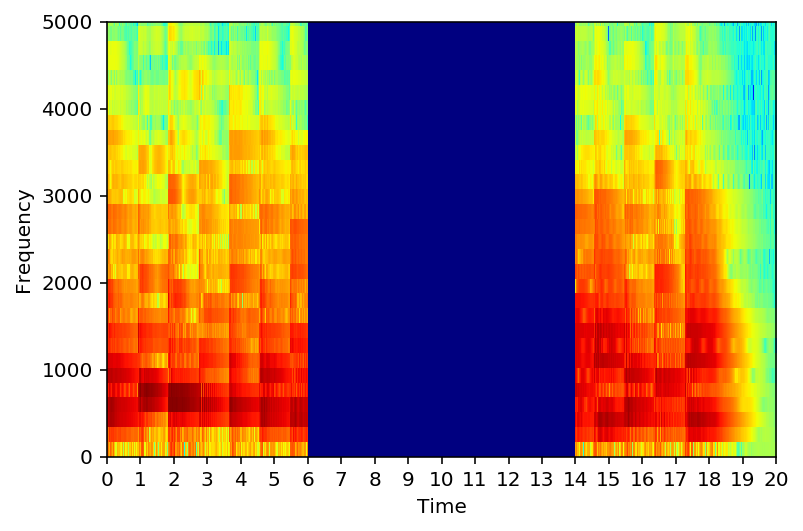

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-15.wav


c:\python35\lib\site-packages\matplotlib\axes\_axes.py:7222: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


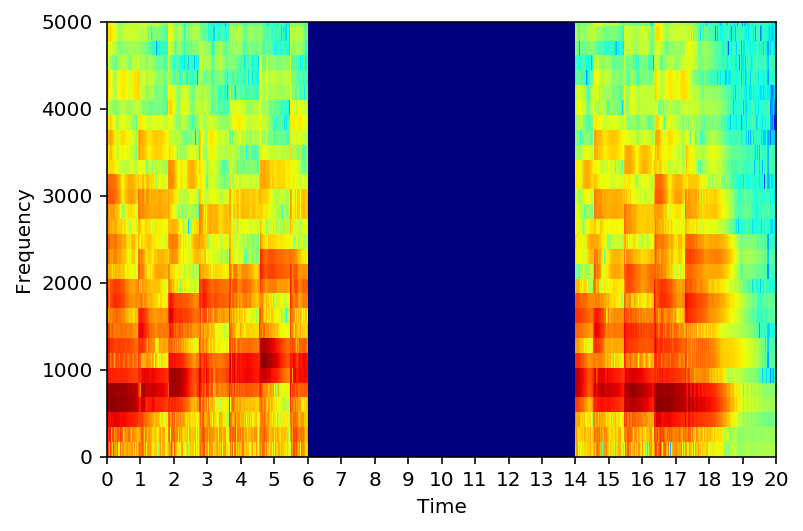

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-16.wav


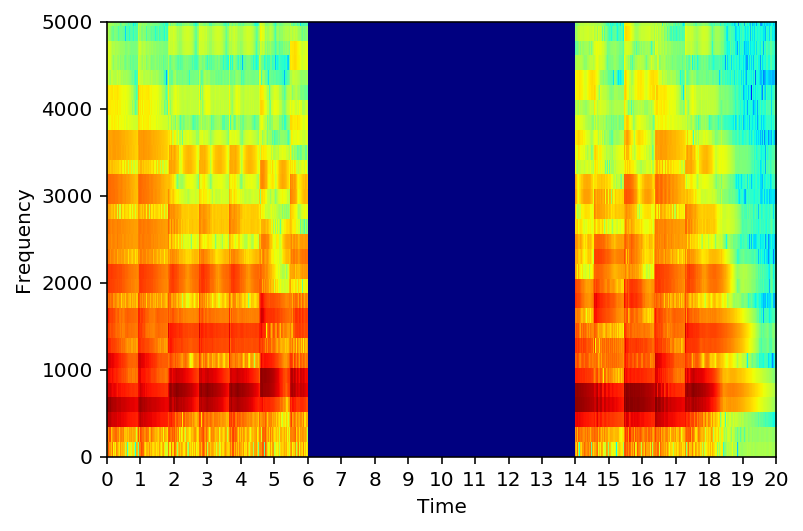

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-17.wav


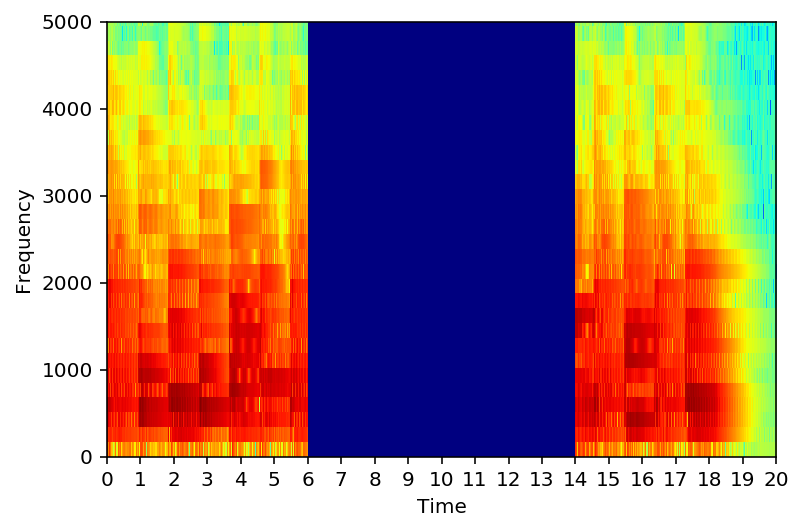

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-18.wav


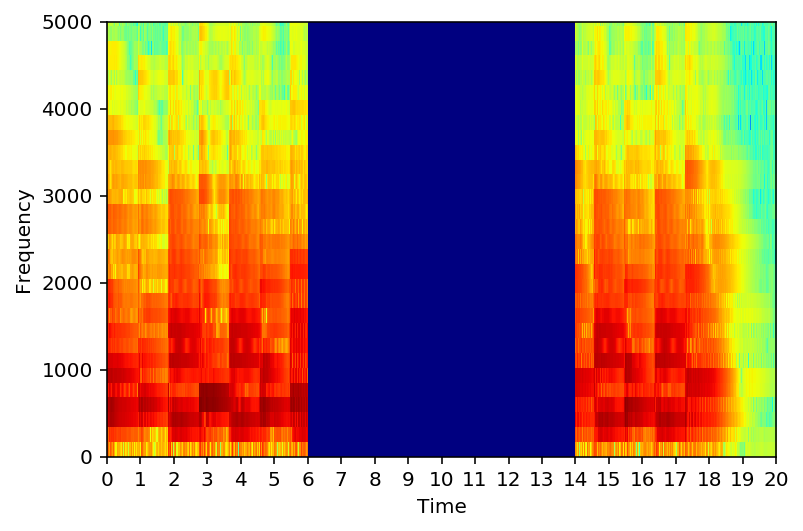

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/orig-19.wav


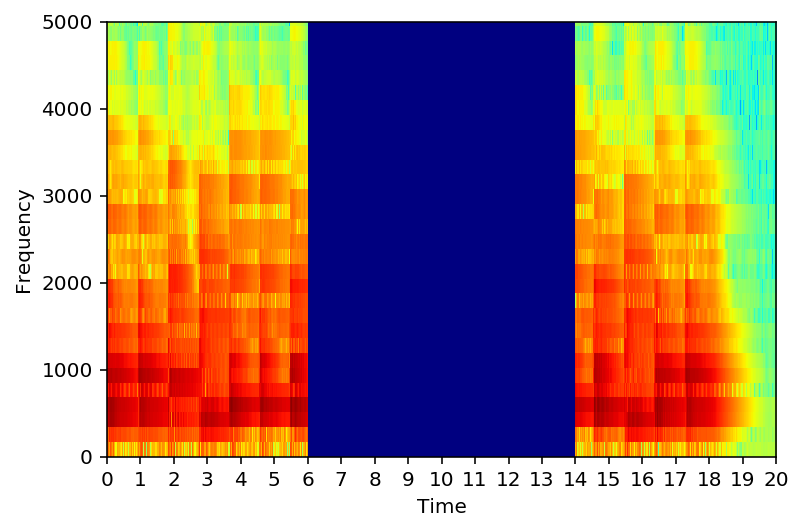

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-1.wav


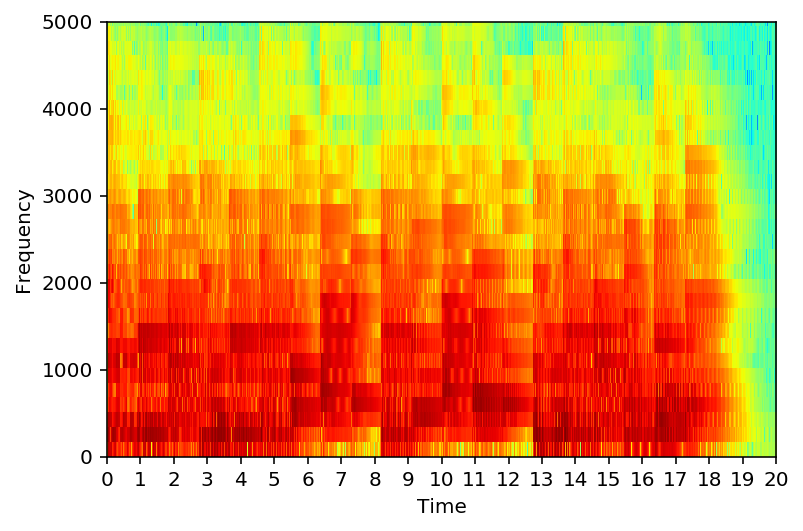

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-2.wav


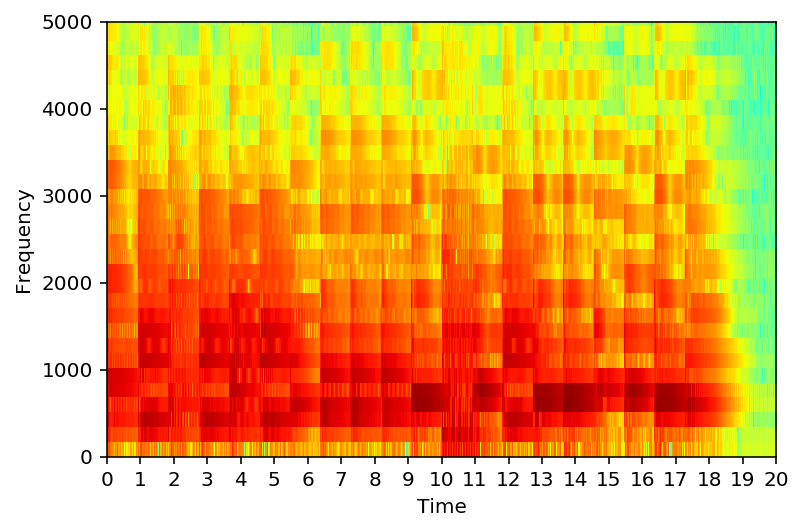

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-3.wav


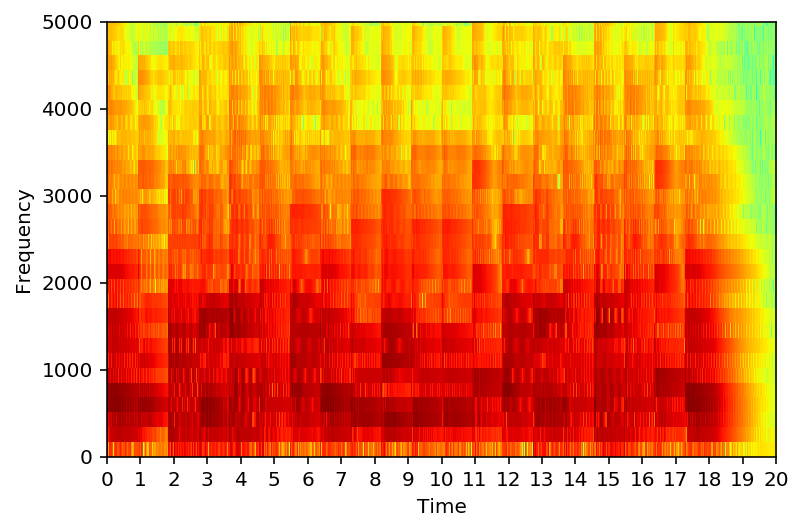

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-4.wav


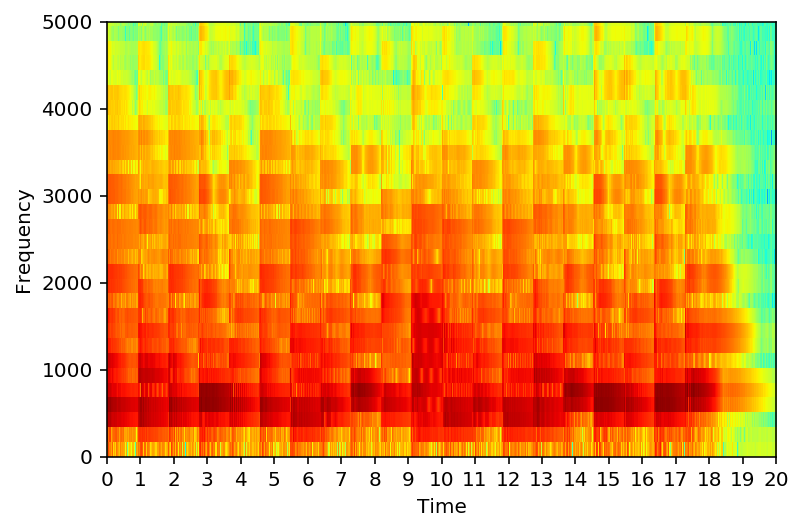

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-5.wav


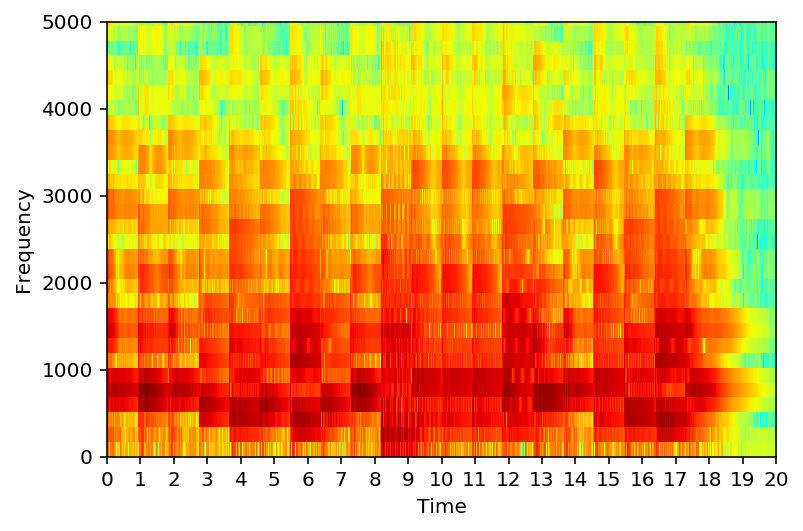

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-6.wav


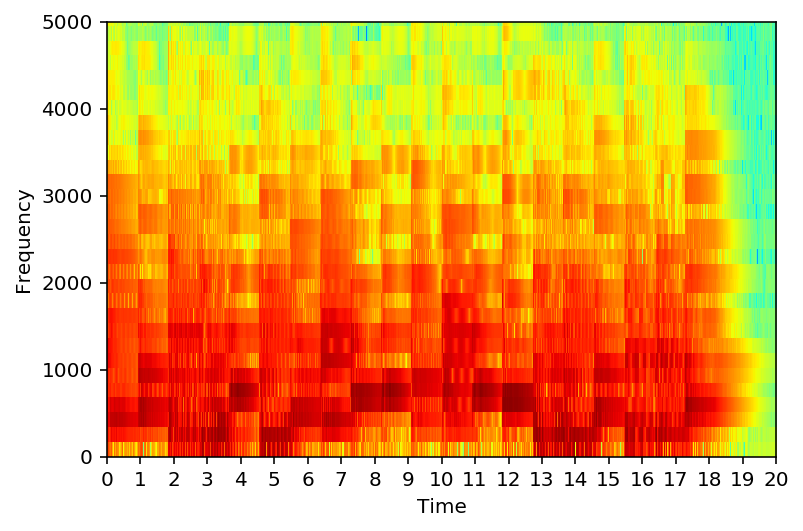

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-7.wav


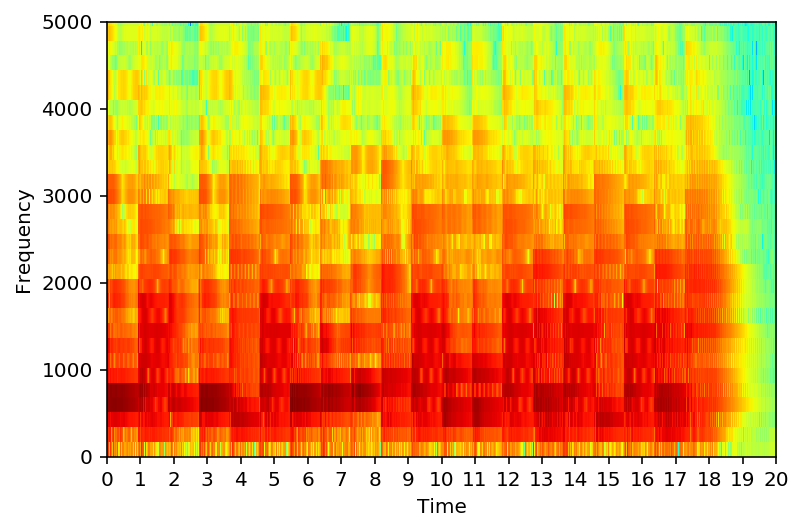

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-8.wav


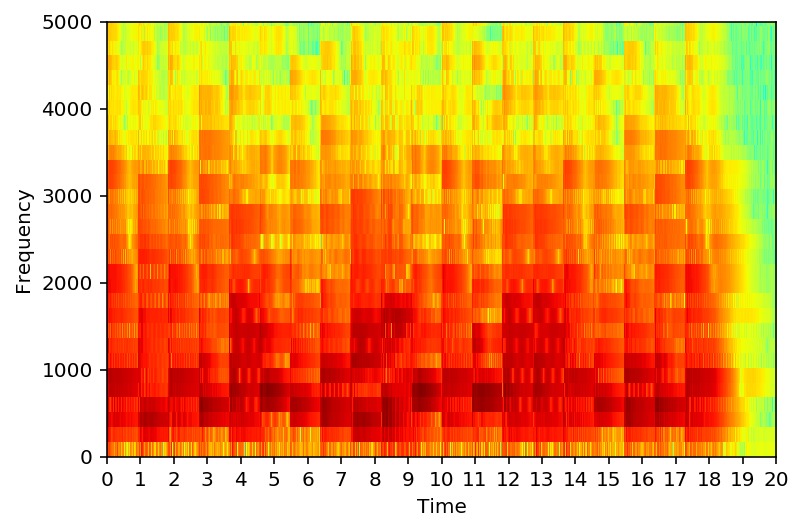

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-9.wav


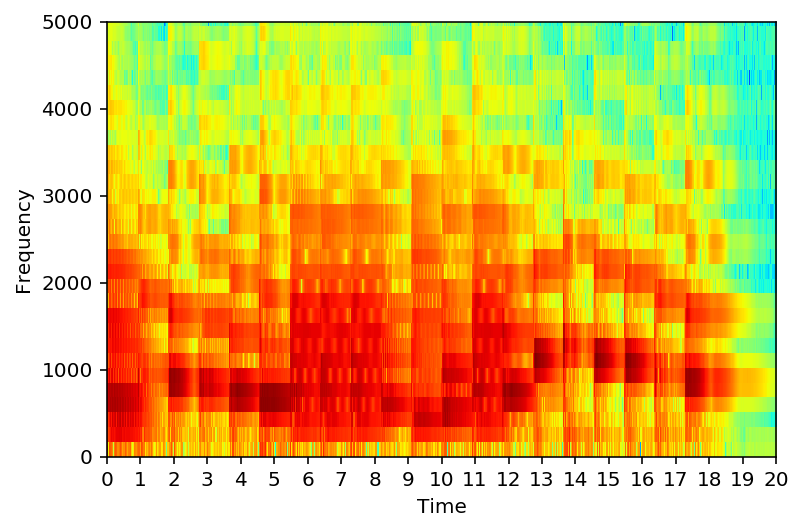

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-10.wav


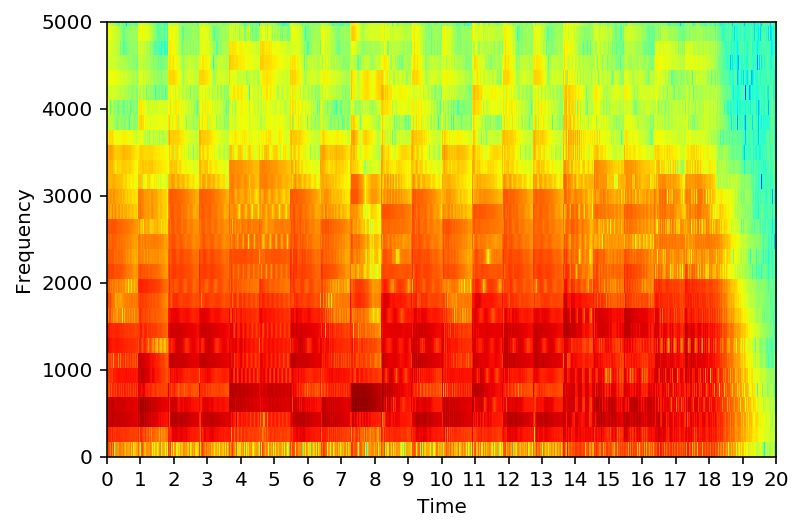

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-11.wav


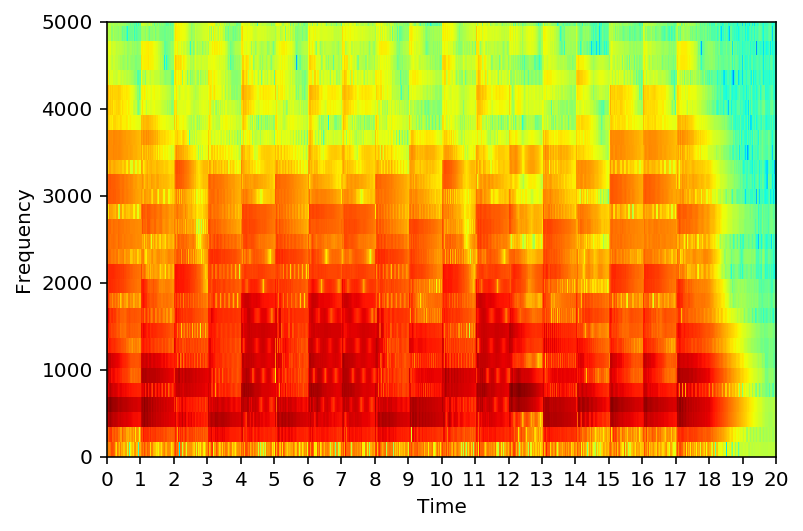

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-12.wav


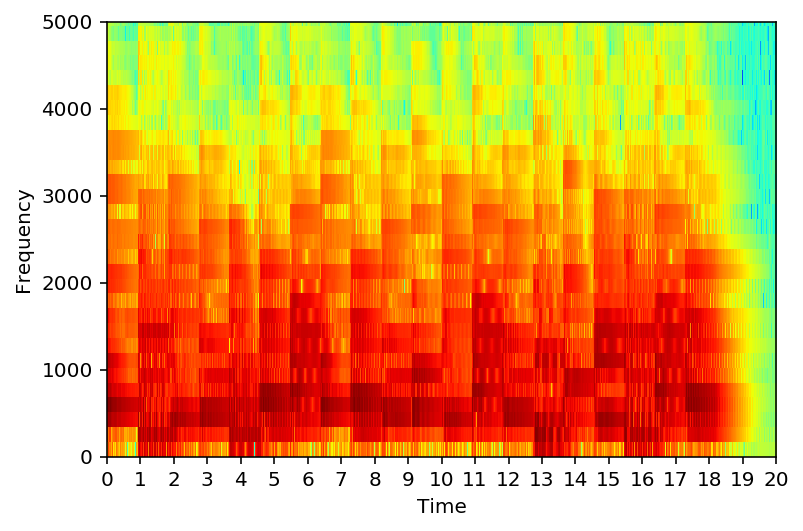

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-13.wav


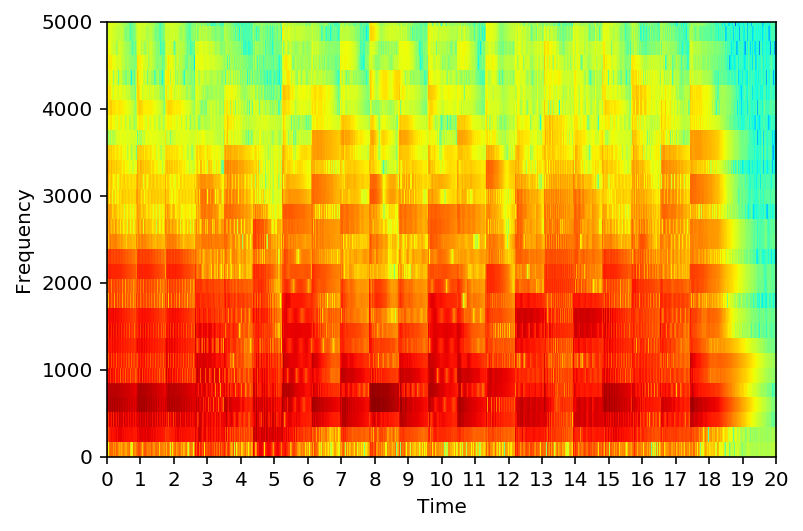

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-14.wav


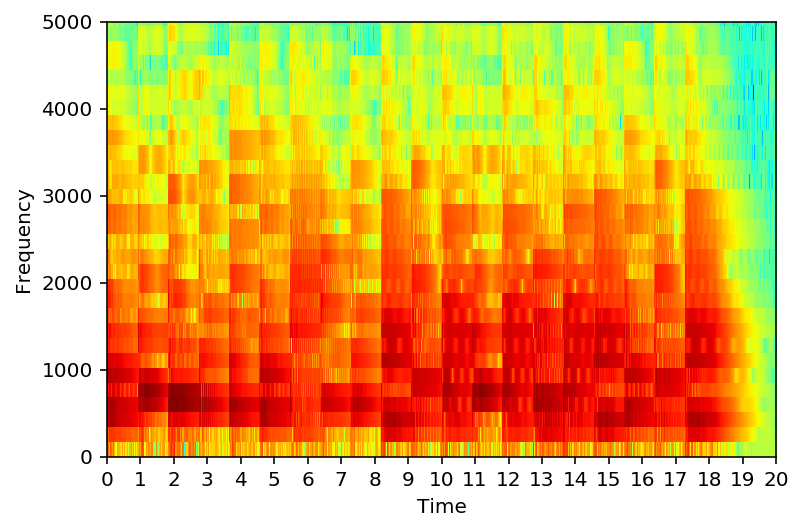

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-15.wav


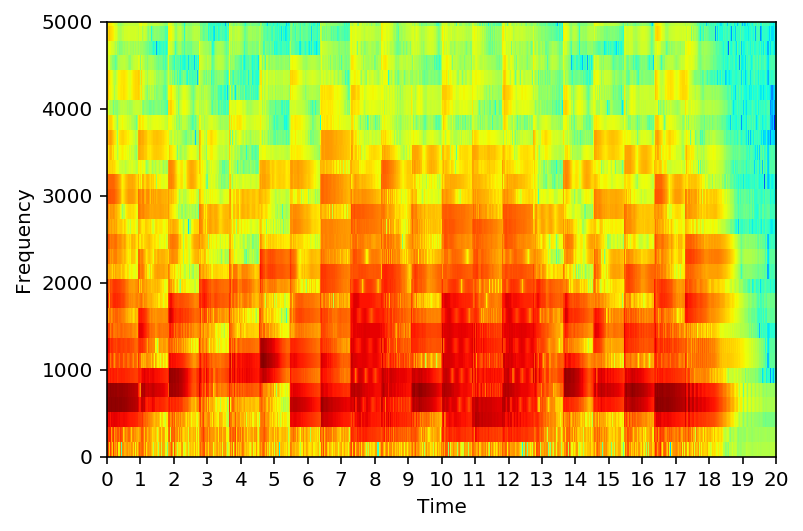

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-16.wav


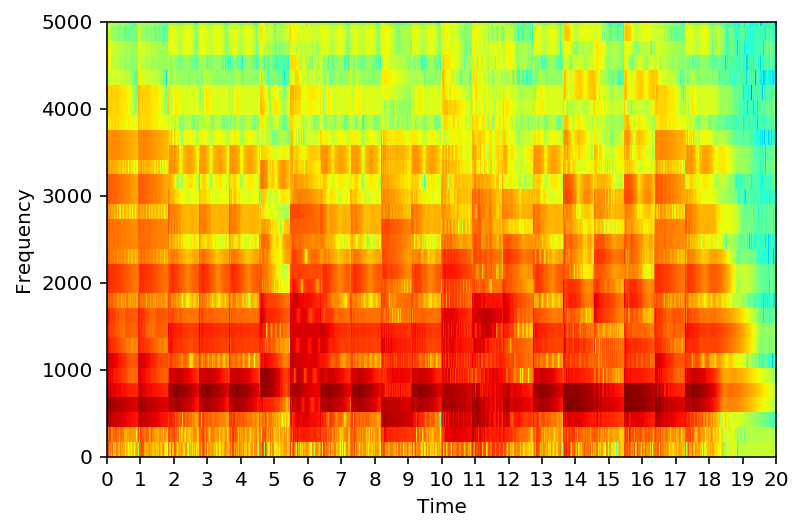

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-17.wav


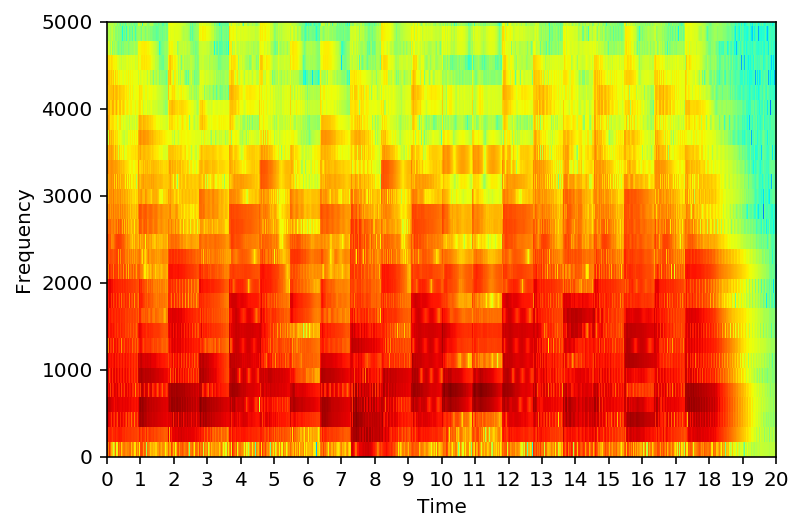

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-18.wav


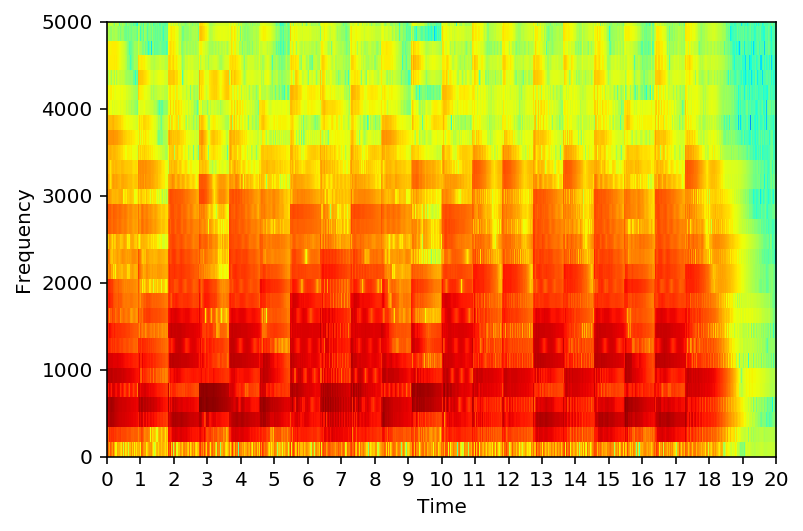

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/bach/filled-19.wav


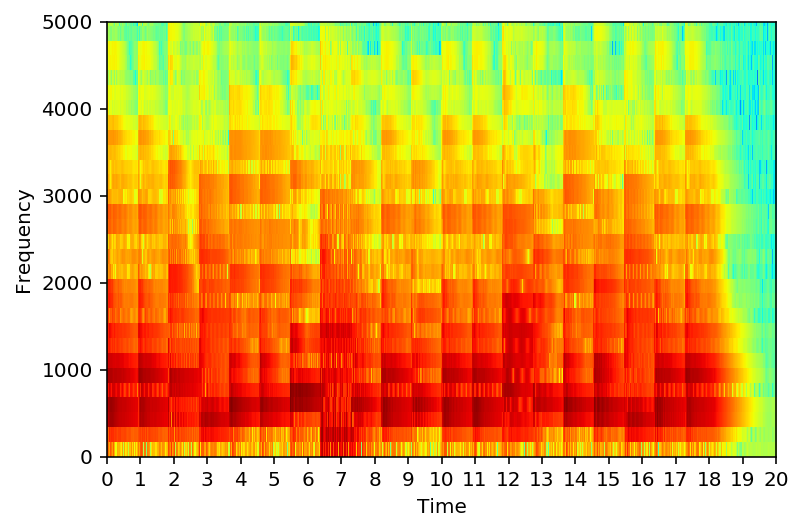

read ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/mono_orig.txt
E6 D6 C6 B-5 A5 G5 E6 B-5 A5 G5 F5 E5 D5 C#5 B-4 A4 G4 F4 E4 D4
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-1.wav


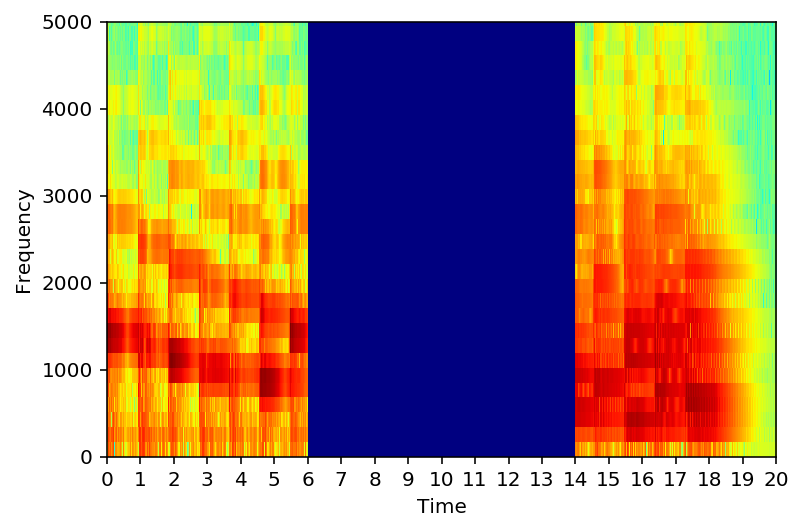

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-2.wav


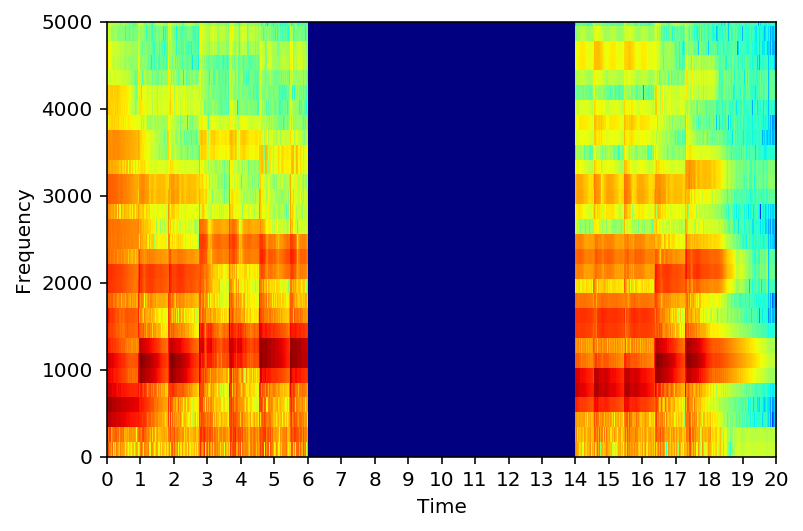

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-3.wav


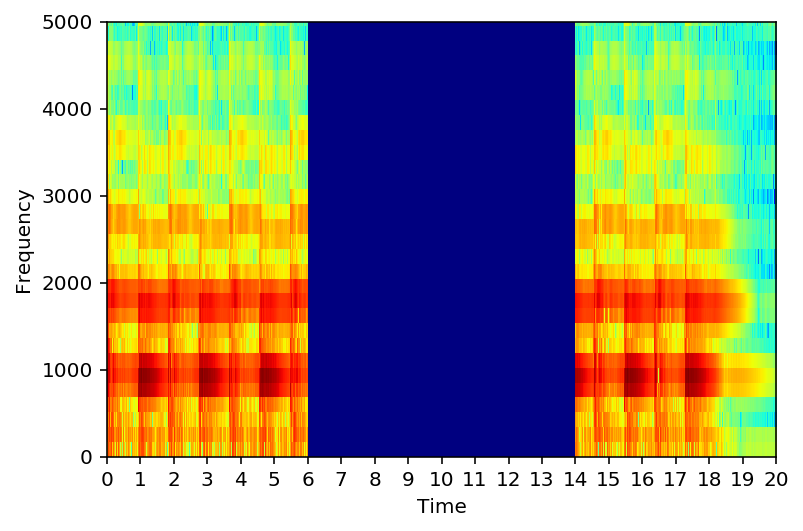

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-4.wav


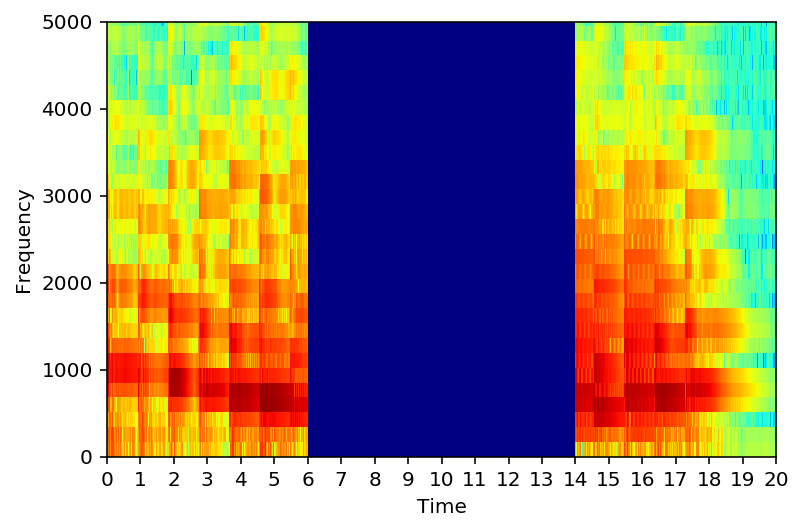

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-5.wav


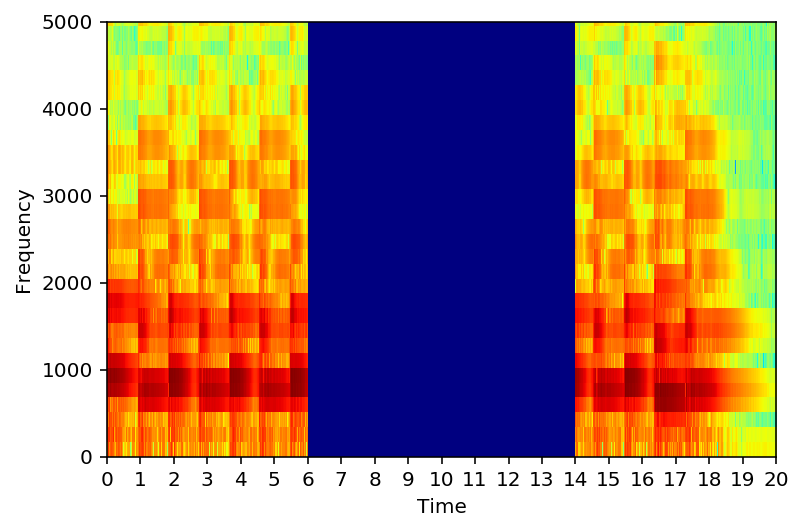

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-6.wav


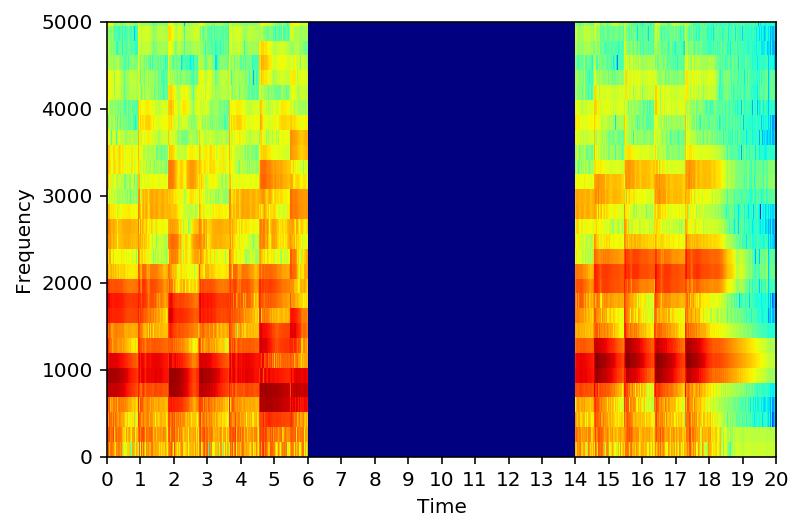

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-7.wav


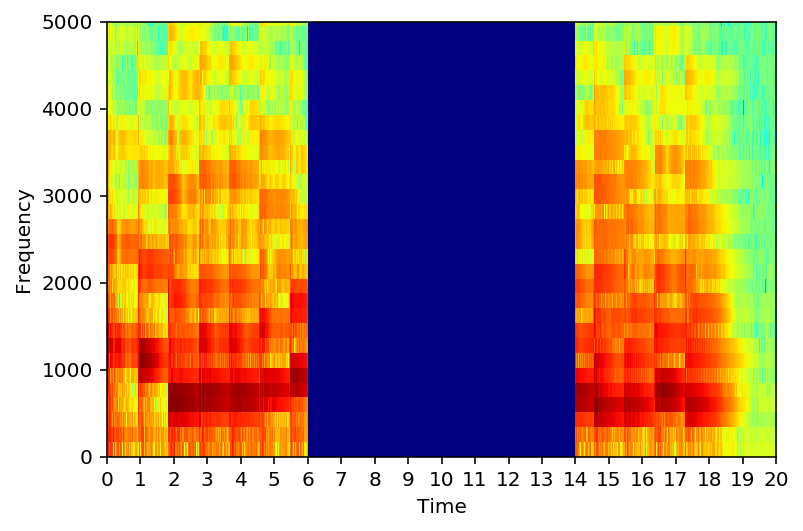

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-8.wav


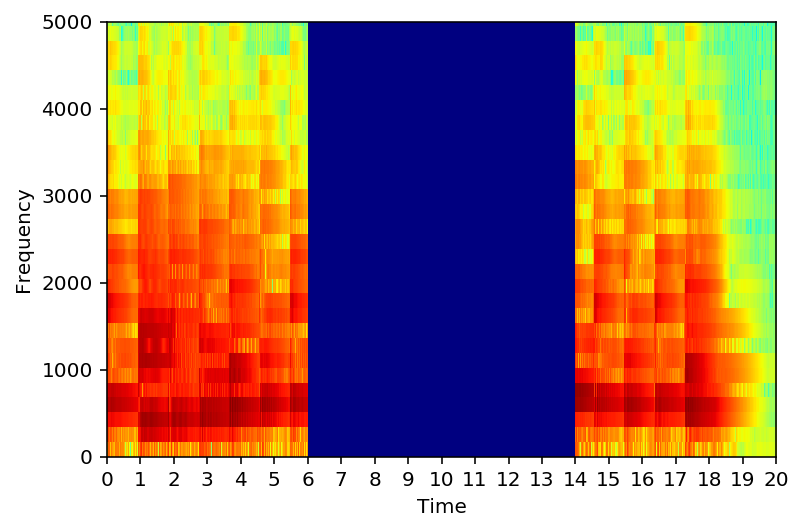

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-9.wav


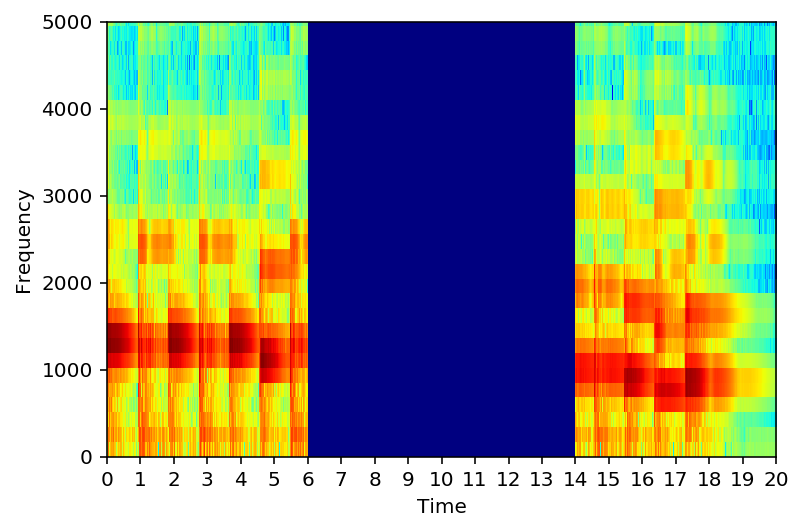

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-10.wav


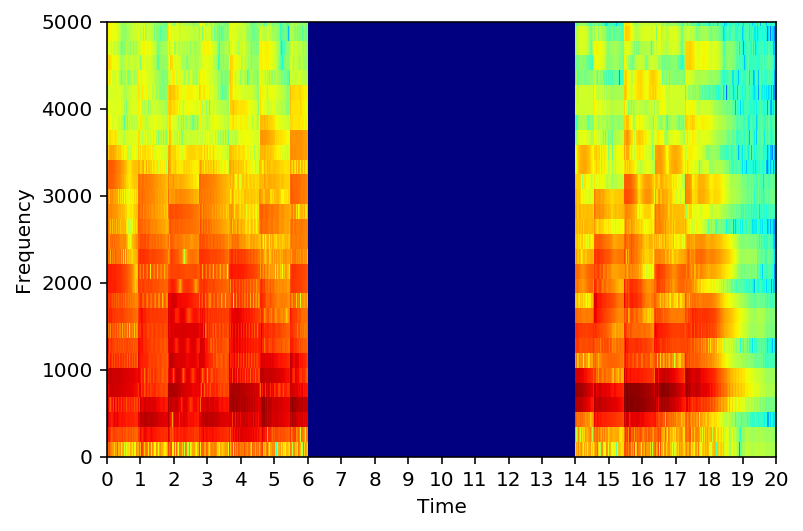

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-11.wav


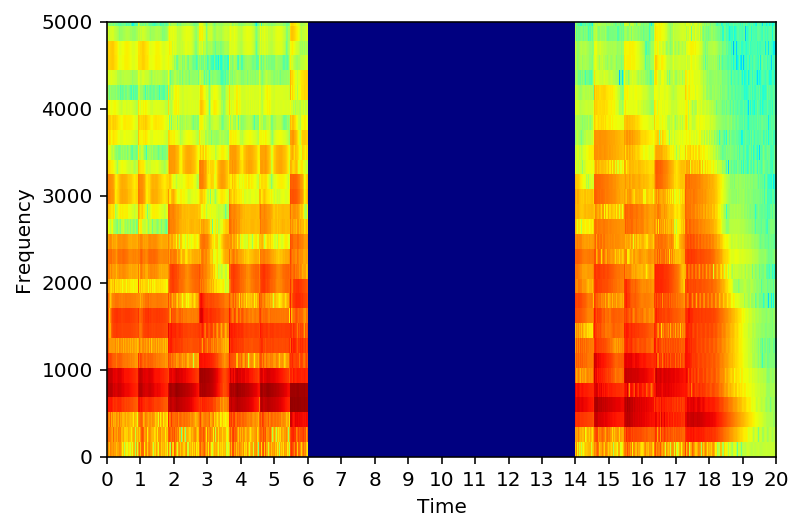

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-12.wav


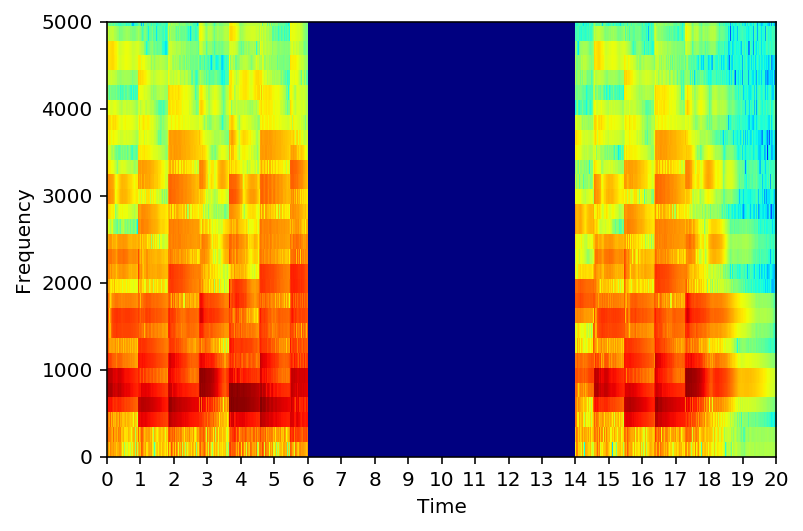

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-13.wav


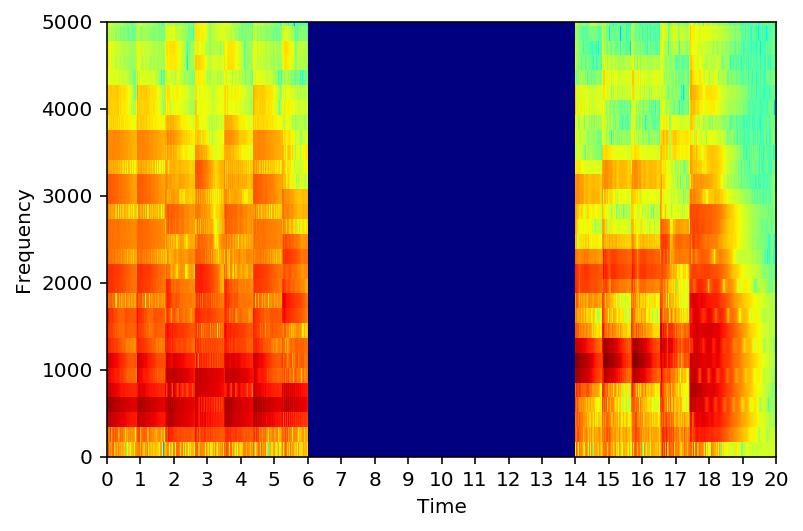

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-14.wav


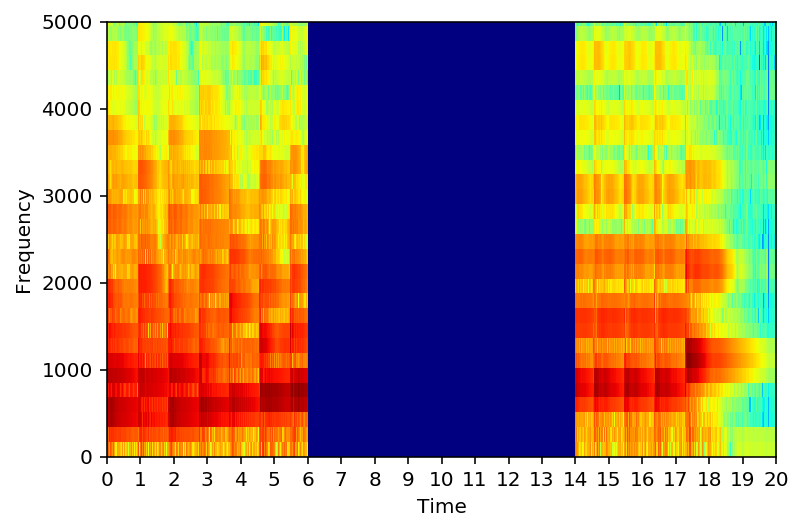

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-15.wav


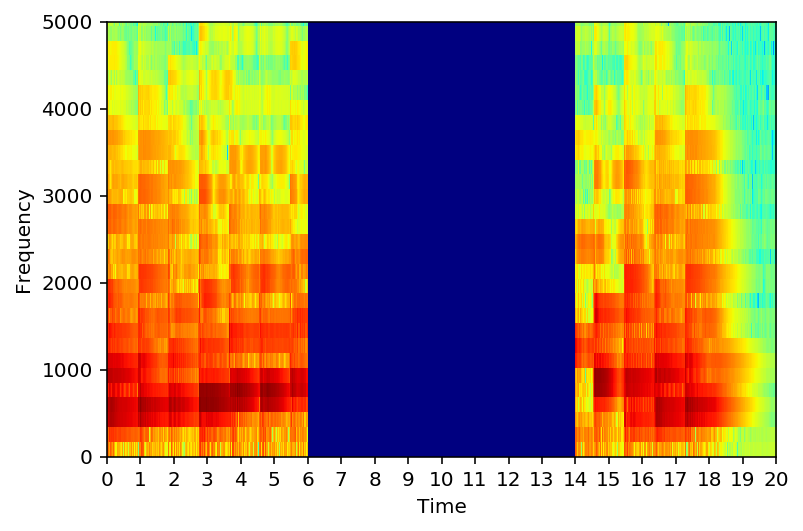

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-16.wav


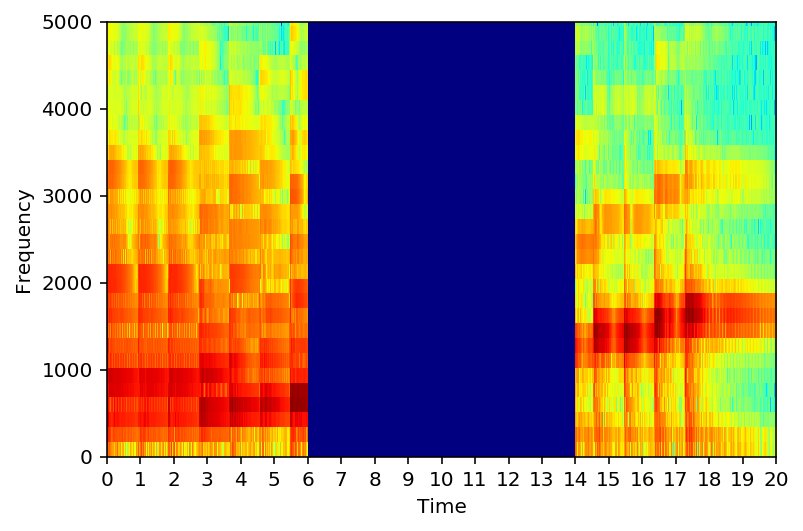

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/orig-17.wav


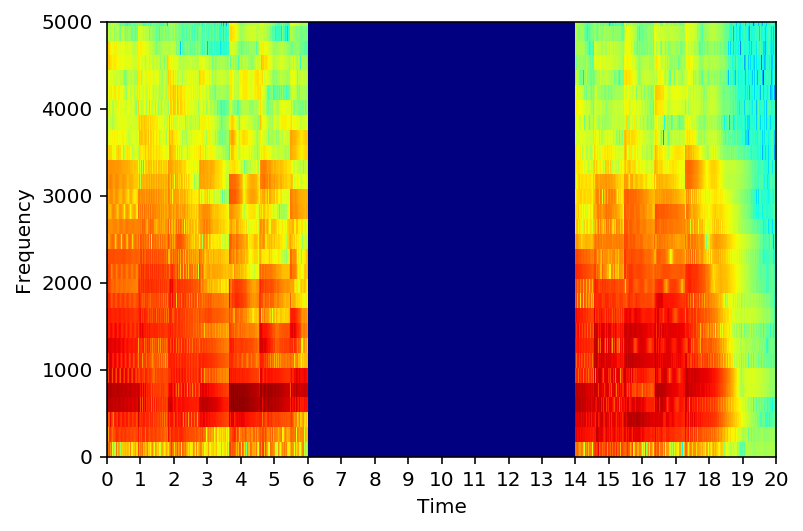

read ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-1.wav


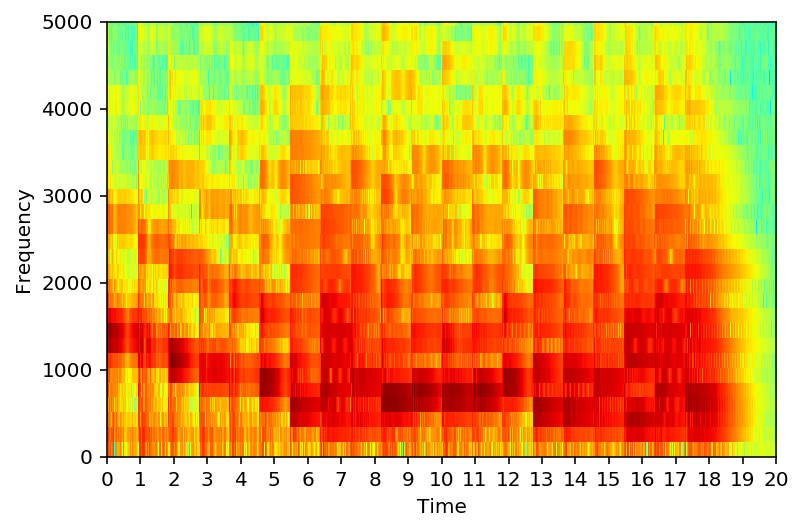

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-2.wav


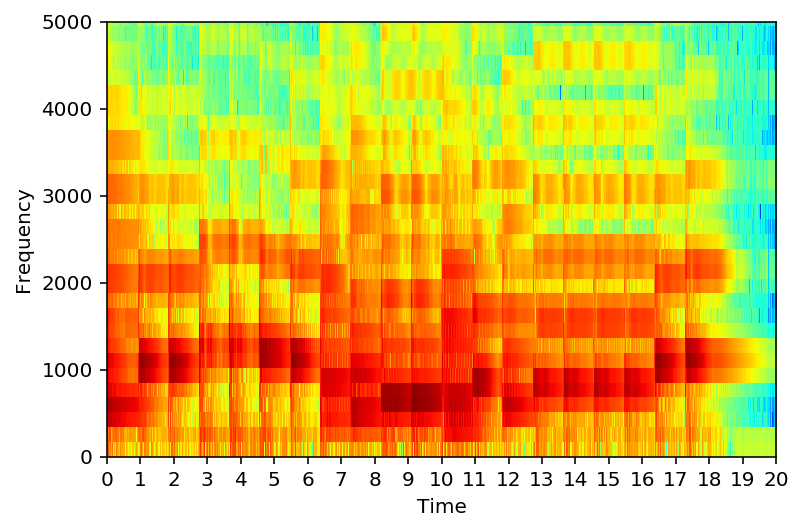

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-3.wav


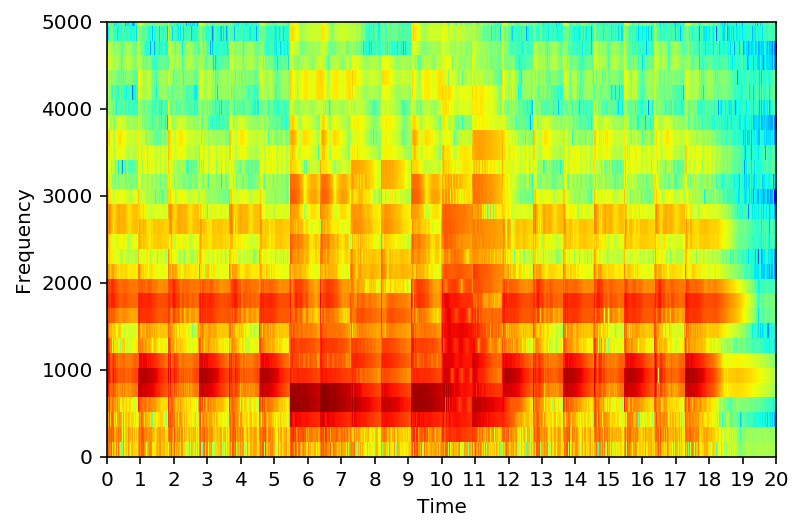

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-4.wav


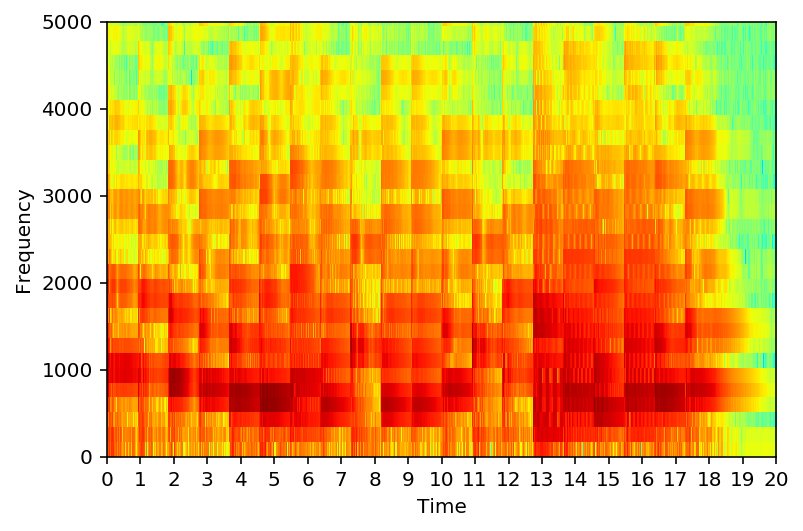

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-5.wav


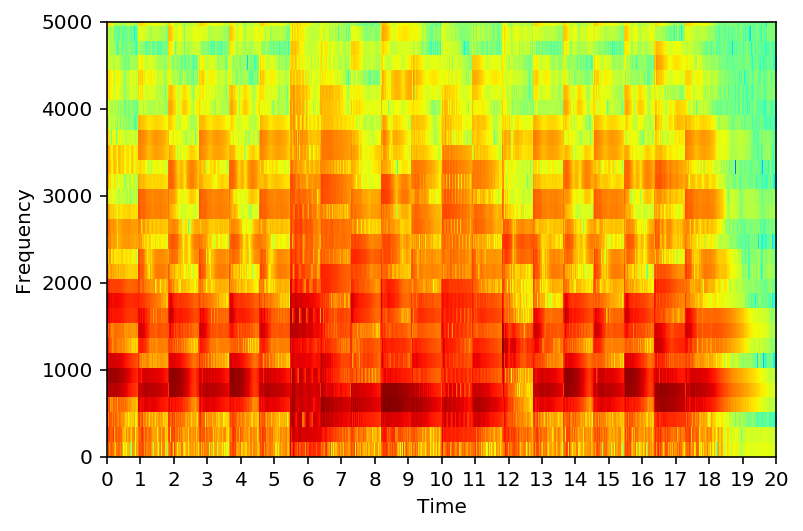

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-6.wav


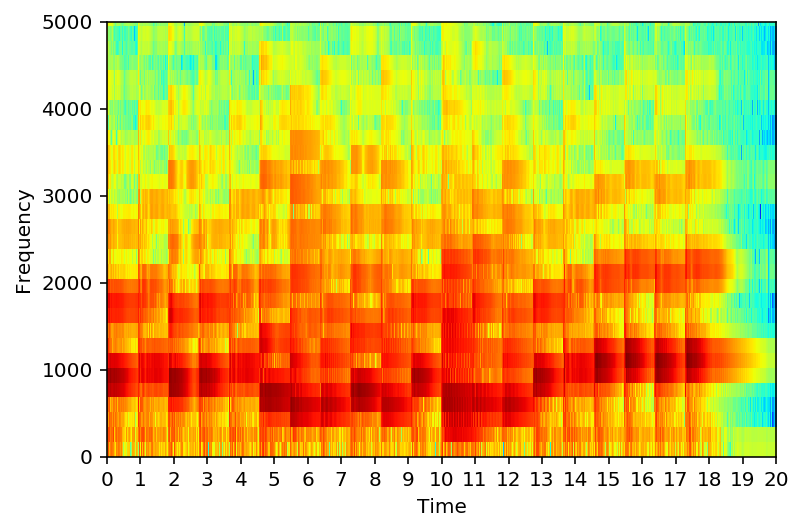

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-7.wav


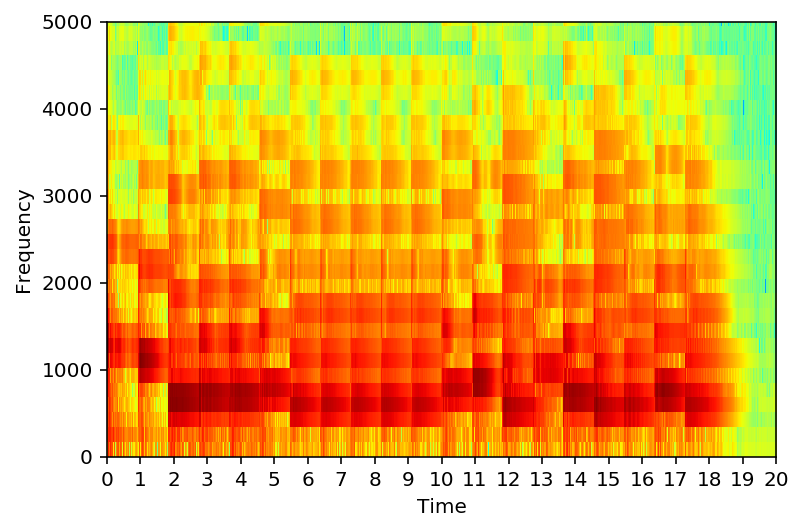

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-8.wav


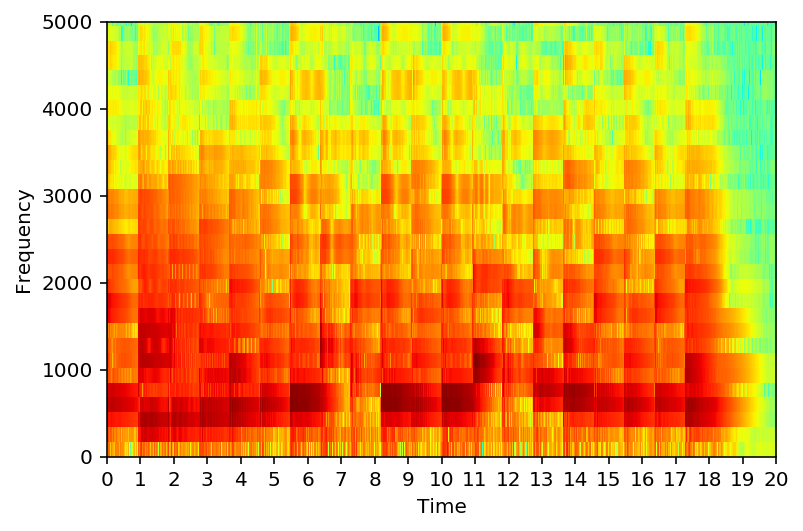

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-9.wav


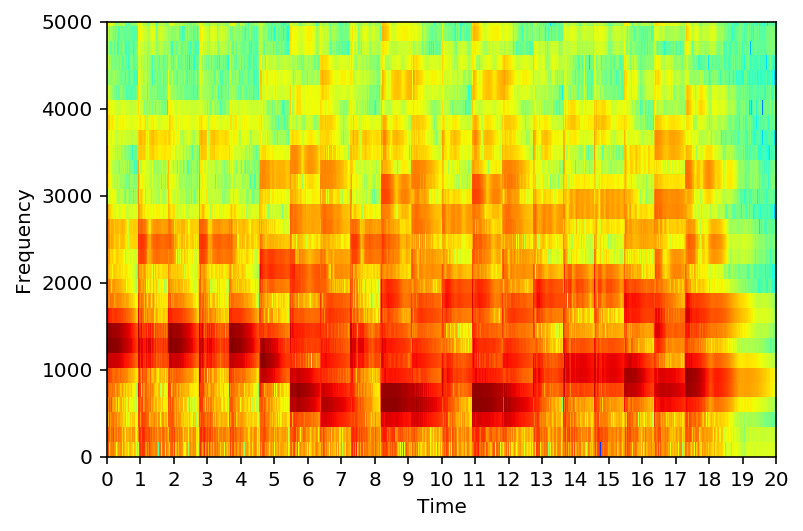

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-10.wav


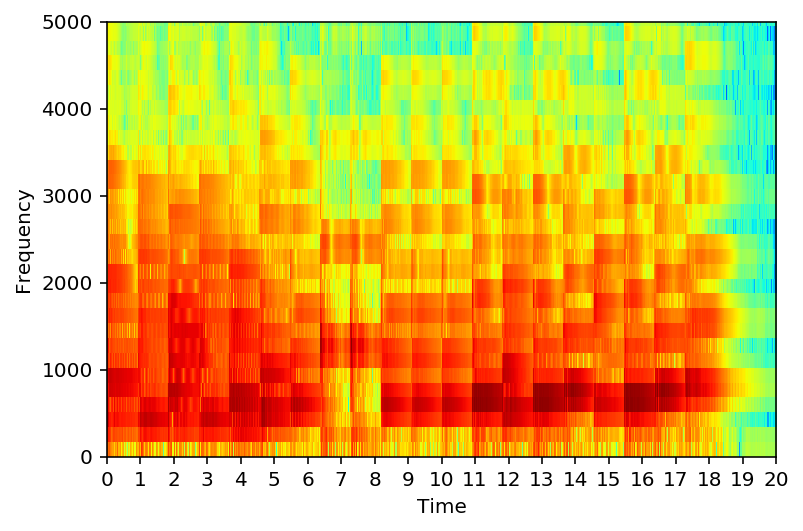

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-11.wav


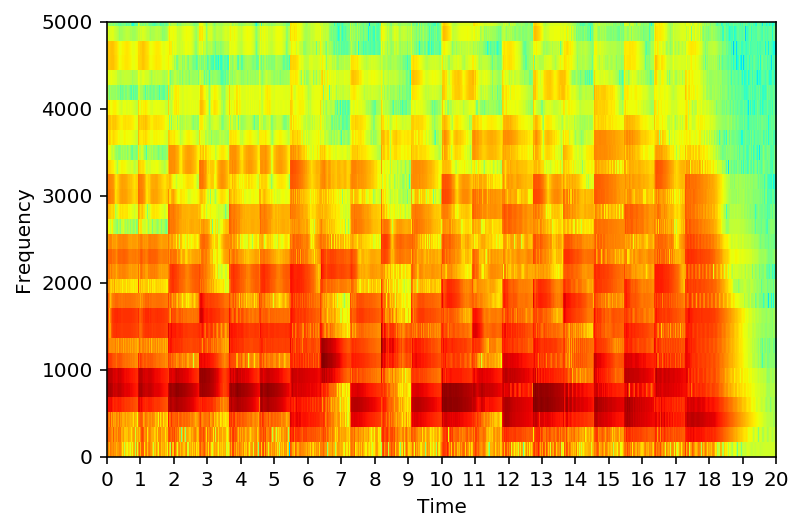

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-12.wav


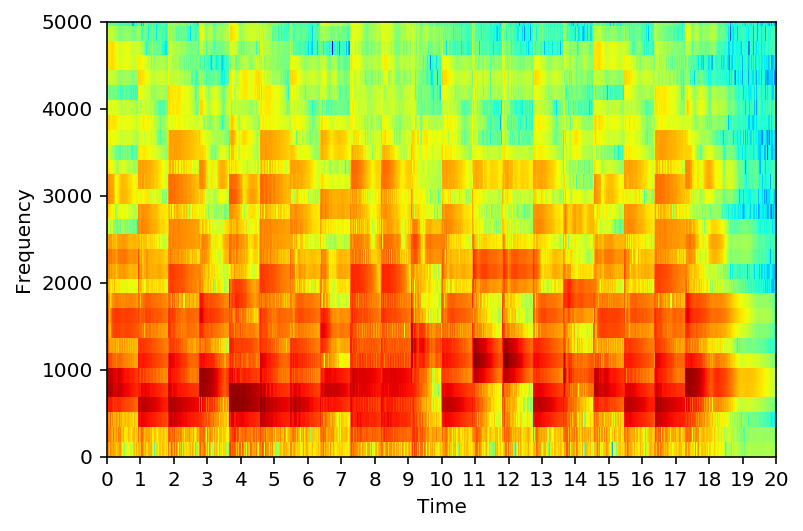

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-13.wav


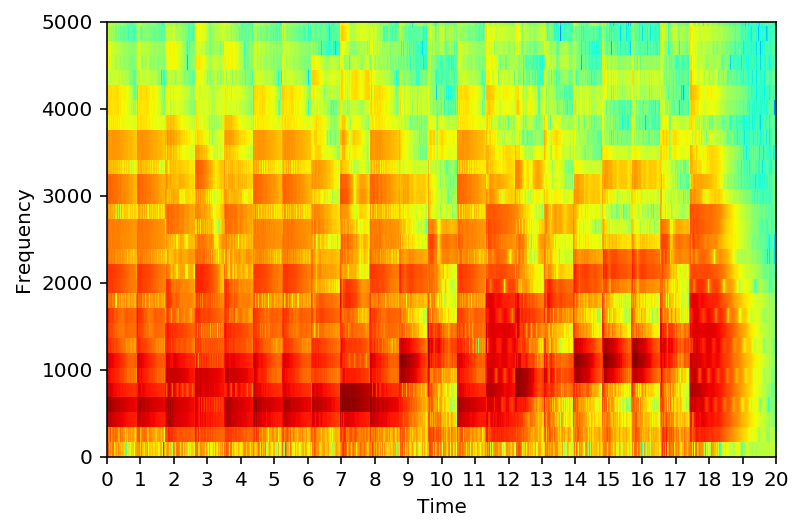

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-14.wav


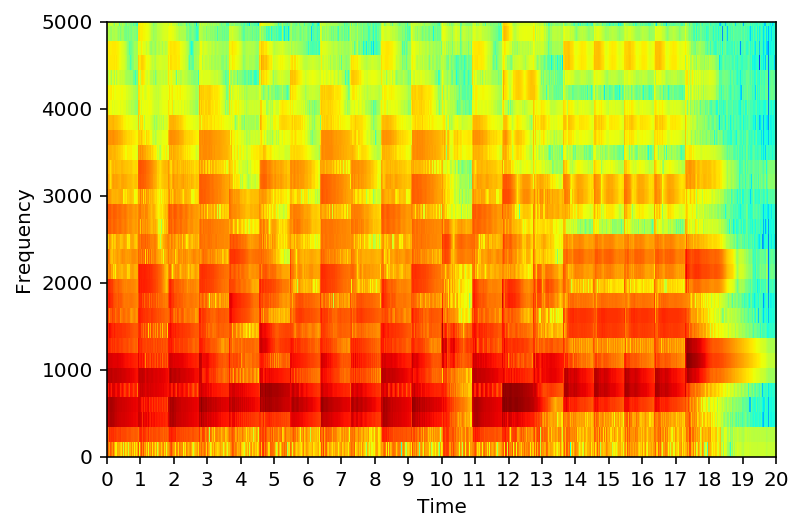

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-15.wav


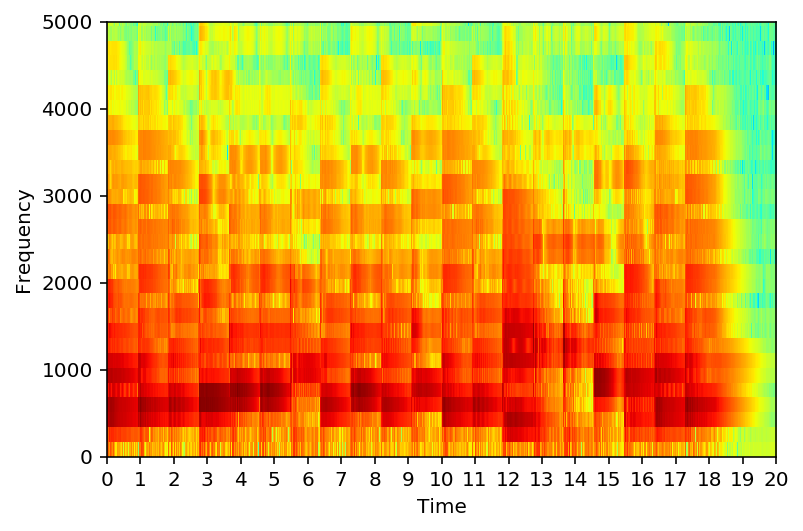

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-16.wav


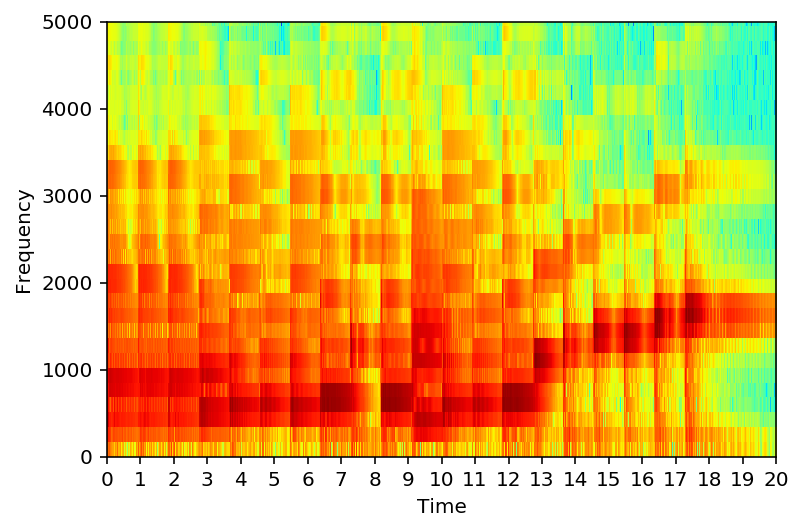

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/beethoven/filled-17.wav


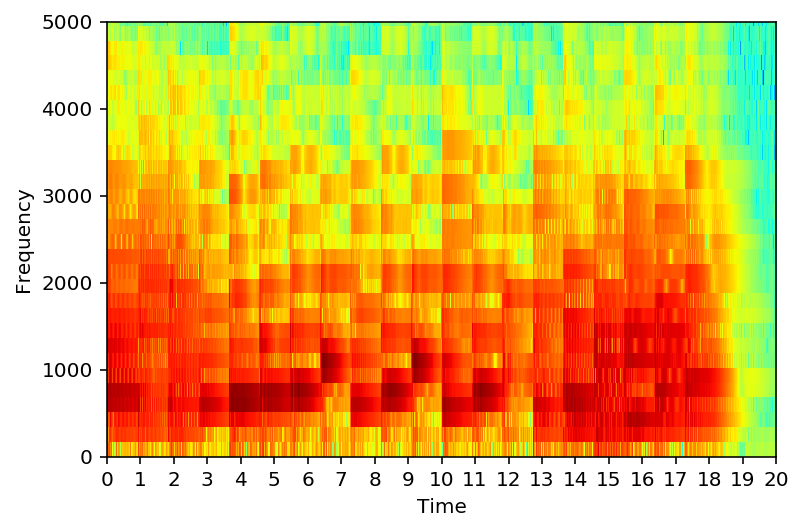

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/mono_orig.txt
C5 C6 C6 C5 C6 C6 C5 C6 C6 C5 C6 C6 C5 C6 C6 C5 C6 C6 C5 C6
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-1.wav


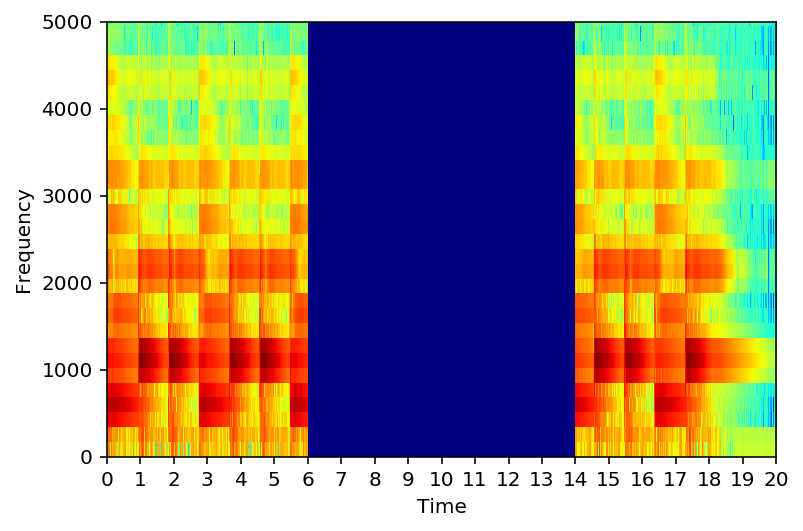

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-2.wav


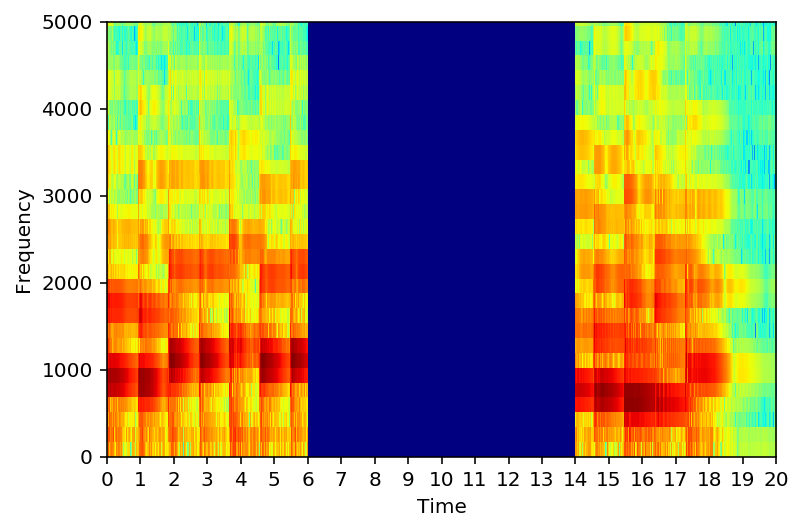

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-3.wav


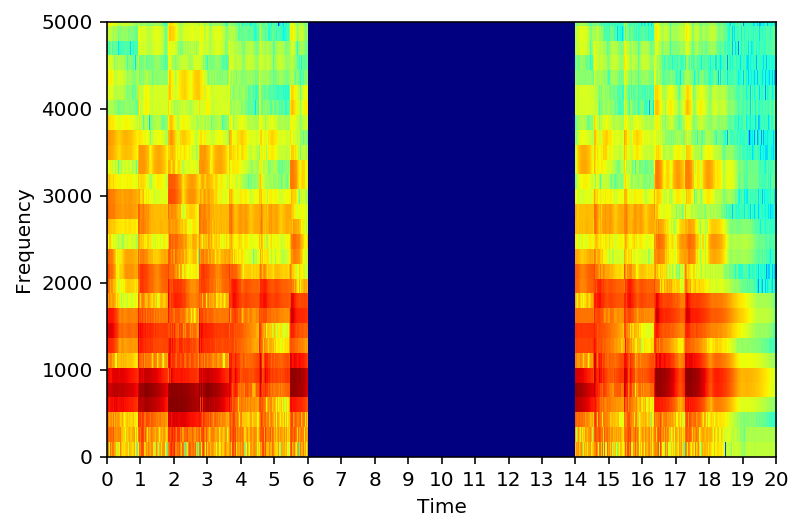

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-4.wav


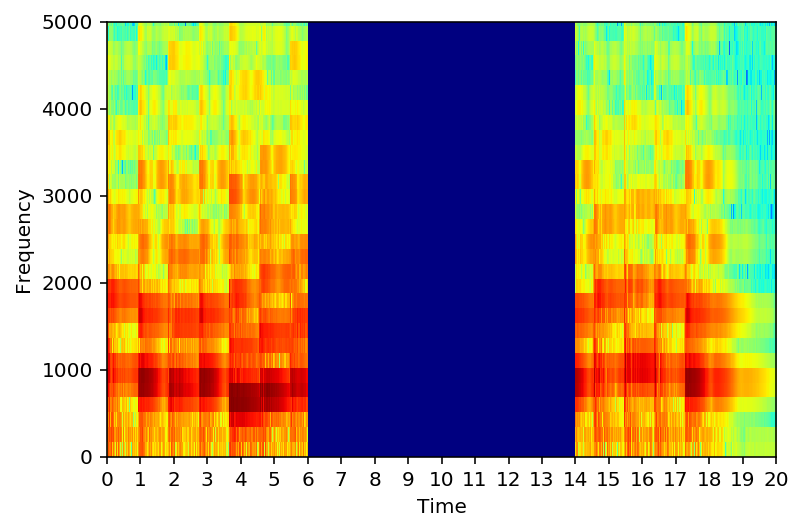

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-5.wav


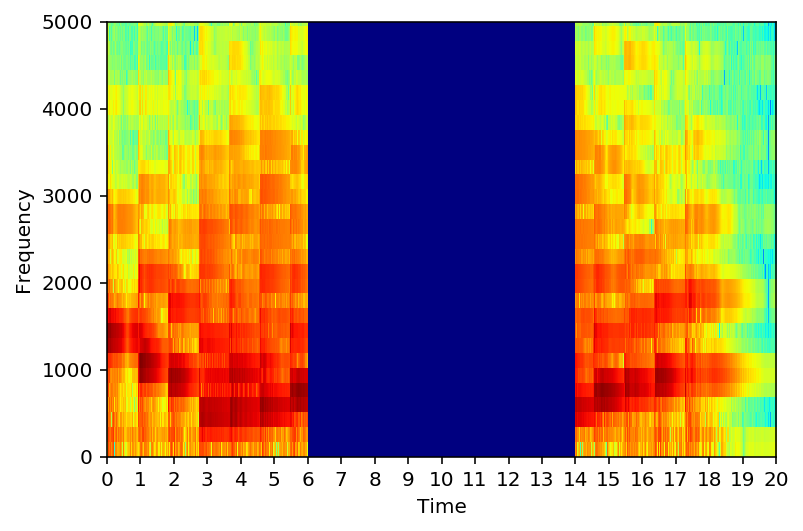

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-6.wav


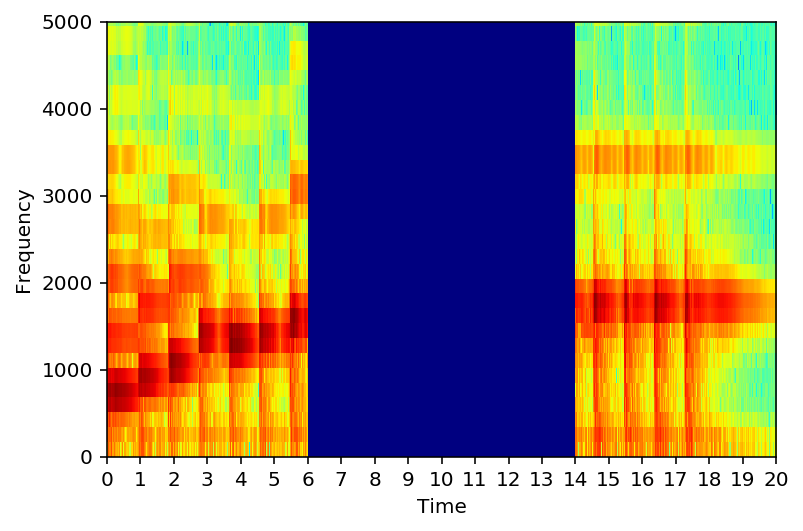

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-7.wav


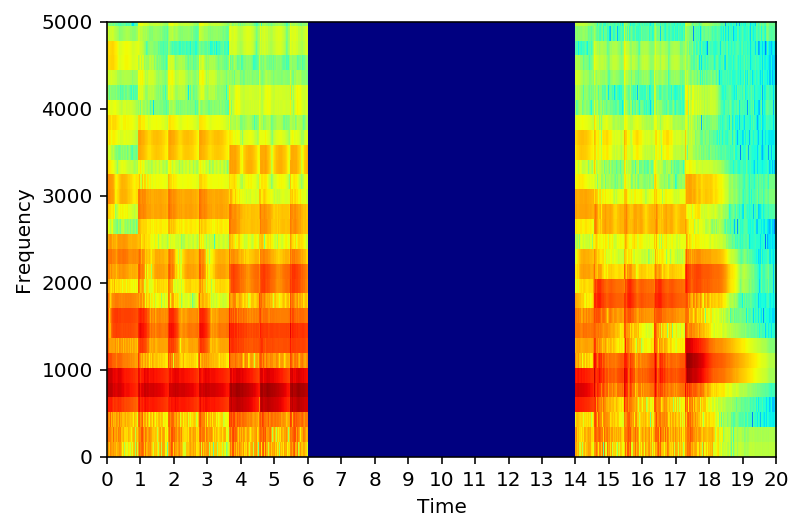

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-8.wav


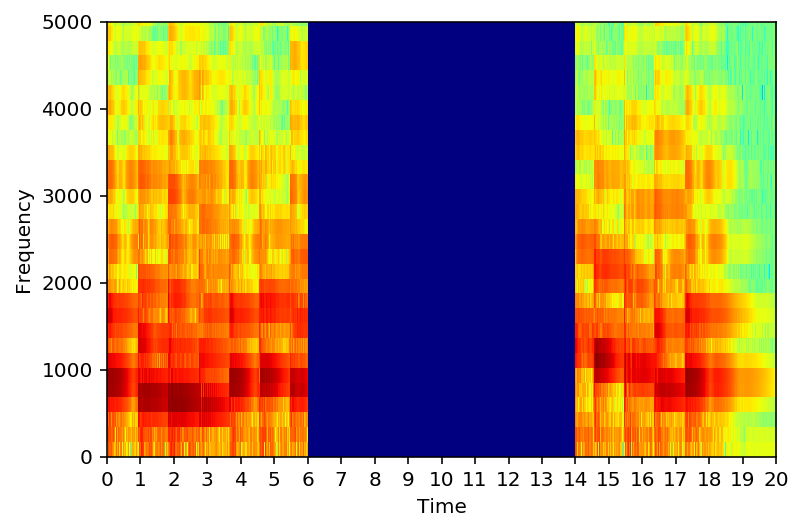

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-9.wav


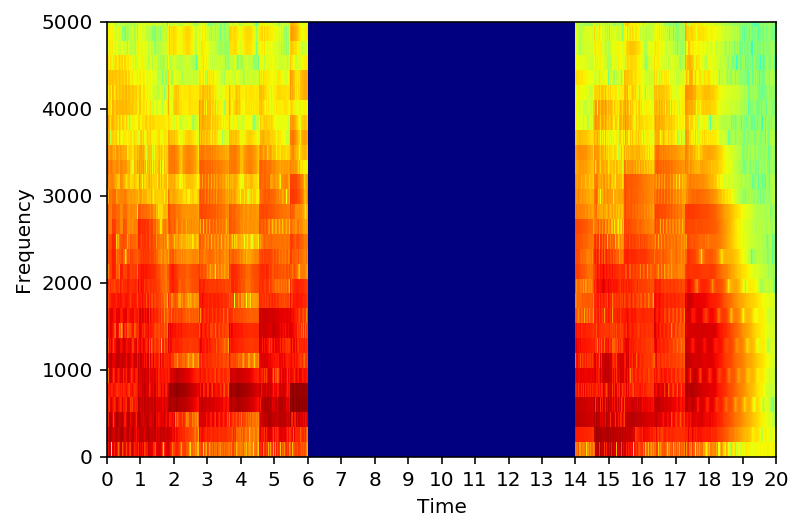

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-10.wav


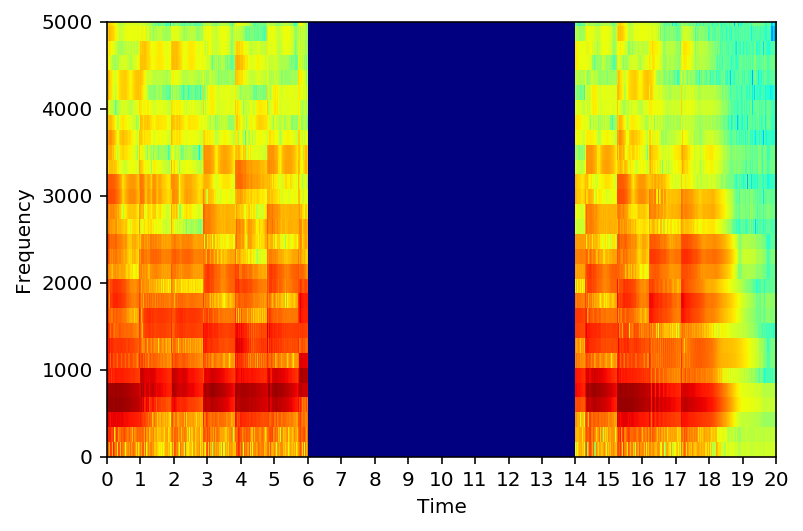

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-11.wav


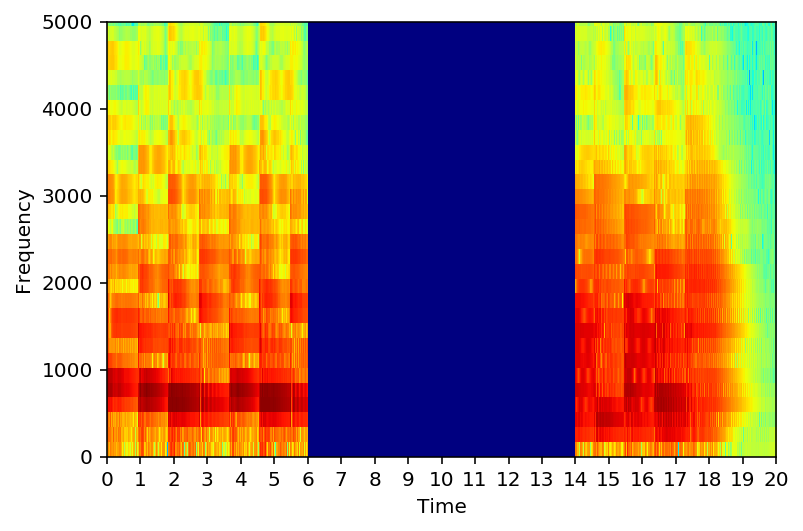

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-12.wav


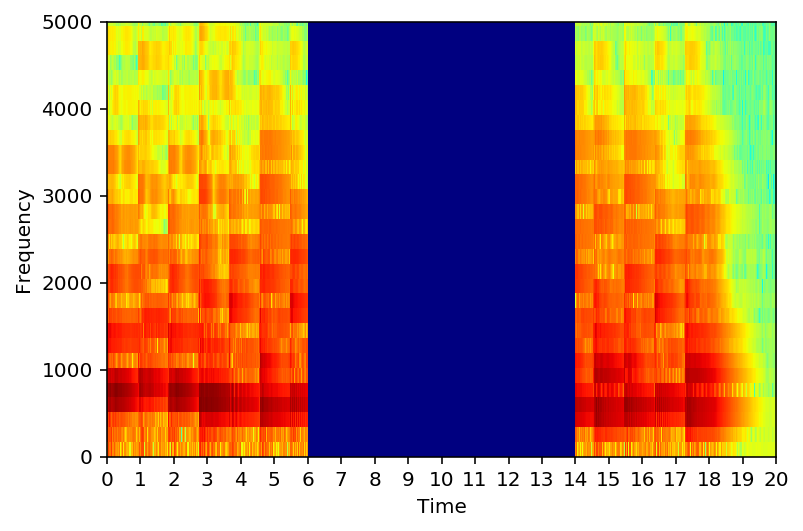

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-13.wav


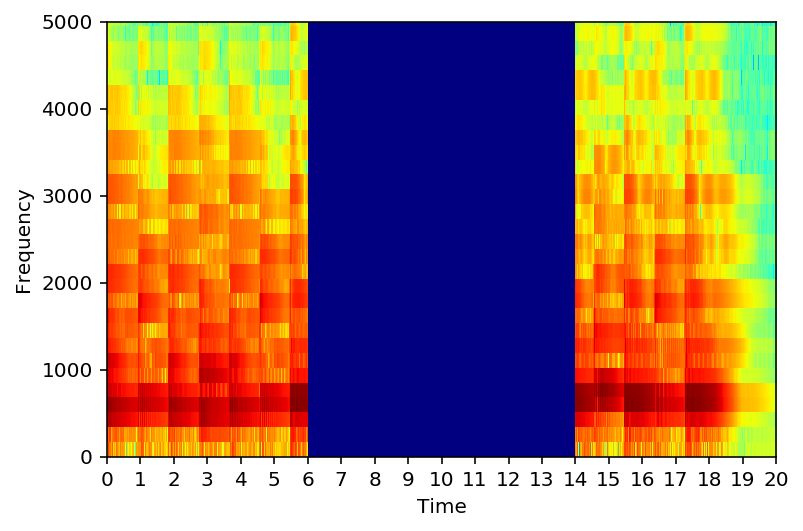

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-14.wav


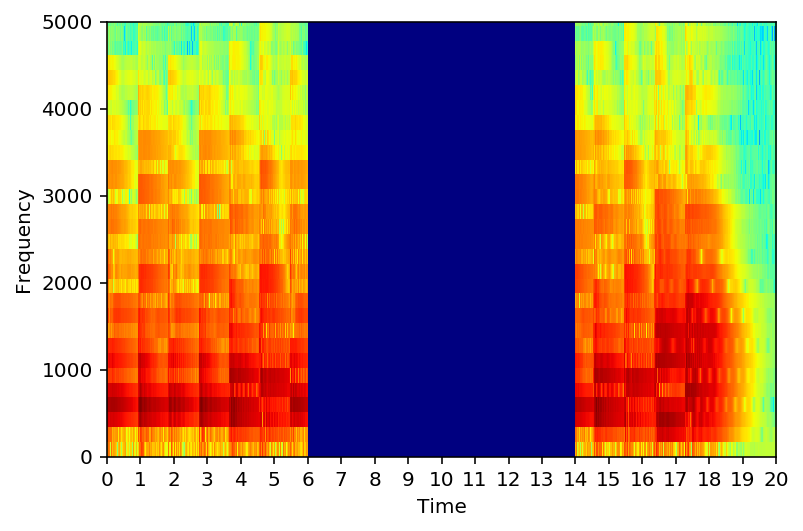

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-15.wav


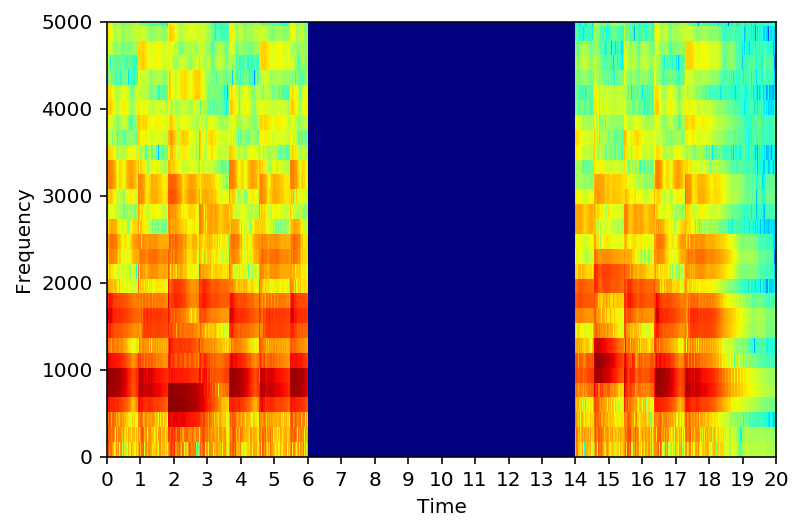

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-16.wav


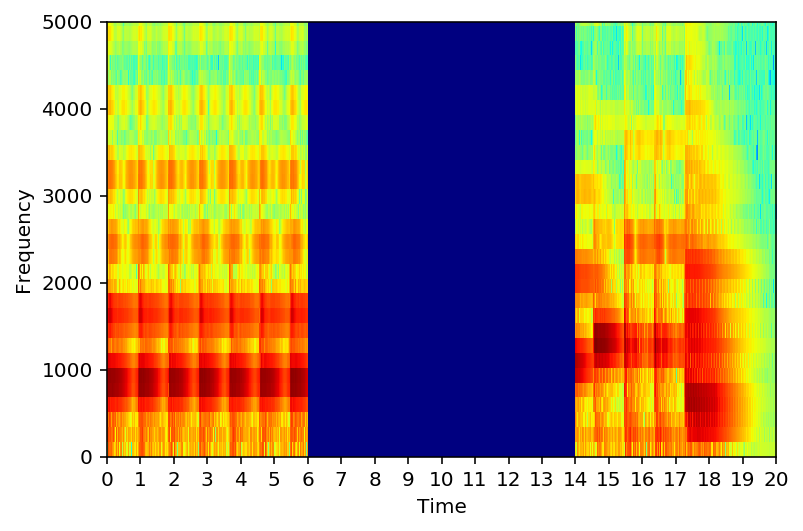

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-17.wav


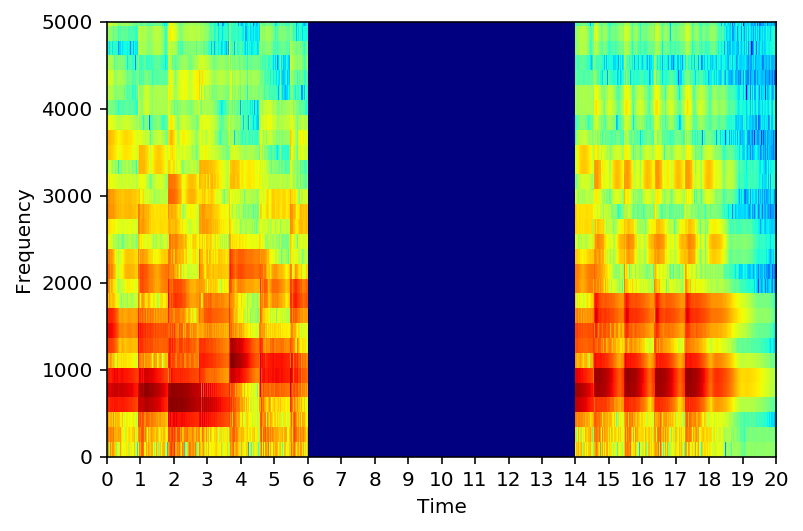

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-18.wav


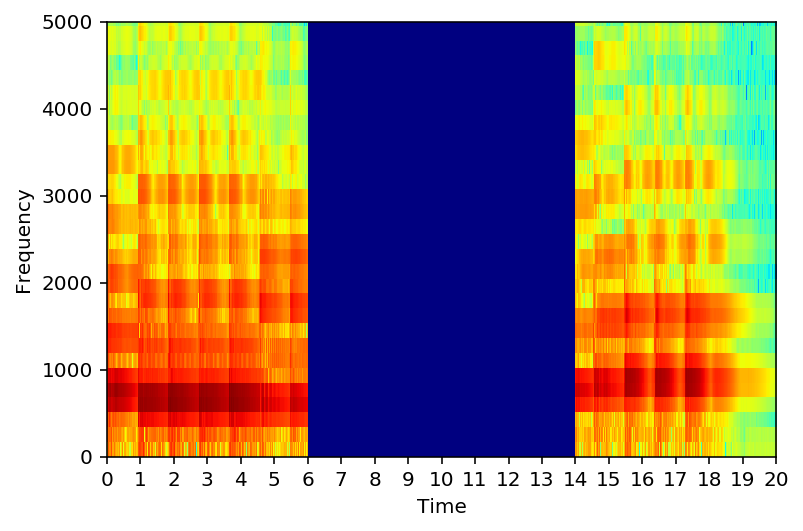

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-19.wav


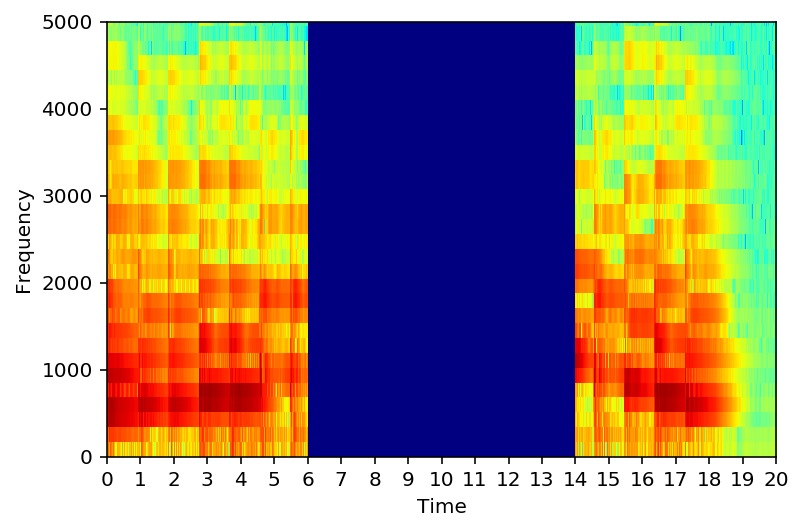

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-20.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/orig-20.wav


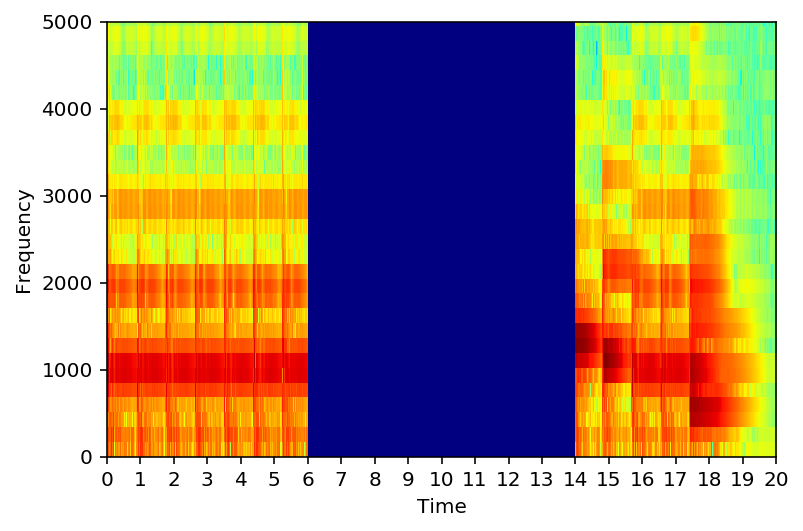

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-1.wav


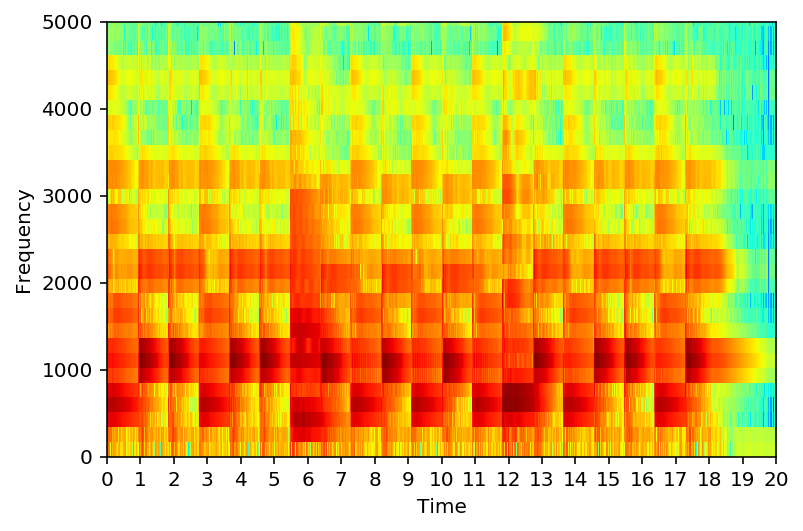

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-2.wav


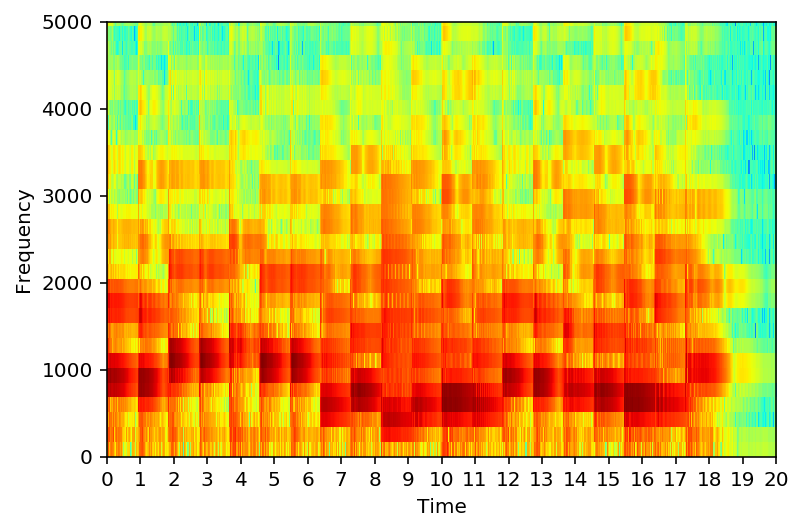

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-3.wav


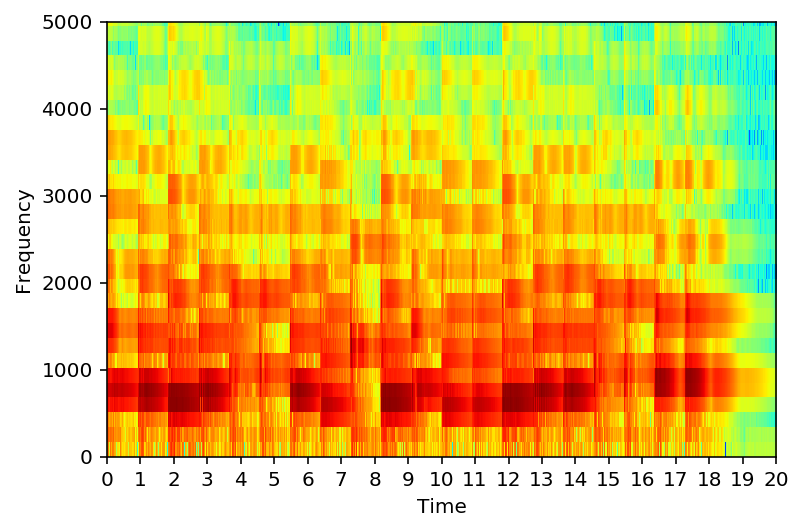

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-4.wav


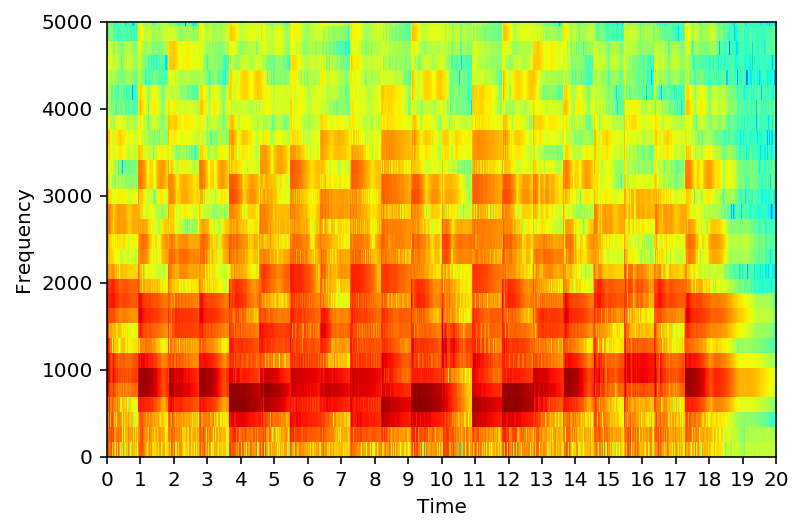

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-5.wav


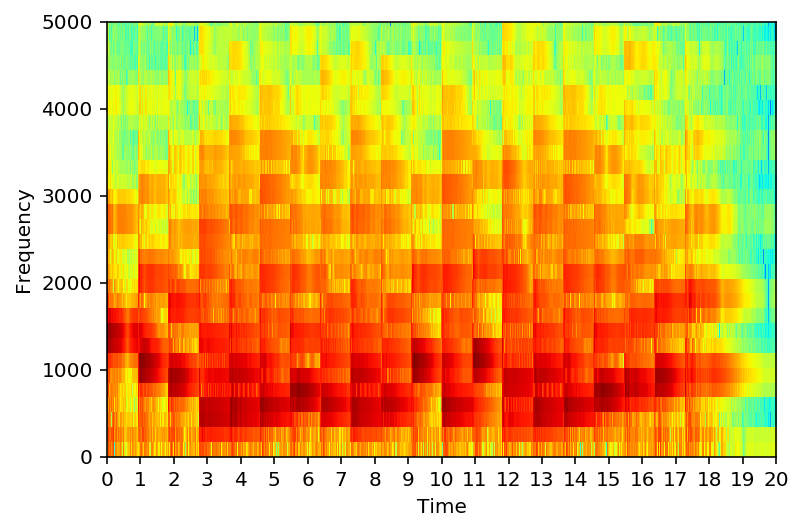

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-6.wav


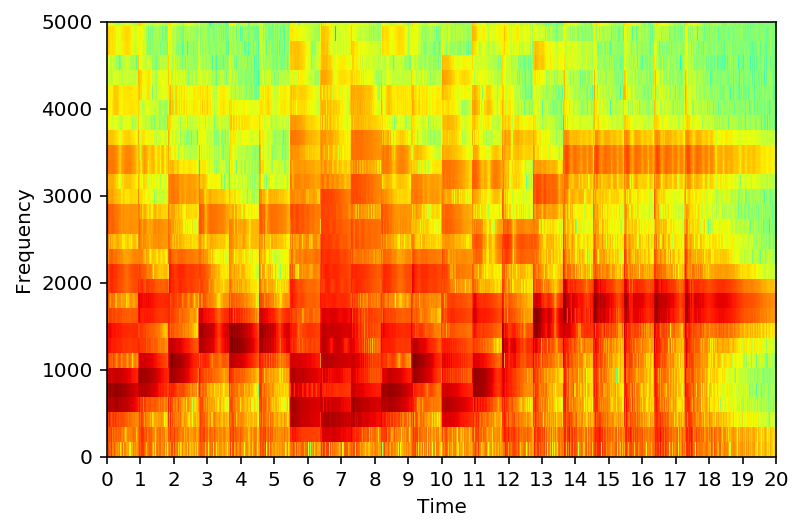

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-7.wav


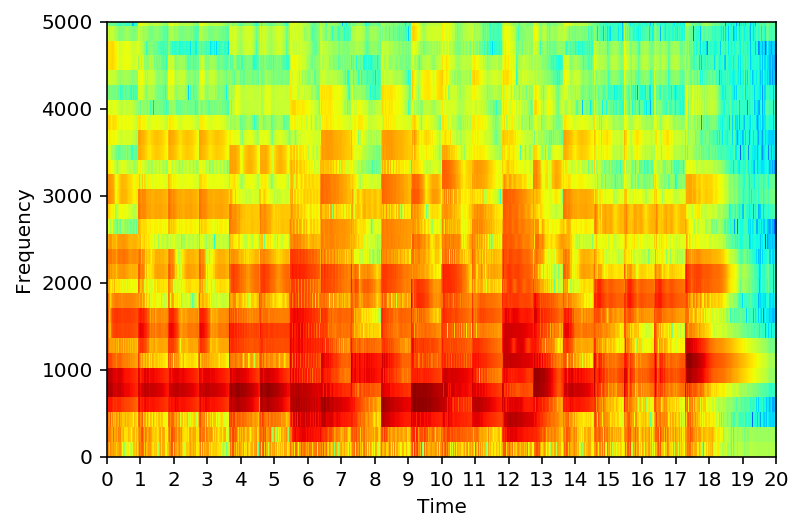

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-8.wav


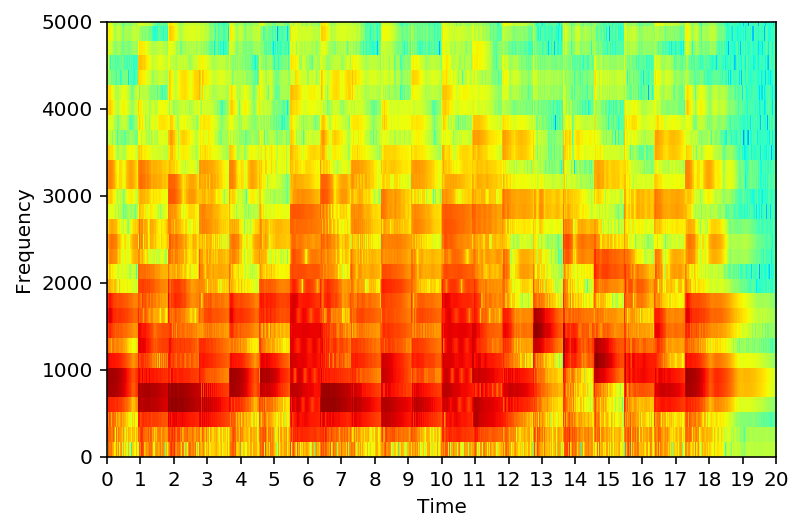

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-9.wav


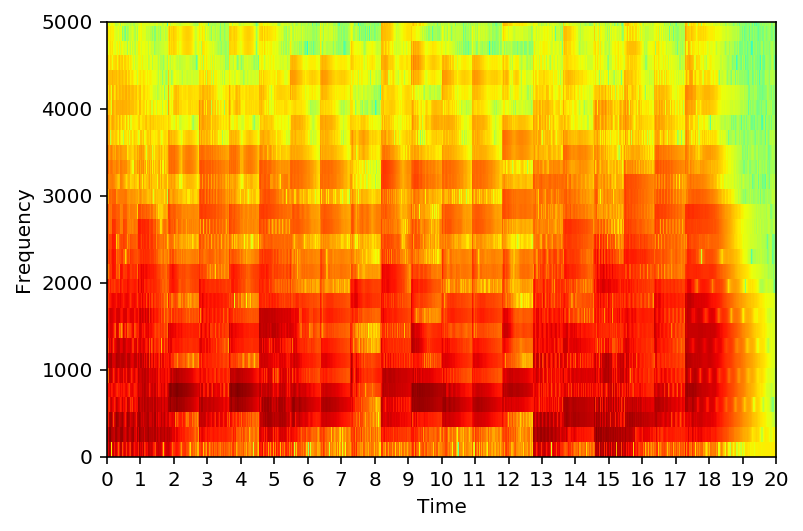

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-10.wav


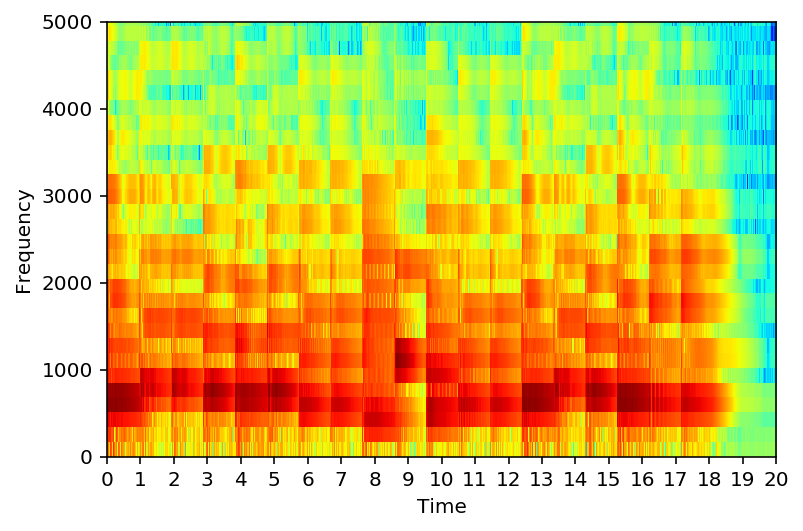

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-11.wav


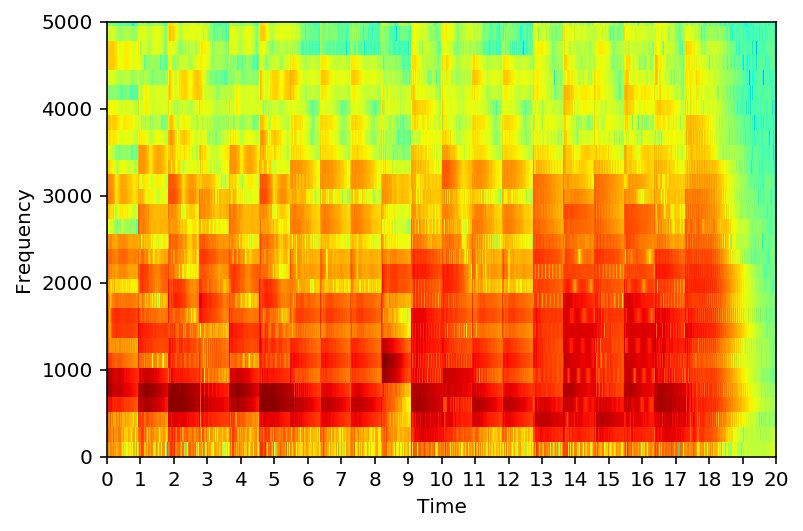

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-12.wav


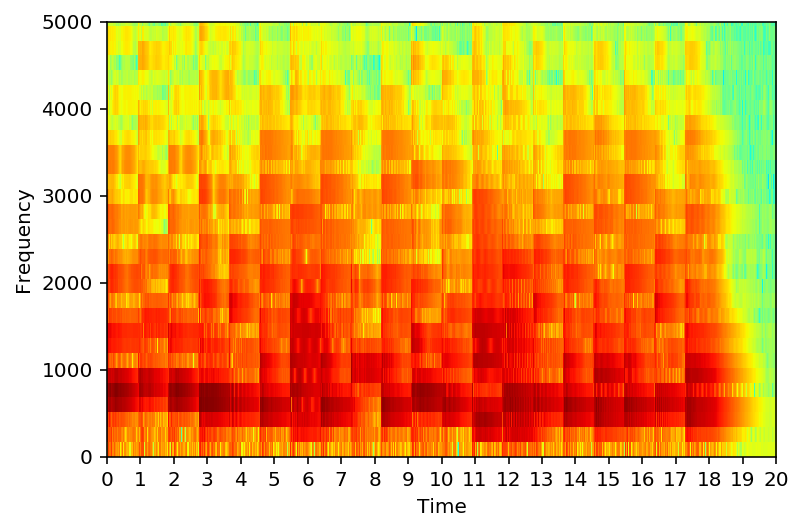

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-13.wav


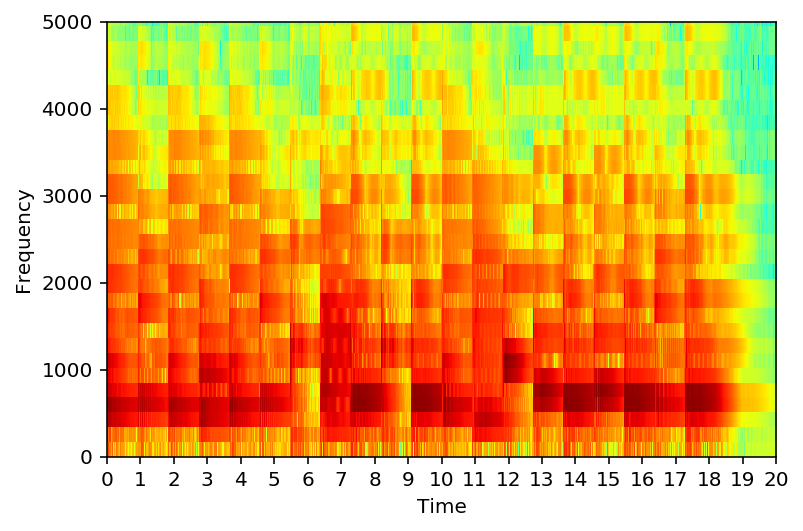

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-14.wav


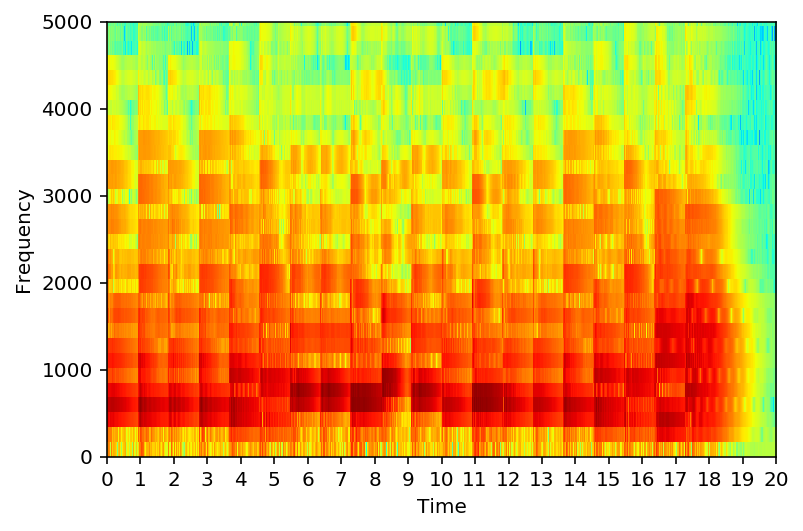

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-15.wav


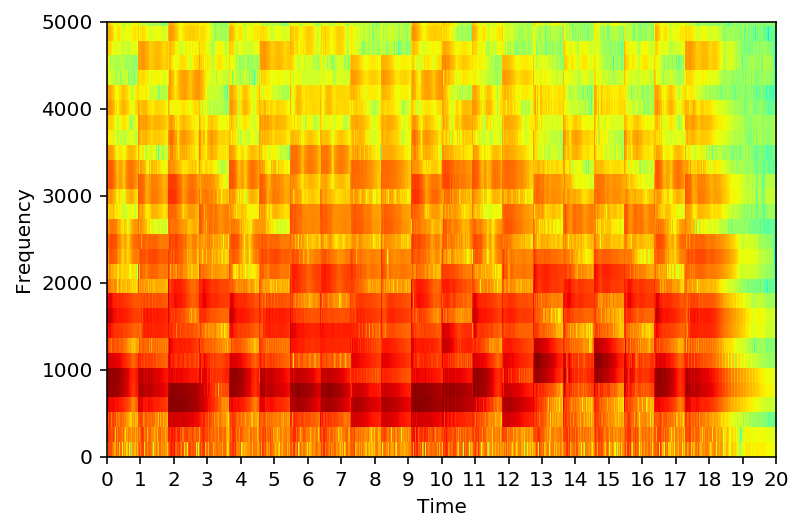

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-16.wav


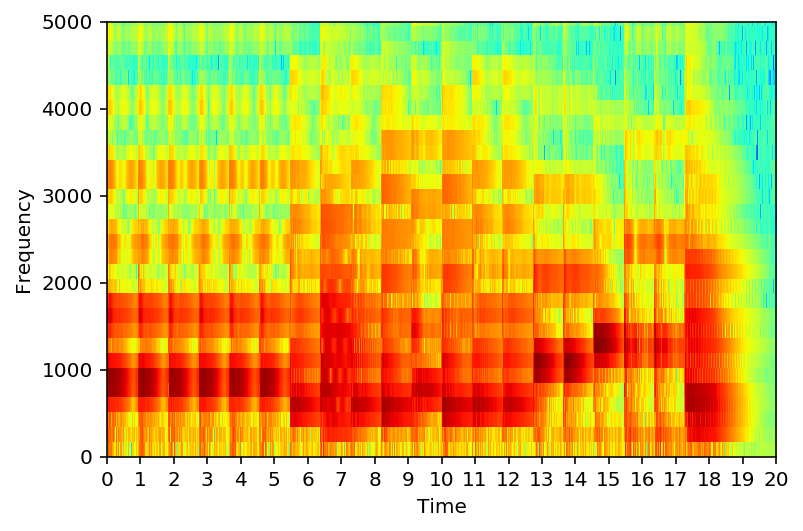

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-17.wav


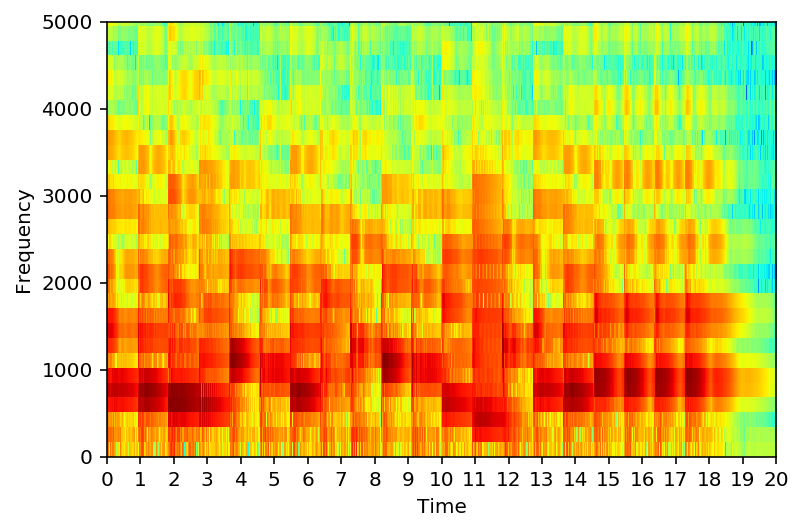

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-18.wav


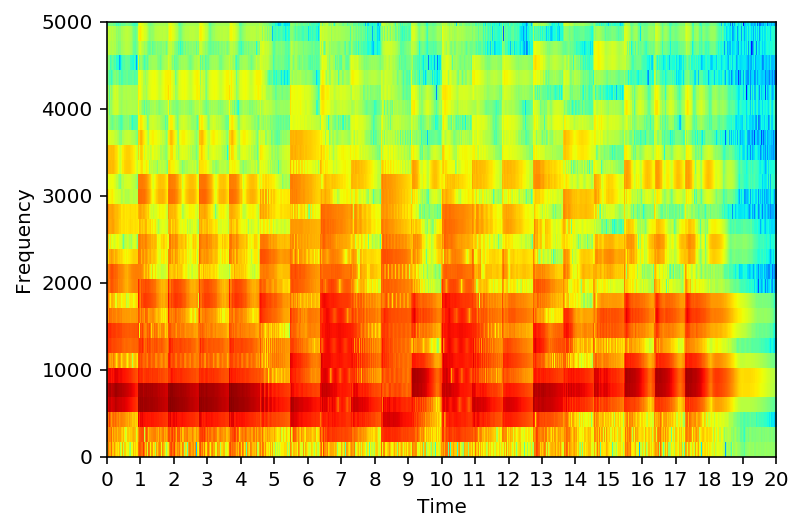

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-19.wav


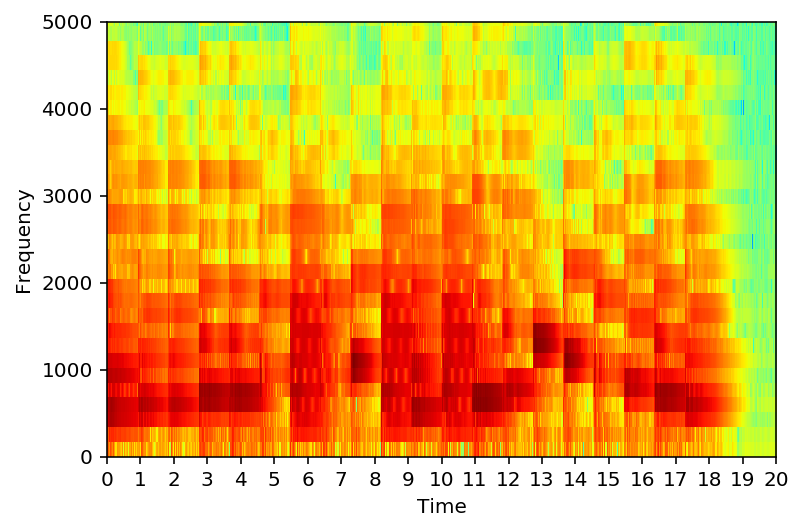

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-20.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/beethoven/filled-20.wav


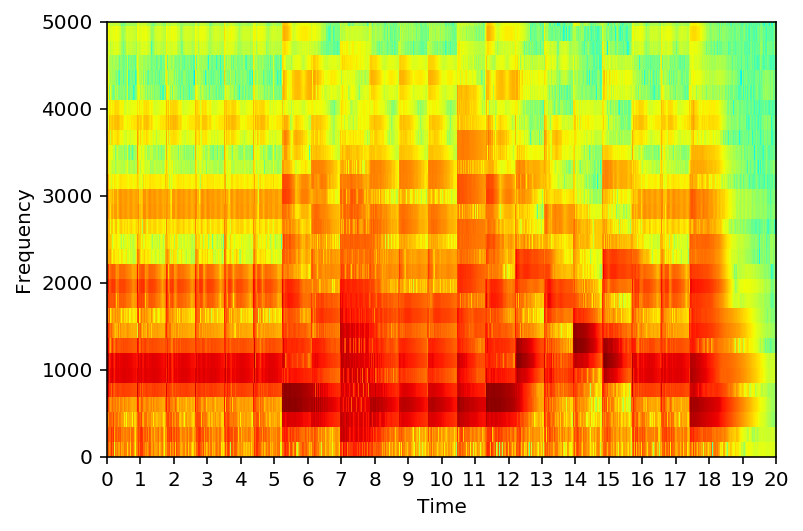

read ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/mono_orig.txt
B-6 C#6 G#6 F6 C#6 G#5 B-5 F#5 E-5 G#5 F#5 F5 B5 B-5 G#6 F6 C#6 G#5 B-5 F5
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-1.wav


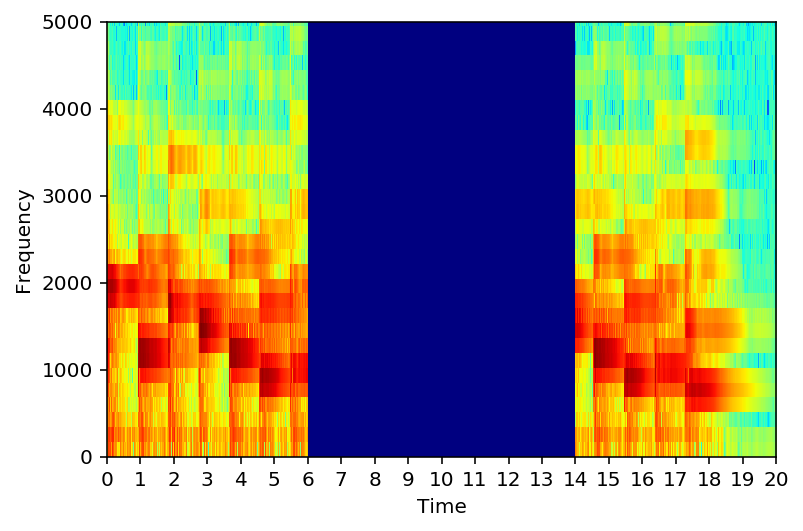

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-2.wav


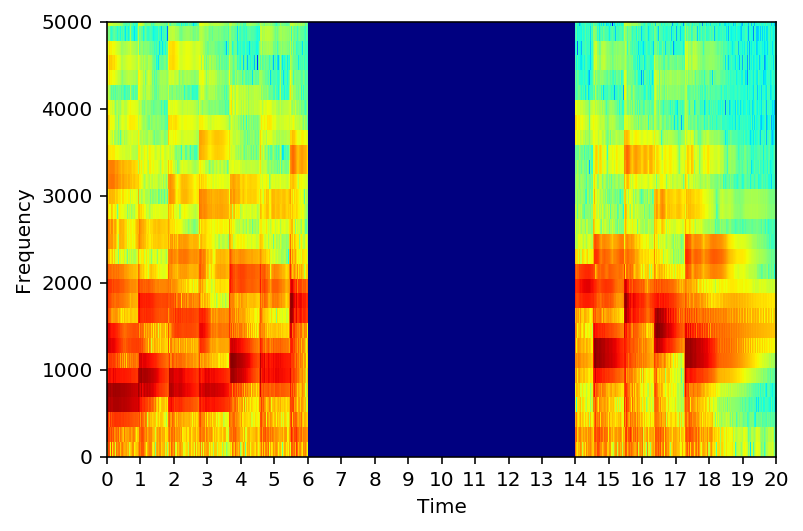

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-3.wav


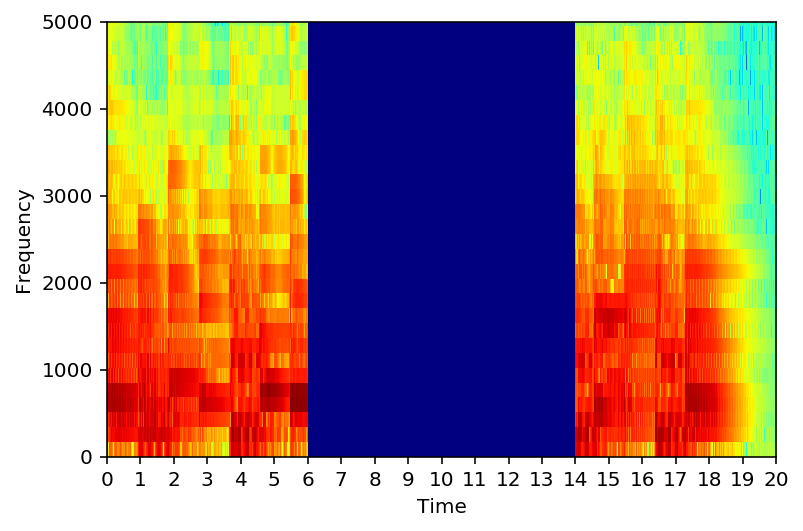

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-4.wav


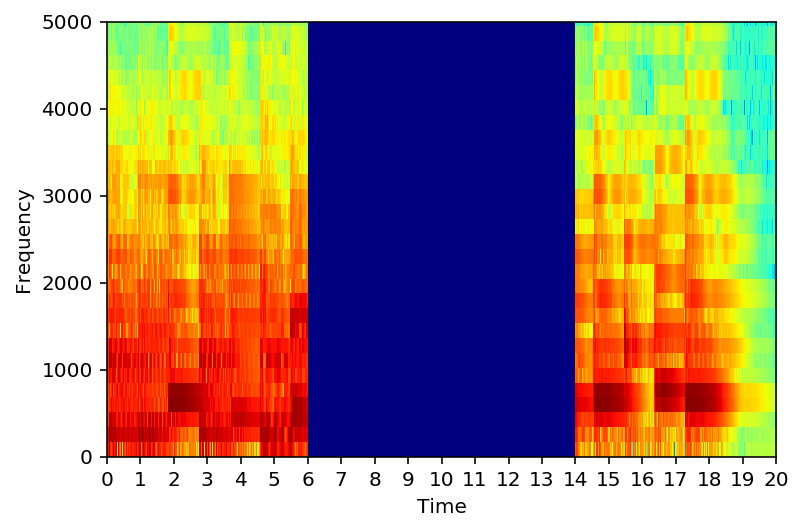

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-5.wav


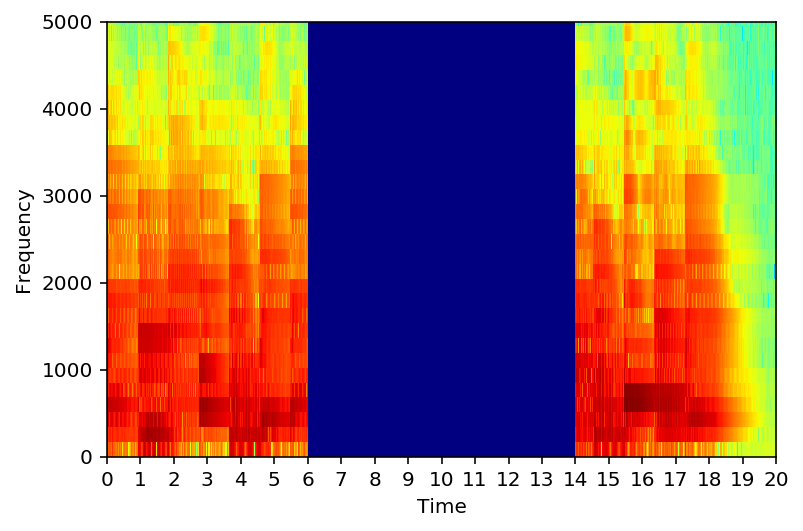

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-6.wav


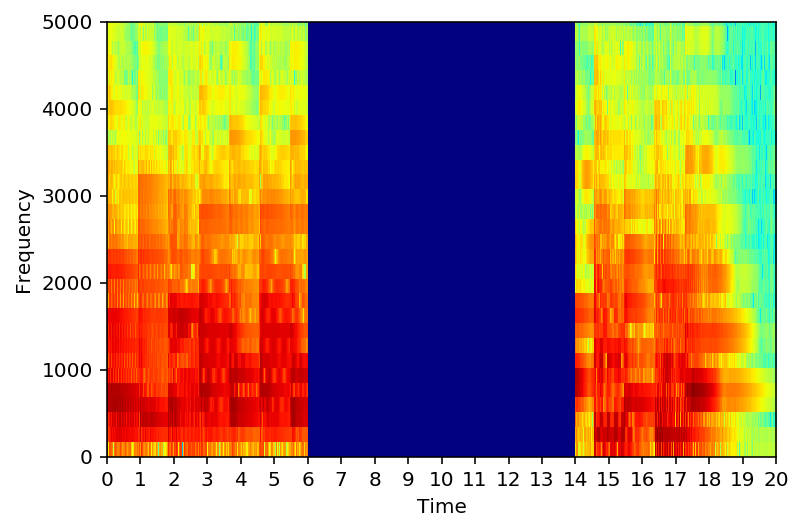

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-7.wav


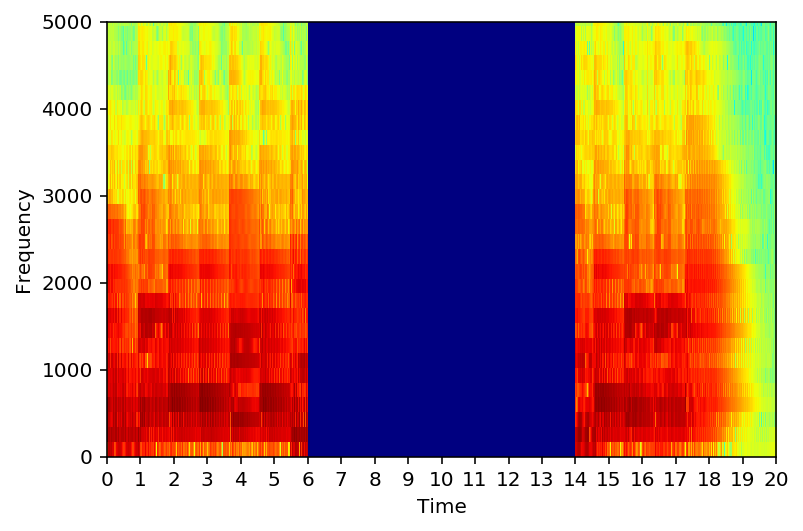

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-8.wav


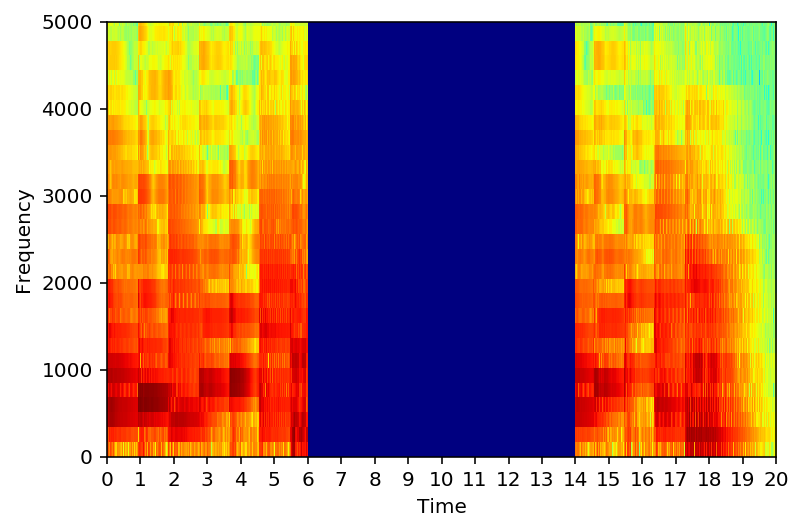

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-9.wav


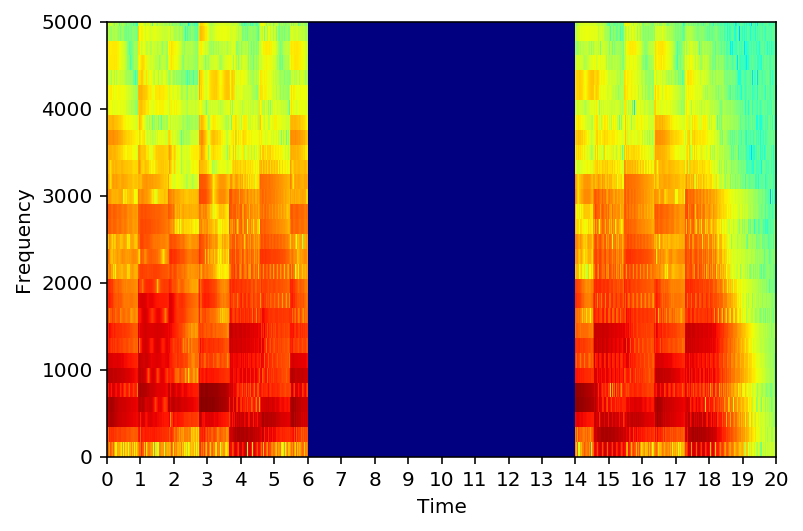

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-10.wav


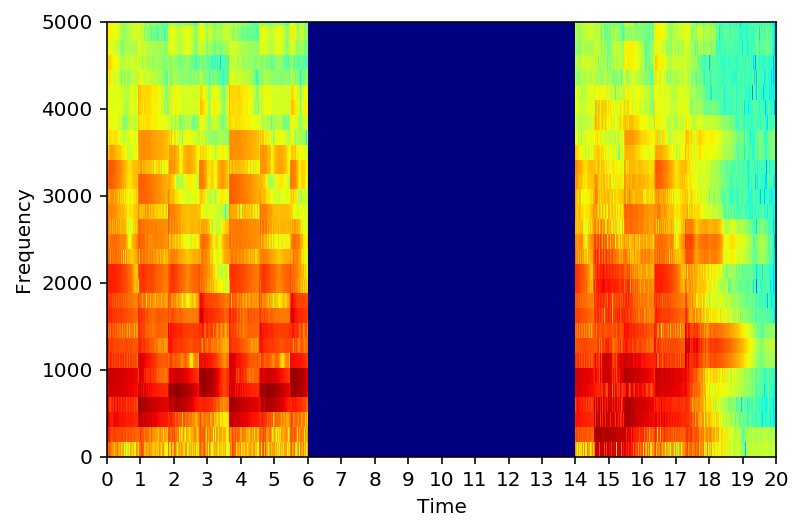

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-11.wav


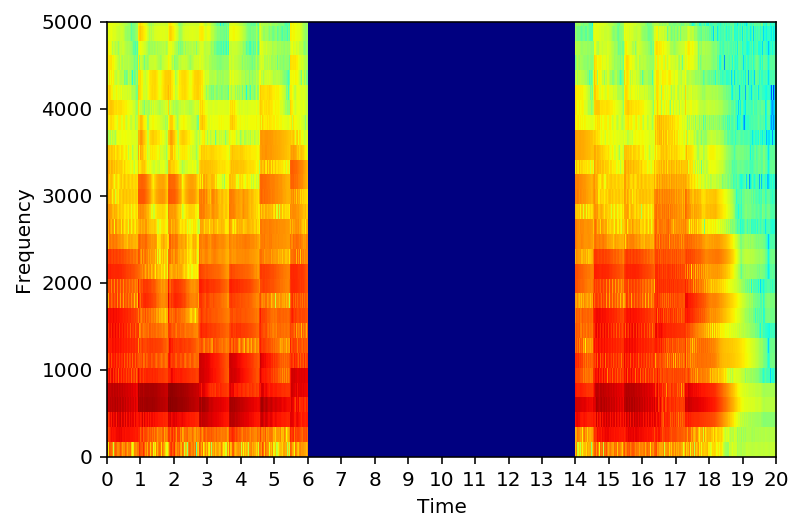

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-12.wav


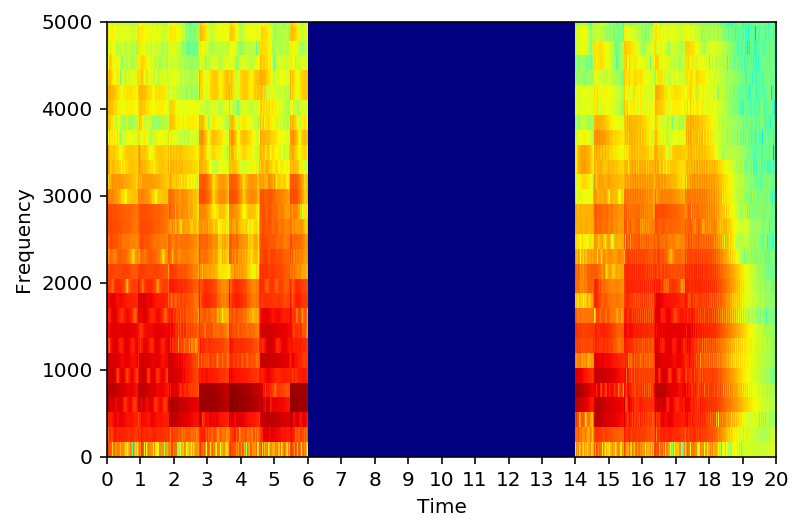

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-13.wav


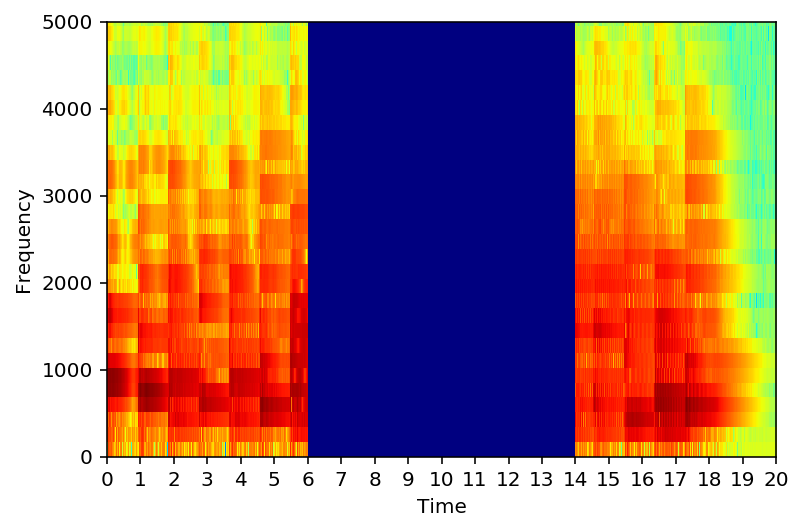

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-14.wav


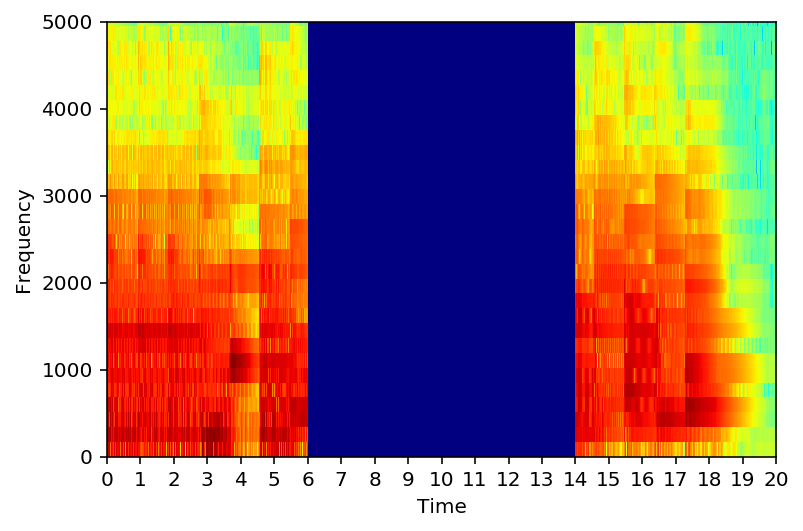

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-15.wav


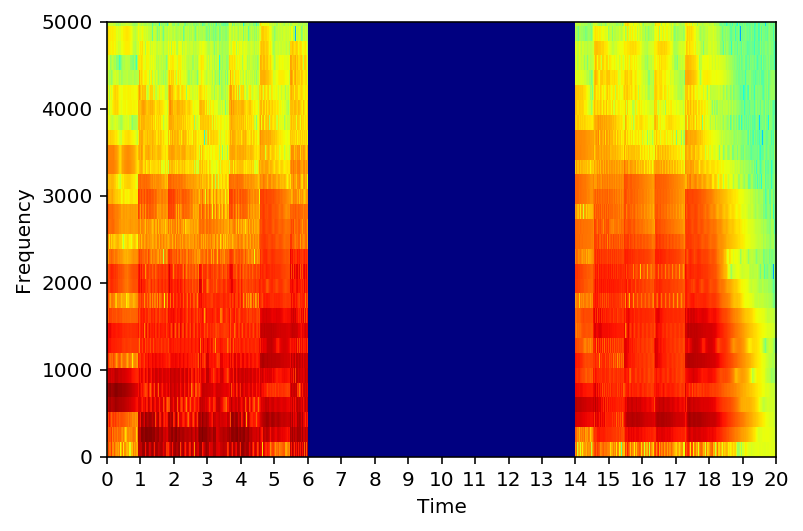

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-16.wav


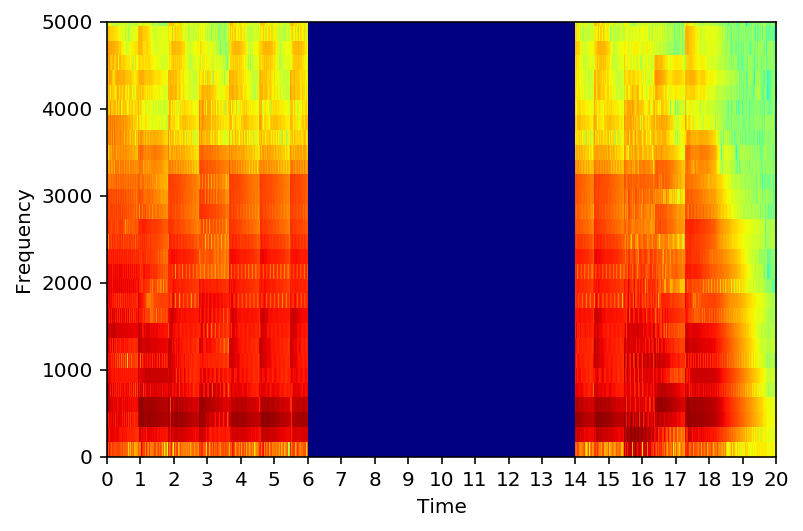

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-17.wav


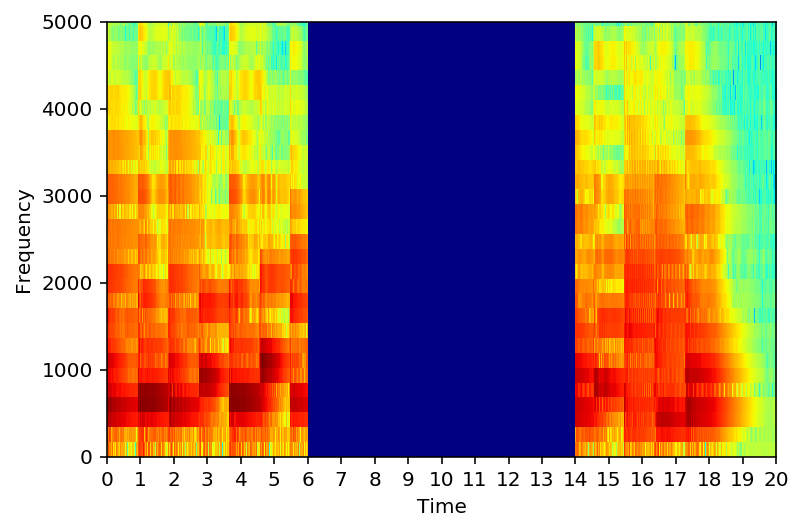

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-18.wav


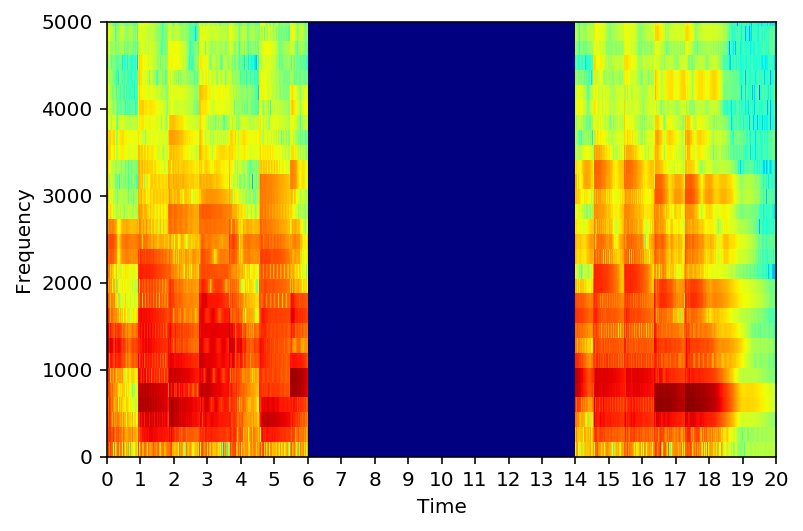

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-19.wav


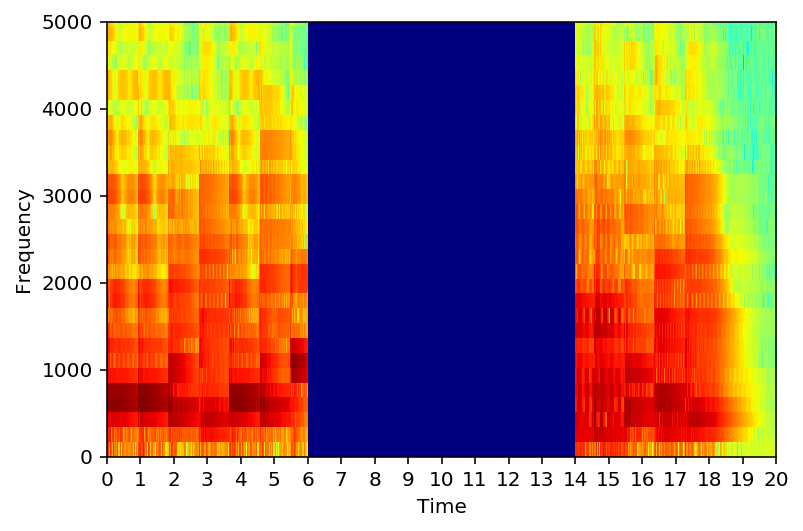

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-20.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/orig-20.wav


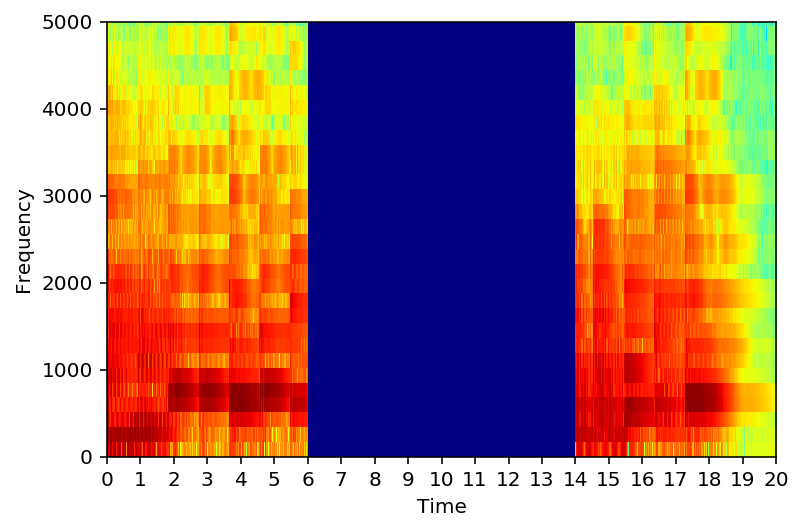

read ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-1.wav


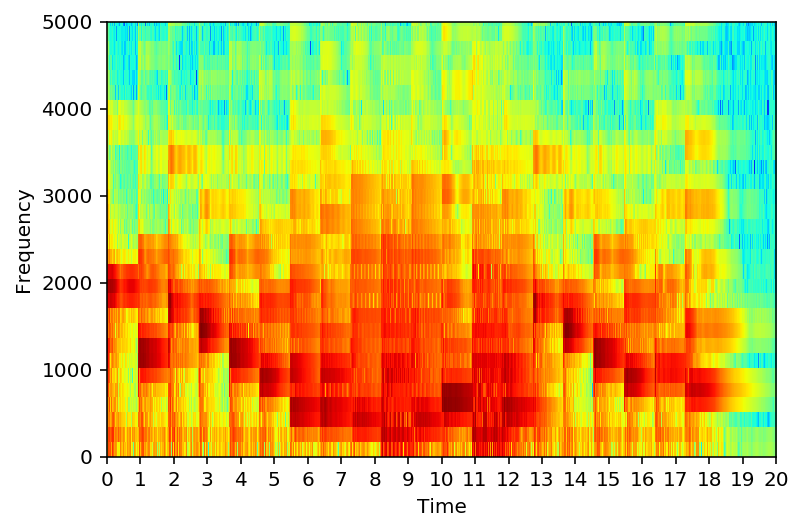

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-2.wav


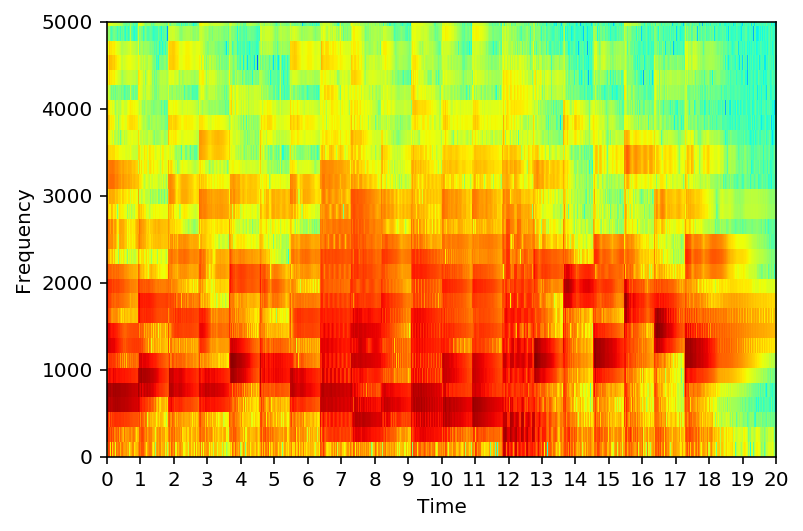

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-3.wav


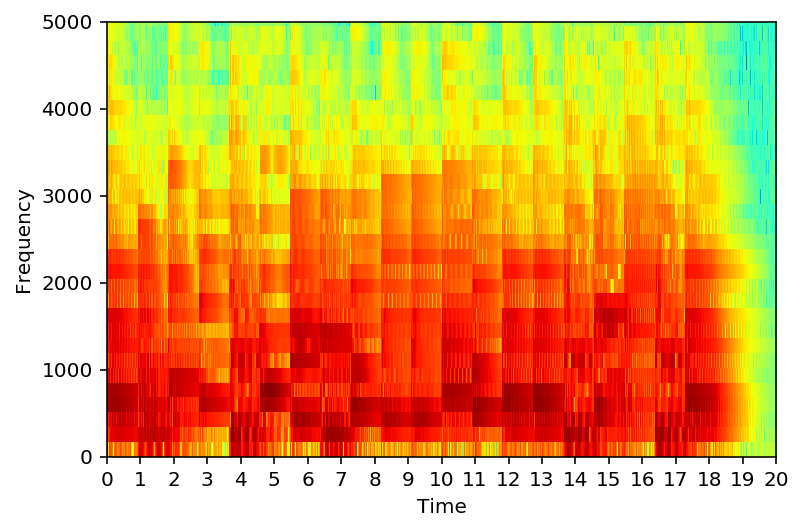

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-4.wav


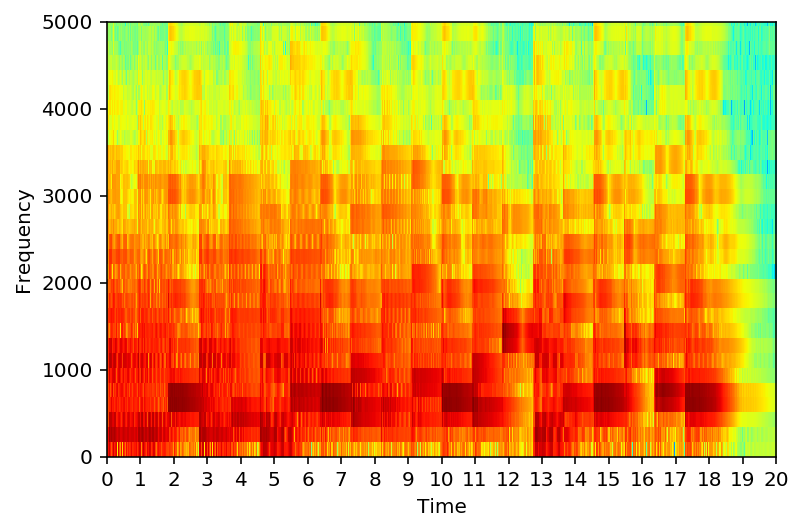

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-5.wav


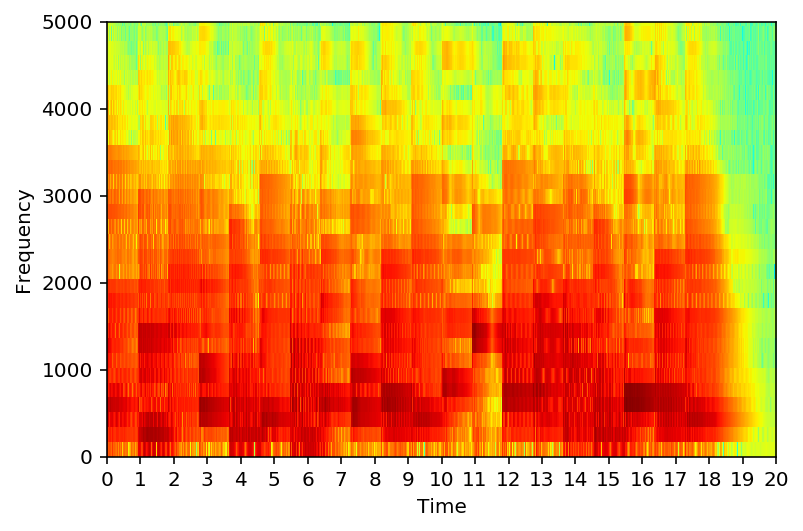

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-6.wav


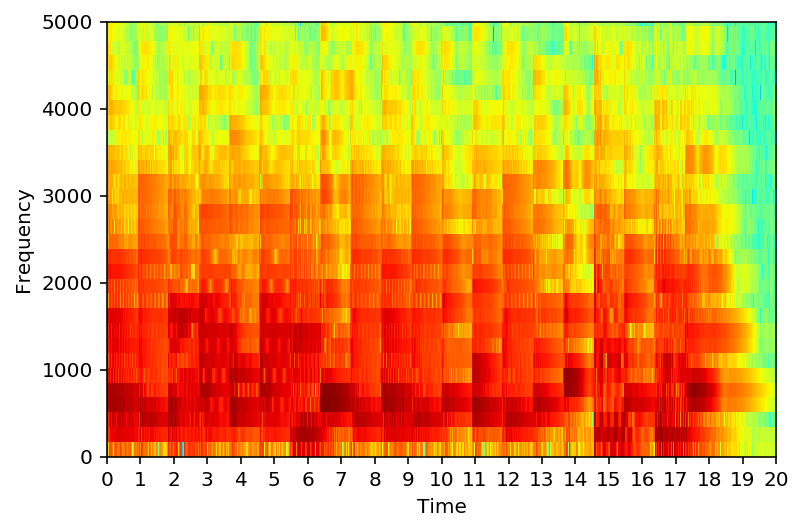

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-7.wav


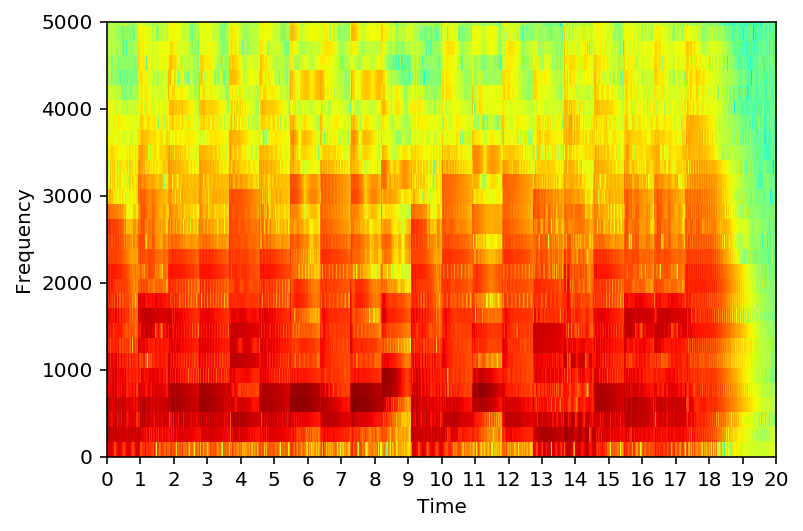

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-8.wav


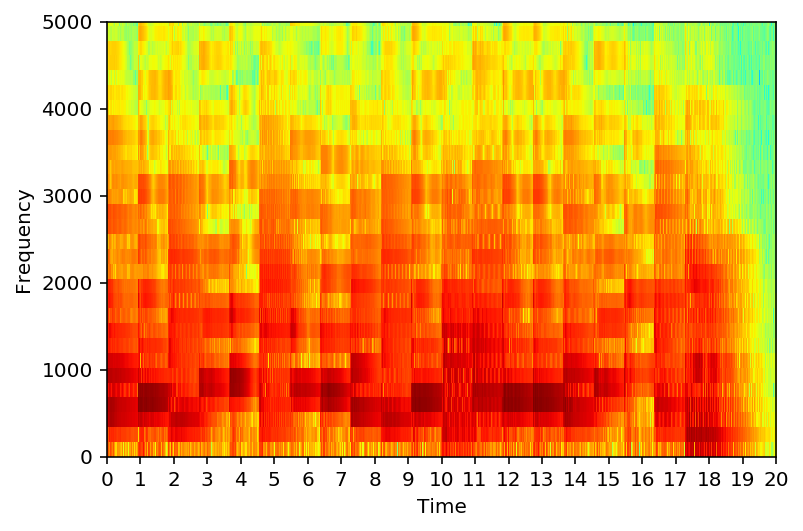

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-9.wav


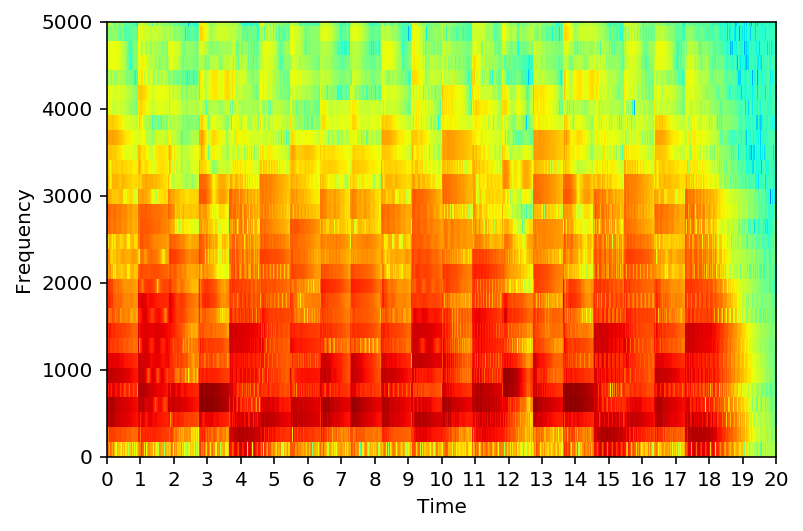

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-10.wav


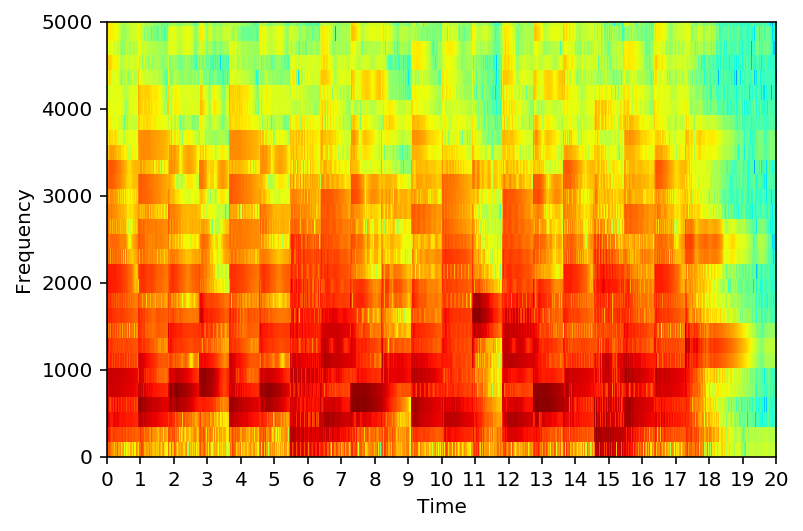

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-11.wav


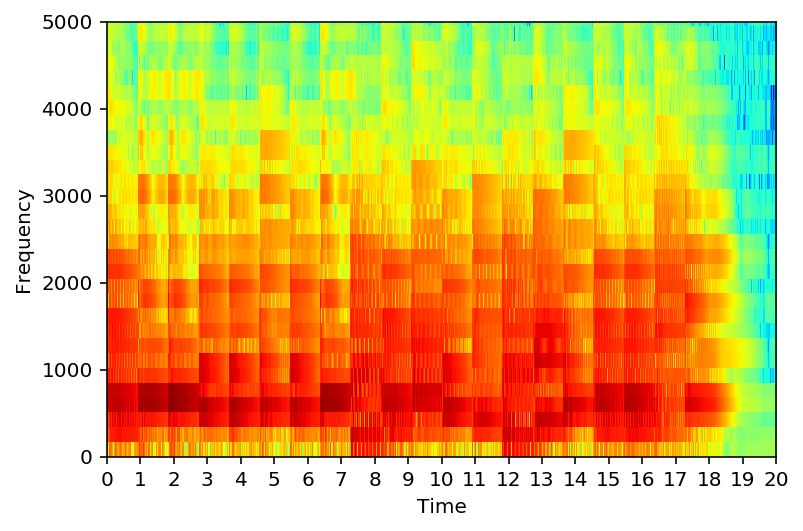

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-12.wav


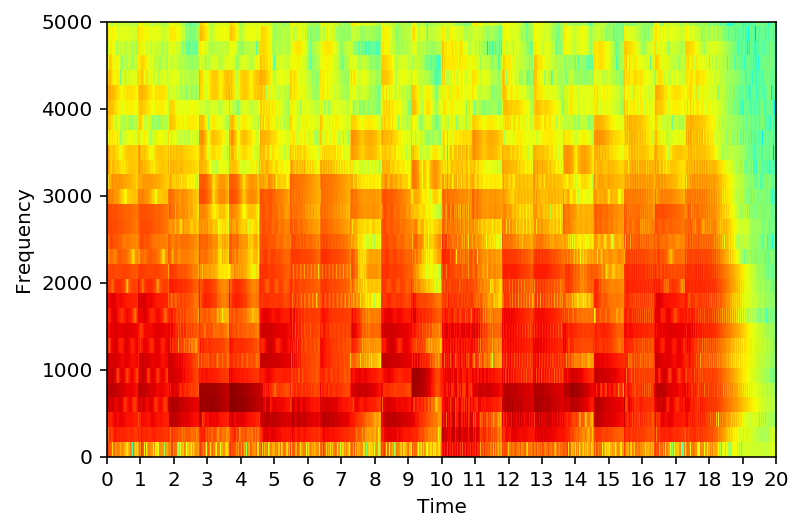

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-13.wav


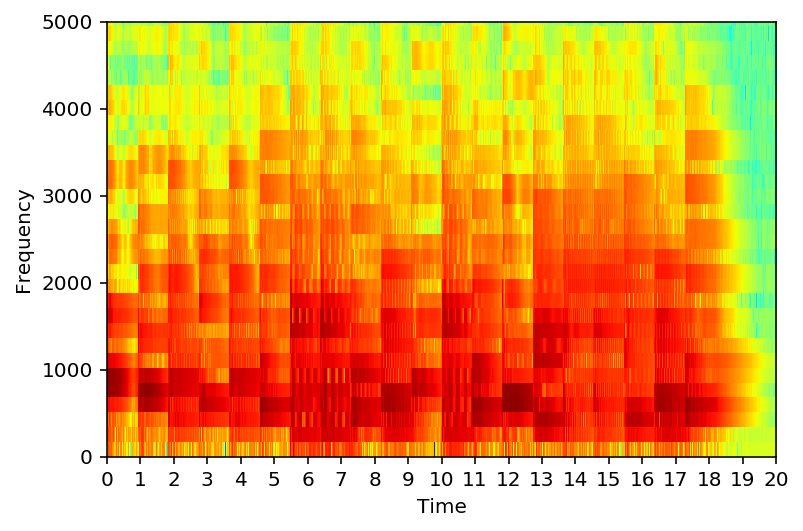

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-14.wav


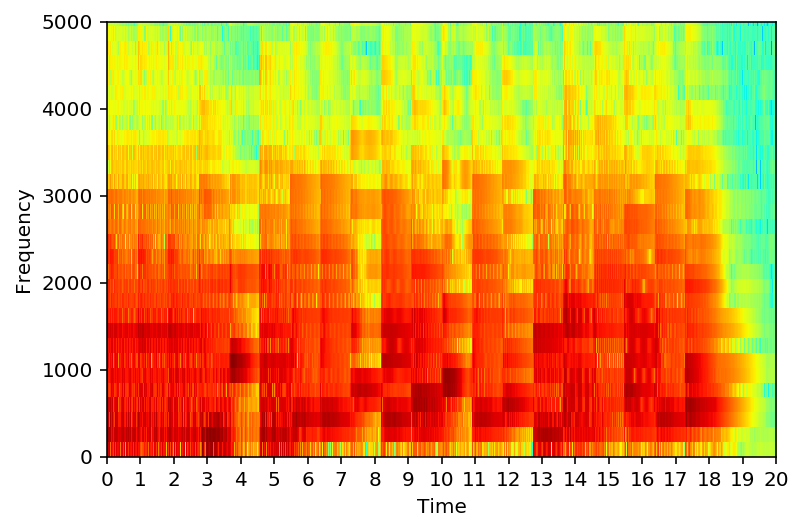

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-15.wav


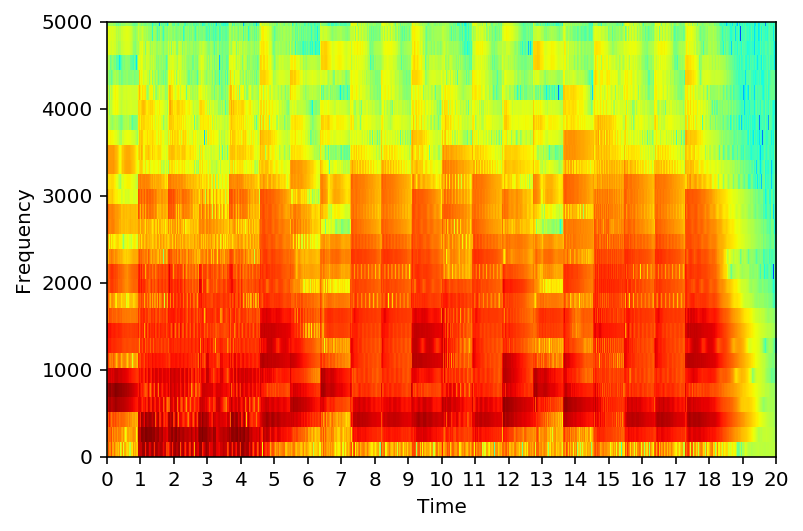

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-16.wav


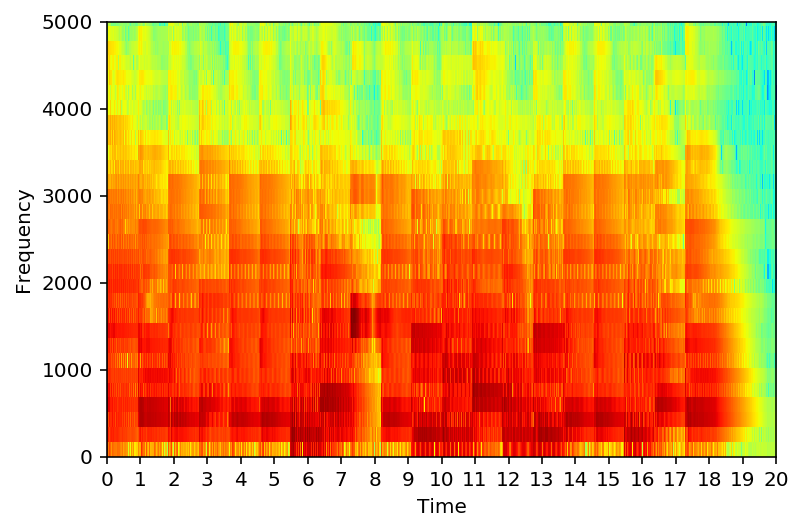

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-17.wav


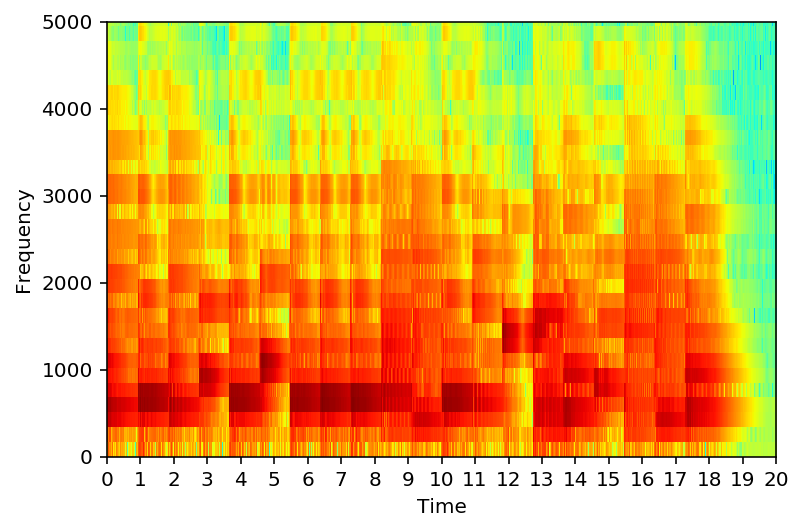

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-18.wav


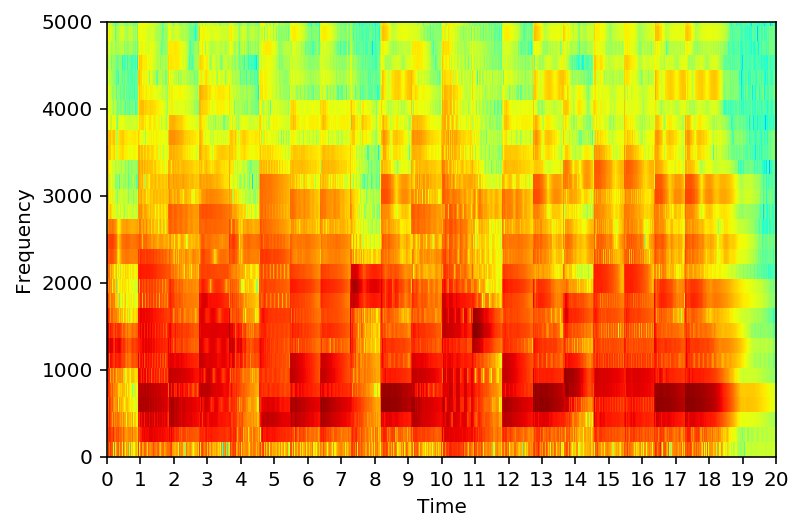

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-19.wav


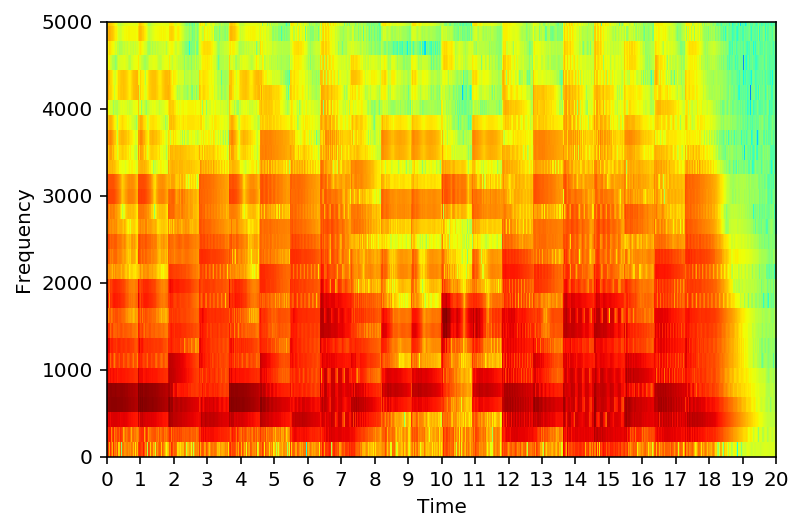

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-20.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/brahms/filled-20.wav


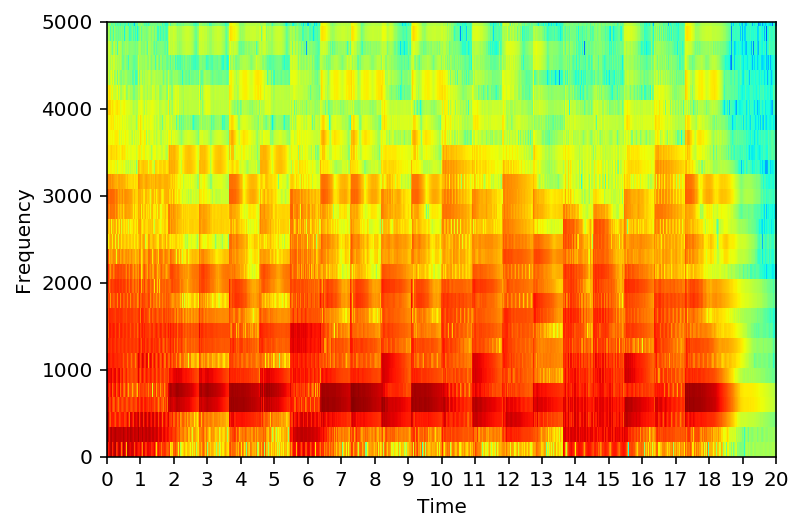

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/mono_orig.txt
F2 F5 C7 F3 E-5 C5 E-3 A4 B-6 D3 B-4 F4 B-2 B-2 D4 B-1 B-3 B-2 B-2 B-2
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-1.wav


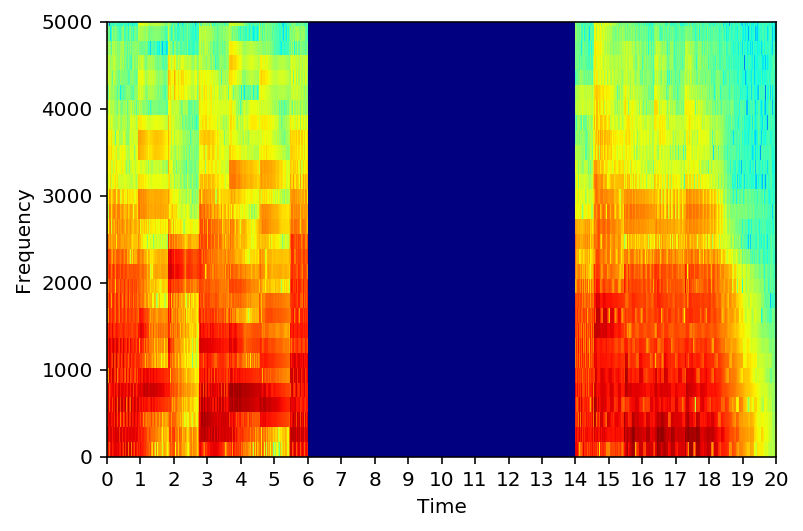

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-2.wav


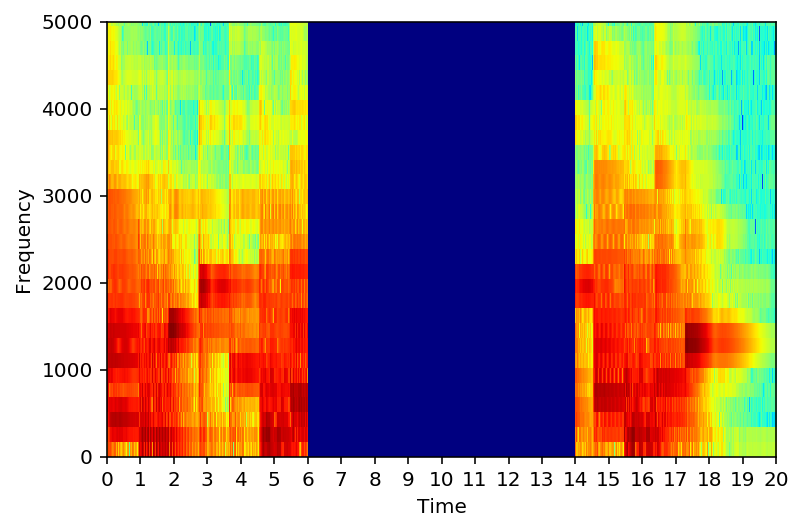

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-3.wav


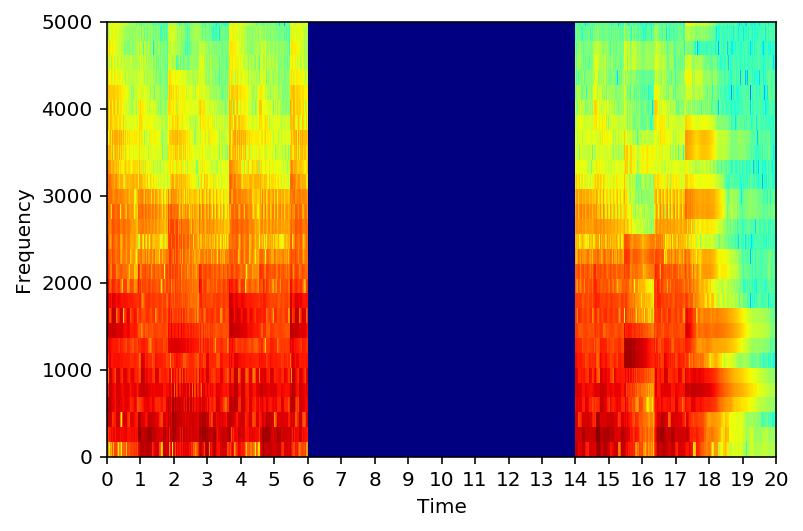

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-4.wav


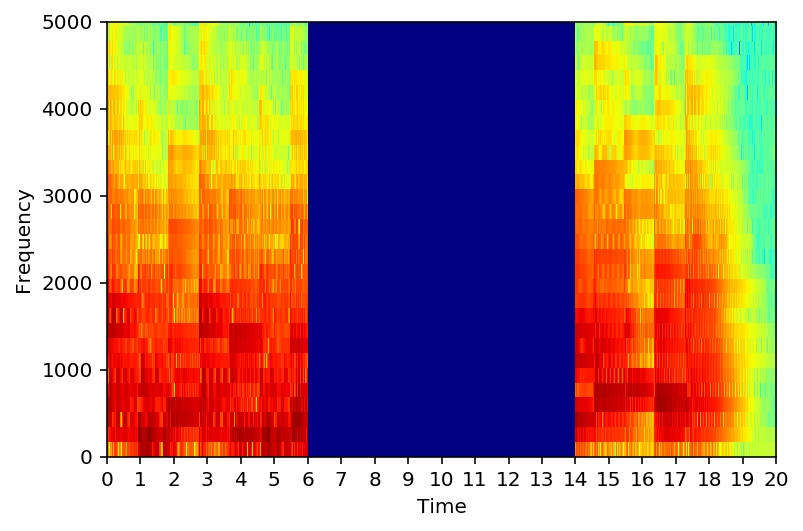

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-5.wav


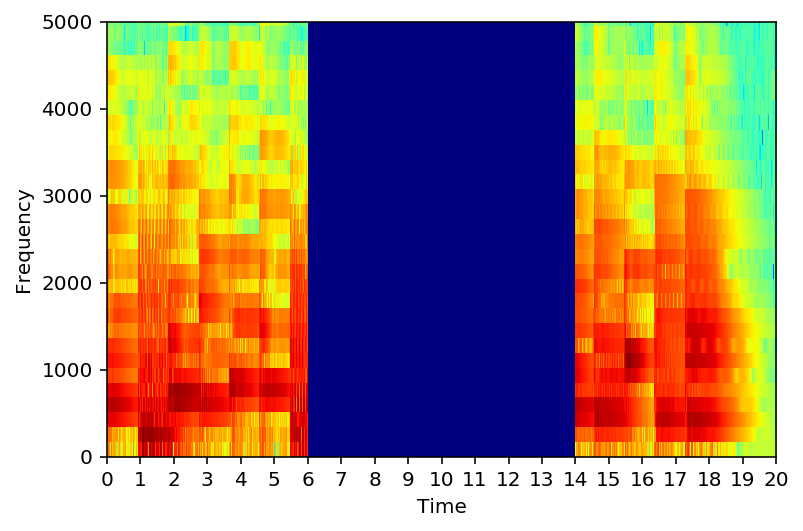

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-6.wav


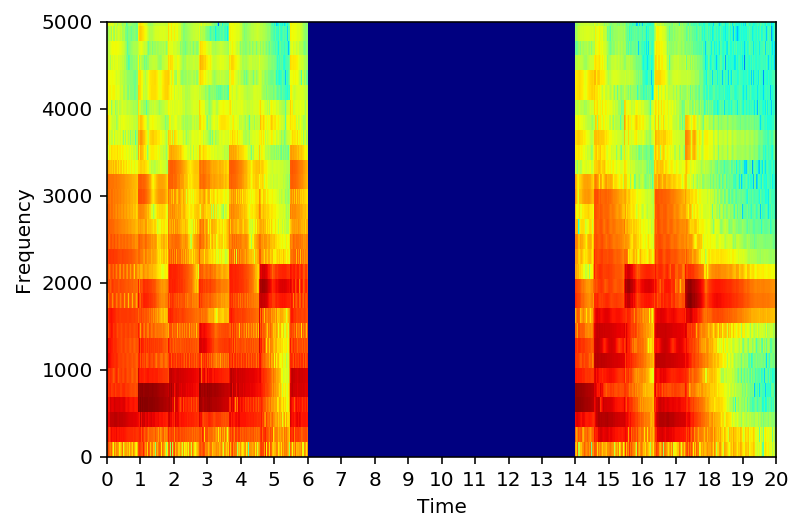

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-7.wav


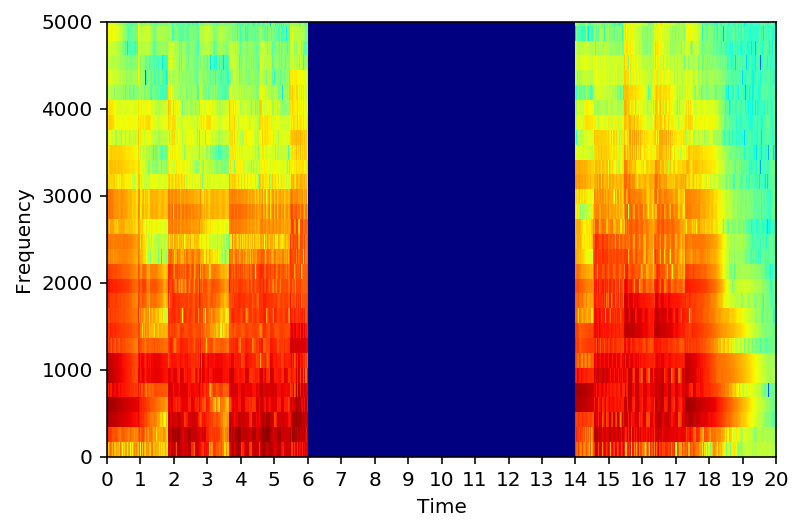

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-8.wav


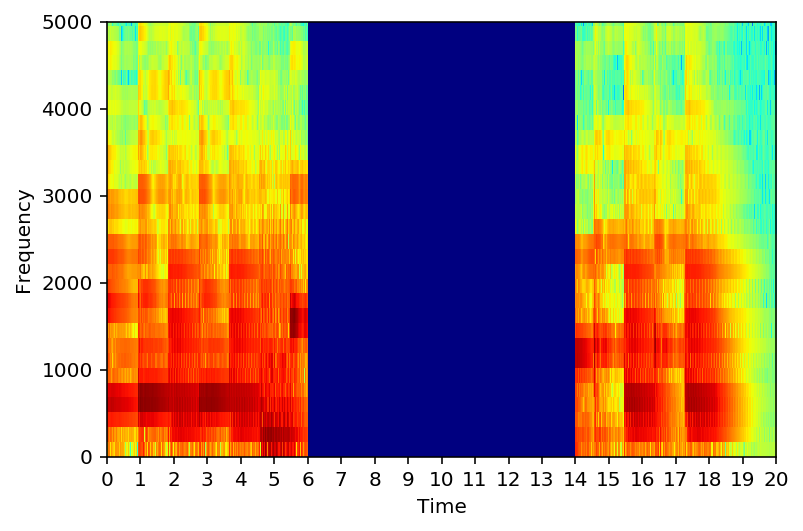

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-9.wav


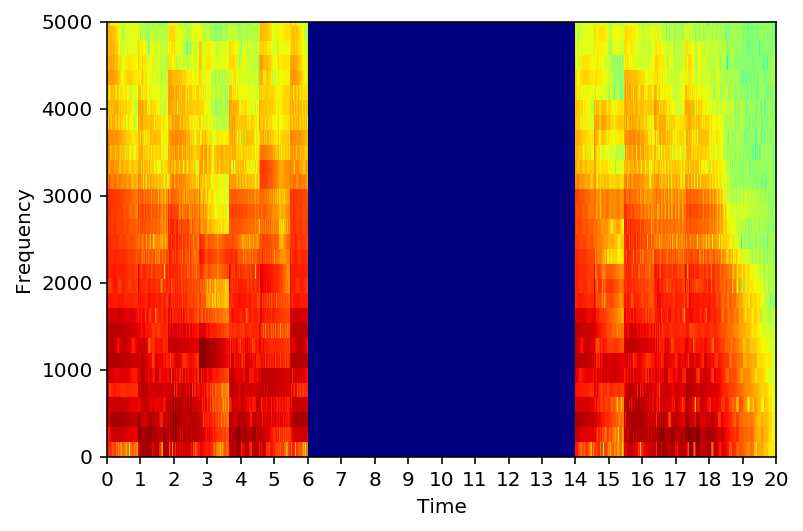

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-10.wav


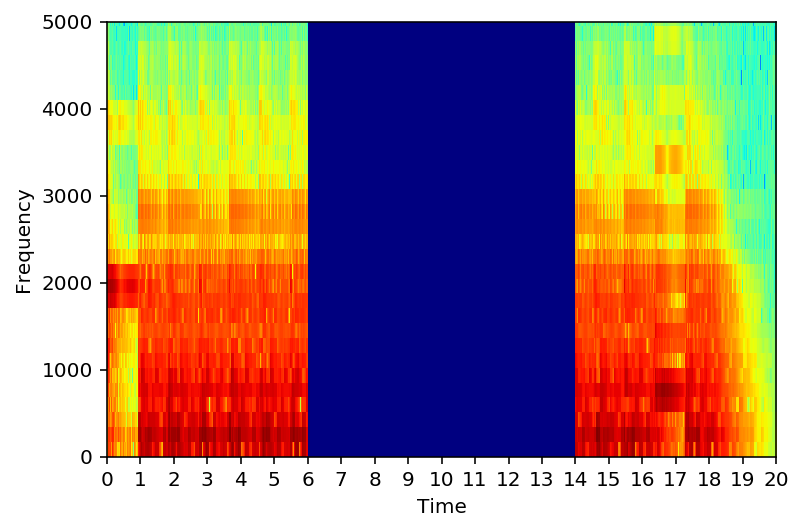

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-11.wav


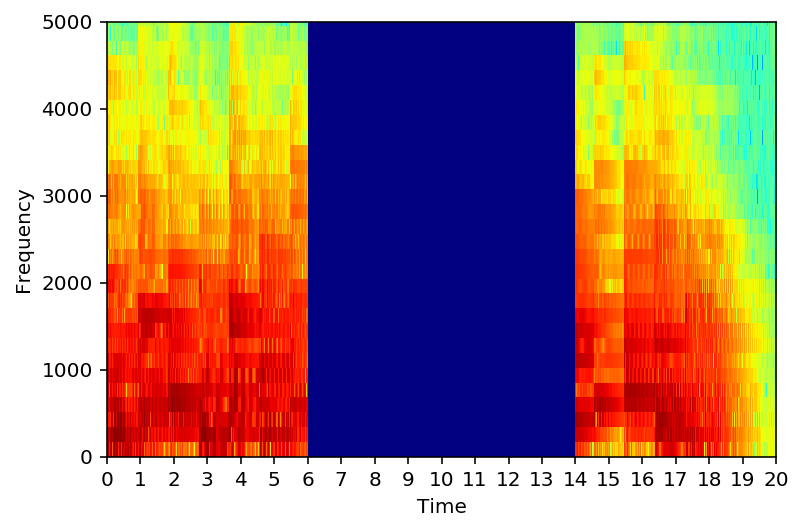

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-12.wav


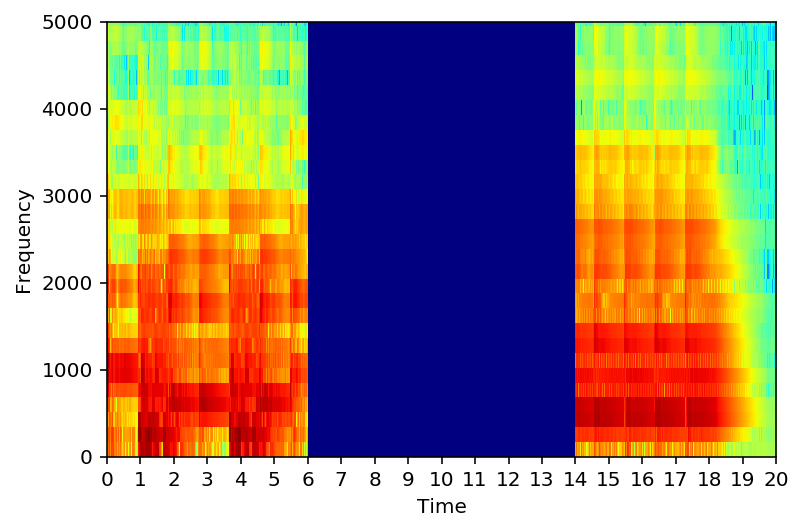

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-13.wav


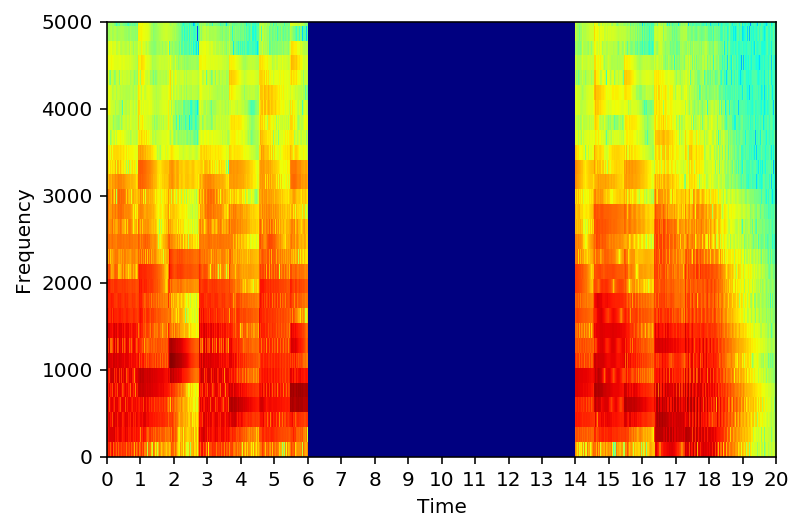

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-14.wav


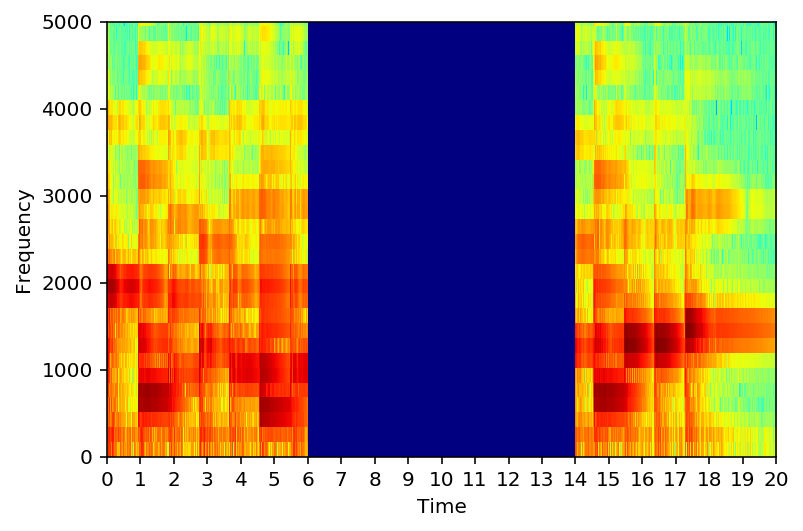

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-15.wav


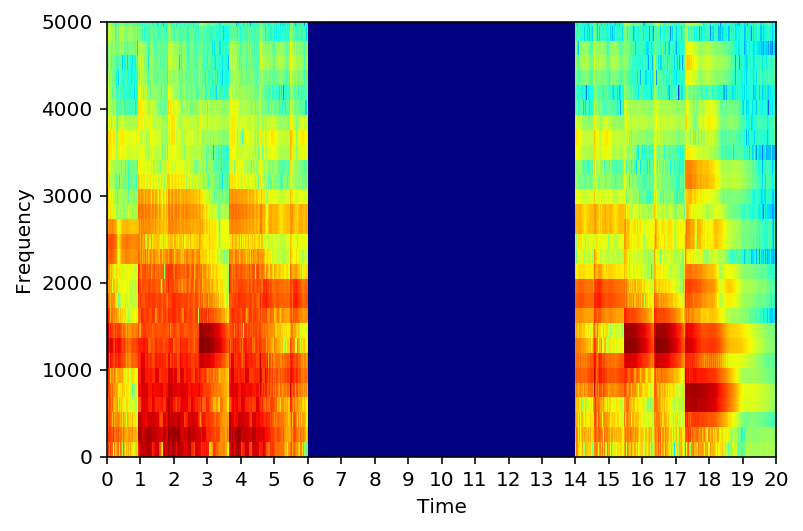

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-16.wav


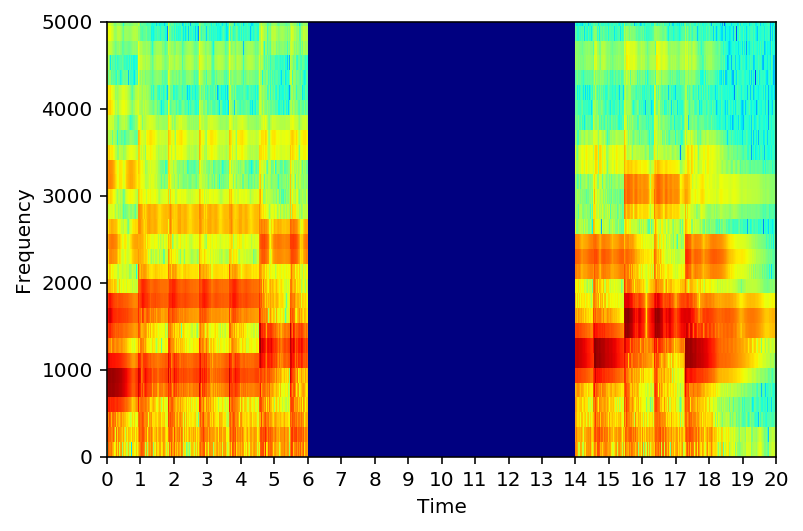

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-17.wav


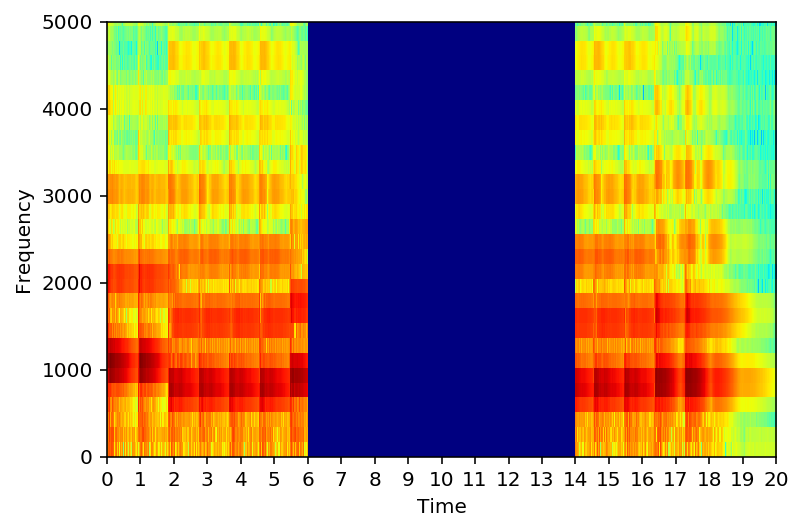

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-18.wav


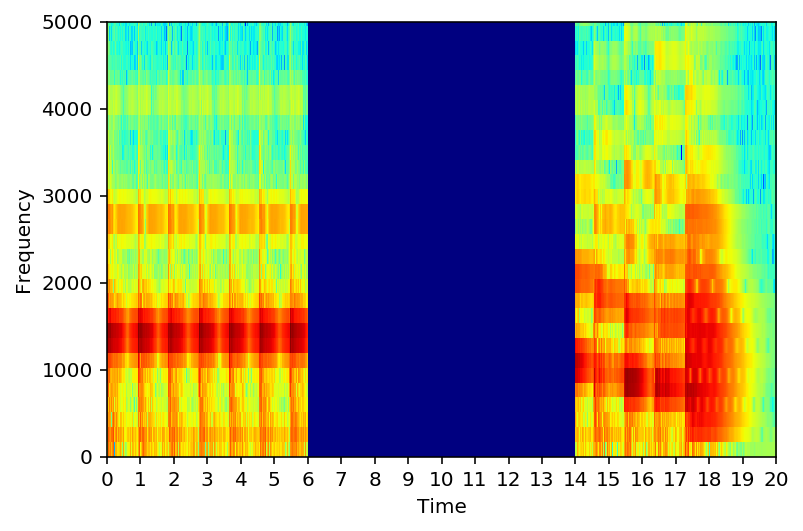

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-19.wav


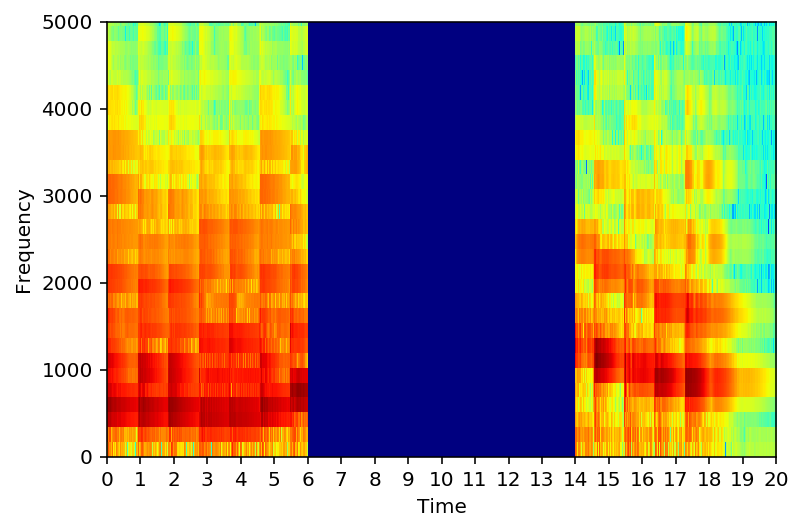

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-20.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/orig-20.wav


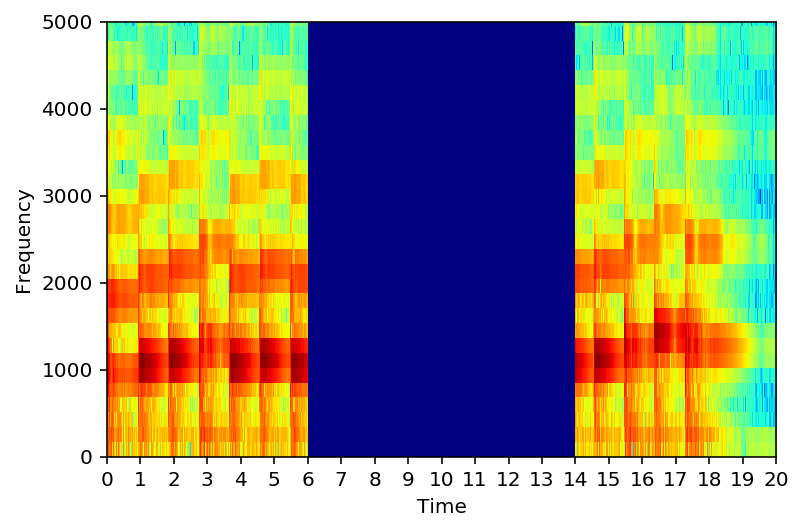

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-1.wav


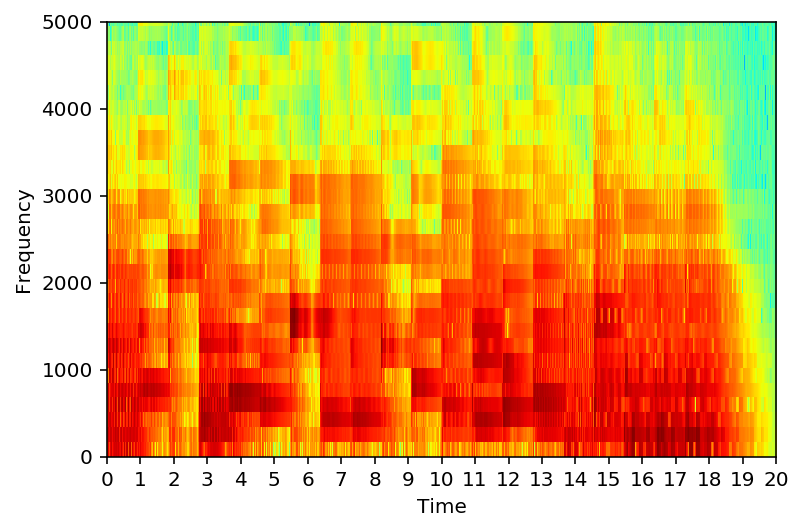

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-2.wav


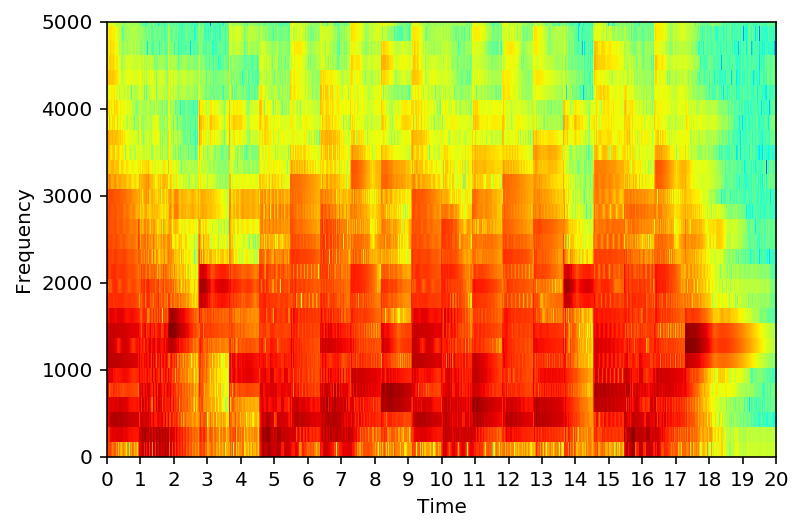

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-3.wav


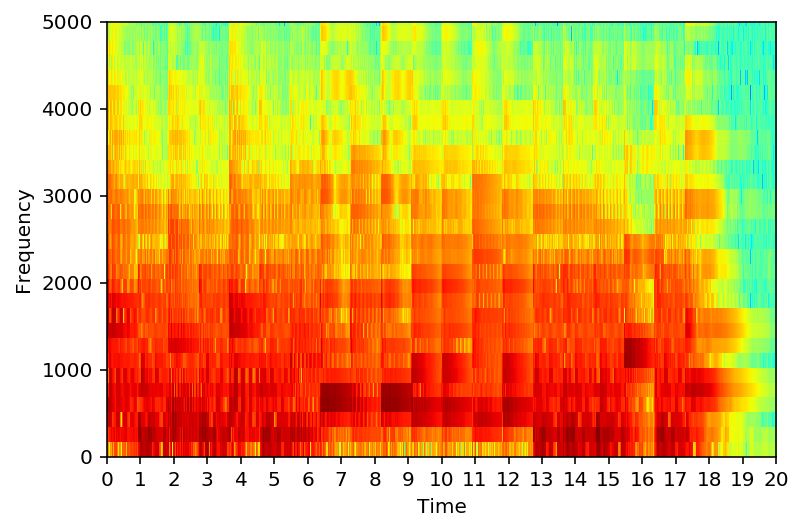

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-4.wav


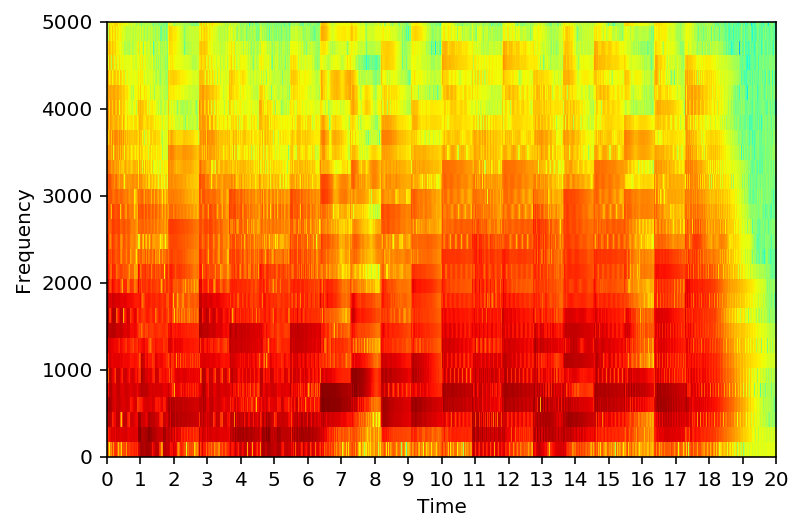

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-5.wav


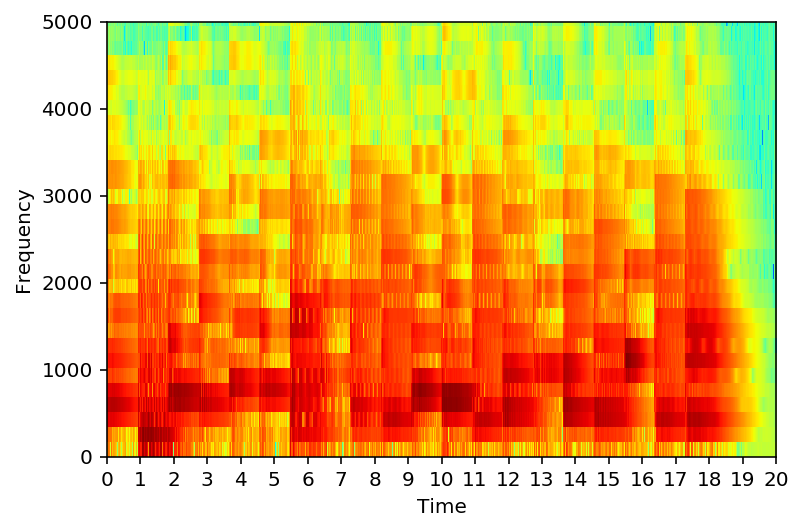

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-6.wav


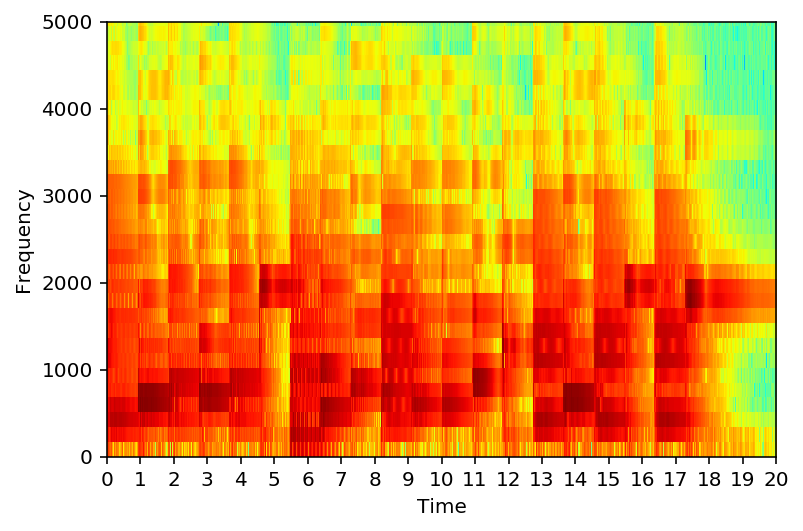

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-7.wav


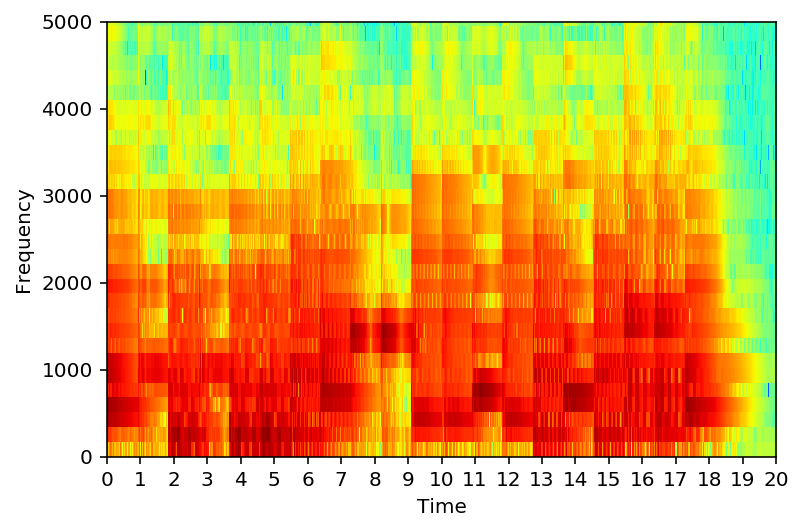

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-8.wav


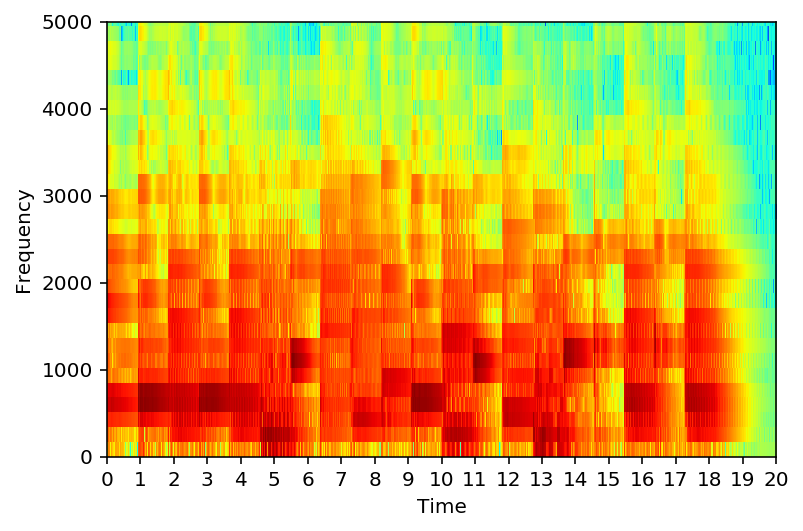

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-9.wav


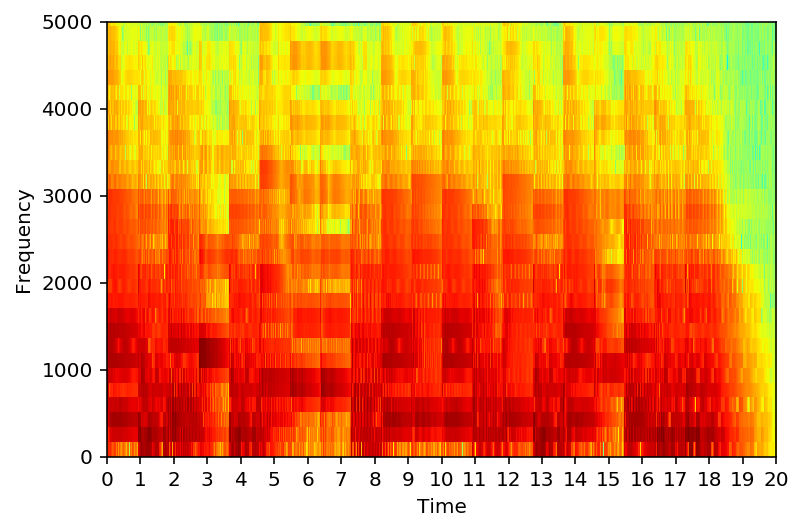

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-10.wav


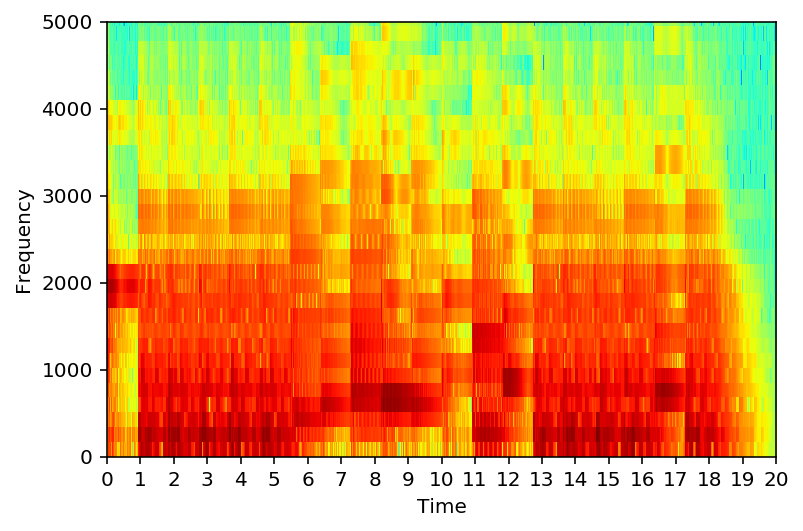

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-11.wav


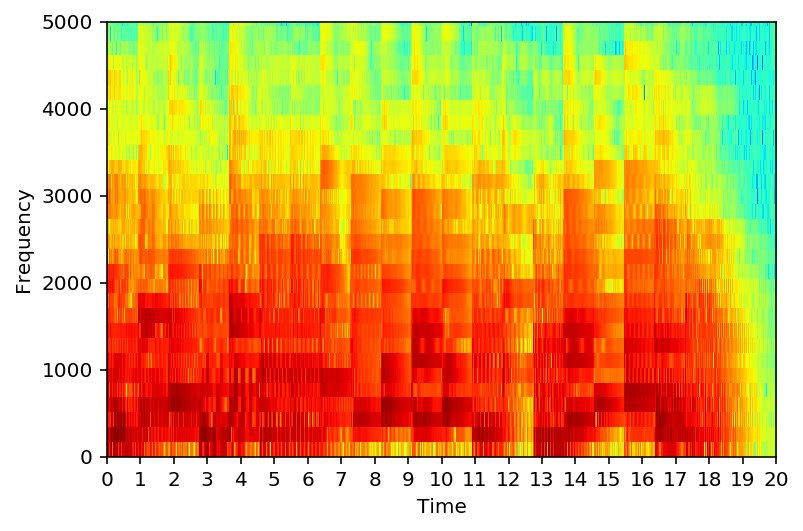

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-12.wav


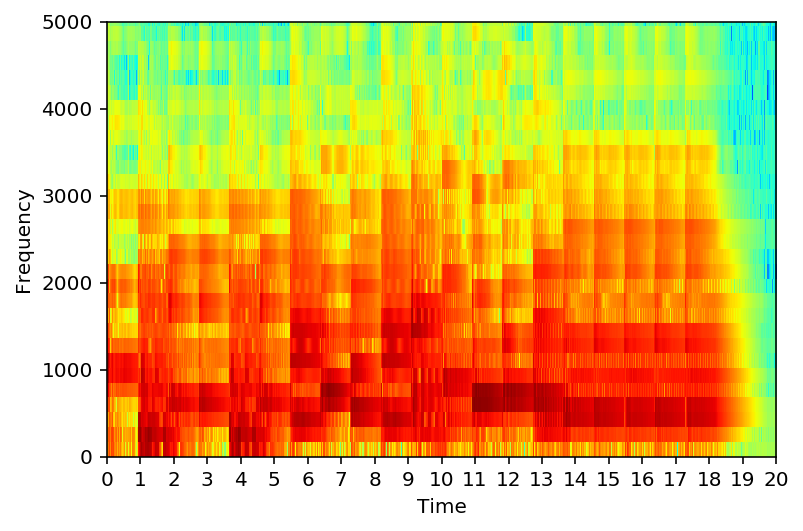

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-13.wav


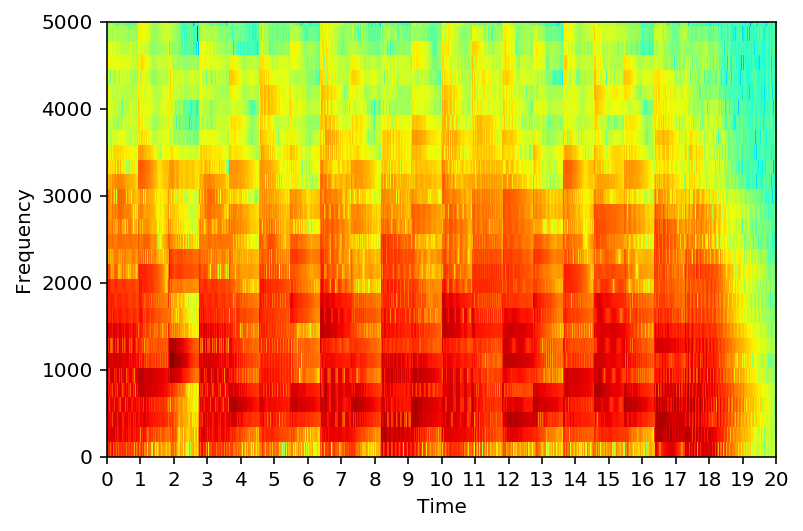

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-14.wav


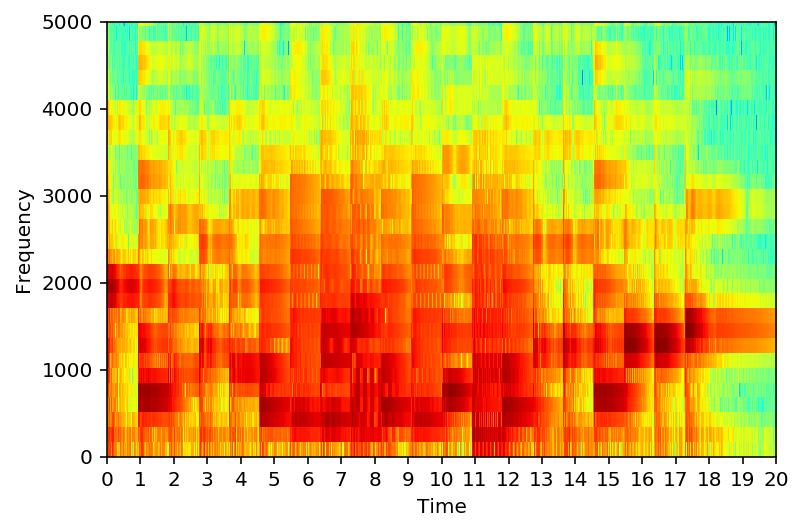

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-15.wav


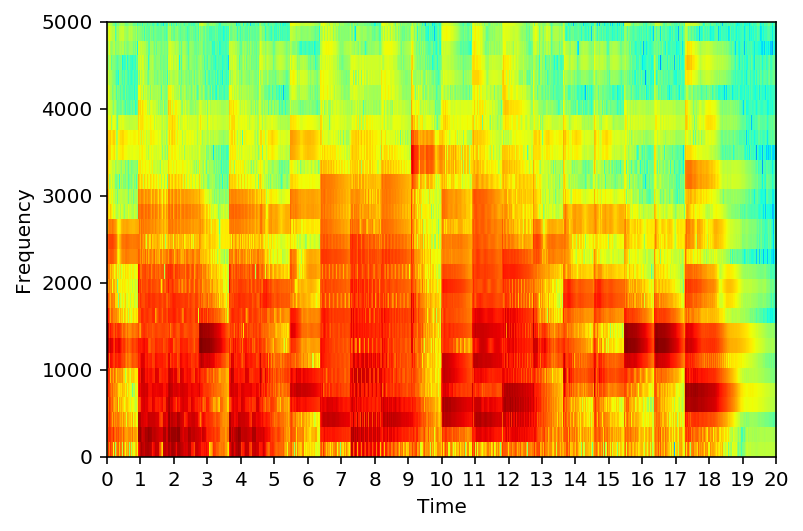

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-16.wav


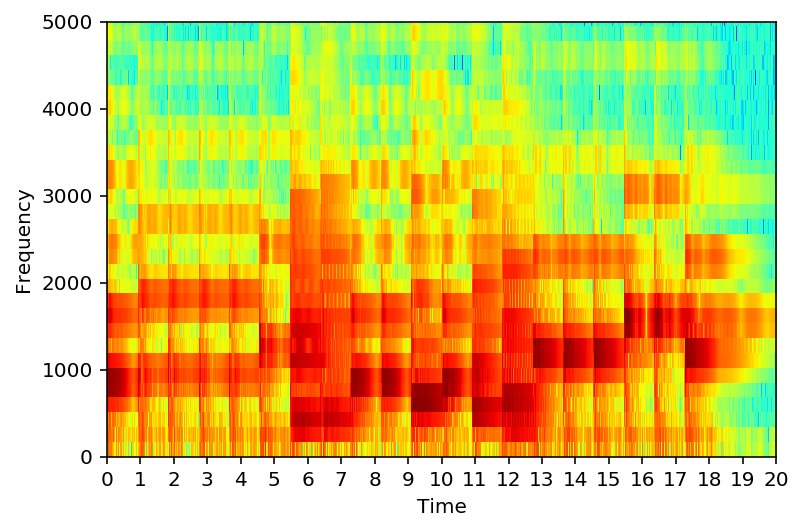

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-17.wav


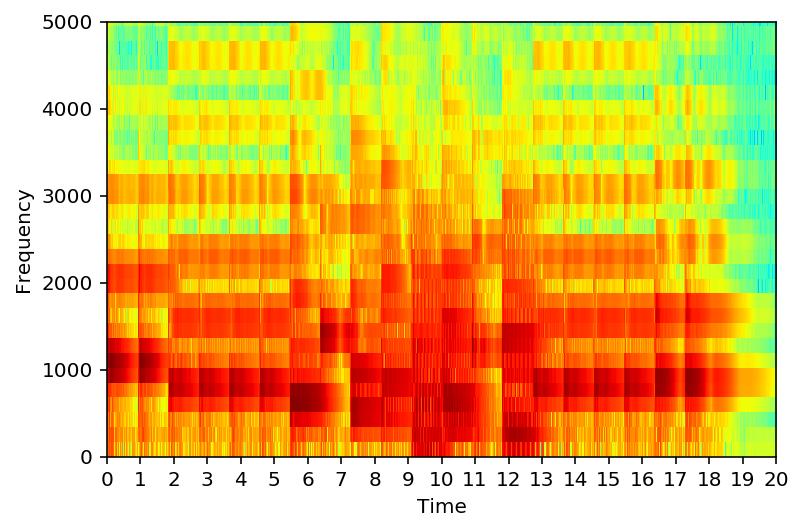

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-18.wav


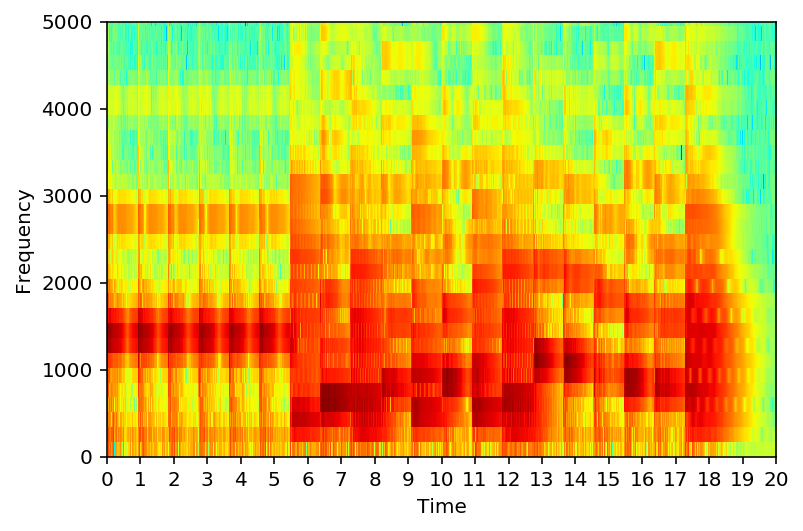

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-19.wav


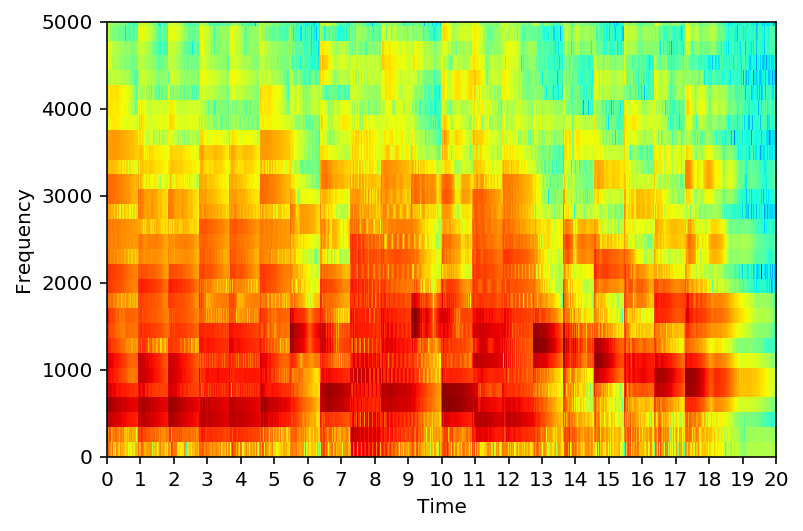

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-20.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/brahms/filled-20.wav


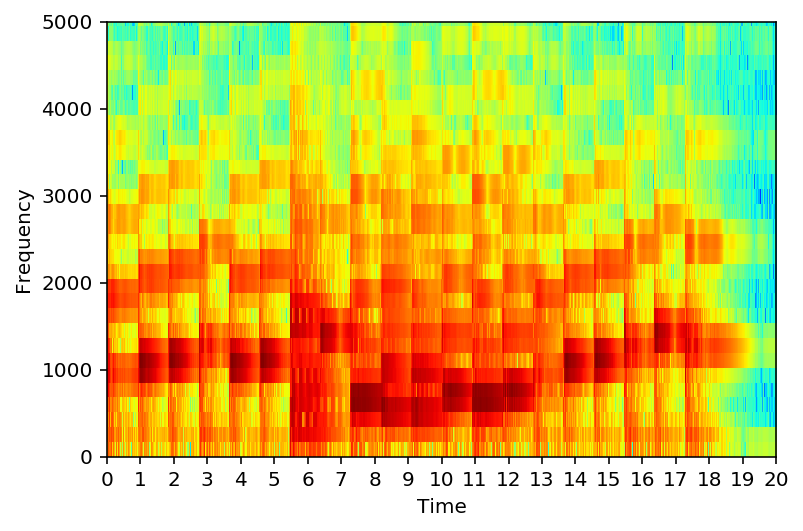

read ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/mono_orig.txt
G5 F5 D6 B-5 A5 F5 G5 E5 G5 F5 E5 F5 A5 G5 F5 E5 D5 C#5 A5 G5
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-1.wav


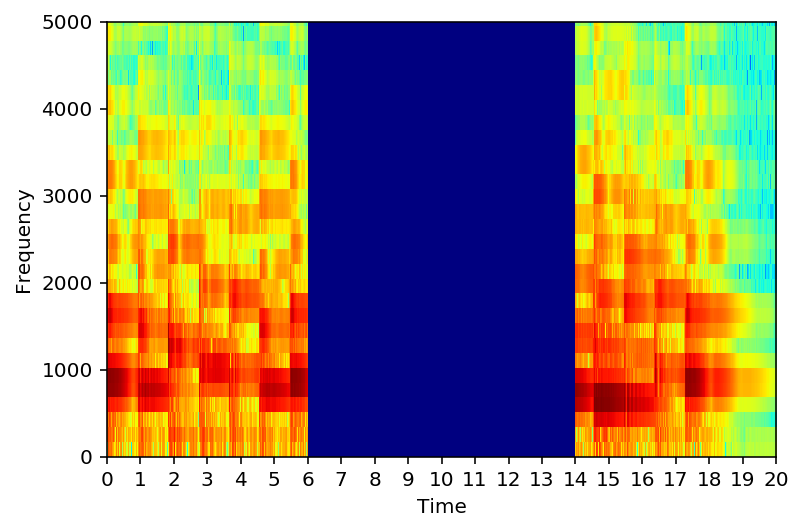

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-2.wav


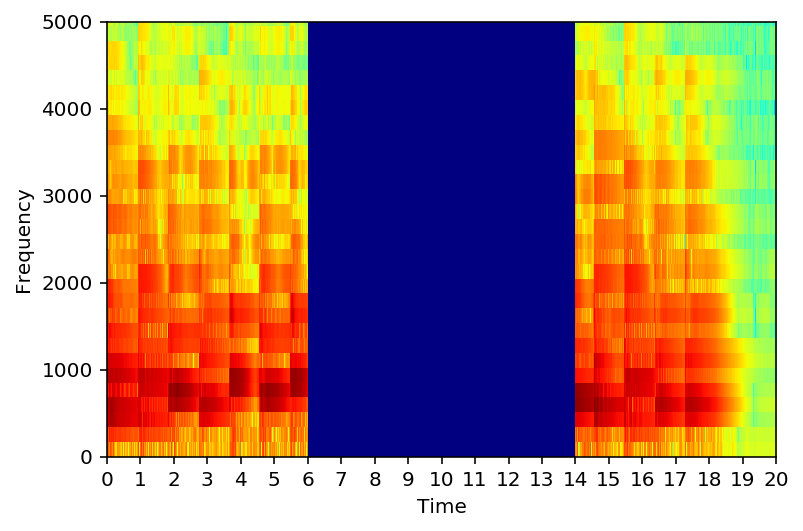

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-3.wav


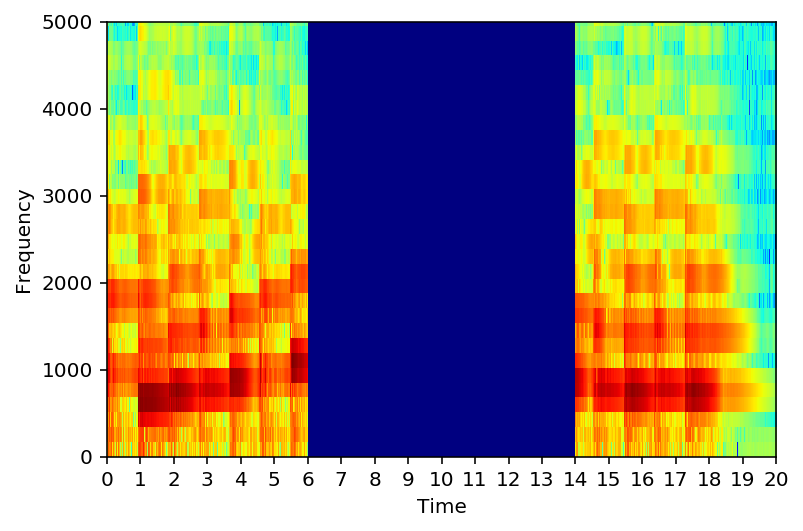

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-4.wav


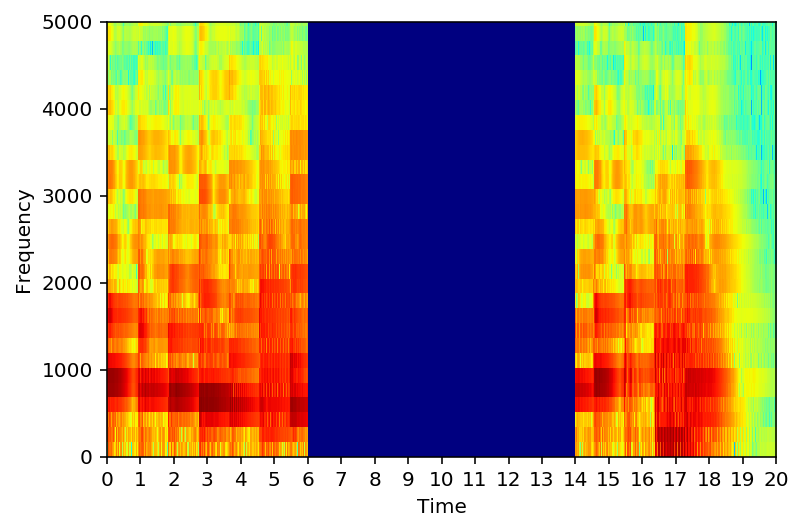

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-5.wav


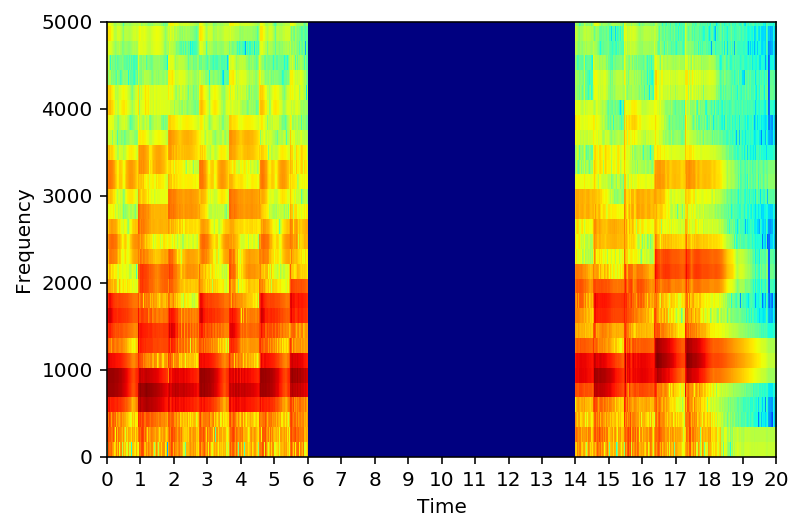

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-6.wav


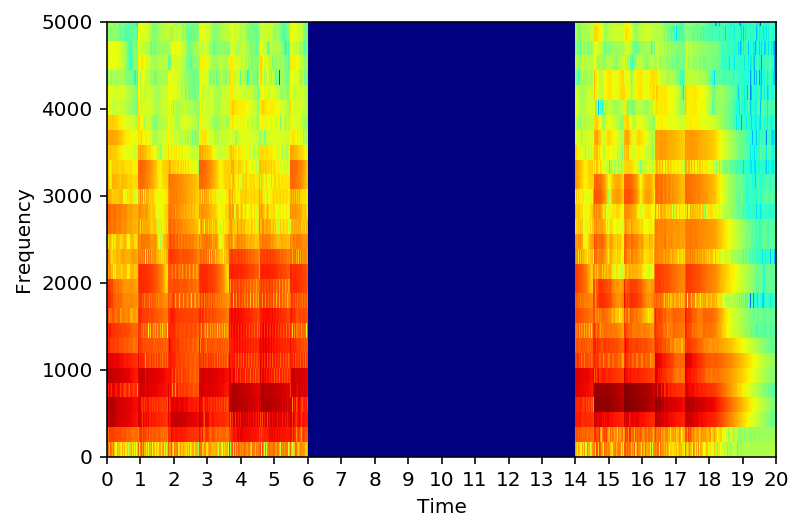

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-7.wav


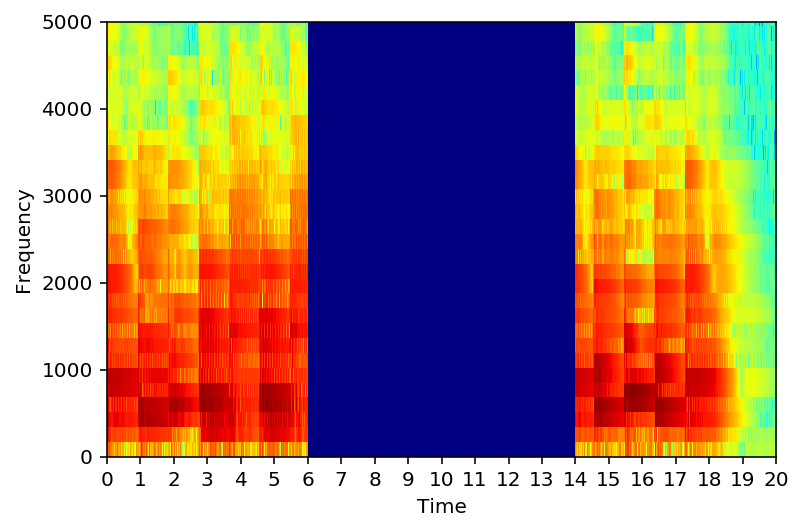

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-8.wav


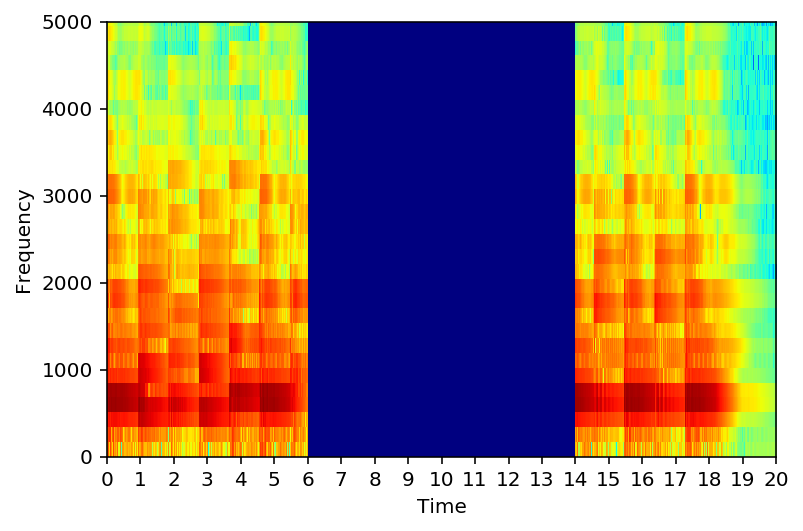

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-9.wav


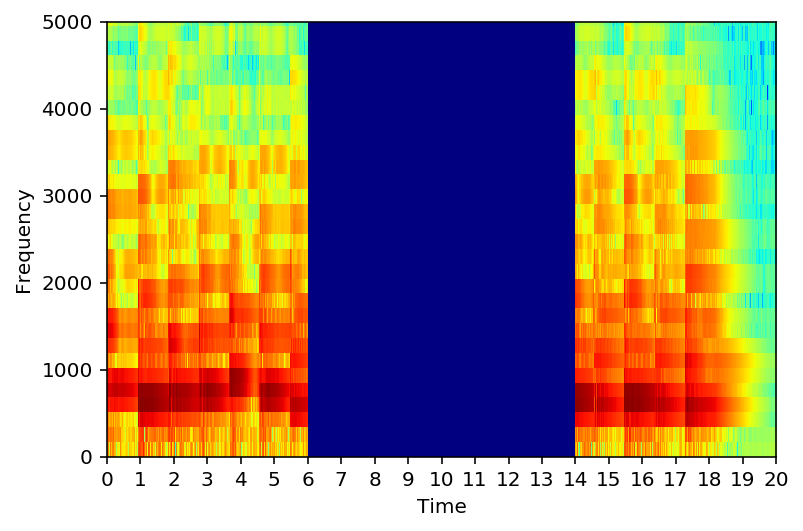

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-10.wav


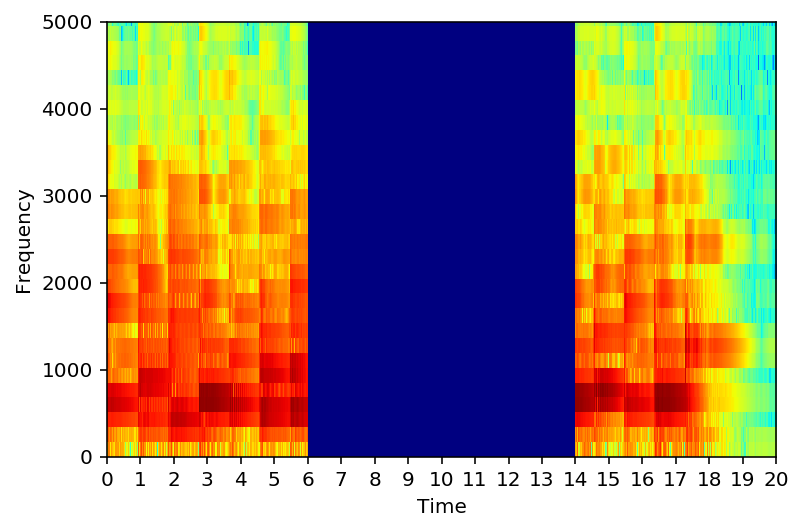

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-11.wav


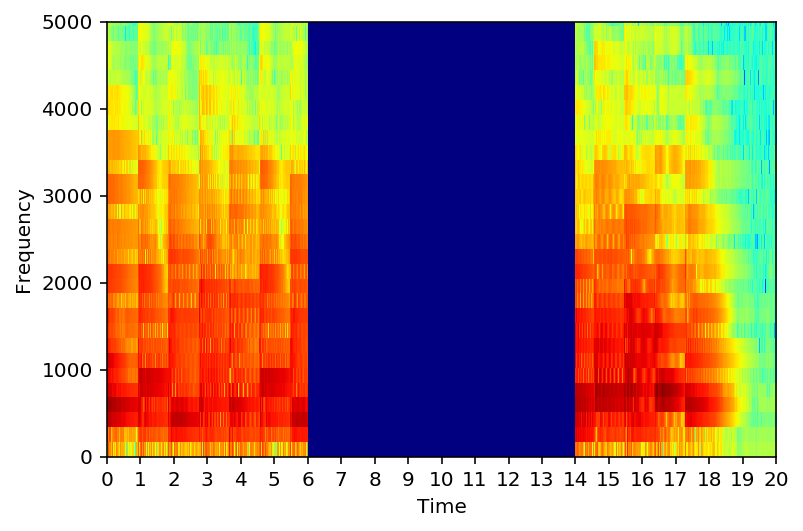

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-12.wav


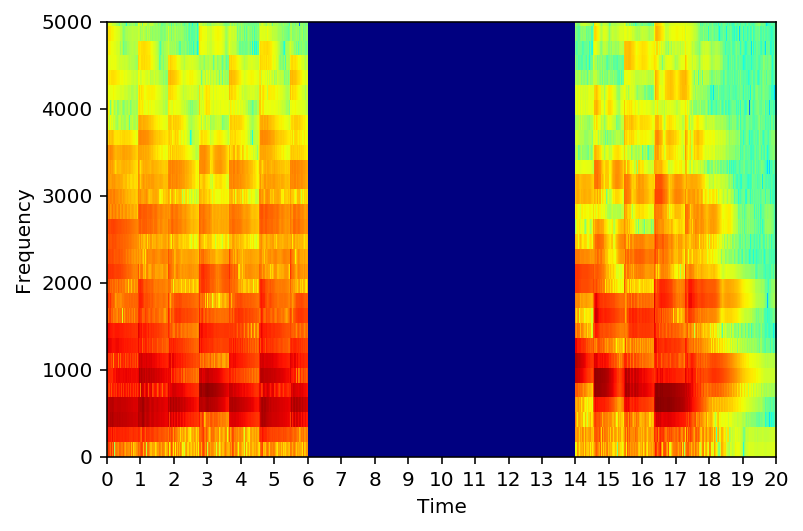

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-13.wav


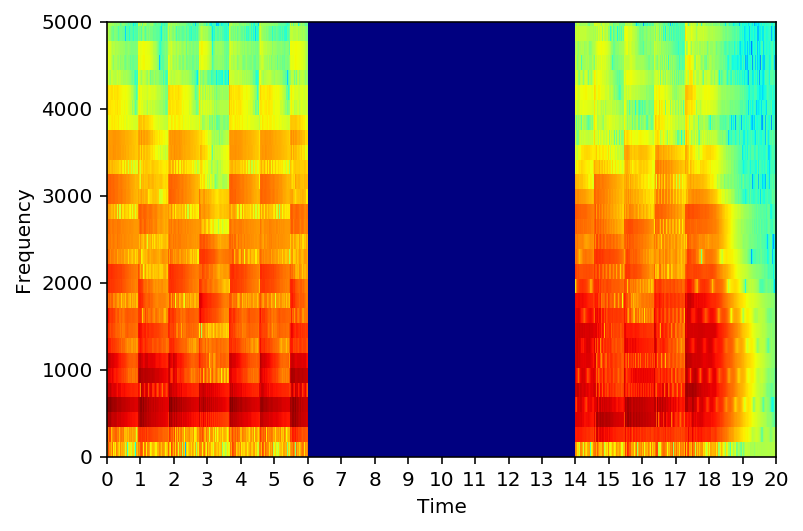

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-14.wav


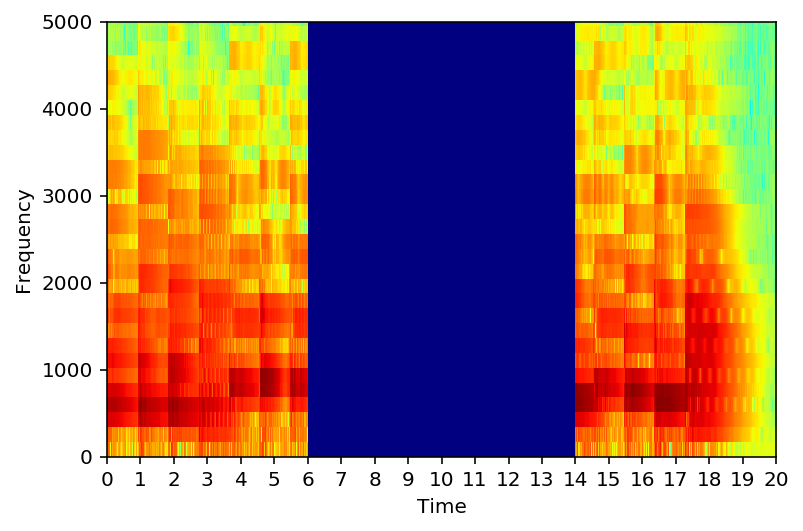

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-15.wav


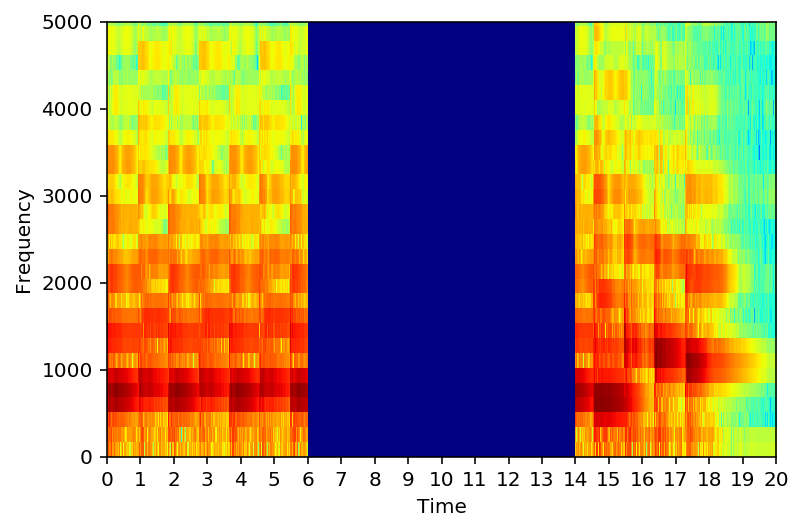

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-16.wav


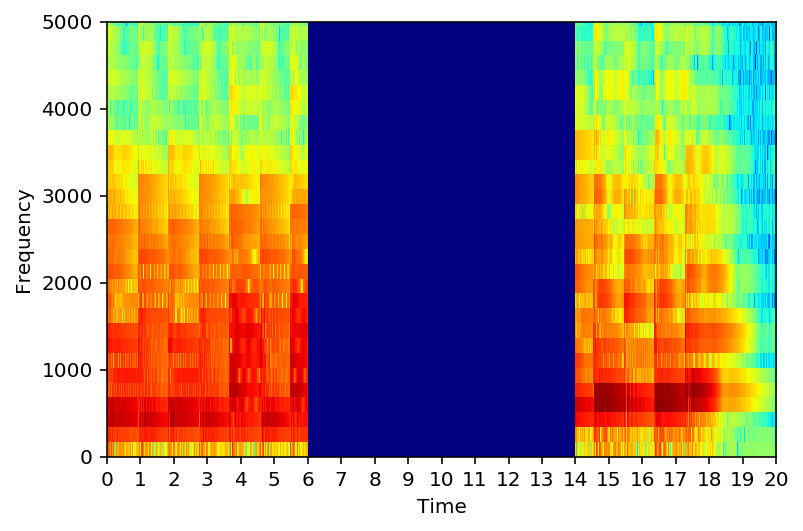

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-17.wav


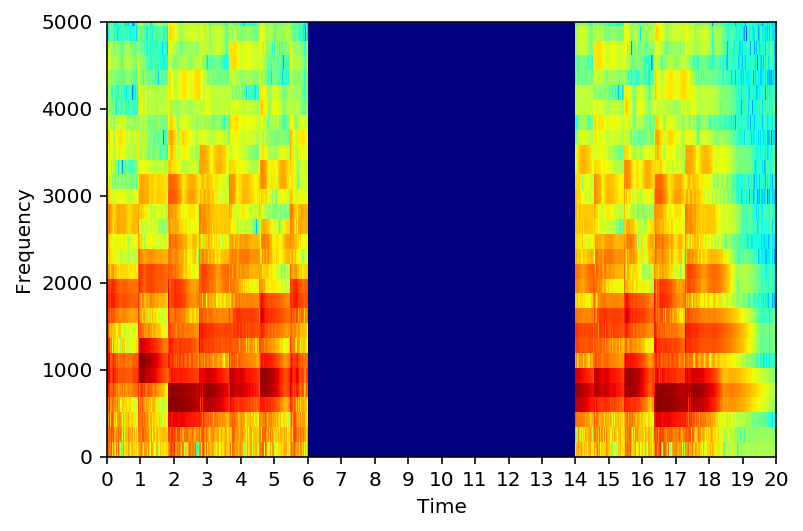

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-18.wav


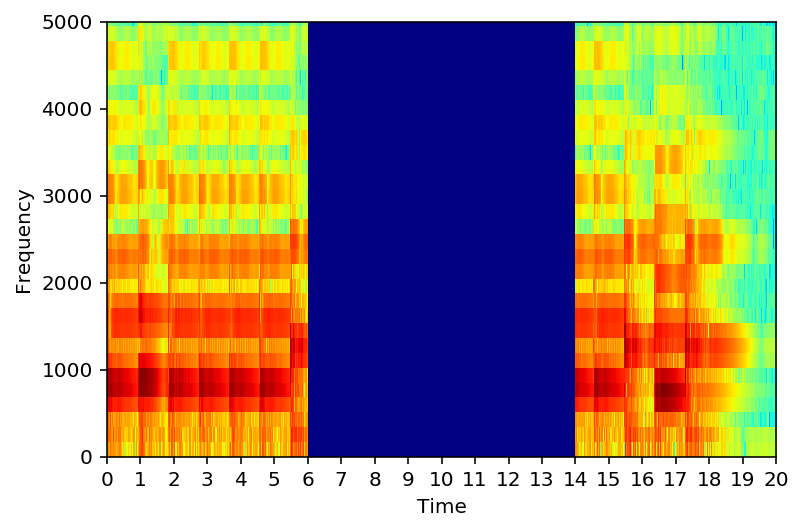

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-19.wav


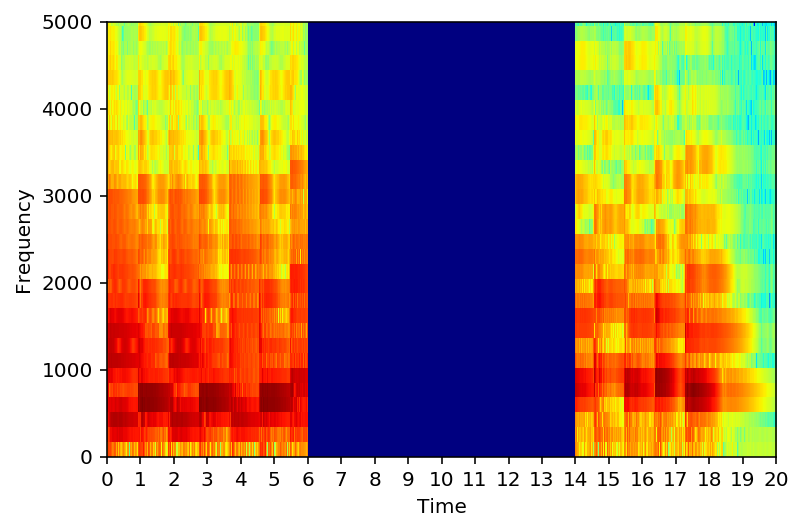

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-20.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/orig-20.wav


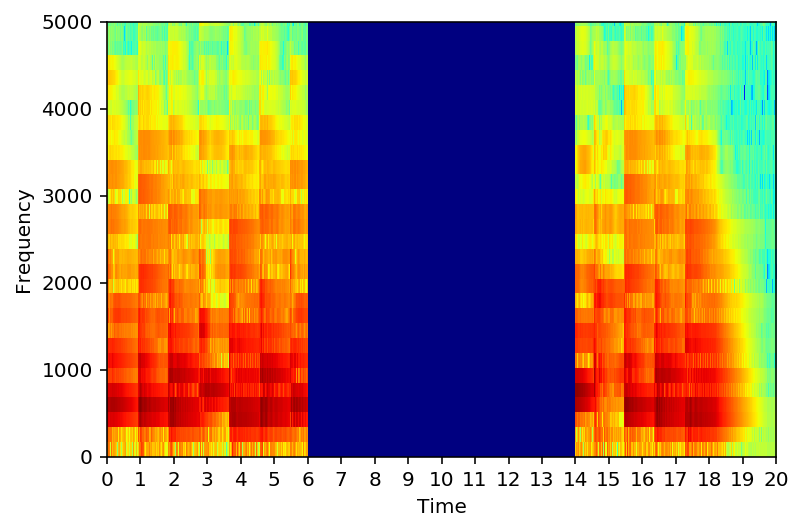

read ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-1.wav


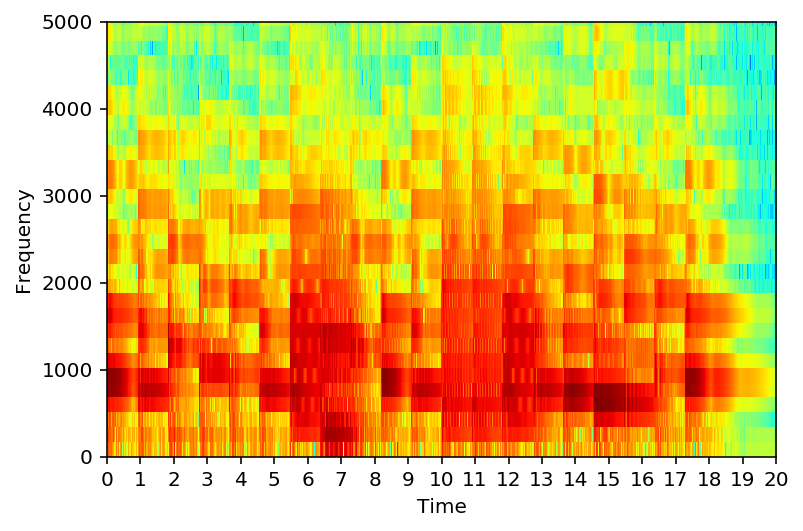

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-2.wav


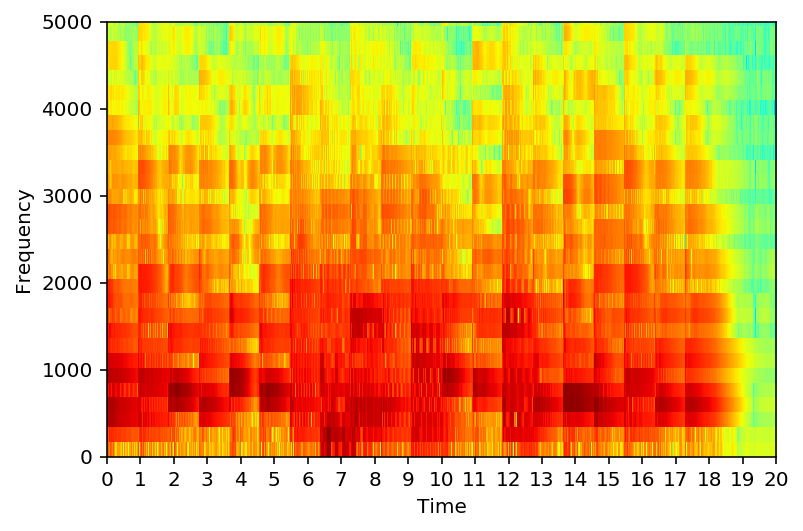

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-3.wav


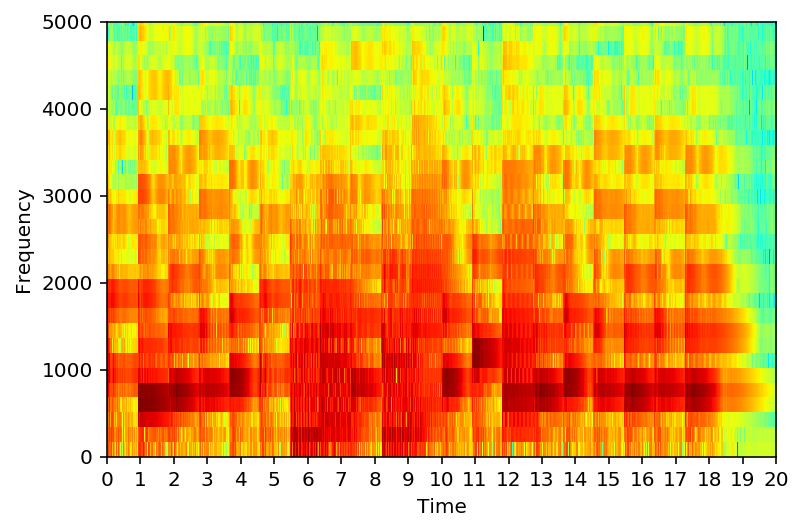

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-4.wav


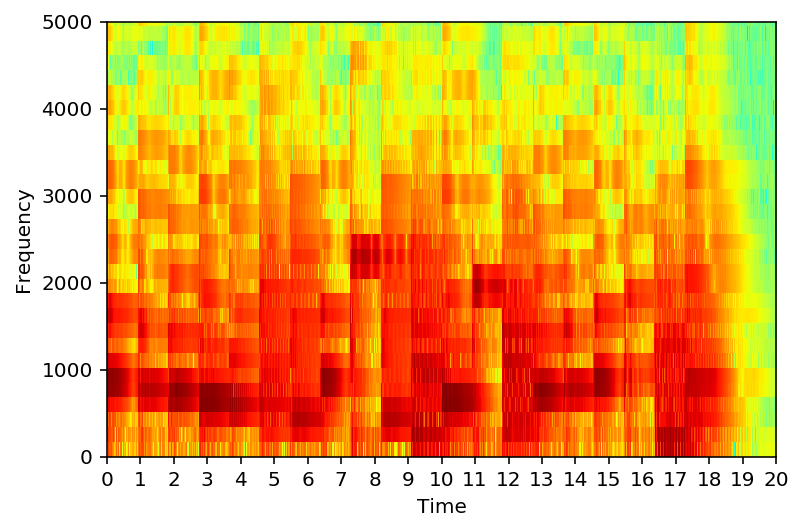

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-5.wav


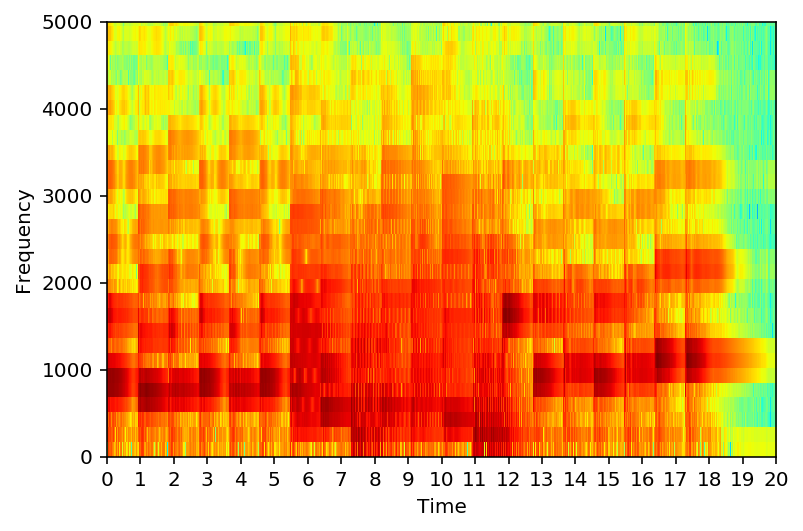

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-6.wav


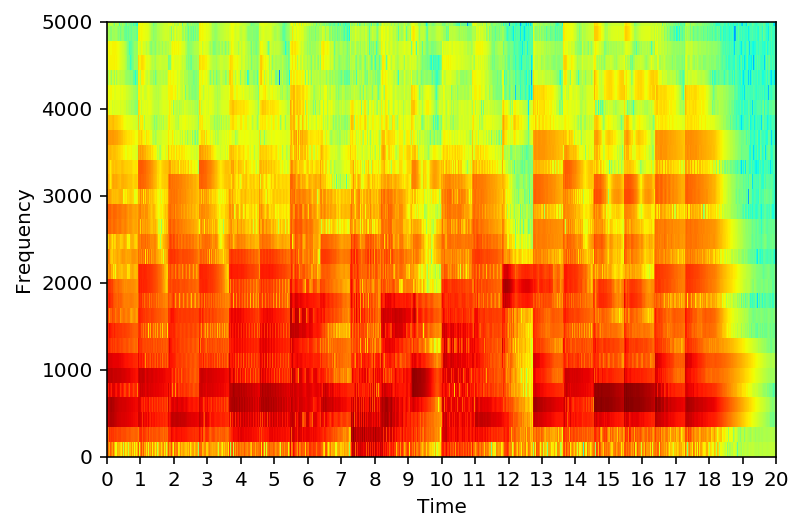

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-7.wav


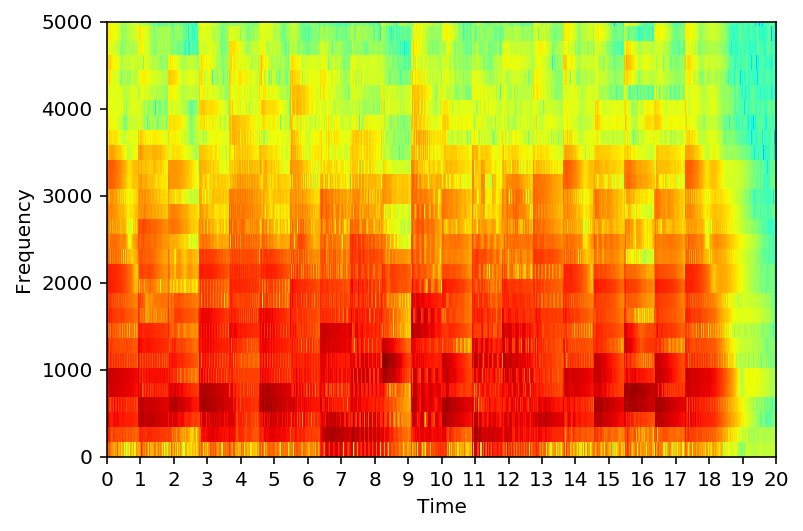

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-8.wav


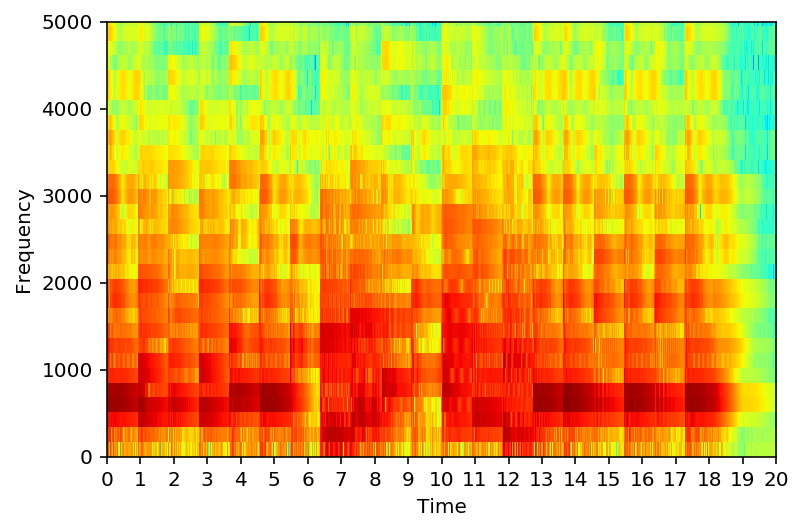

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-9.wav


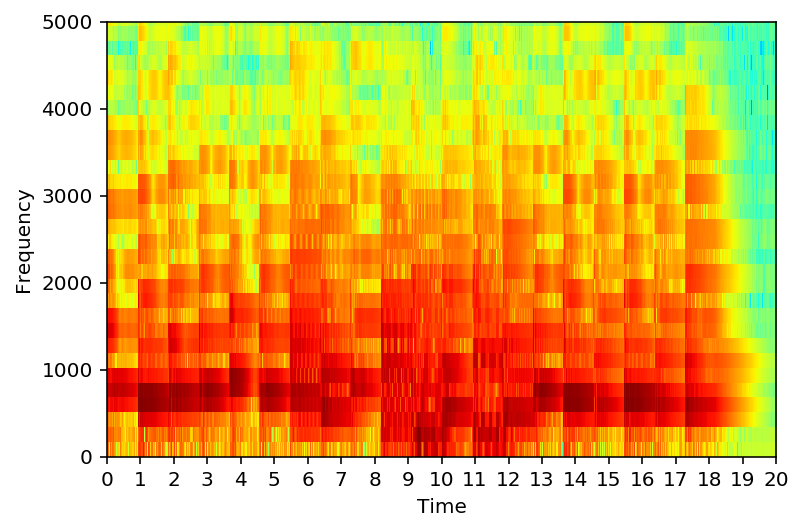

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-10.wav


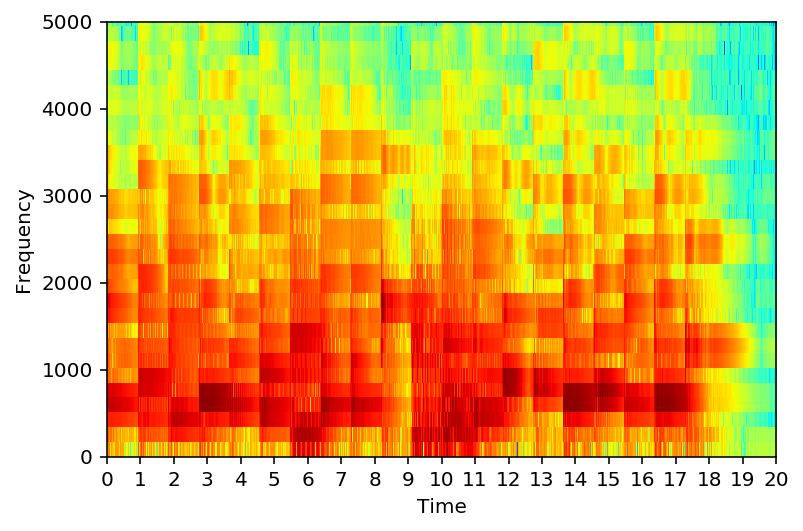

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-11.wav


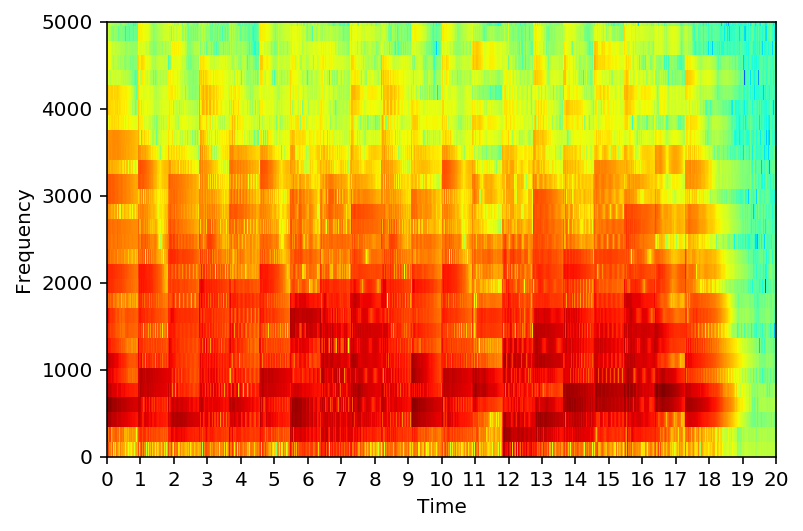

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-12.wav


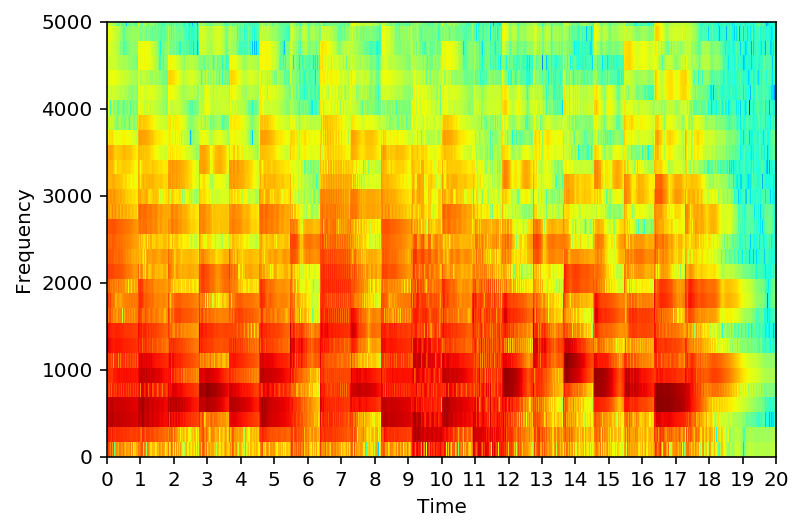

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-13.wav


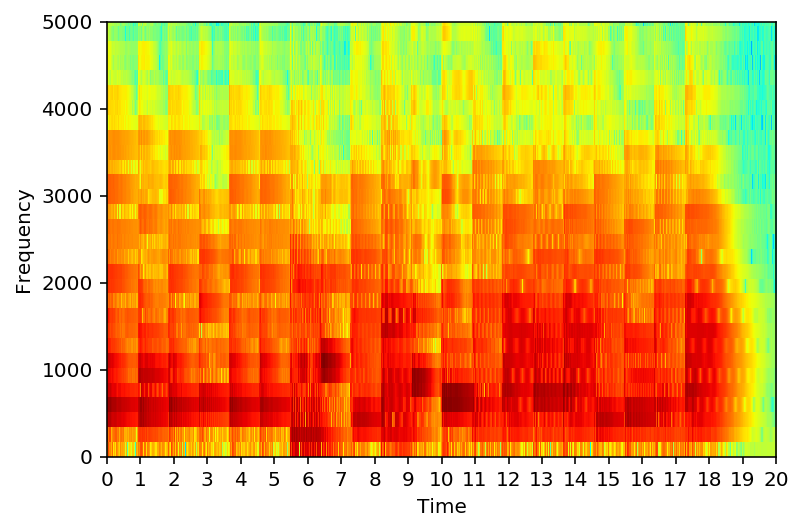

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-14.wav


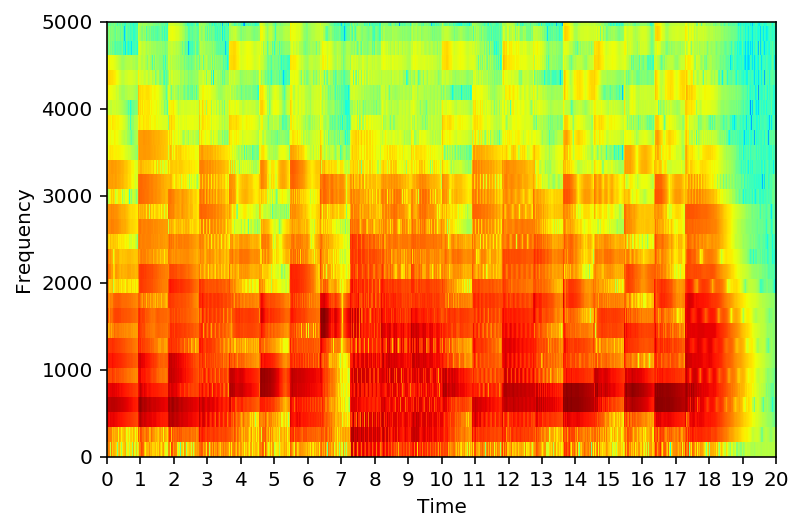

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-15.wav


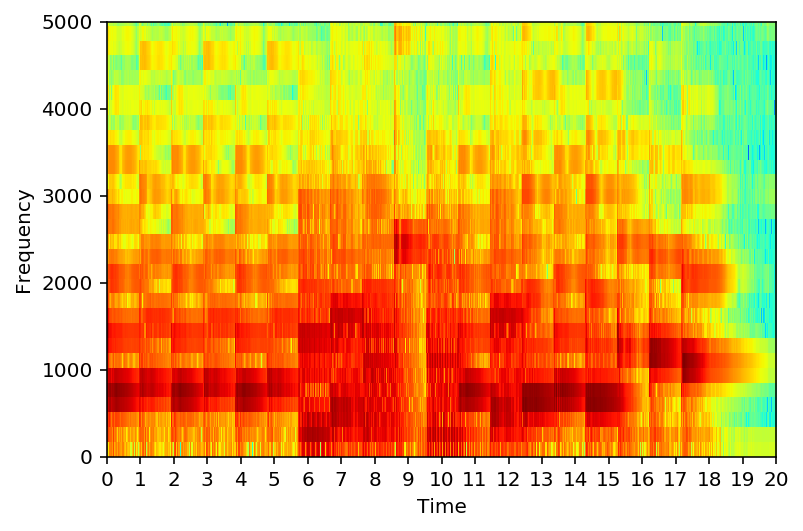

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-16.wav


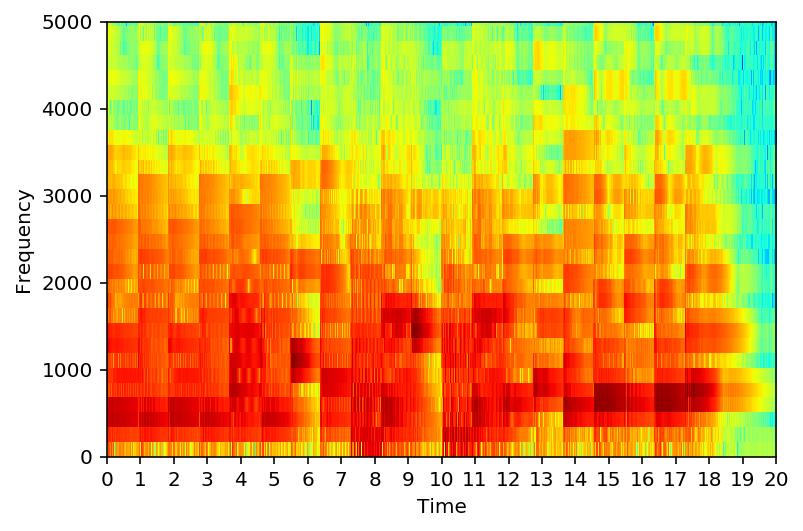

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-17.wav


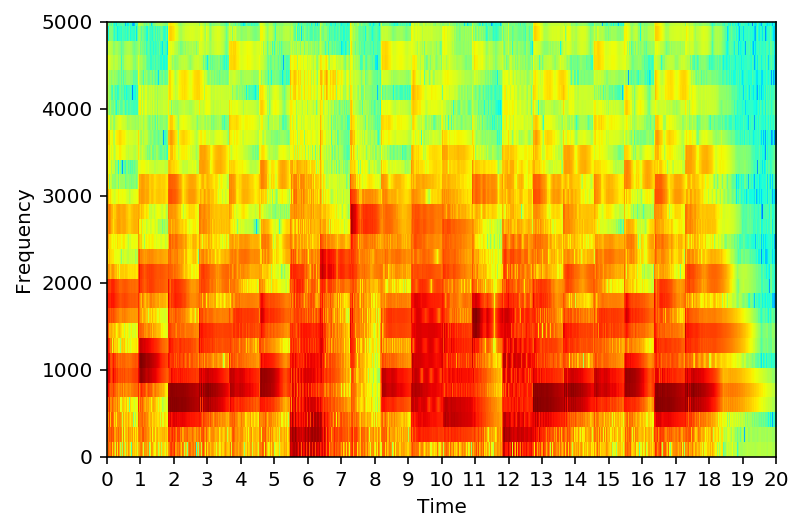

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-18.wav


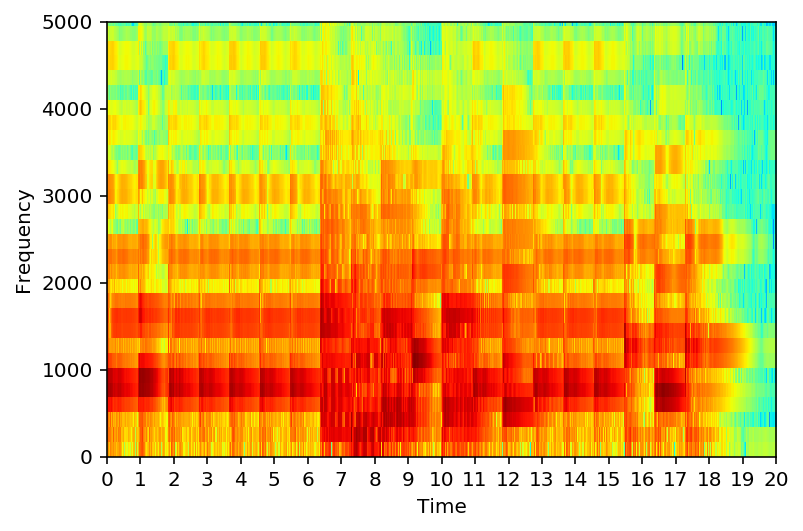

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-19.wav


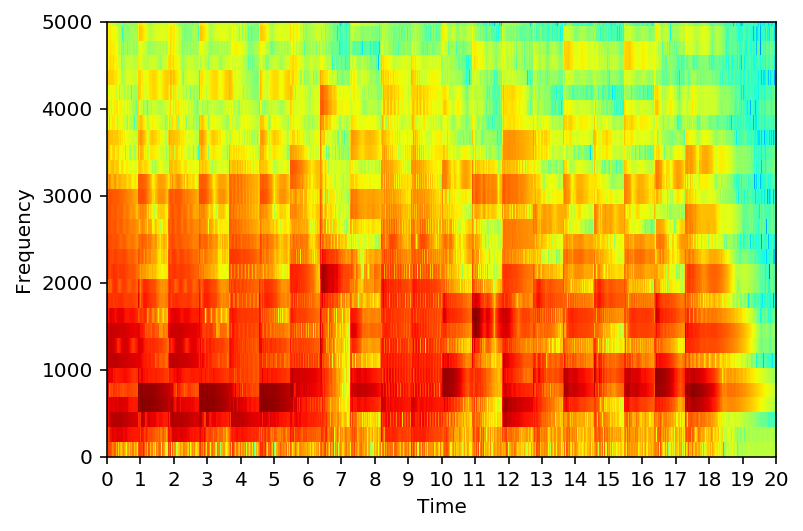

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-20.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/haydn/filled-20.wav


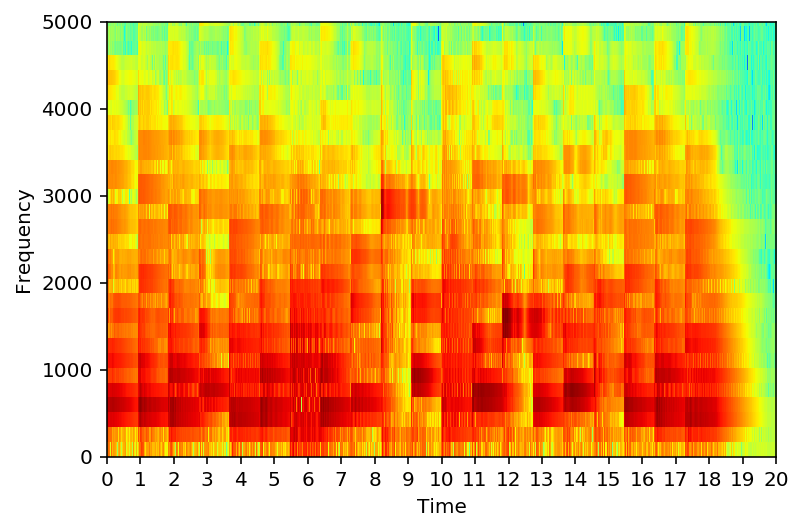

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/mono_orig.txt
E5 A4 G#4 F#4 G#4 E5 G#4 F#4 E4 F#4 A4 G#4 B4 E-4 F#4 E4 E5 F#5 E-5 E5
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-1.wav


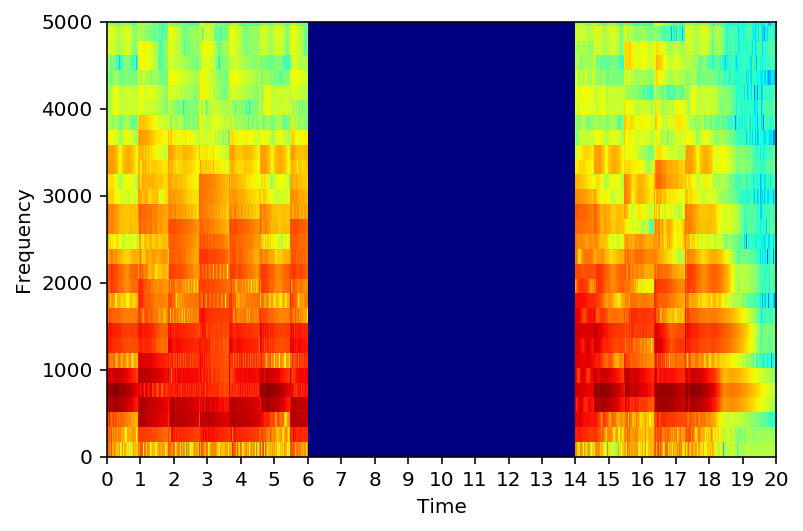

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-2.wav


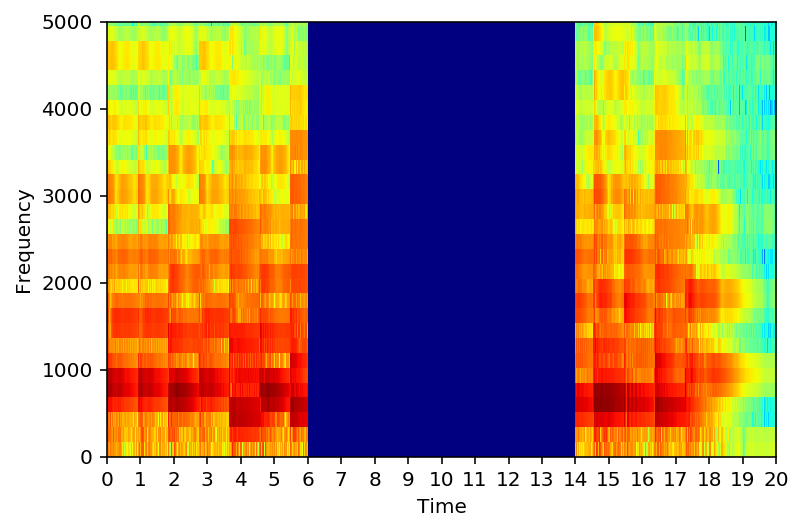

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-3.wav


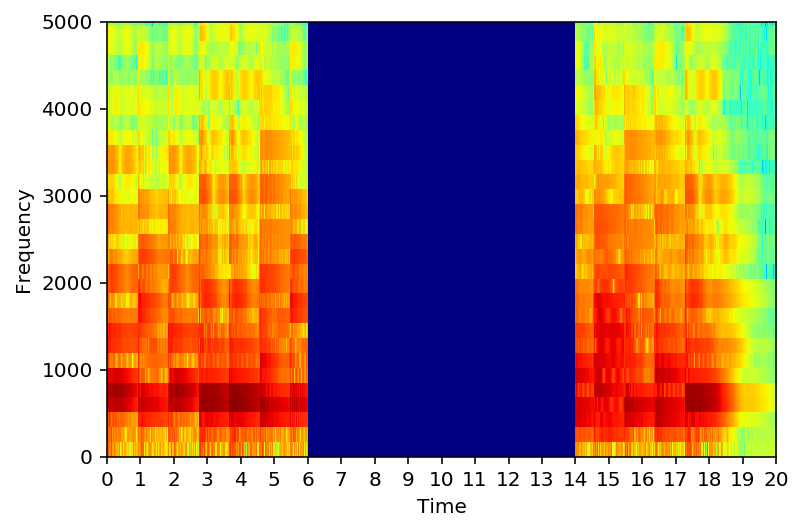

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-4.wav


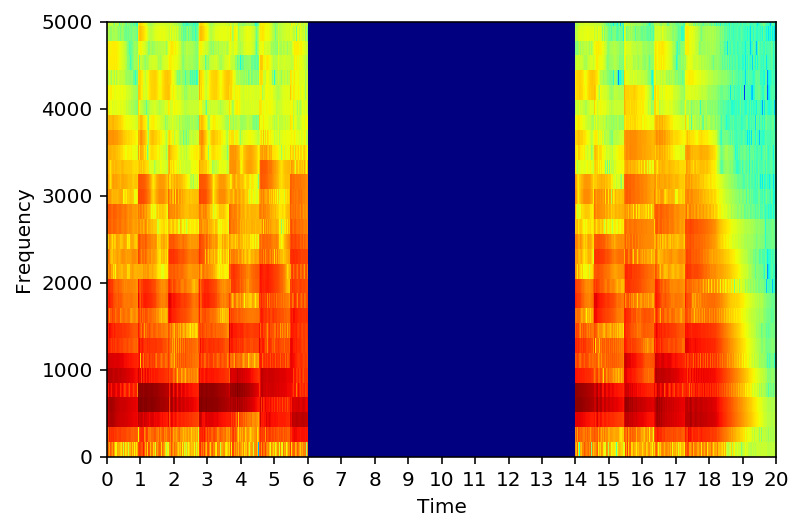

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-5.wav


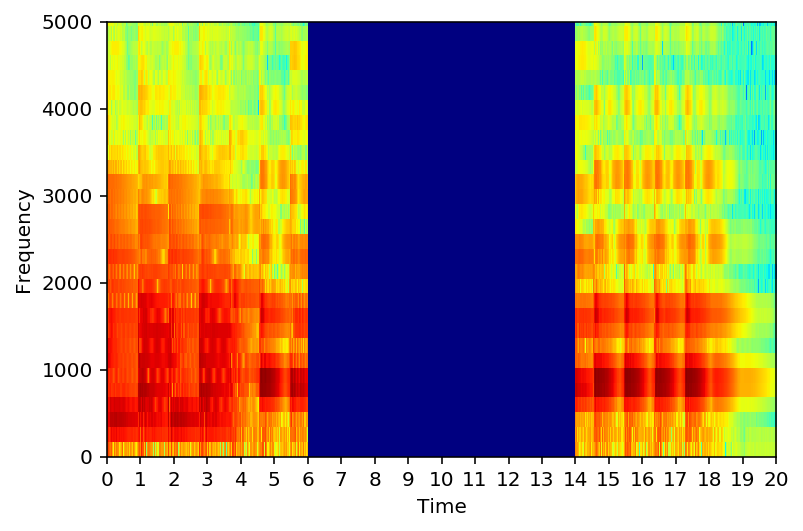

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-6.wav


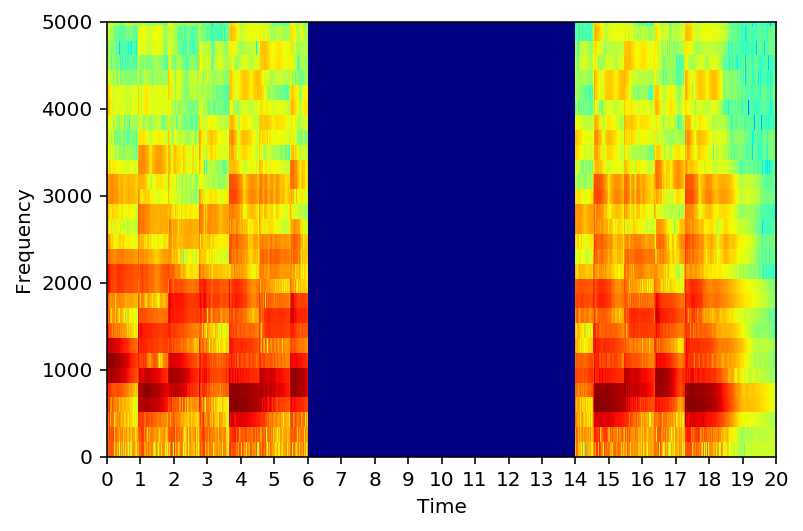

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-7.wav


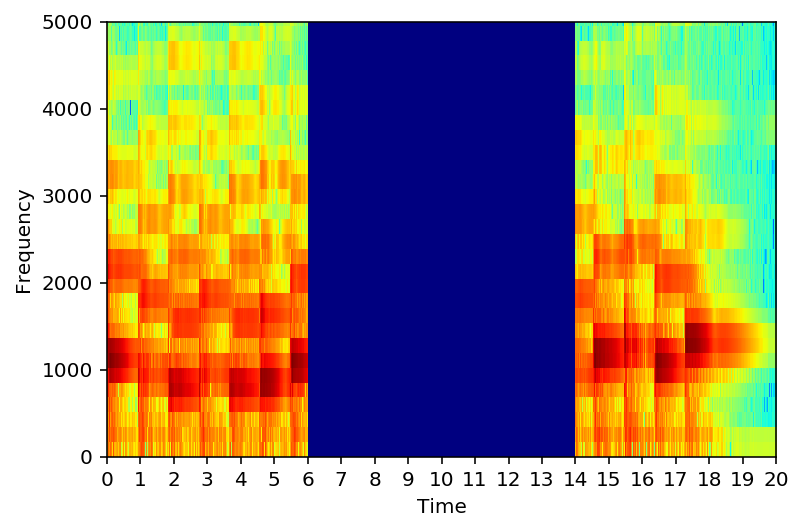

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-8.wav


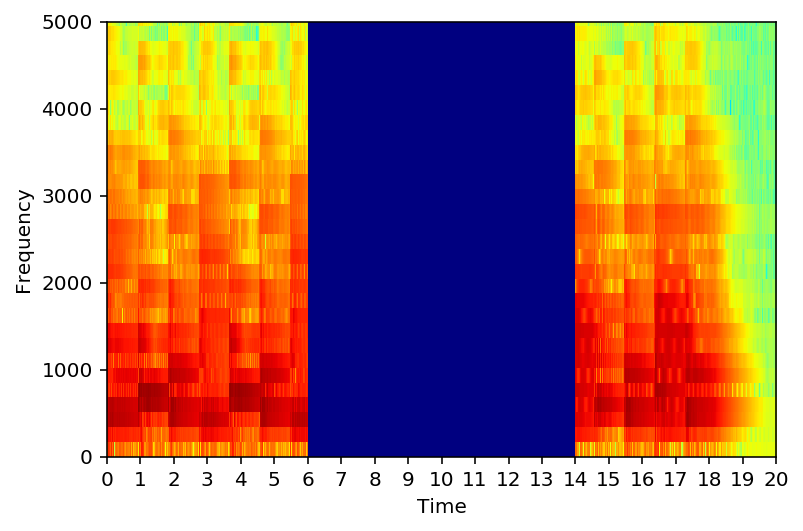

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-9.wav


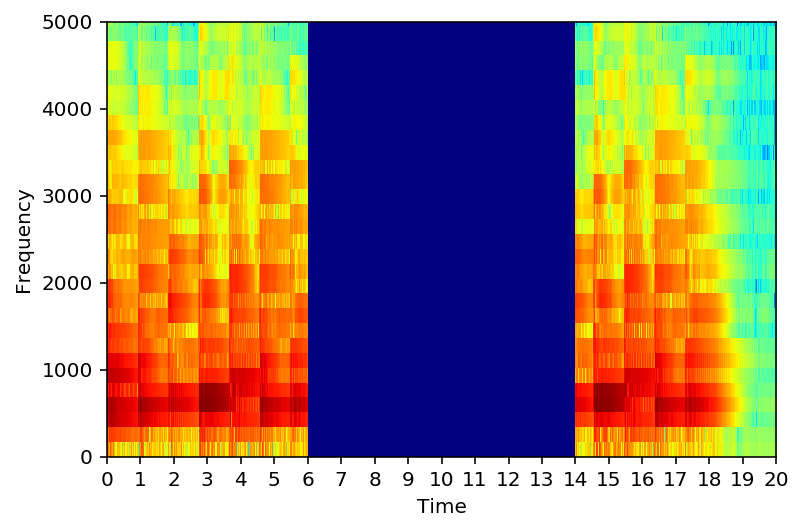

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-10.wav


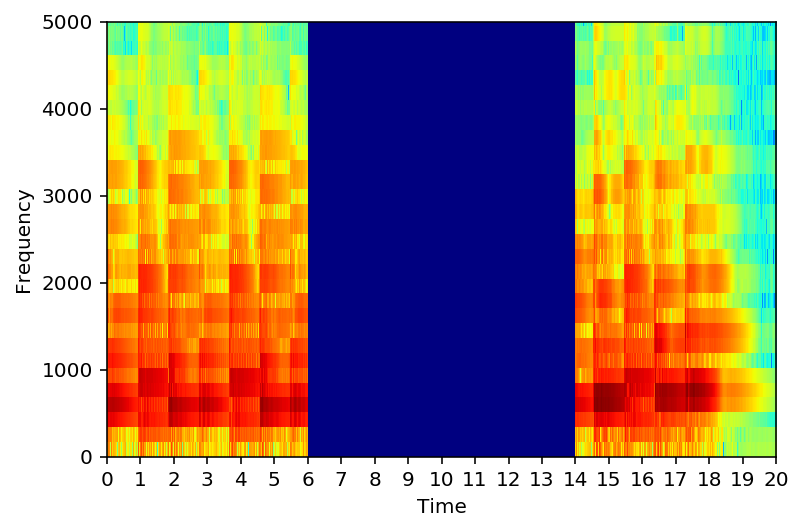

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-11.wav


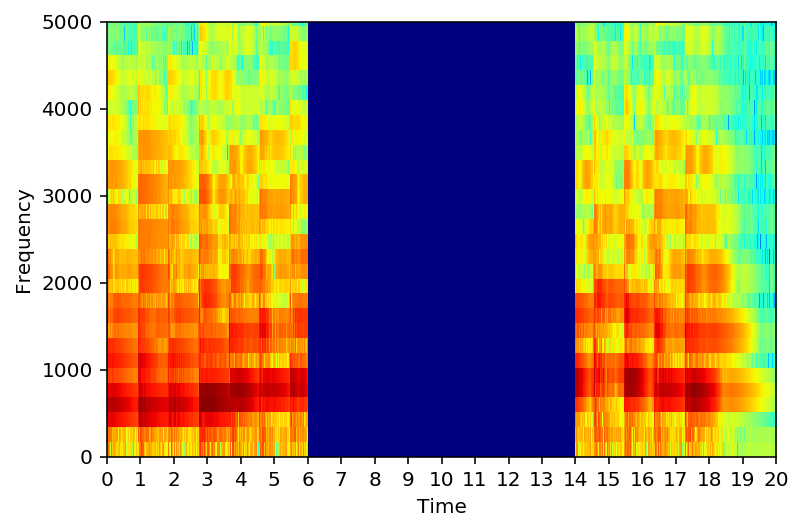

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-12.wav


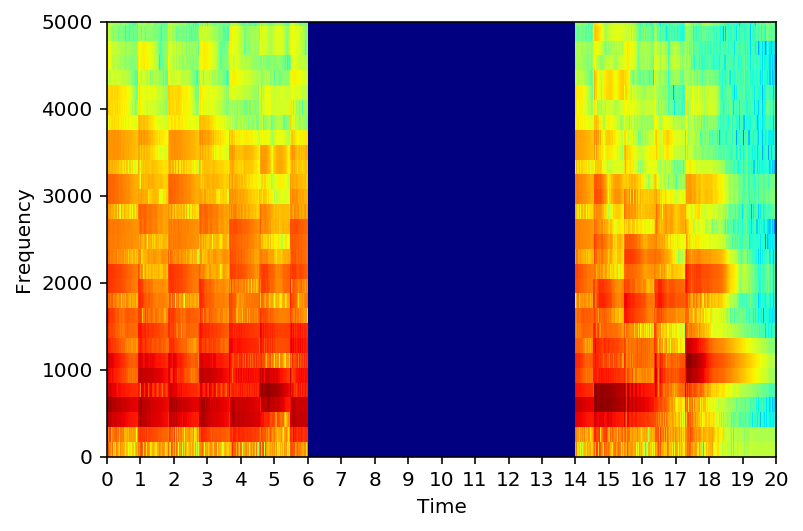

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-13.wav


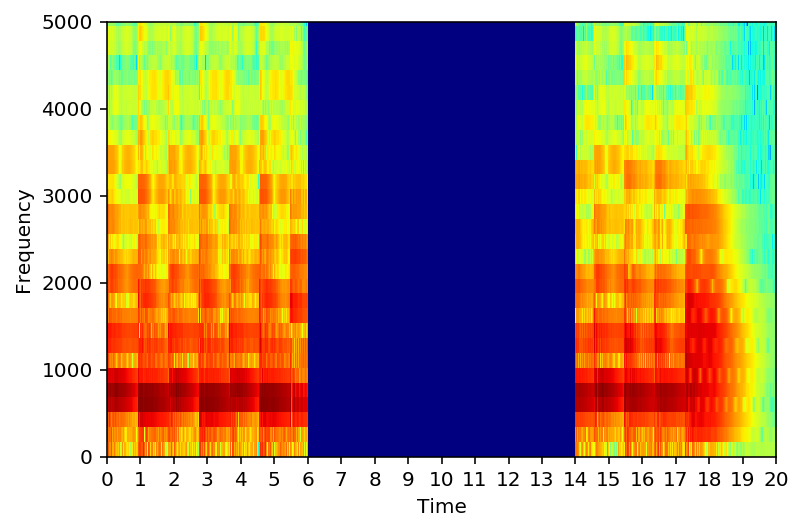

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-14.wav


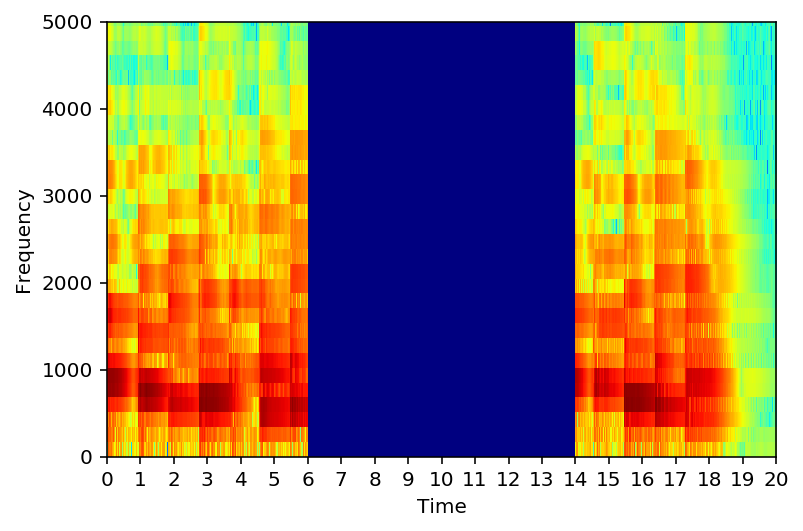

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-15.wav


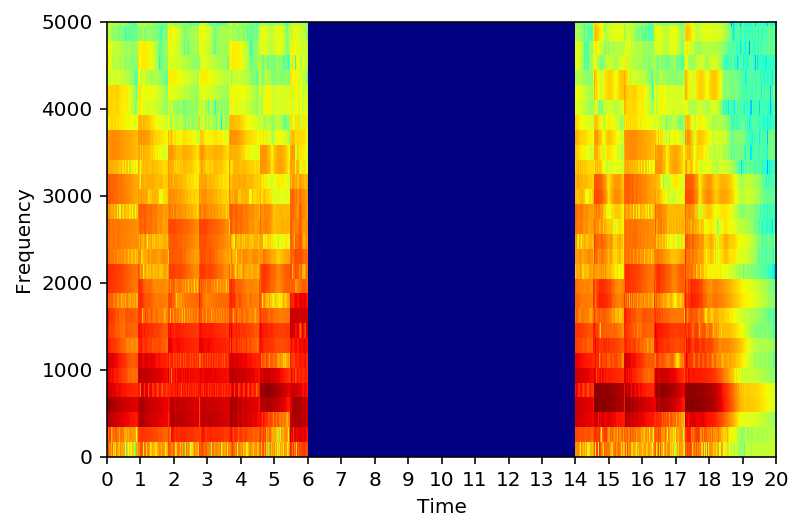

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-16.wav


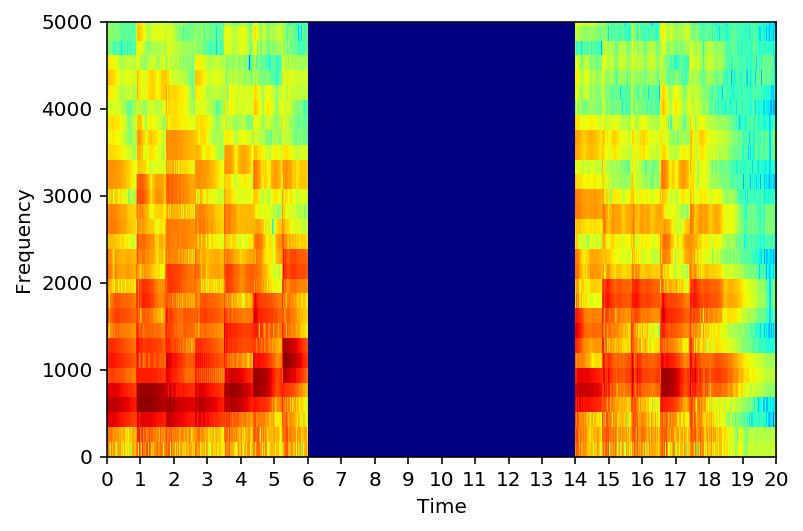

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-17.wav


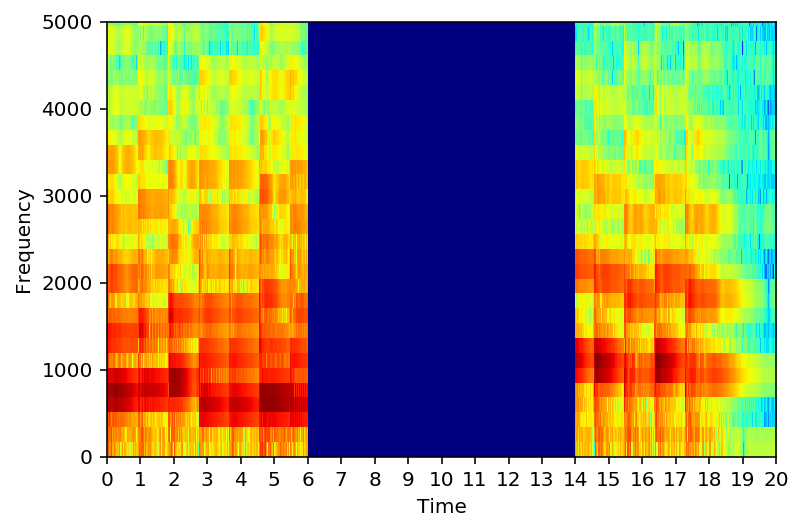

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-18.wav


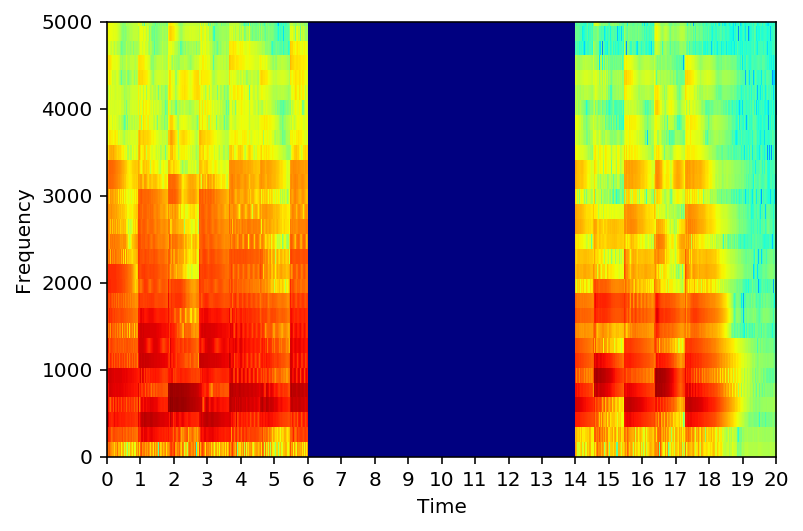

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/orig-19.wav


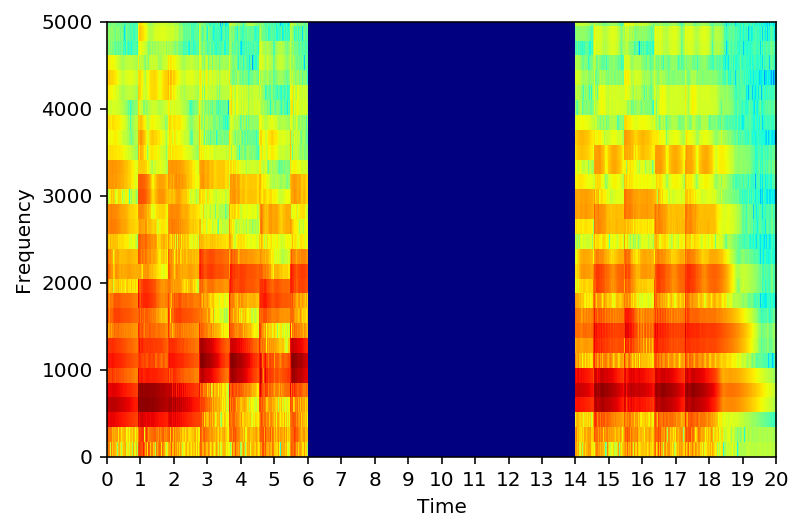

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-1.wav


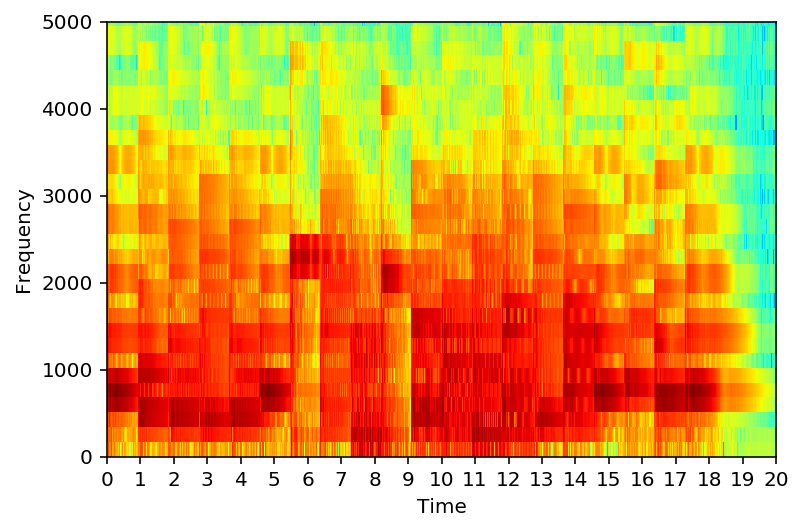

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-2.wav


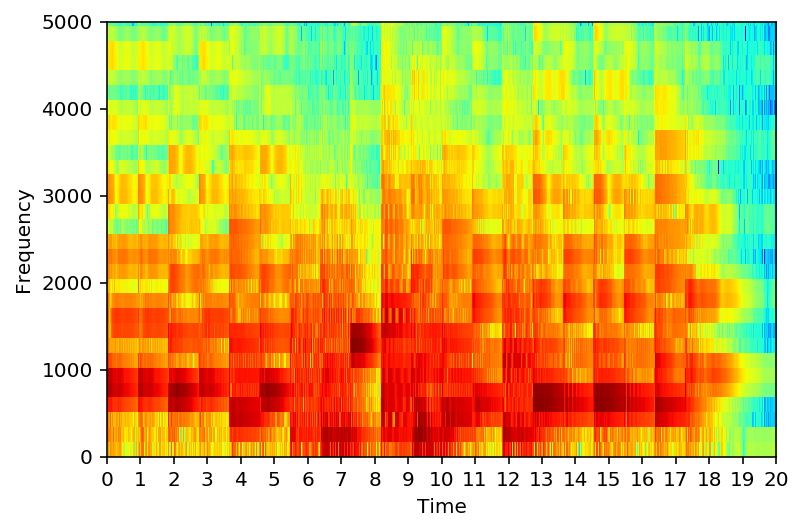

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-3.wav


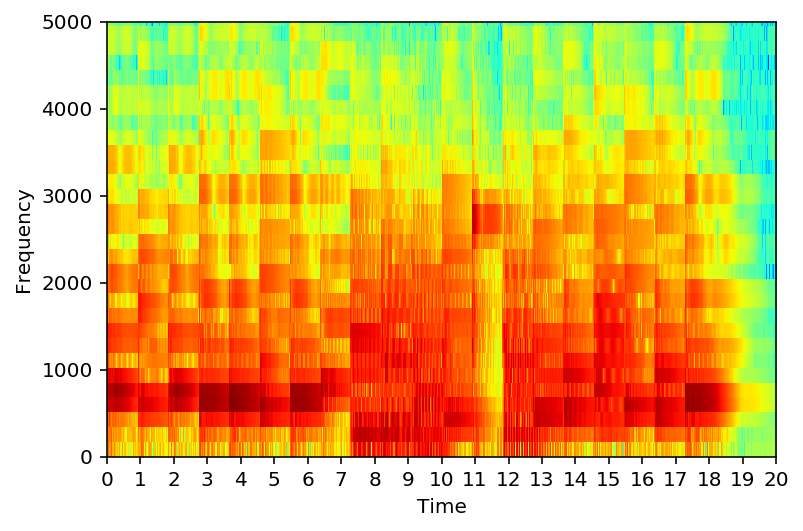

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-4.wav


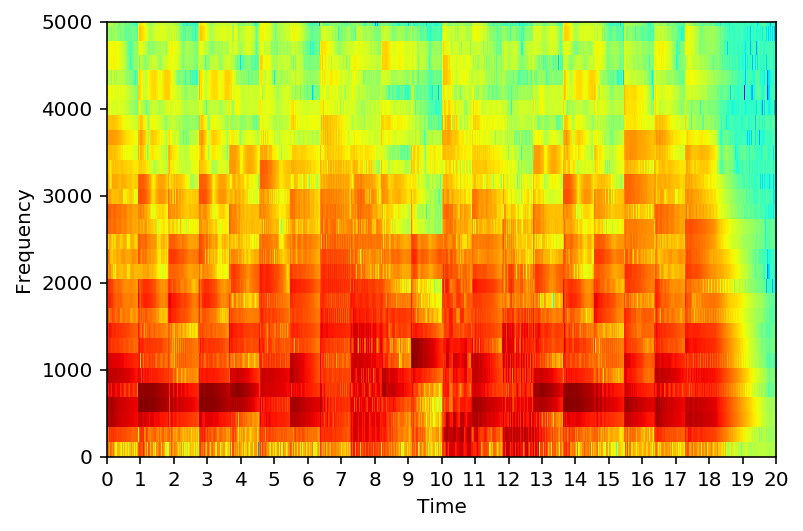

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-5.wav


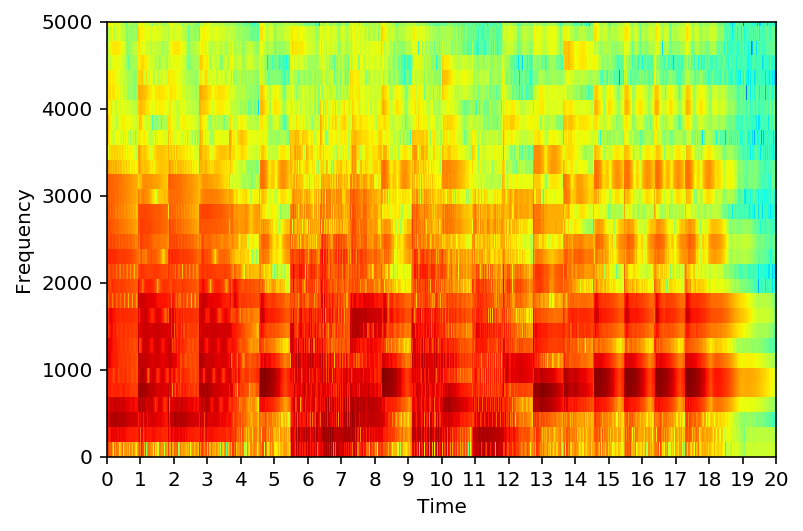

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-6.wav


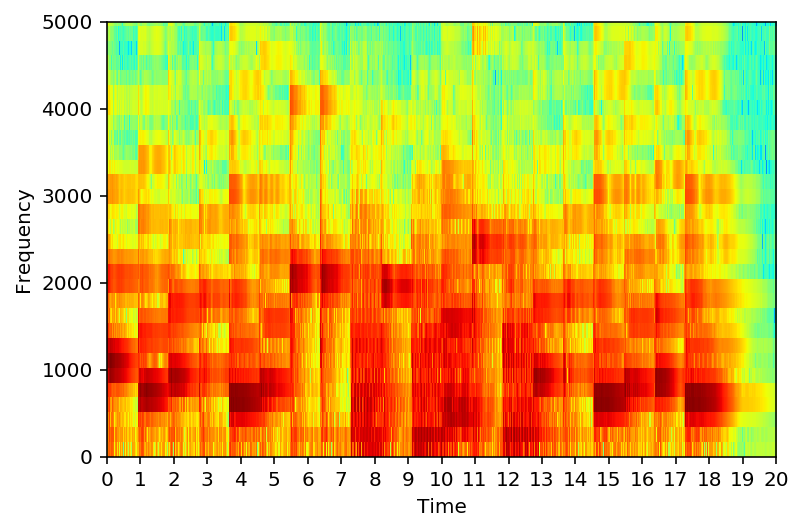

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-7.wav


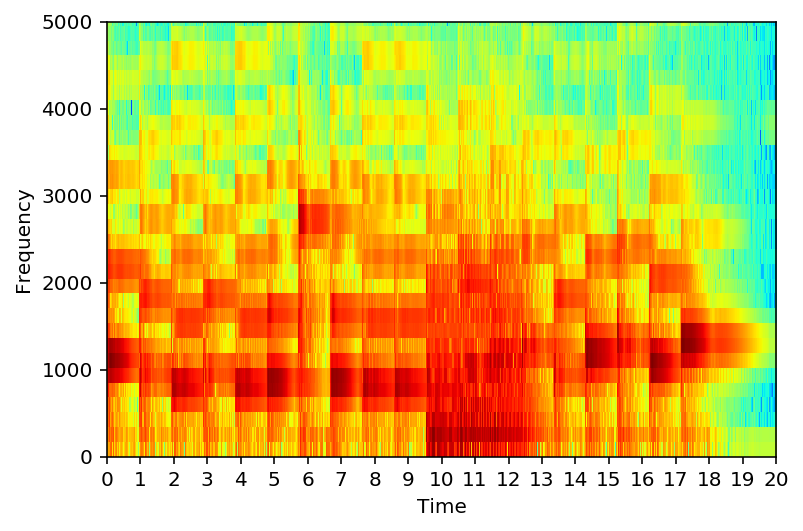

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-8.wav


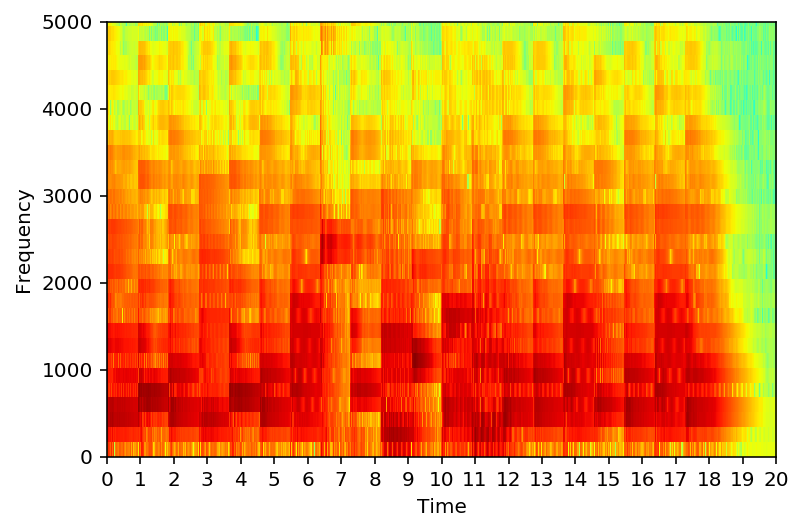

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-9.wav


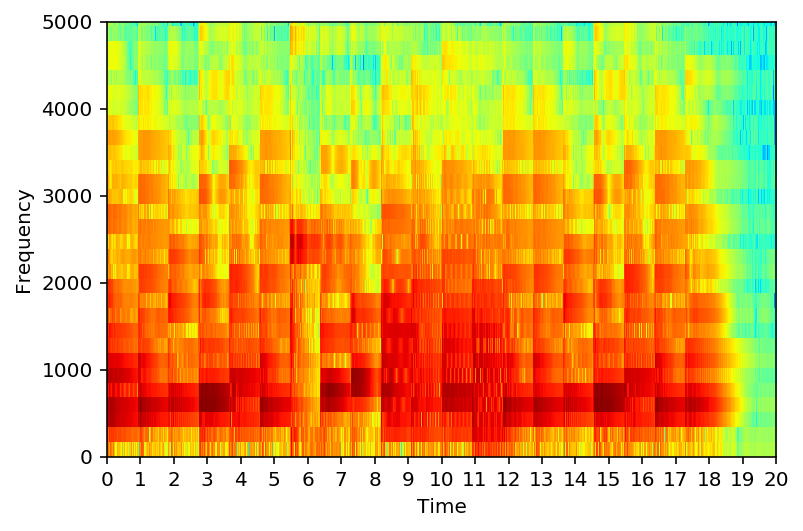

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-10.wav


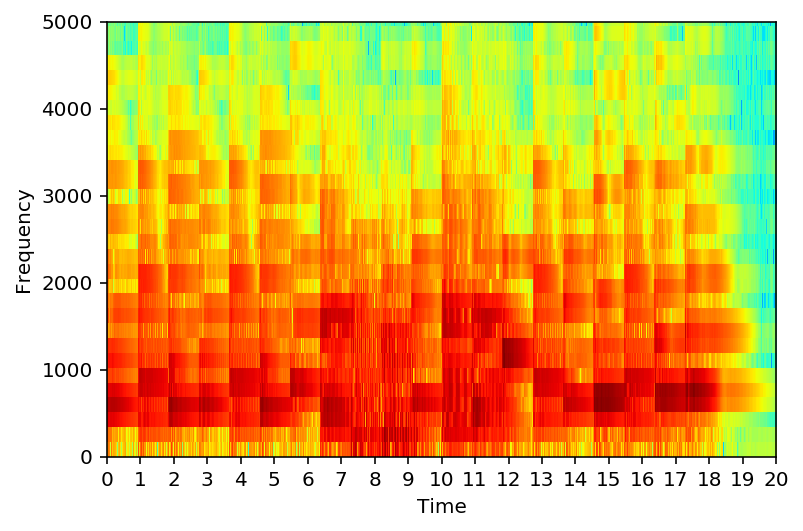

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-11.wav


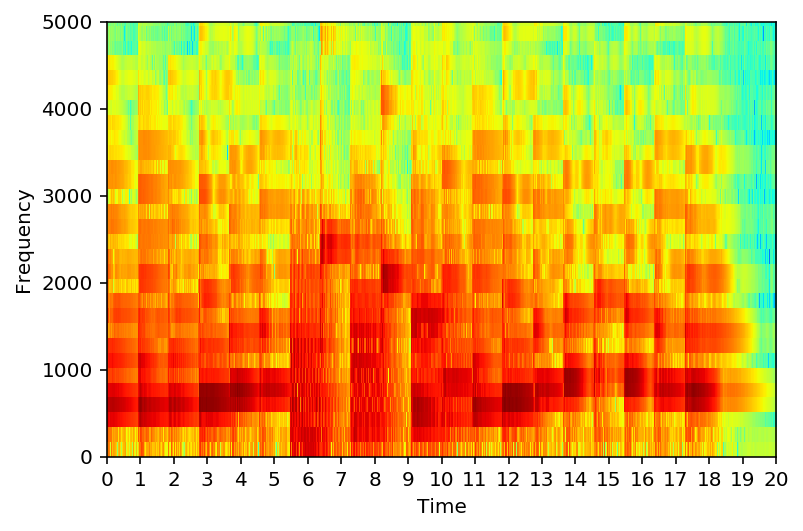

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-12.wav


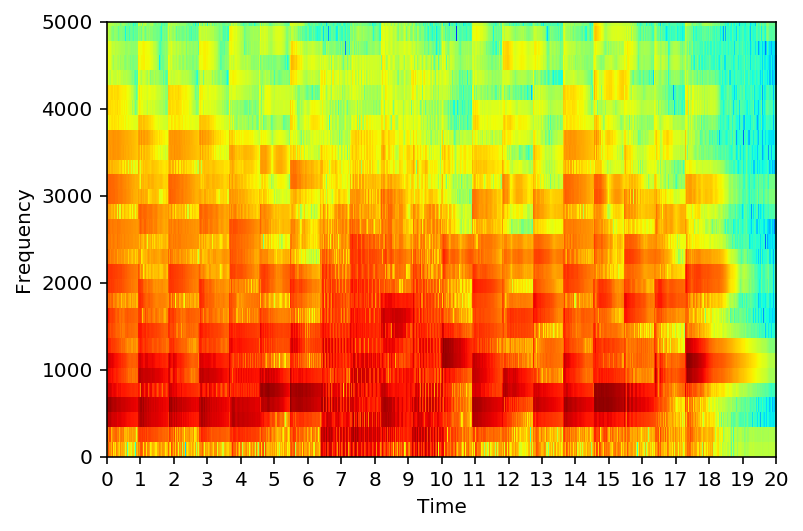

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-13.wav


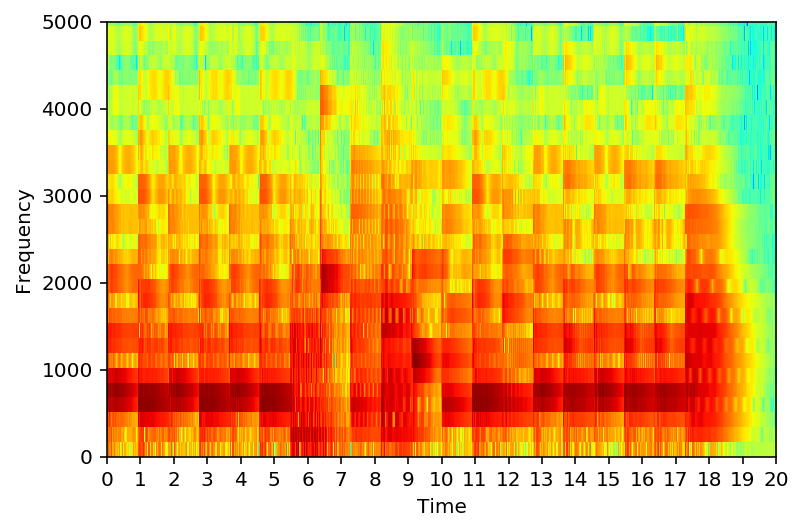

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-14.wav


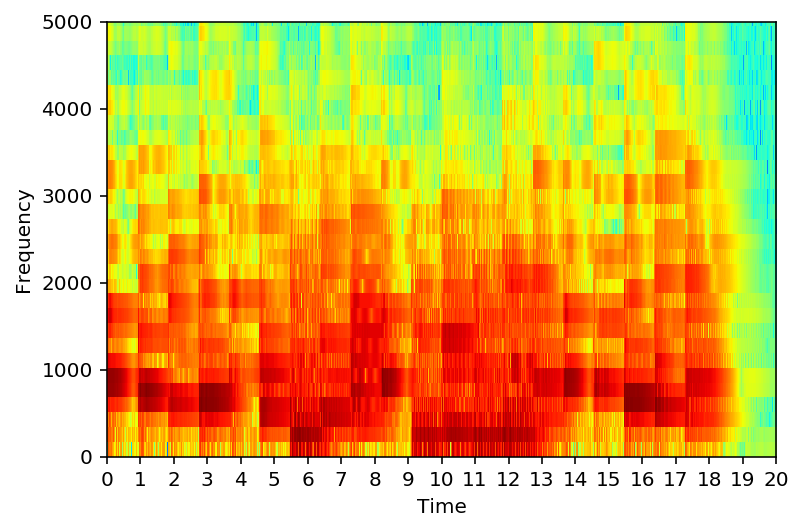

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-15.wav


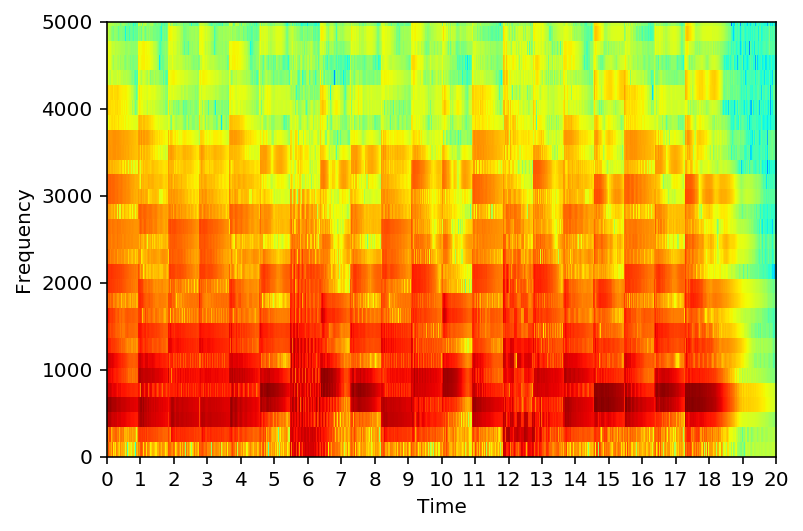

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-16.wav


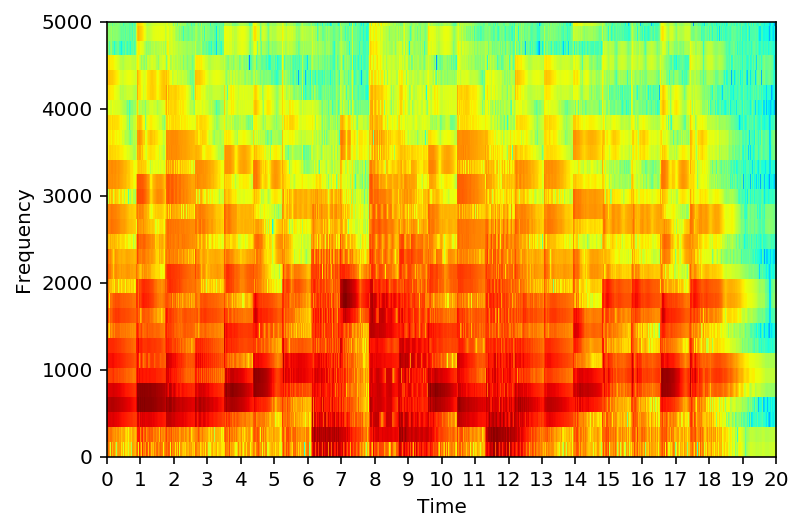

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-17.wav


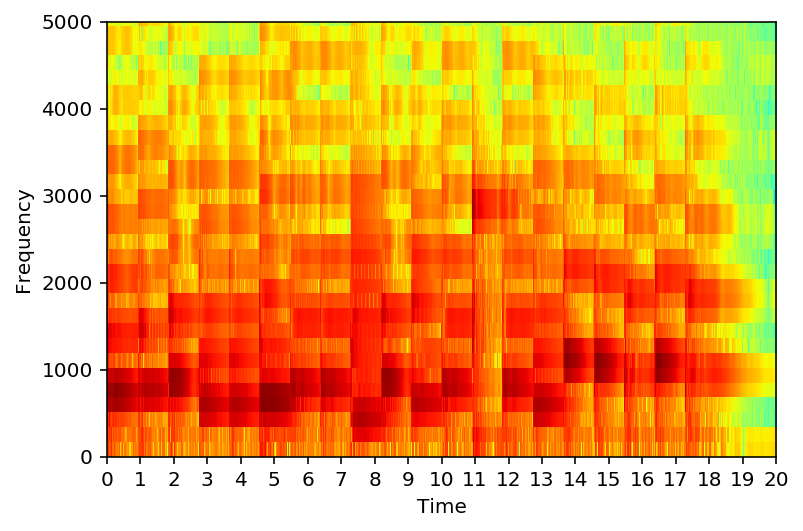

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-18.wav


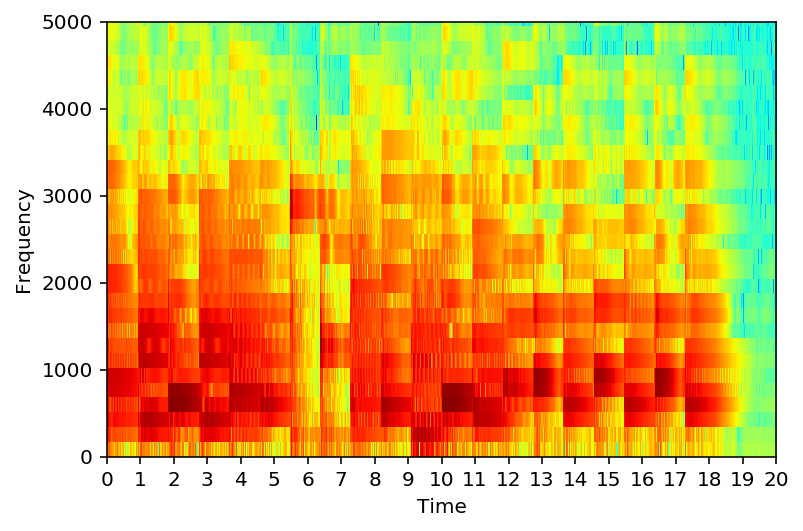

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/haydn/filled-19.wav


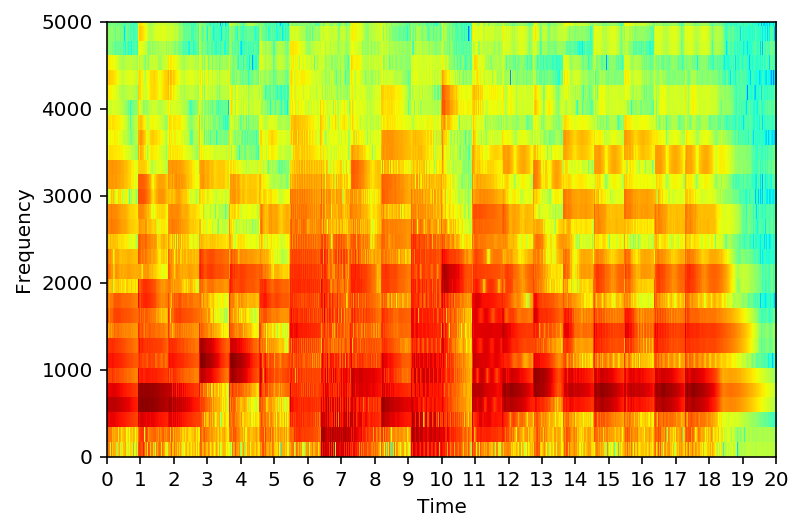

read ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/mono_orig.txt
C4 E4 C#4 F4 D4 A4 D5 B3 E4 G#3 E5 C5 A3 D4 F3 B4 A4 G#4 E3 E4
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-1.wav


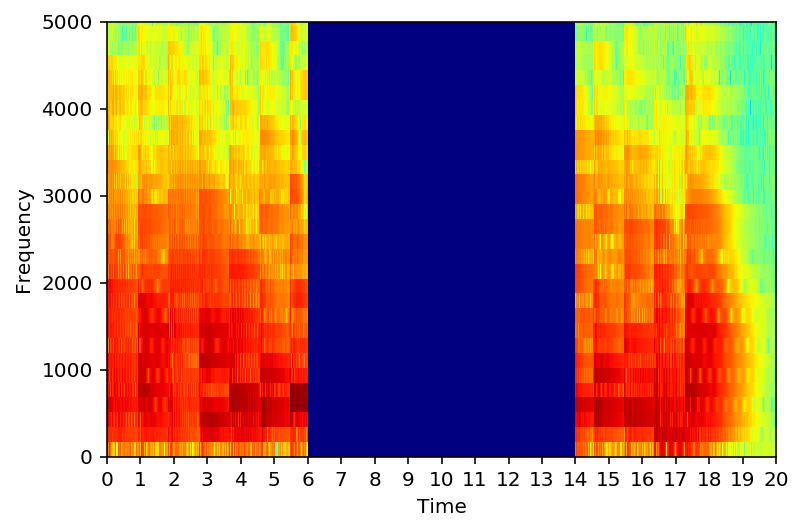

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-2.wav


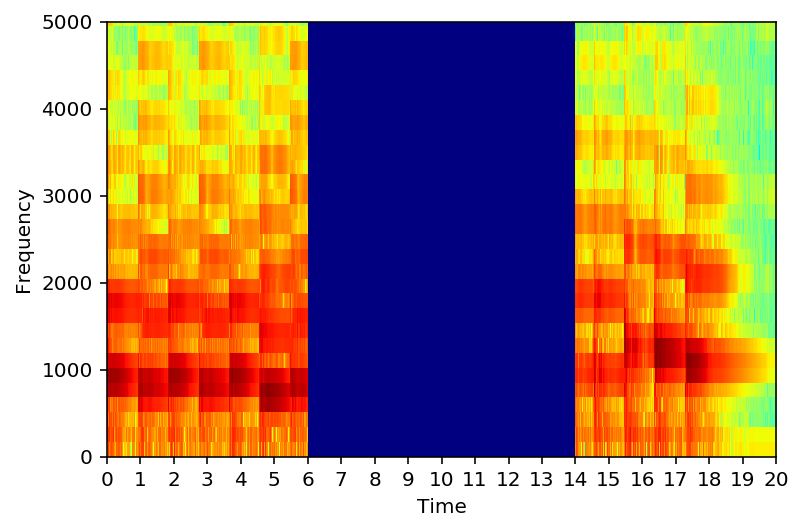

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-3.wav


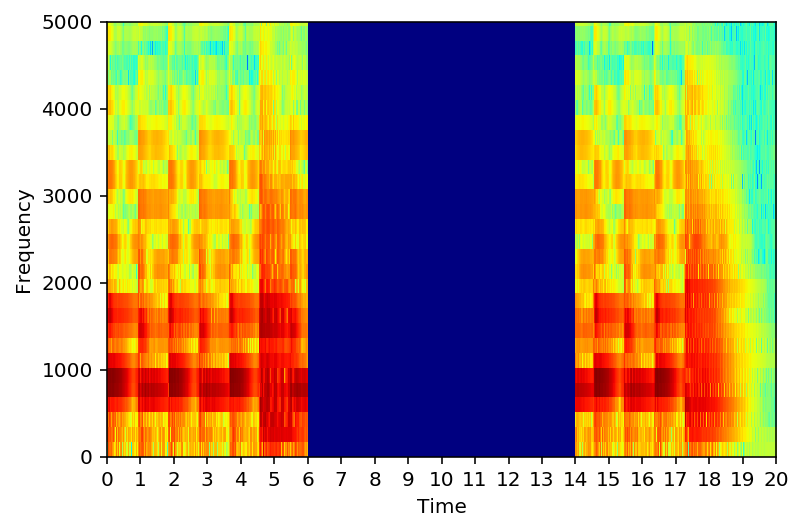

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-4.wav


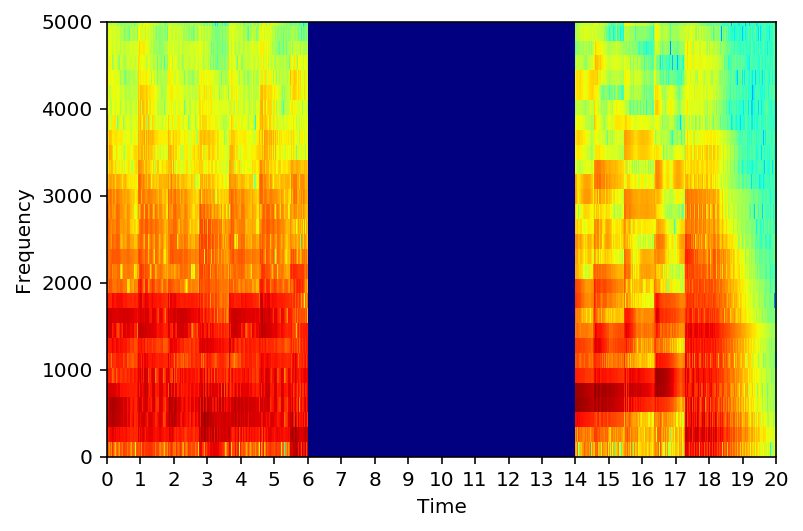

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-5.wav


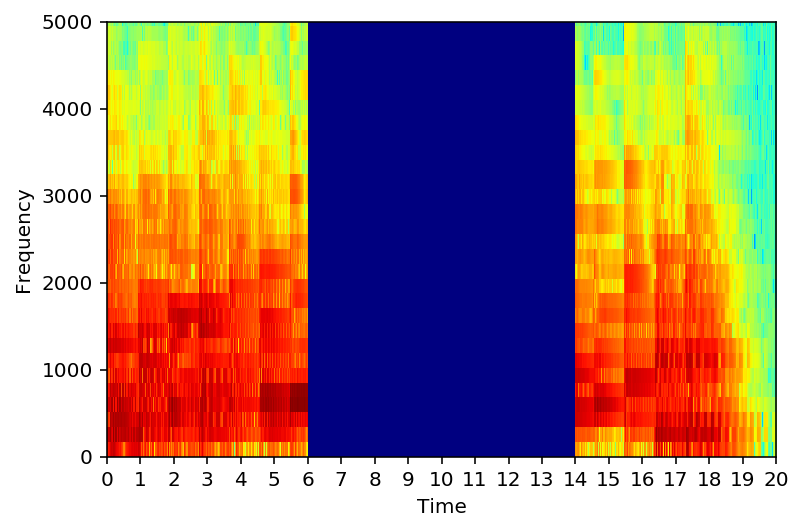

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-6.wav


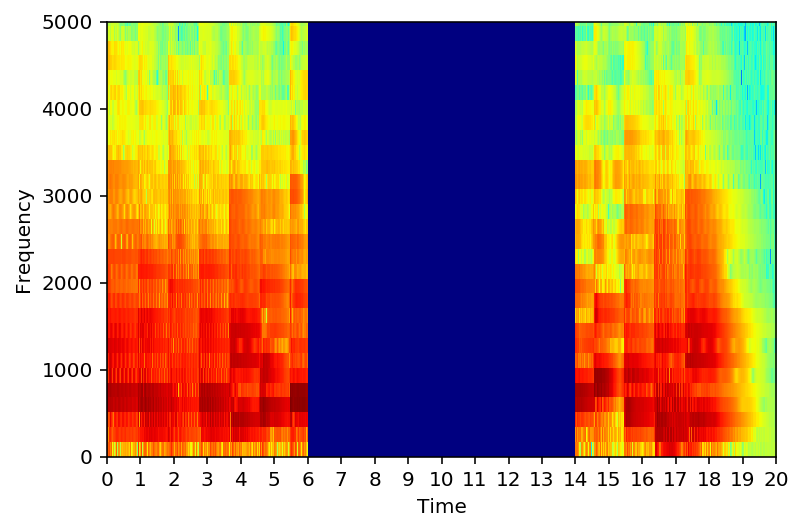

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-7.wav


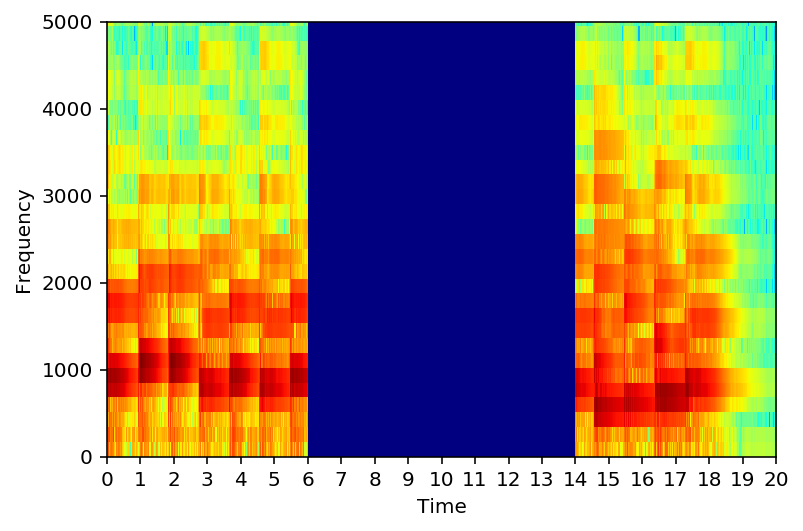

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-8.wav


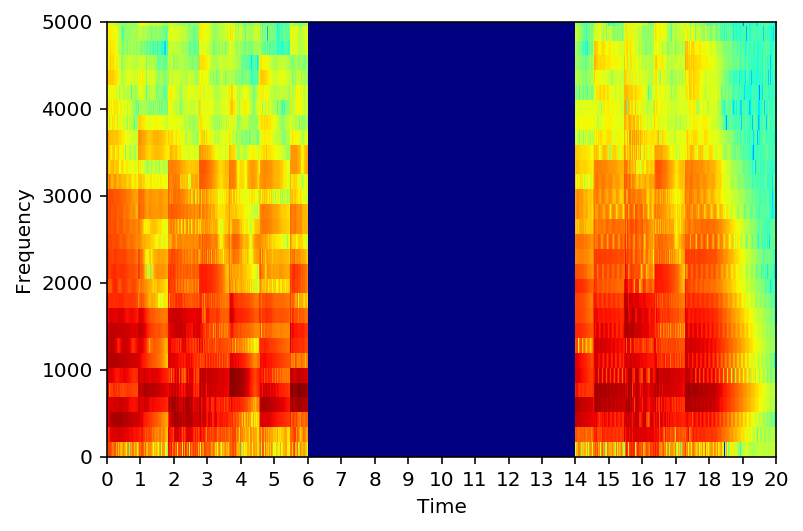

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-9.wav


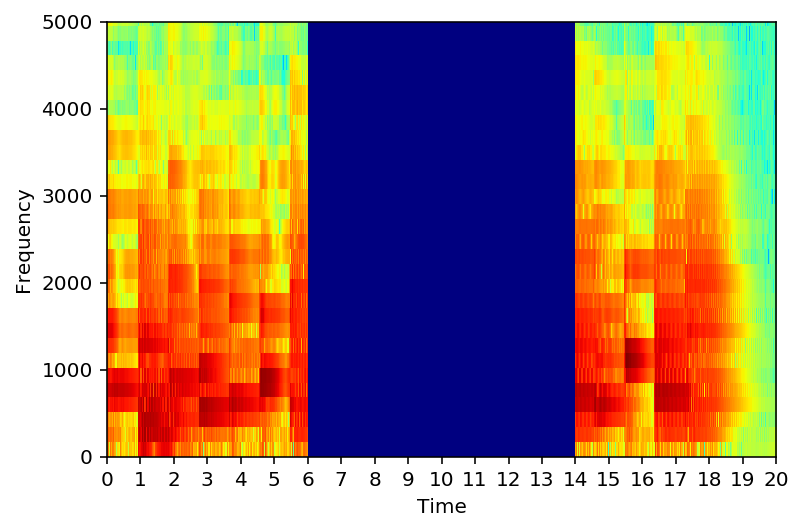

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-10.wav


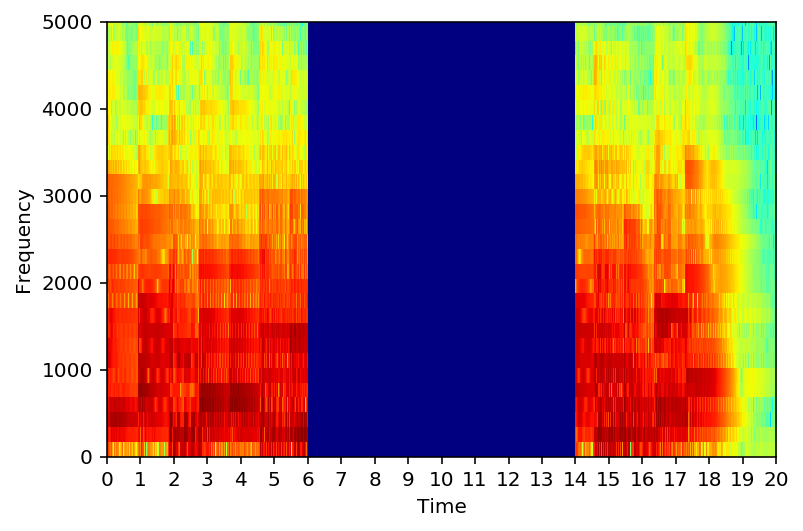

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-11.wav


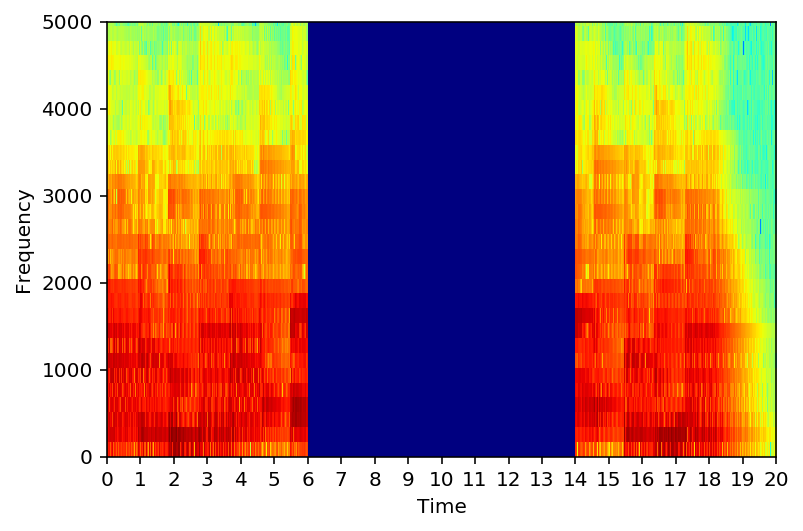

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-12.wav


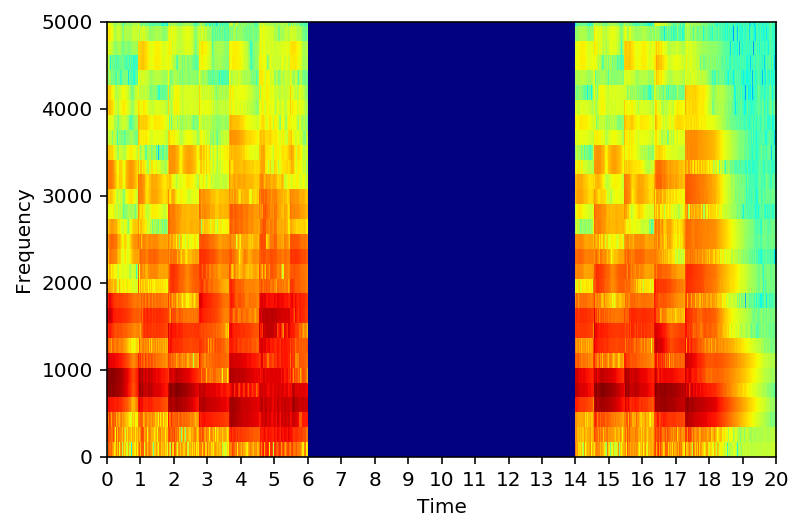

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-13.wav


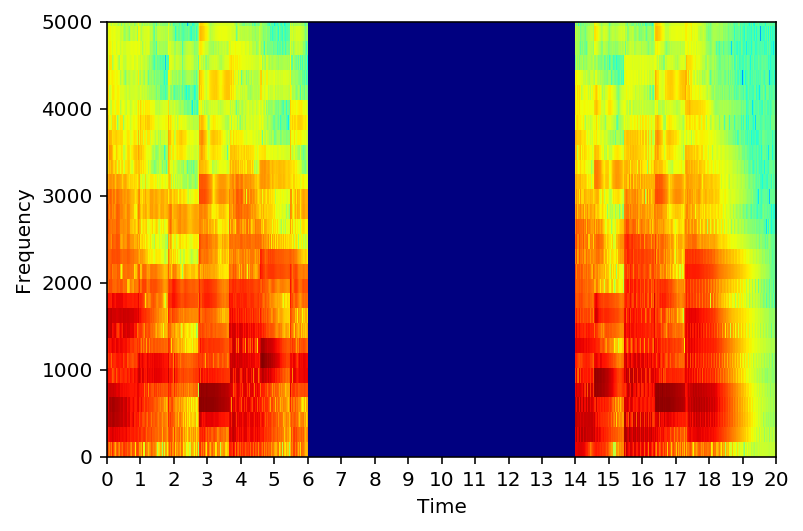

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-14.wav


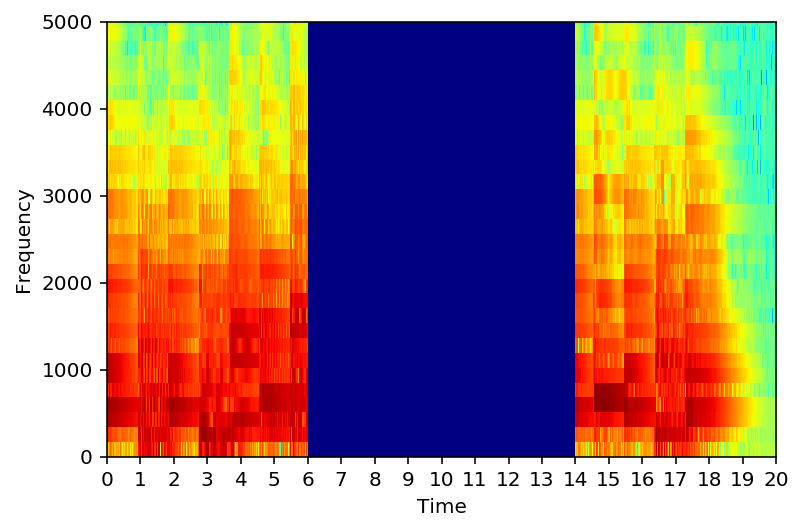

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-15.wav


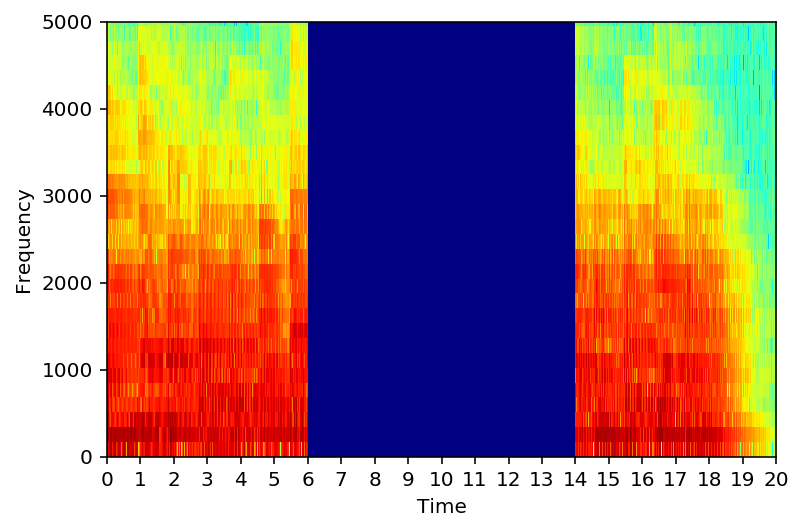

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/orig-16.wav


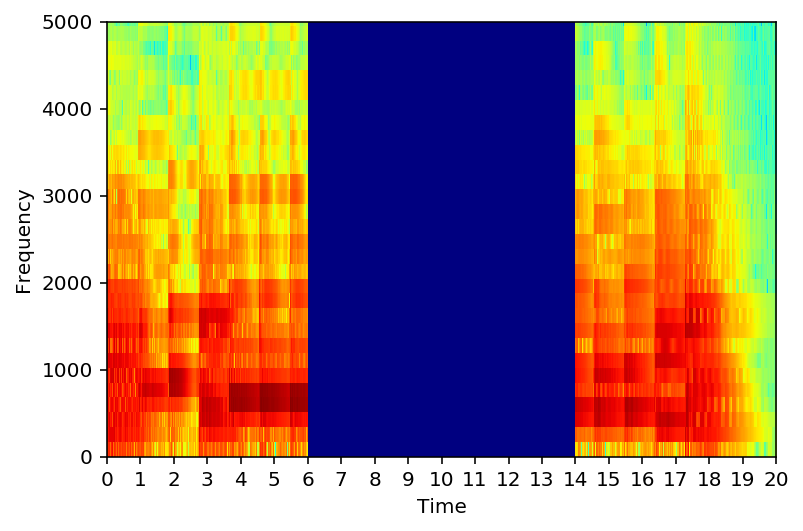

read ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-1.wav


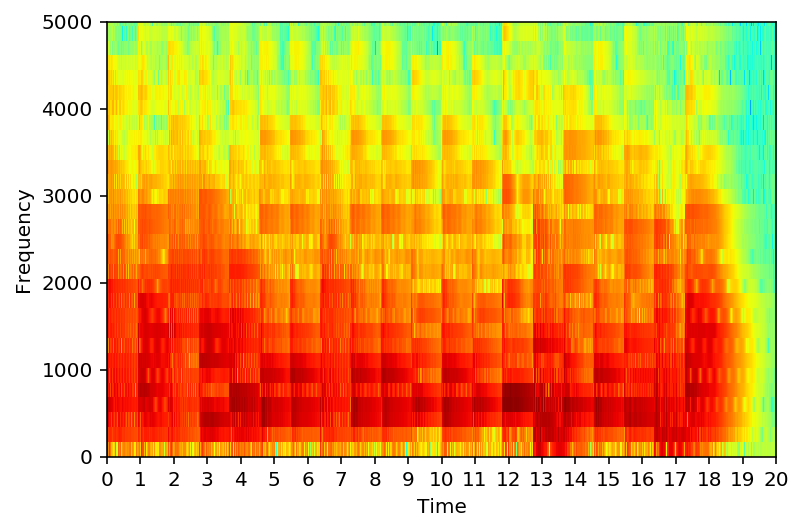

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-2.wav


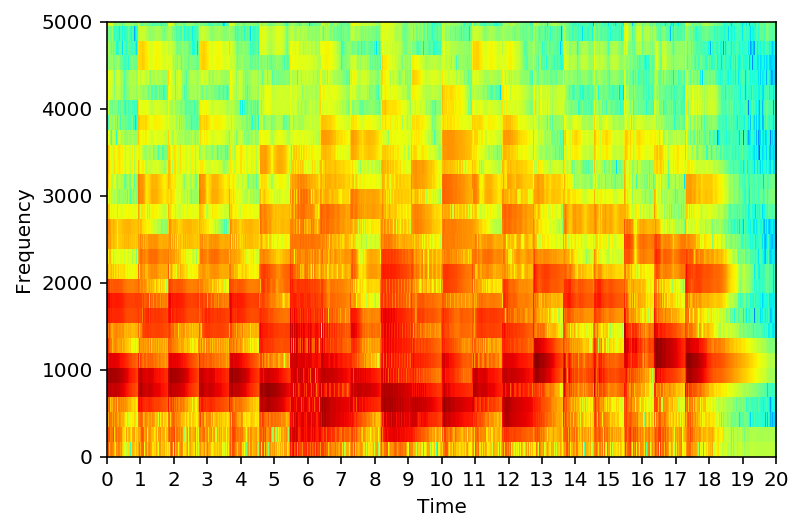

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-3.wav


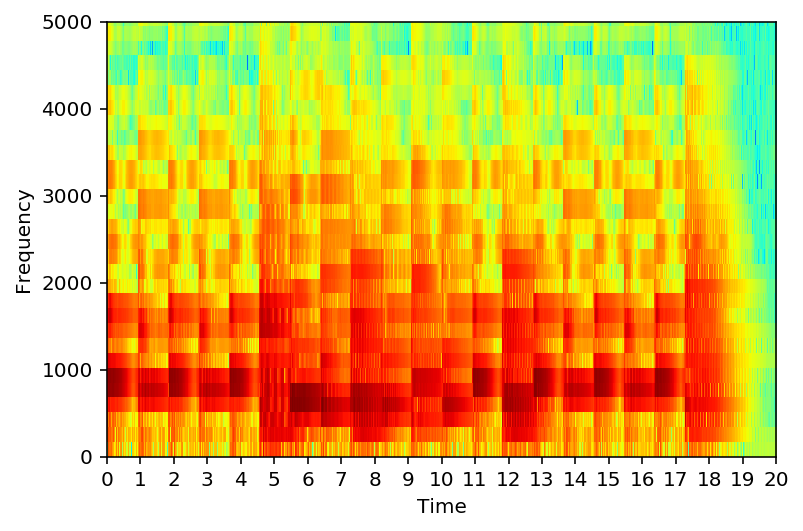

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-4.wav


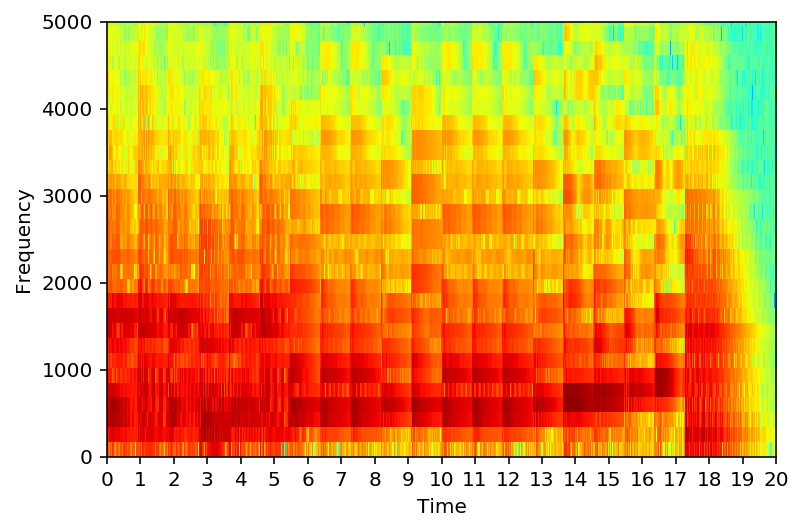

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-5.wav


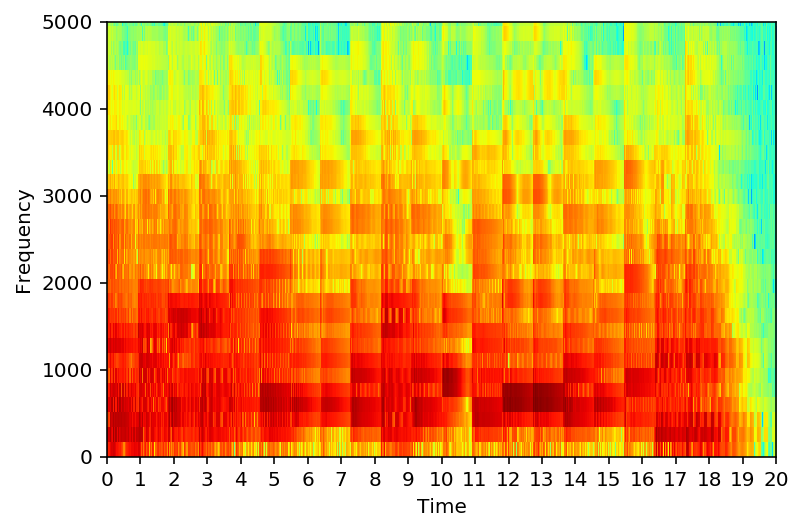

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-6.wav


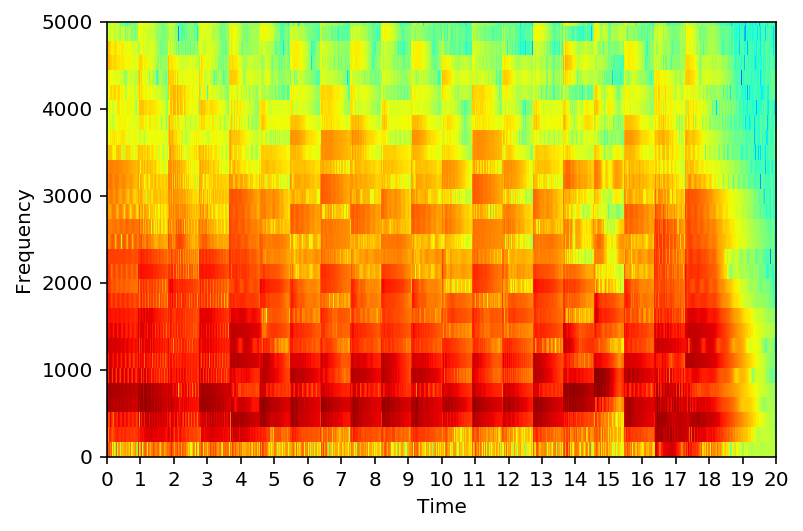

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-7.wav


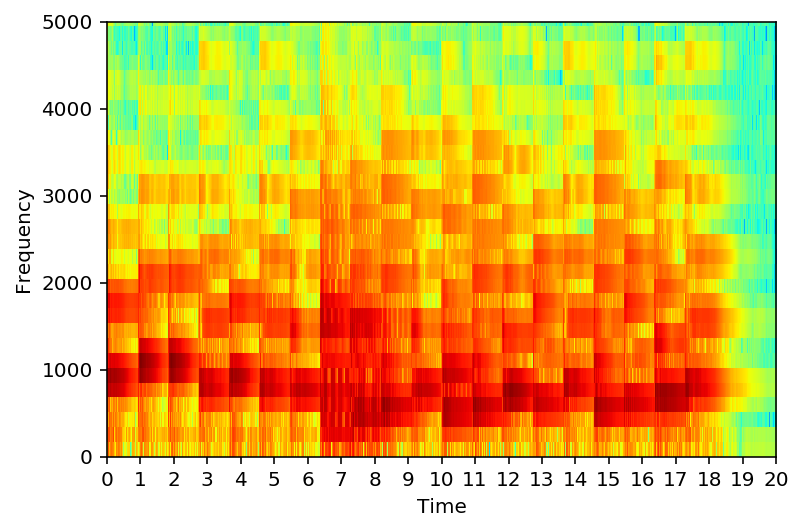

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-8.wav


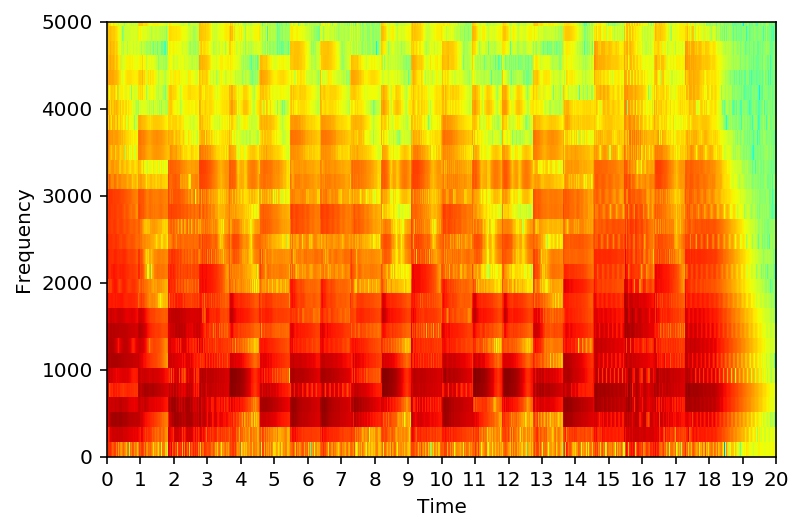

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-9.wav


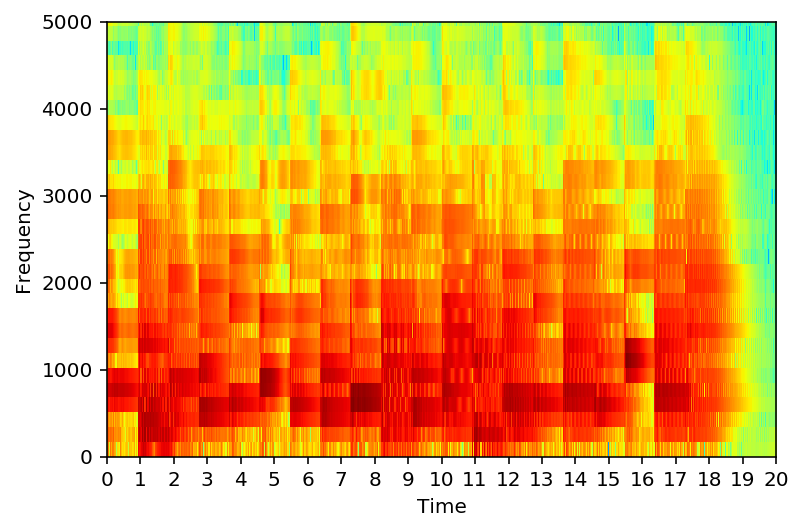

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-10.wav


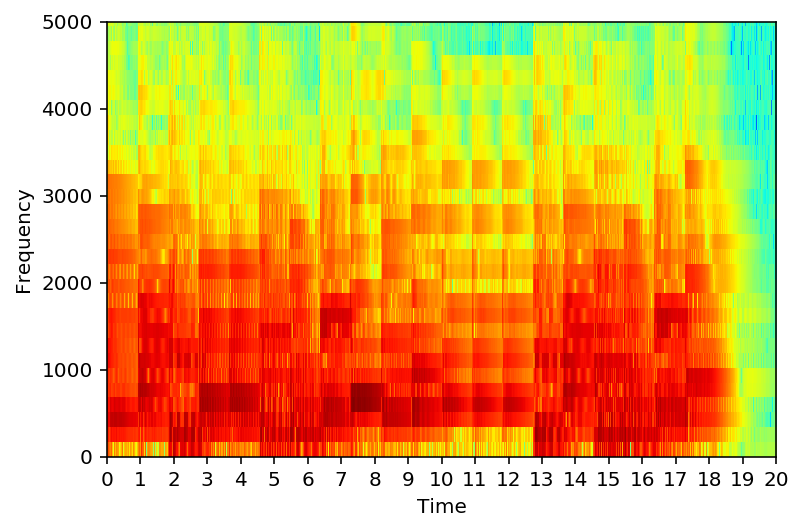

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-11.wav


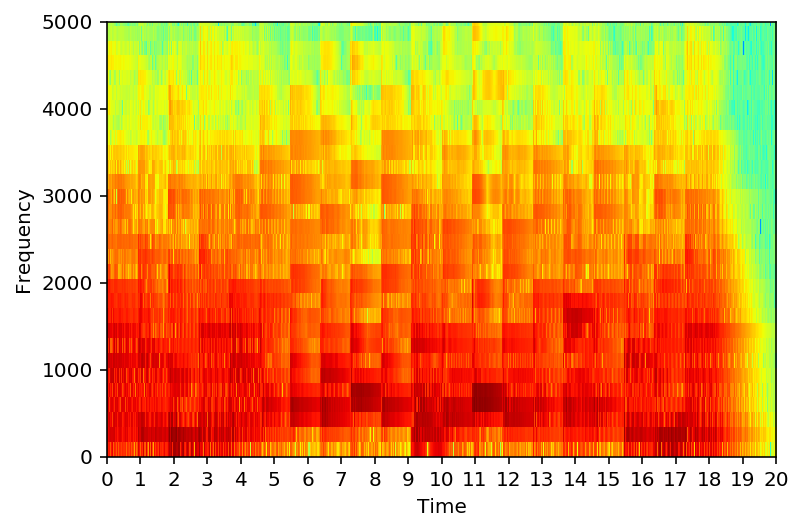

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-12.wav


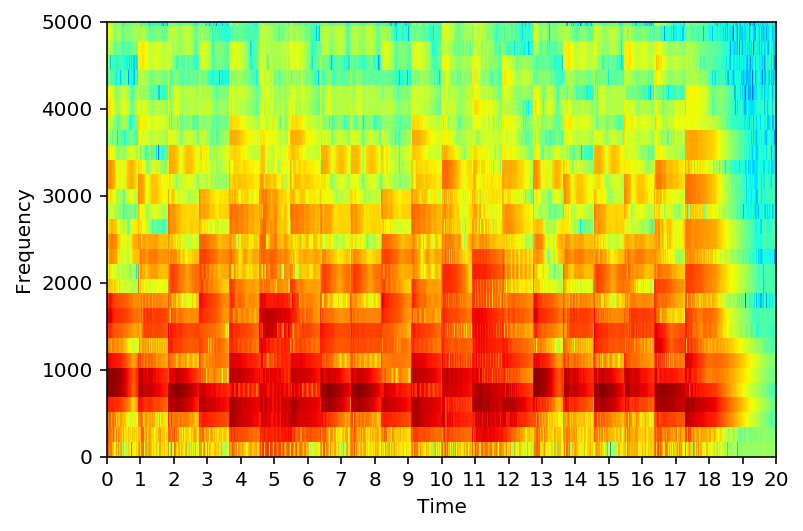

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-13.wav


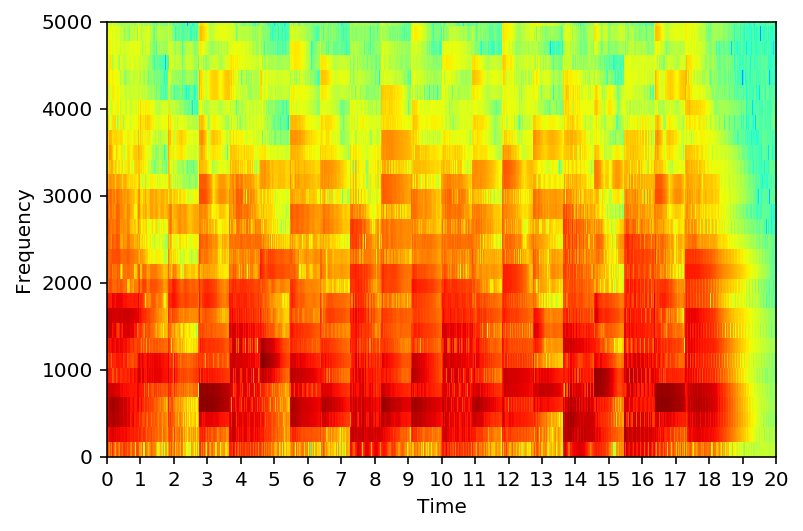

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-14.wav


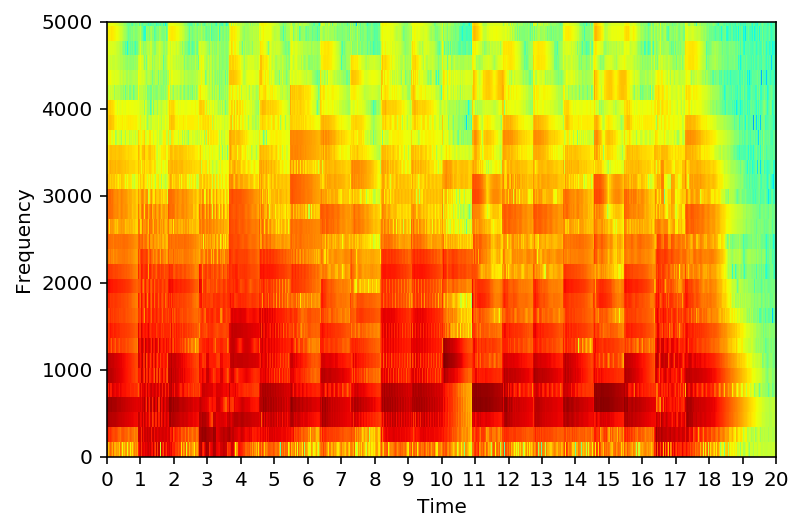

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-15.wav


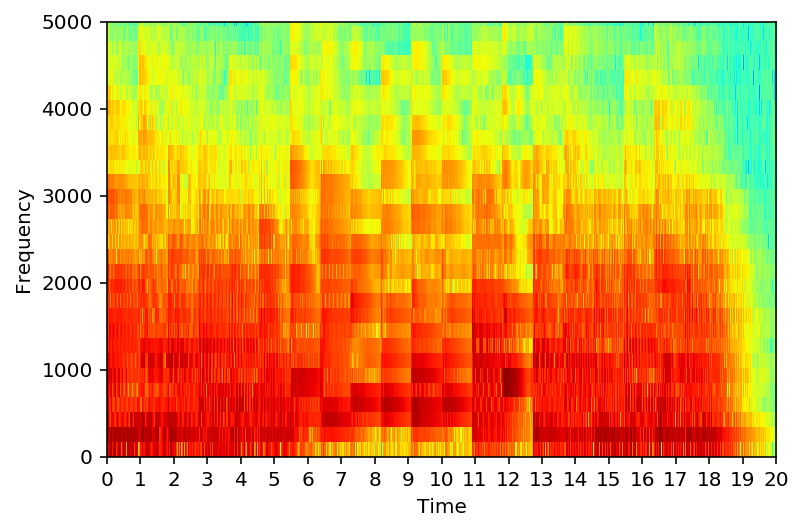

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/handel/filled-16.wav


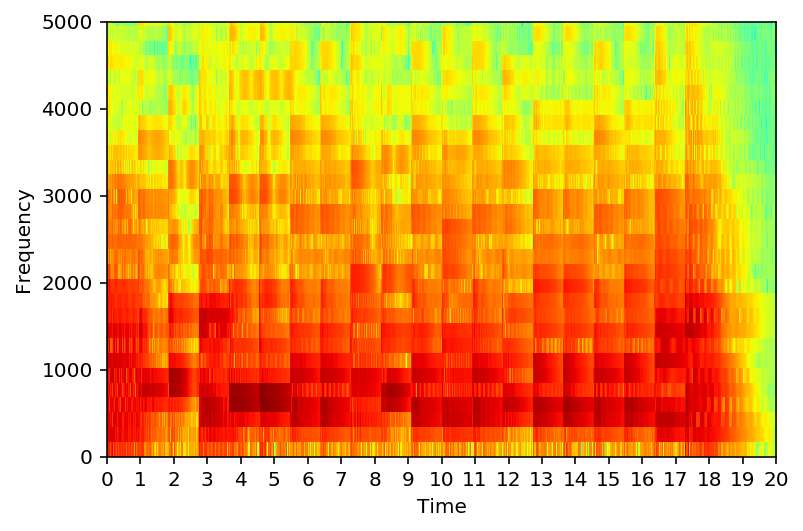

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/mono_orig.txt
F#5 E5 D5 C#5 B4 A4 B4 C#5 D5 C#5 B4 C#5 A4 F#5 E5 D5 C#5 B4 A4 B4
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-1.wav


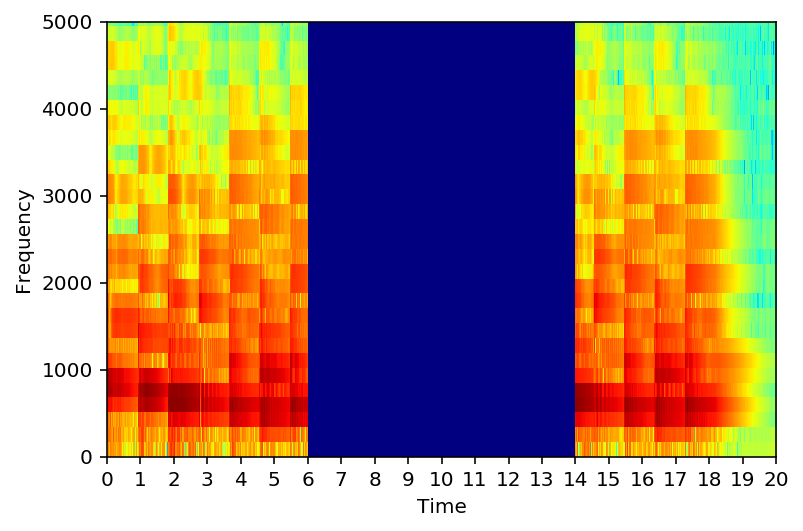

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-2.wav


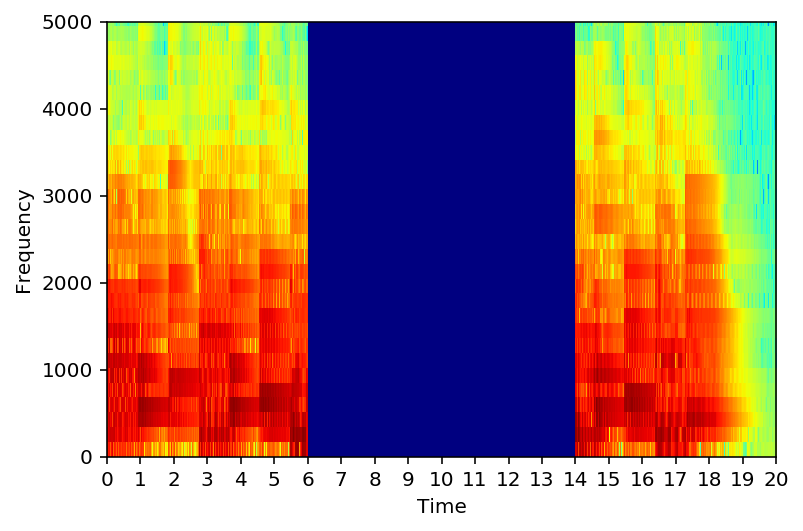

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-3.wav


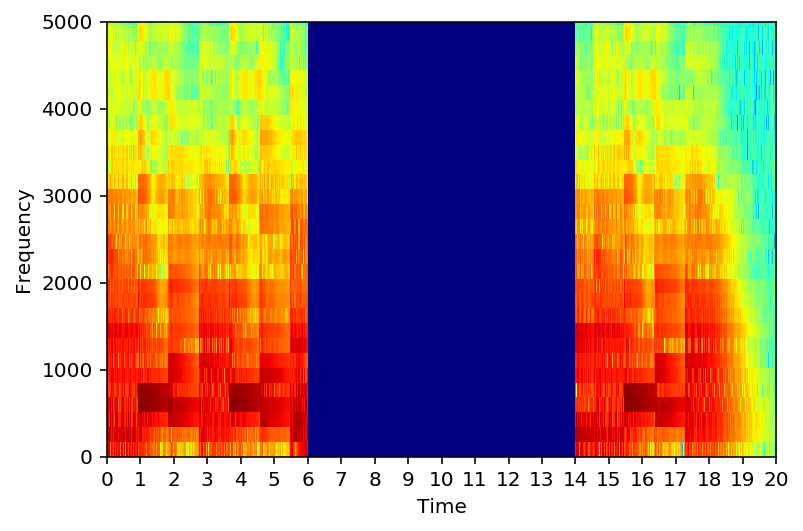

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-4.wav


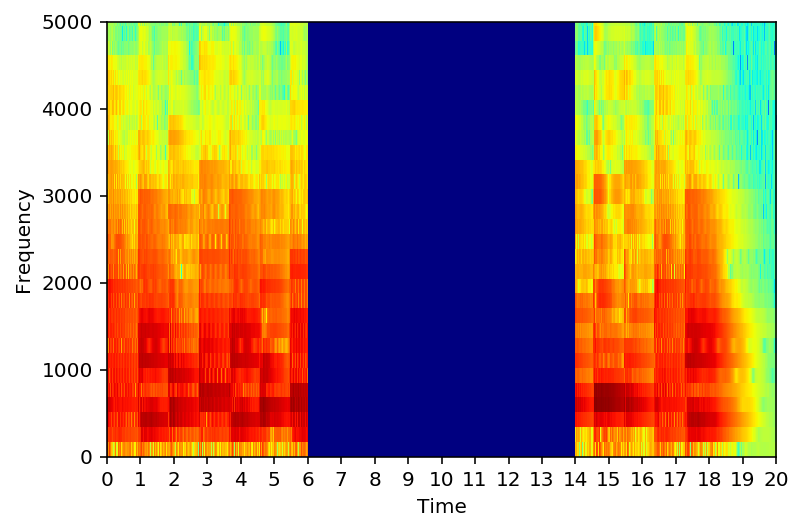

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-5.wav


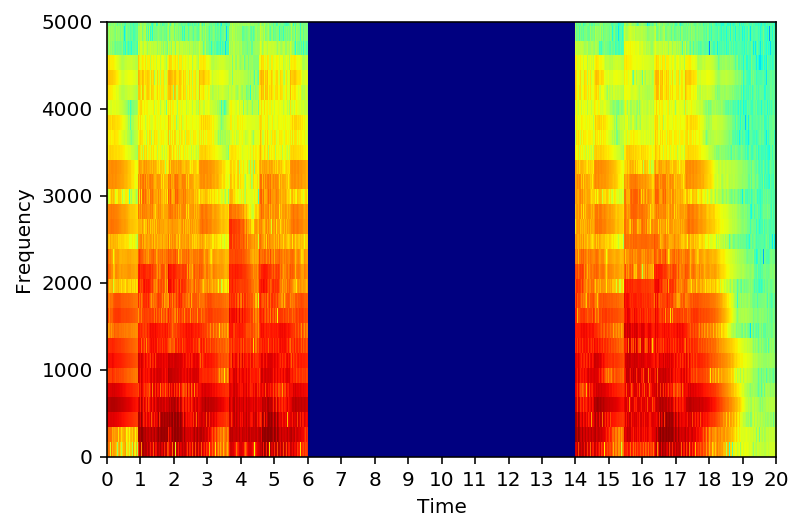

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-6.wav


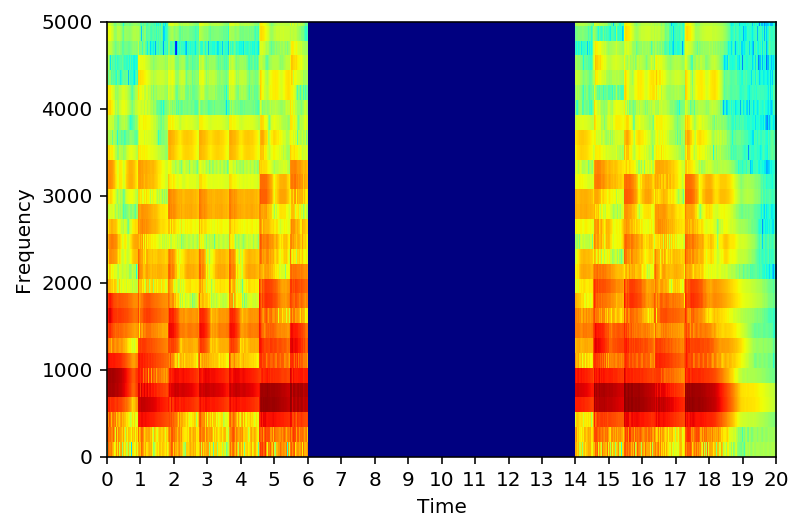

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-7.wav


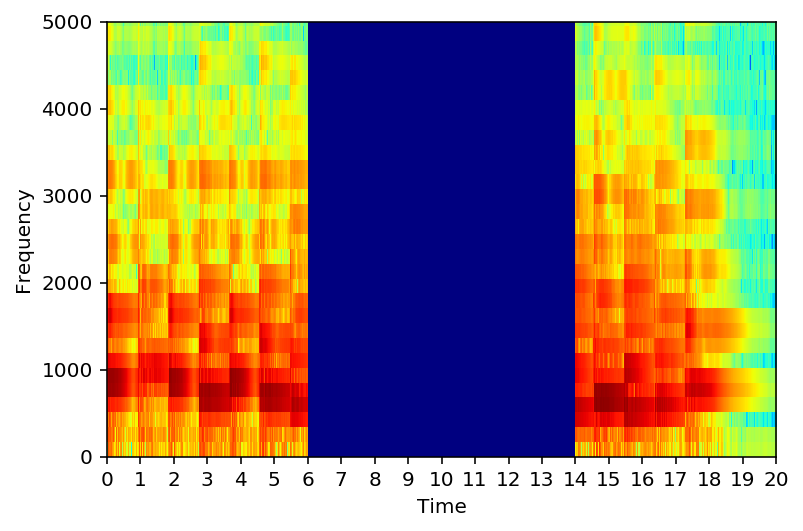

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-8.wav


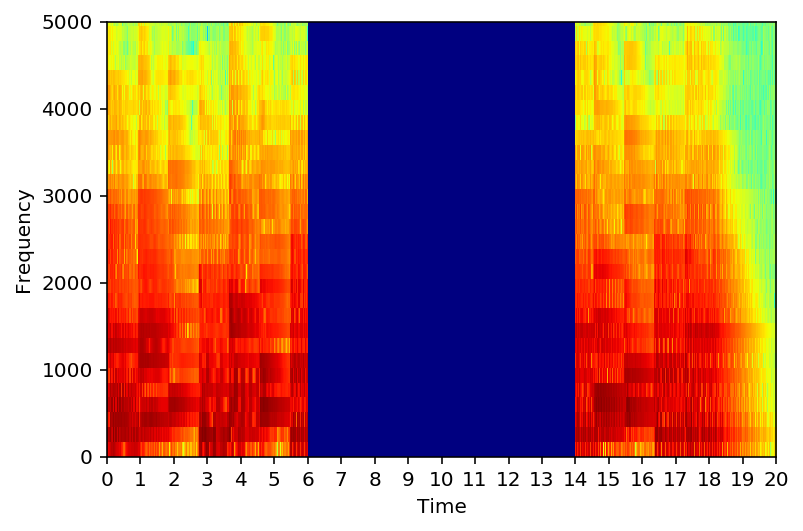

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-9.wav


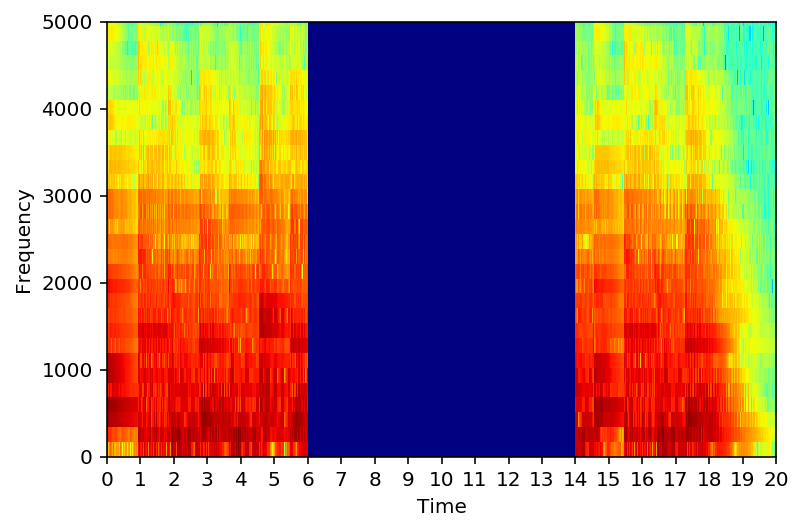

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-10.wav


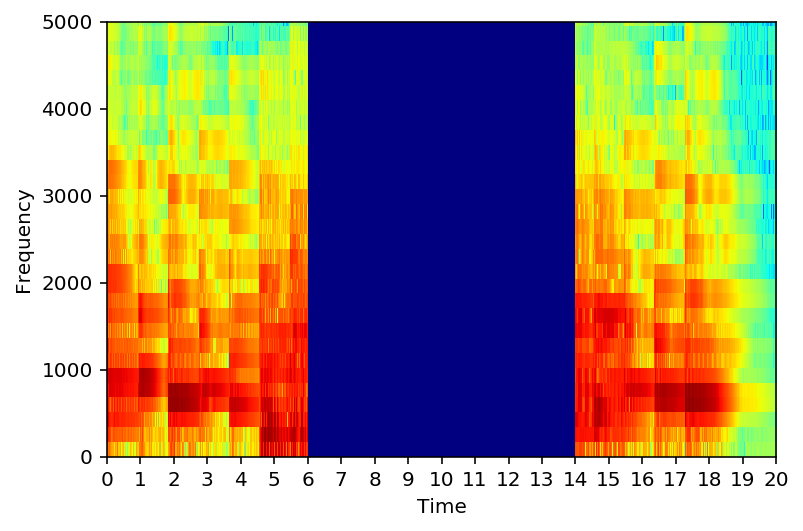

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-11.wav


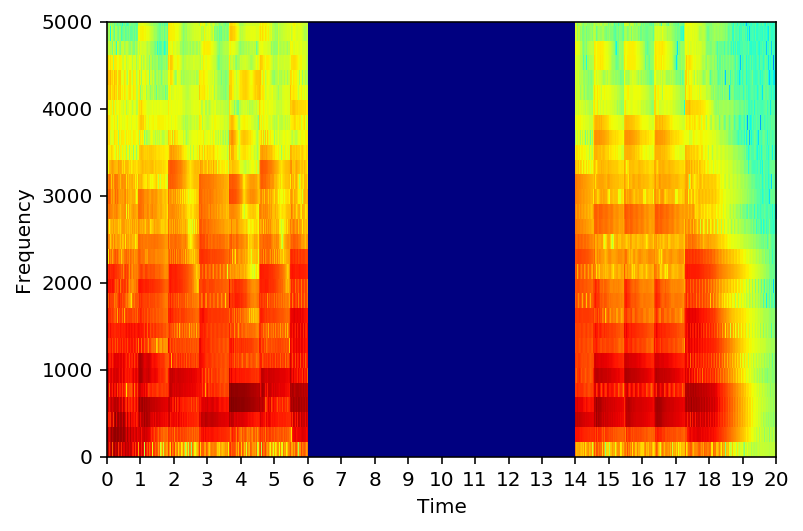

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-12.wav


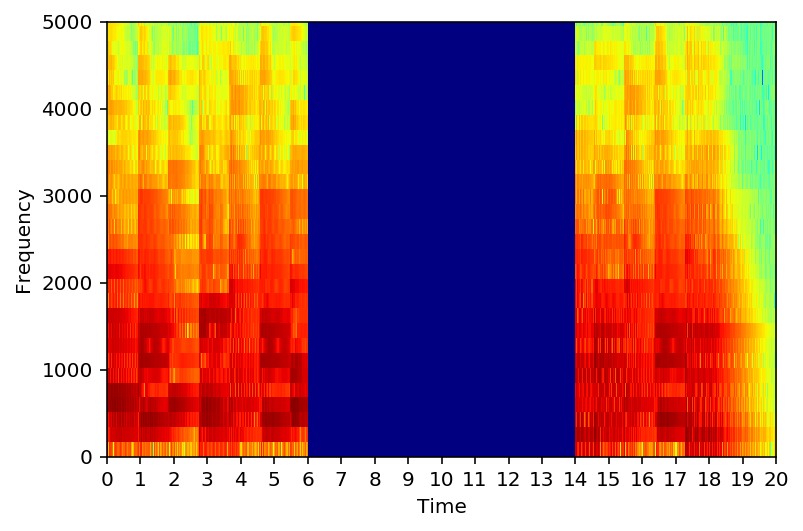

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-13.wav


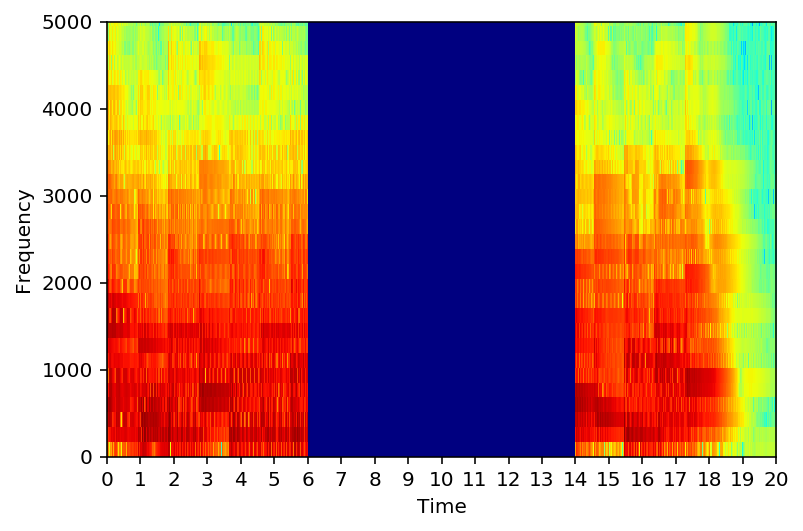

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-14.wav


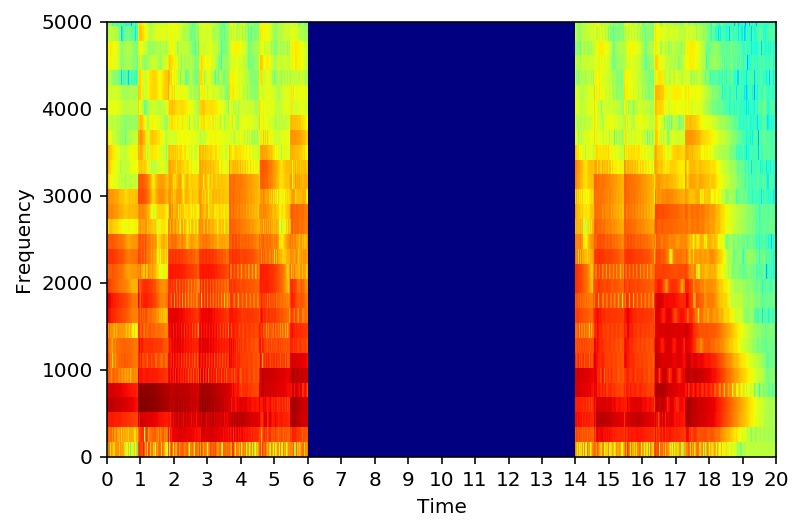

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-15.wav


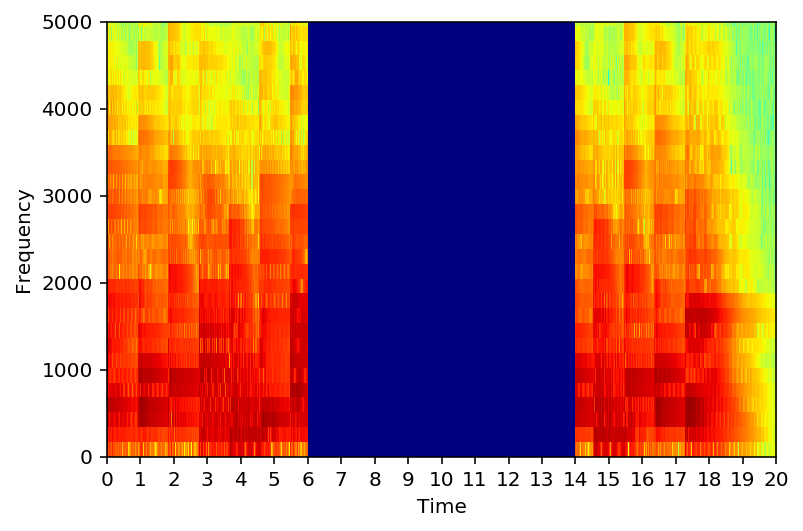

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-16.wav


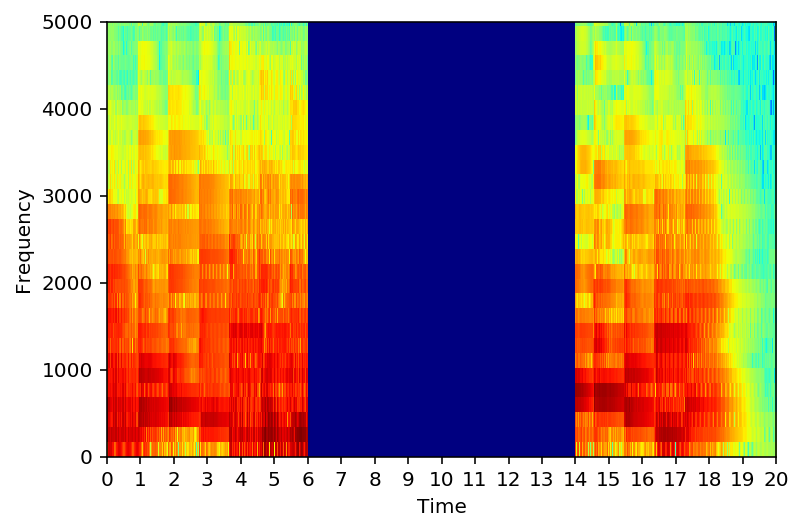

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-17.wav


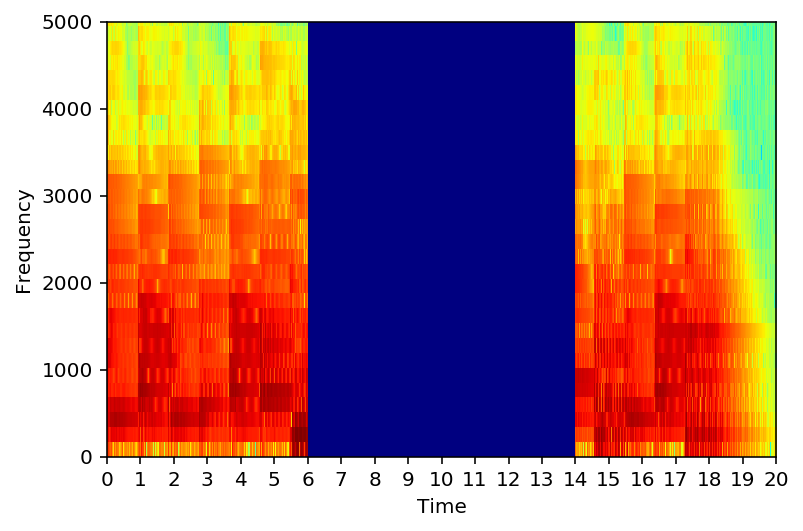

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-18.wav


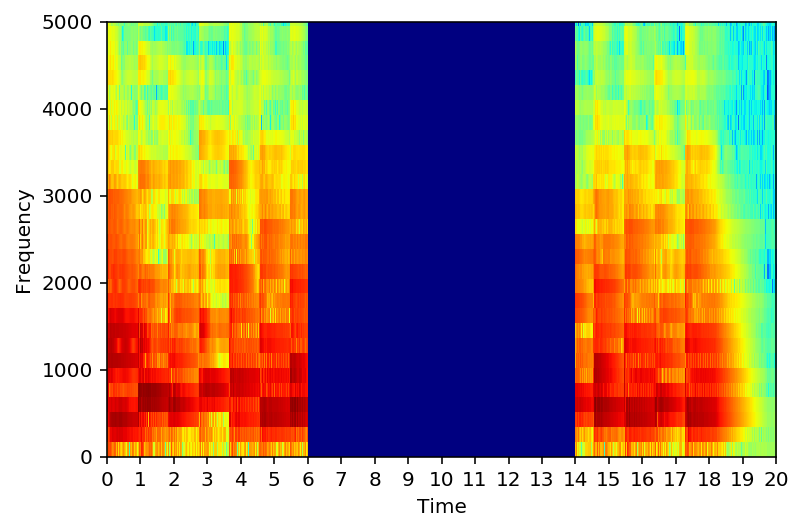

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/orig-19.wav


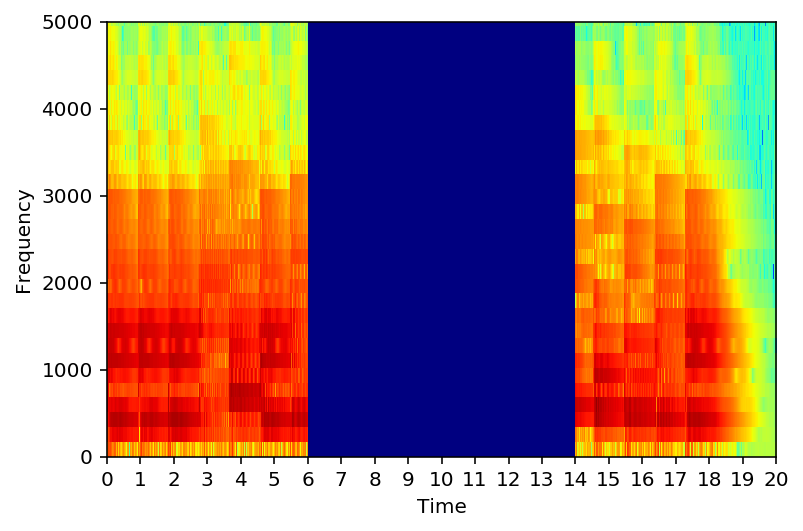

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-1.wav


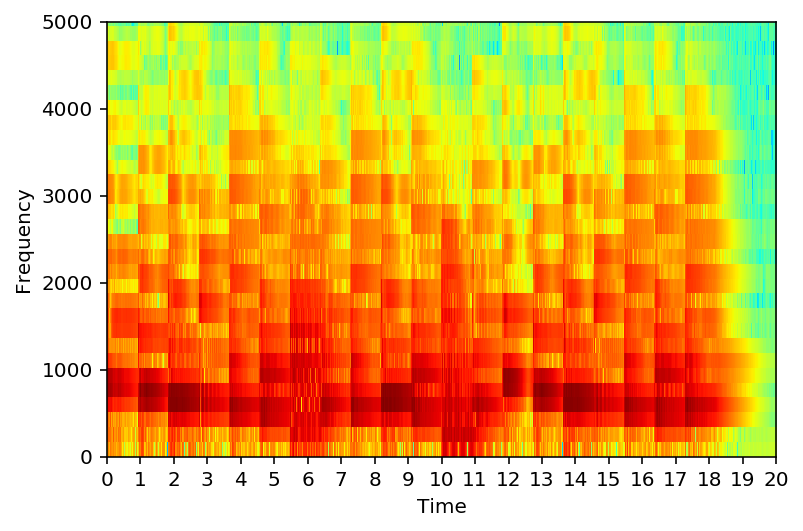

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-2.wav


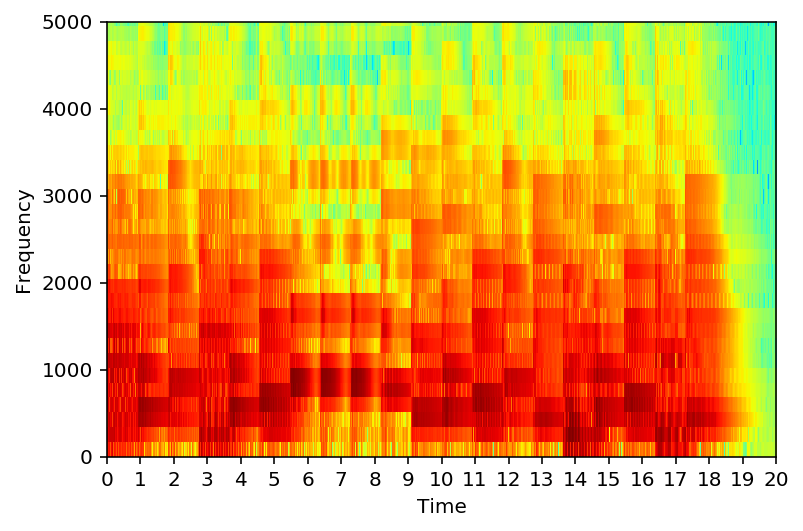

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-3.wav


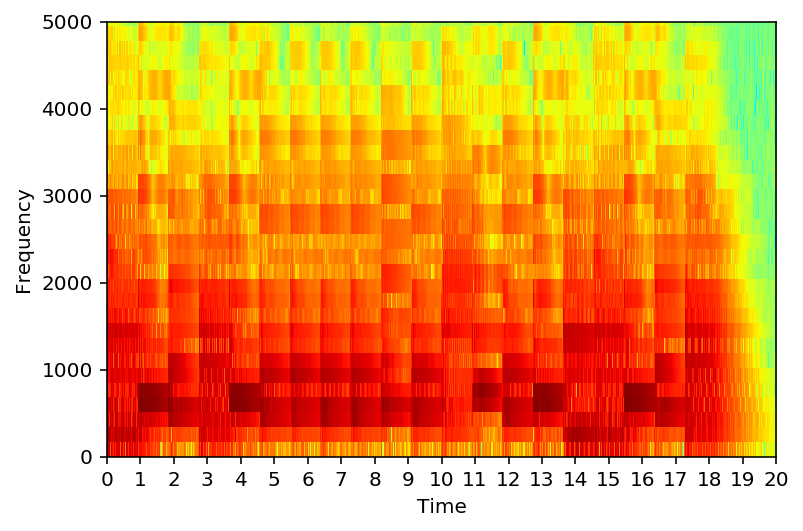

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-4.wav


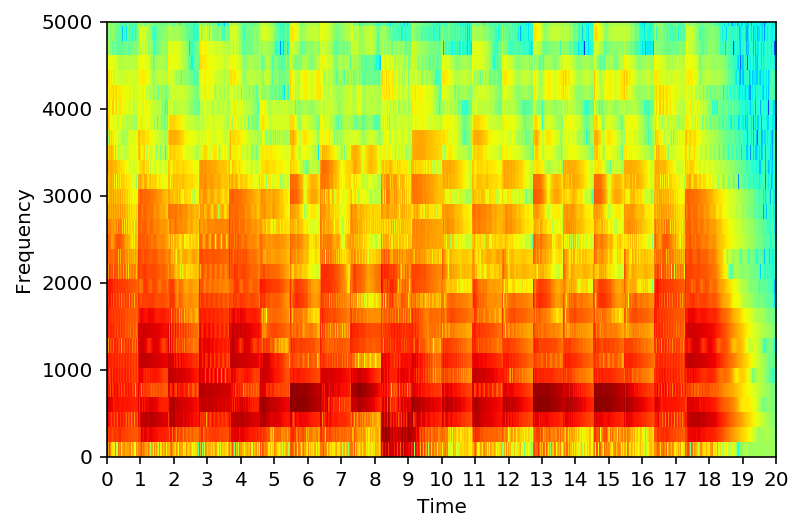

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-5.wav


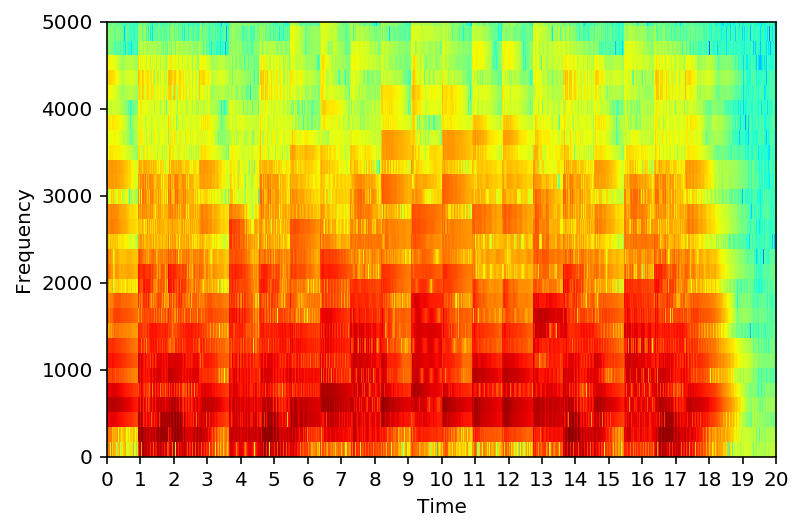

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-6.wav


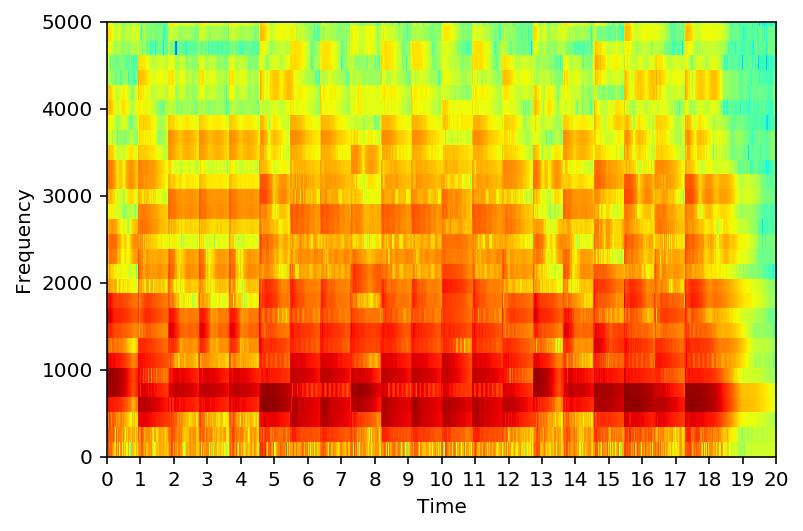

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-7.wav


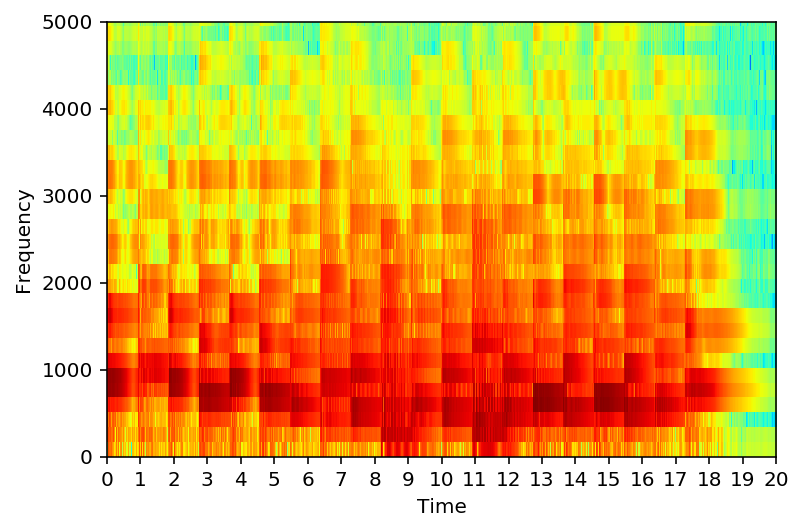

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-8.wav


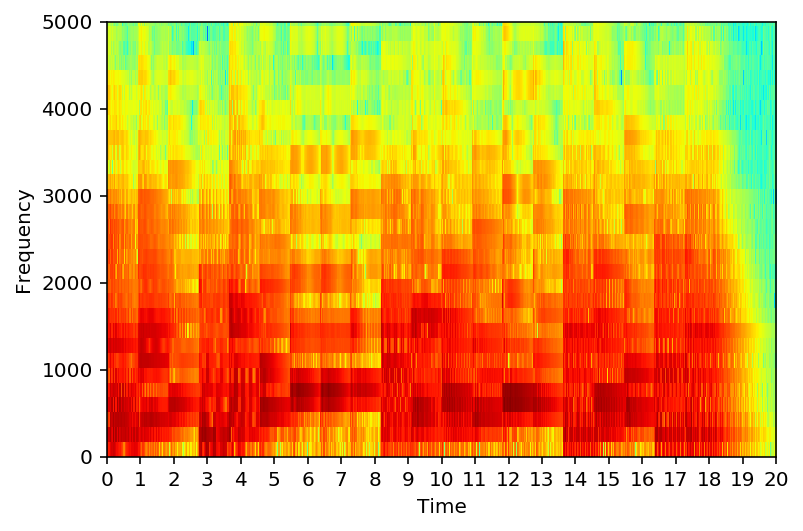

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-9.wav


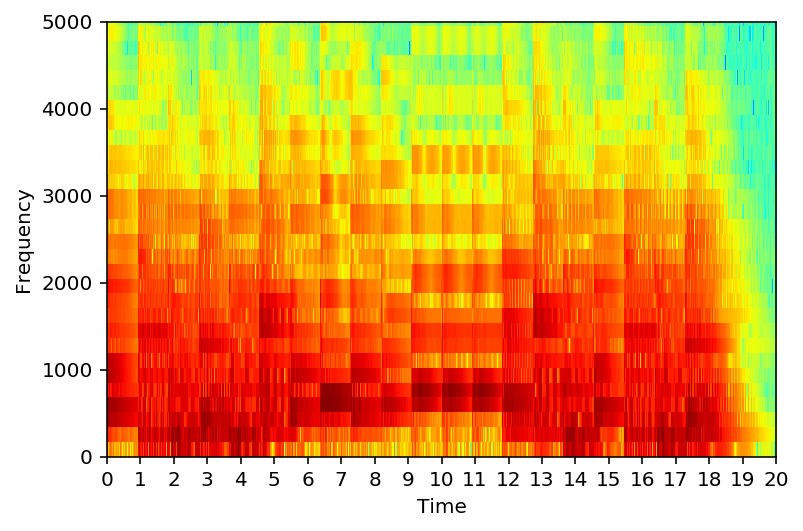

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-10.wav


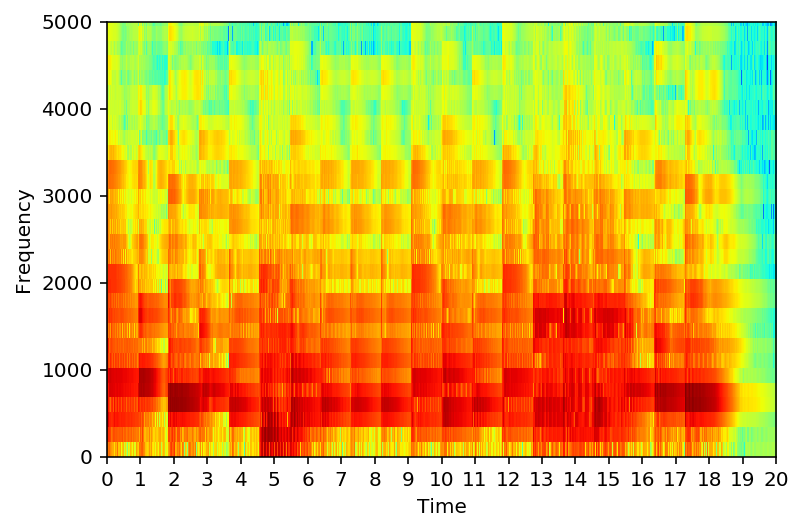

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-11.wav


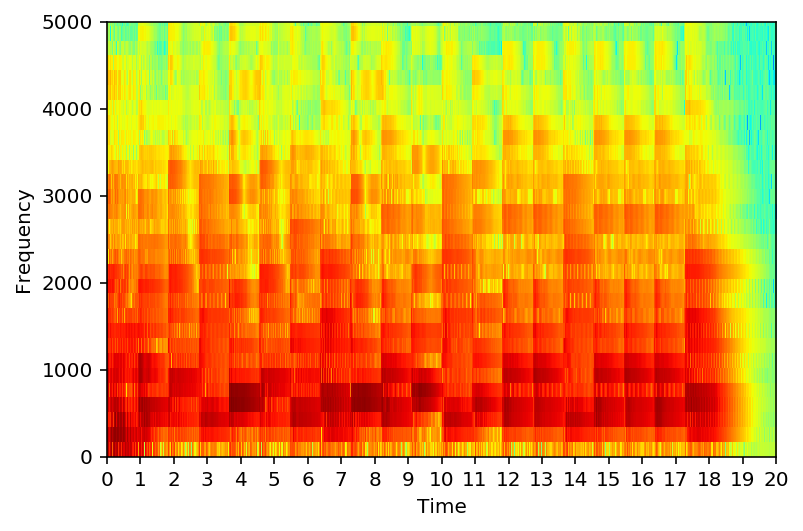

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-12.wav


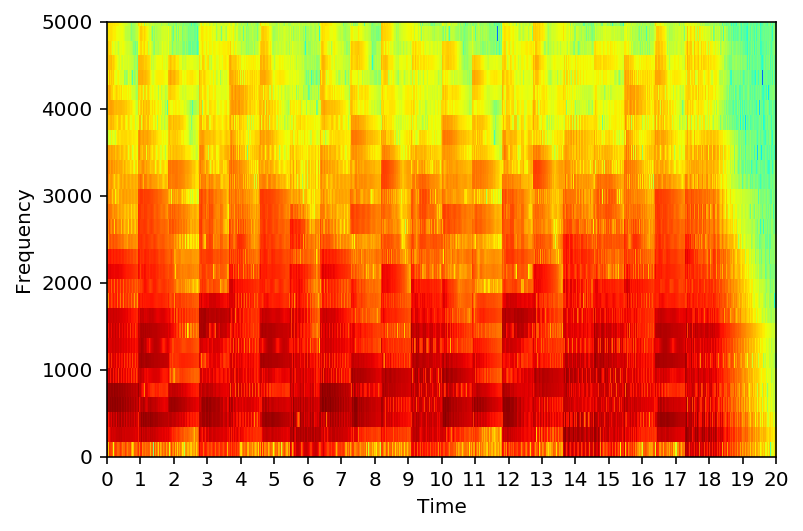

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-13.wav


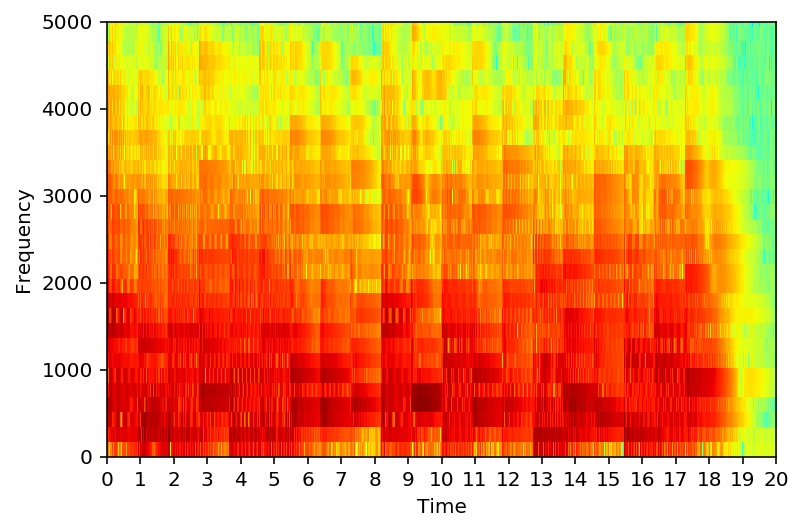

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-14.wav


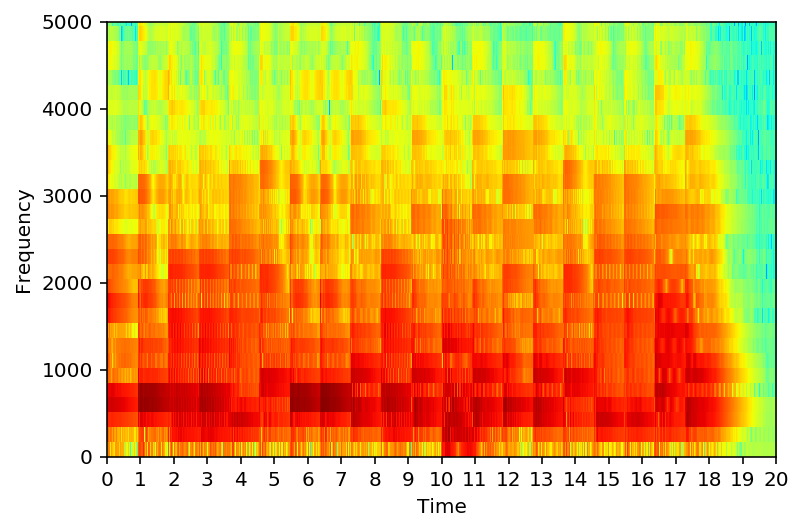

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-15.wav


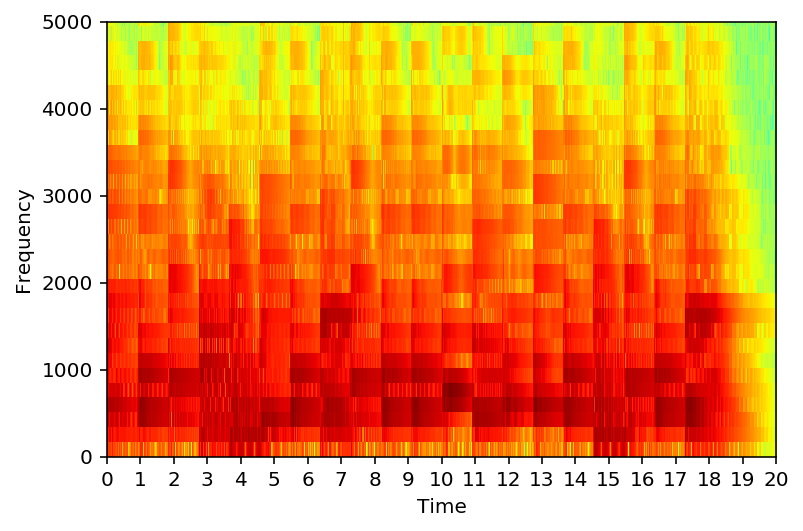

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-16.wav


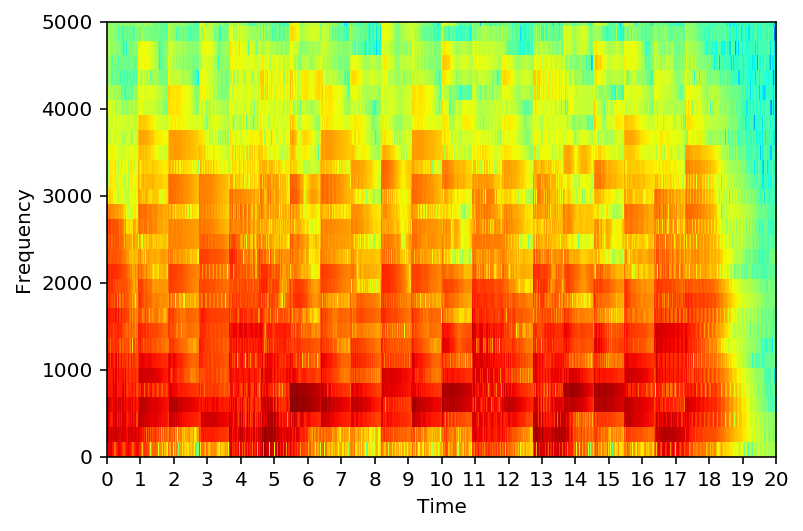

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-17.wav


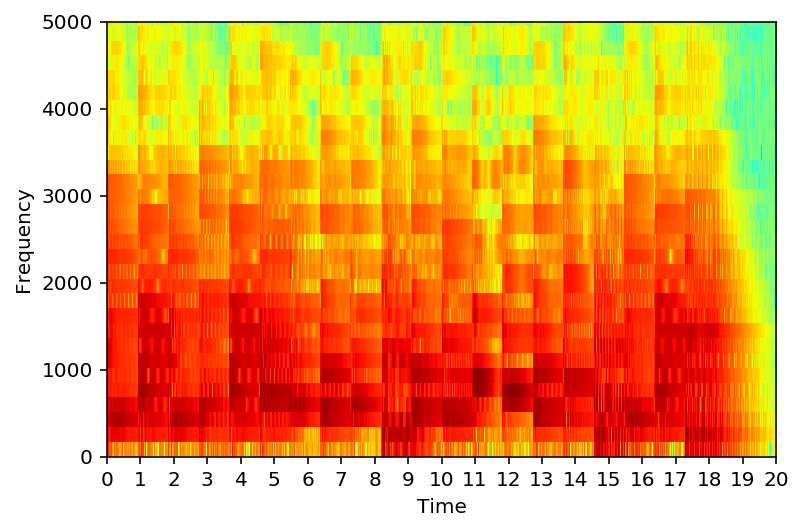

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-18.wav


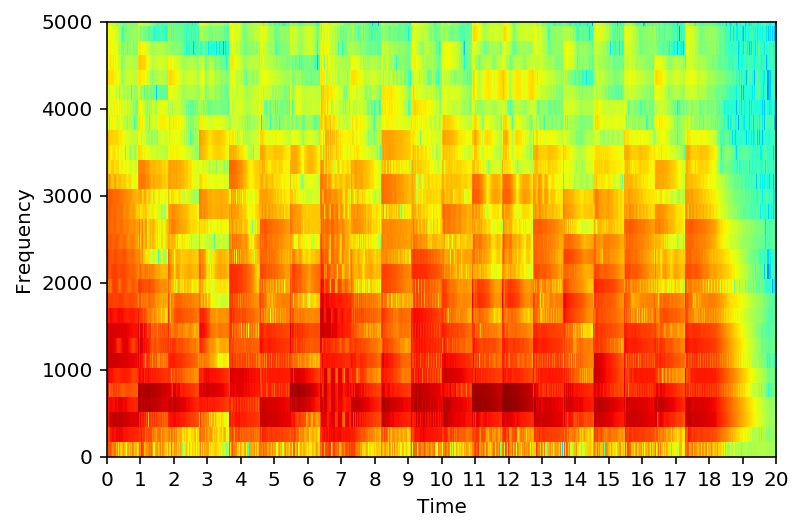

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/handel/filled-19.wav


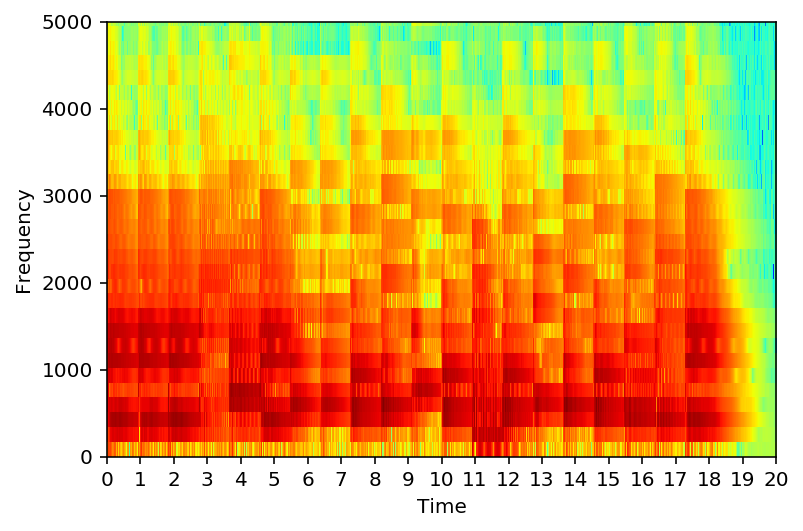

read ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/mono_orig.txt
C6 C6 A5 B5 C6 C5 C5 C5 G4 A4 G4 E5 D5 C5 C5 B4 B4 B4 B4 D5
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-1.wav


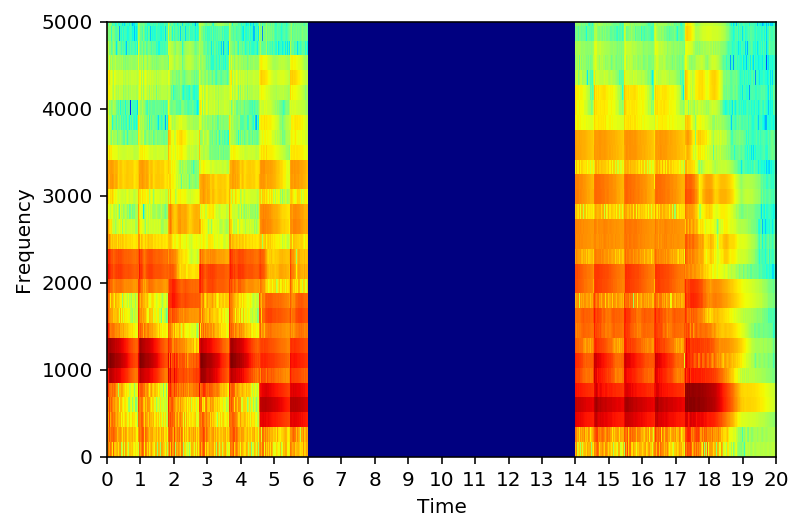

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-2.wav


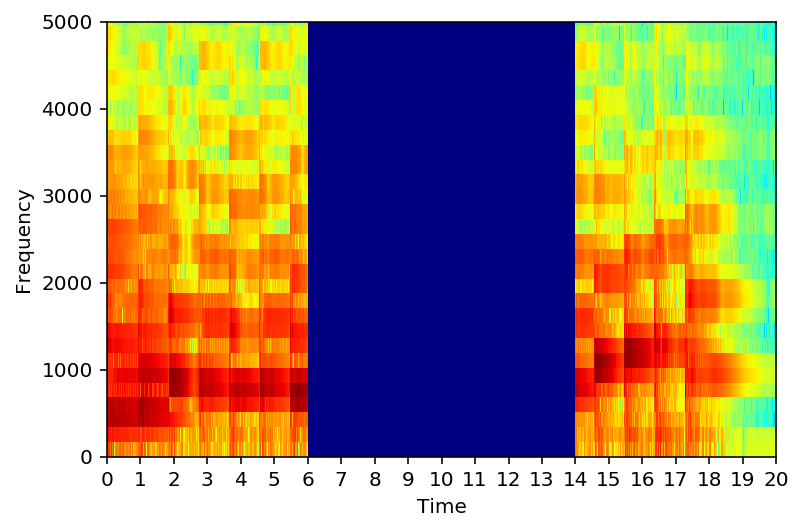

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-3.wav


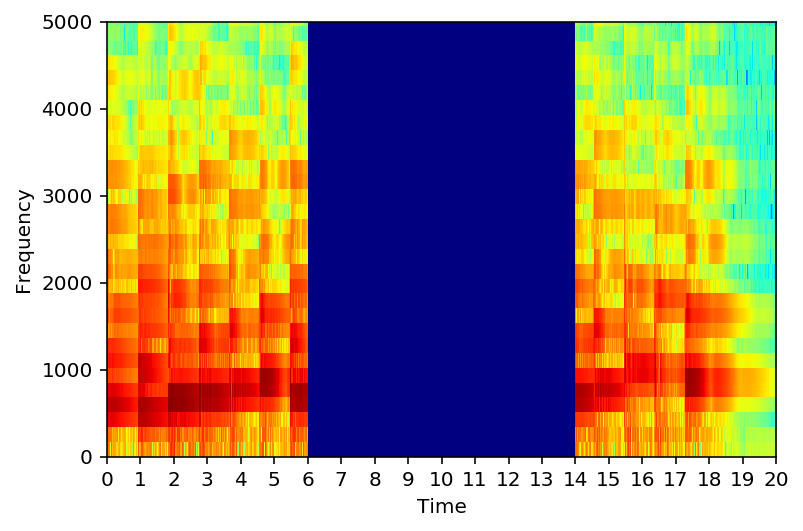

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-4.wav


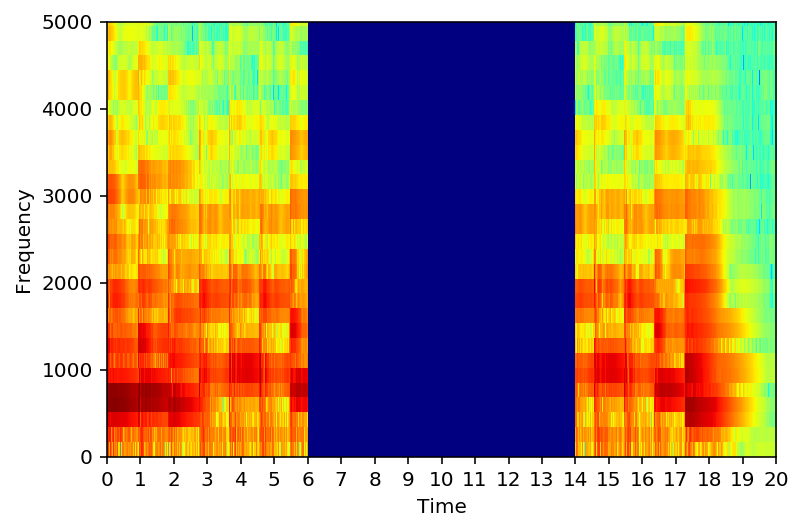

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-5.wav


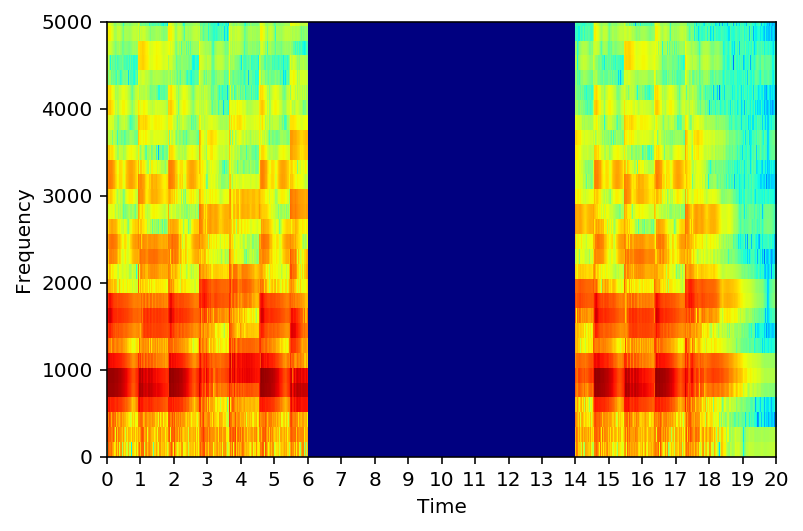

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-6.wav


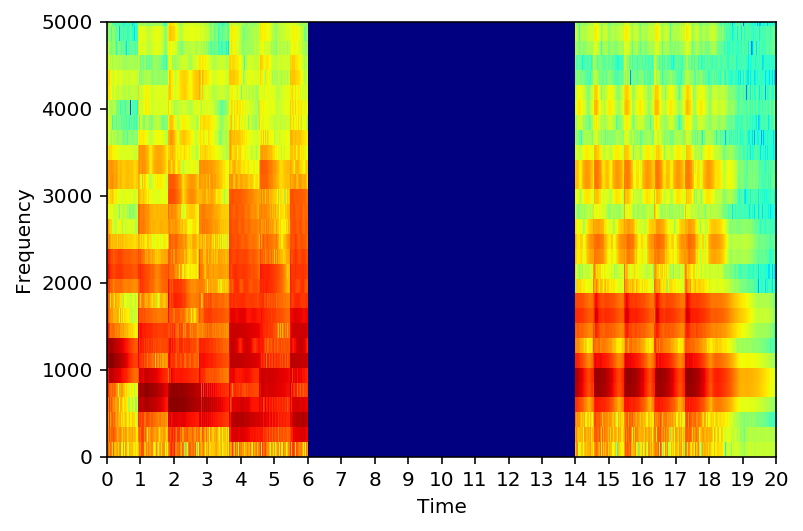

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-7.wav


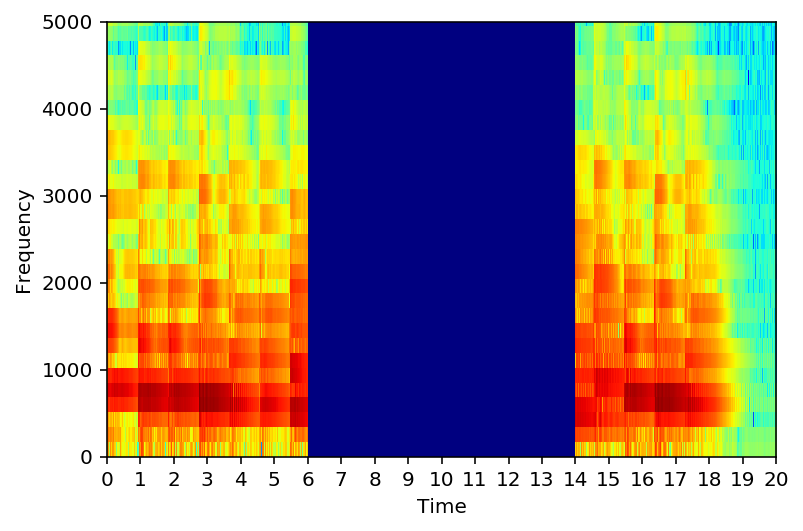

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-8.wav


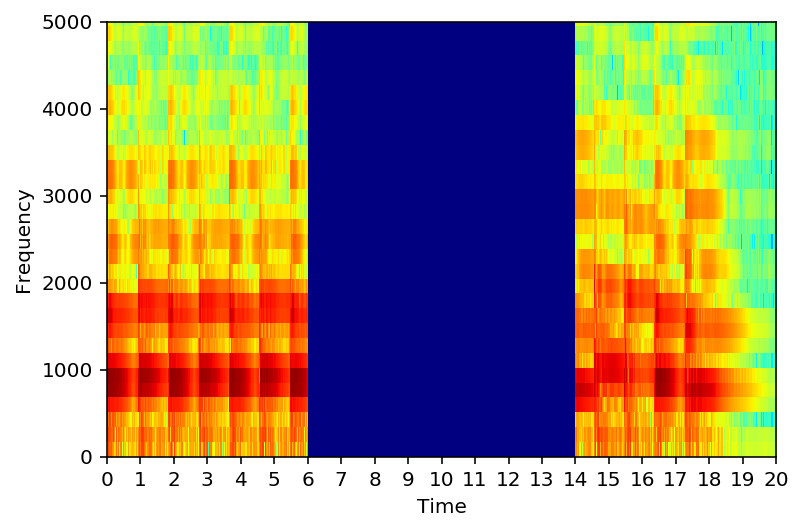

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-9.wav


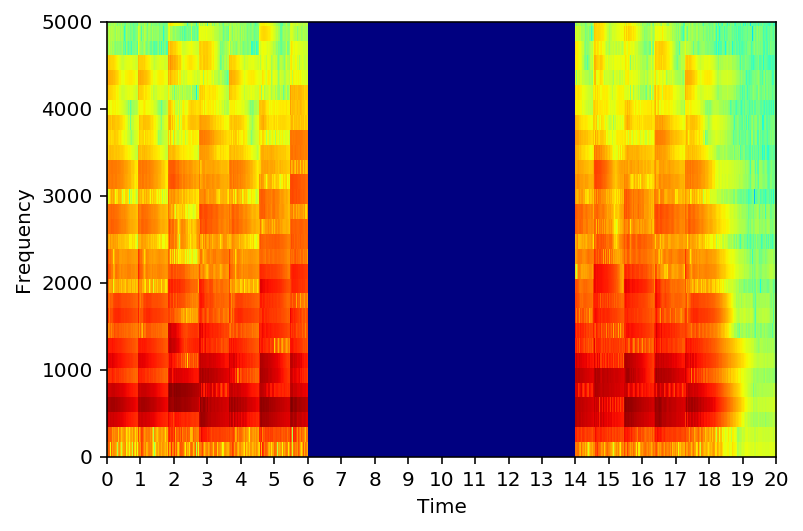

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-10.wav


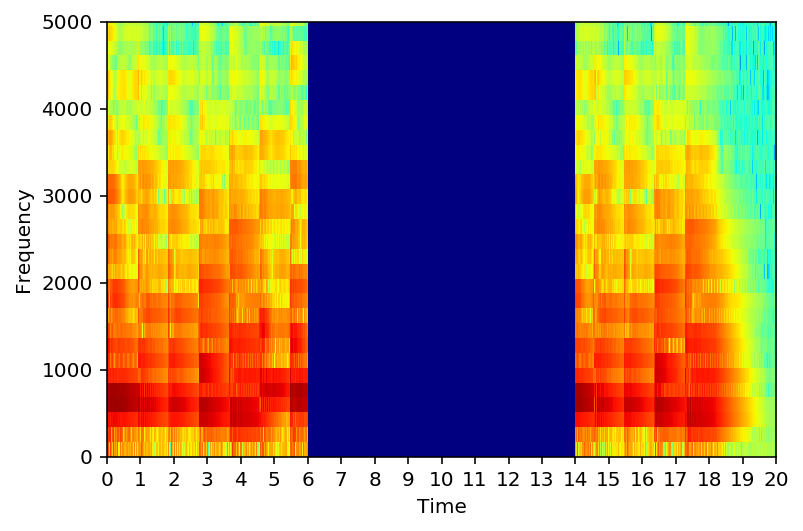

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-11.wav


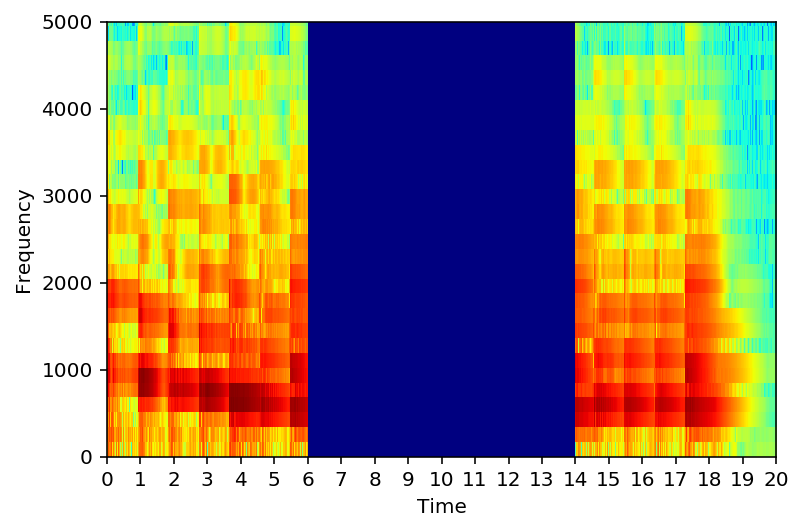

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-12.wav


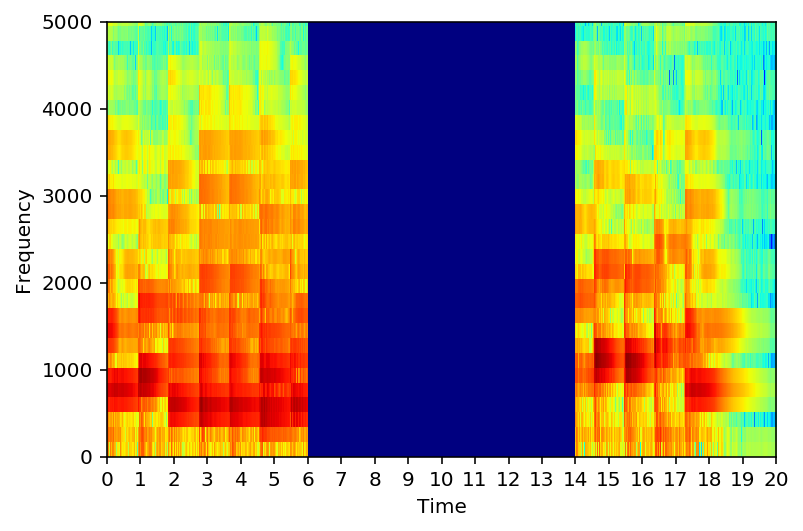

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-13.wav


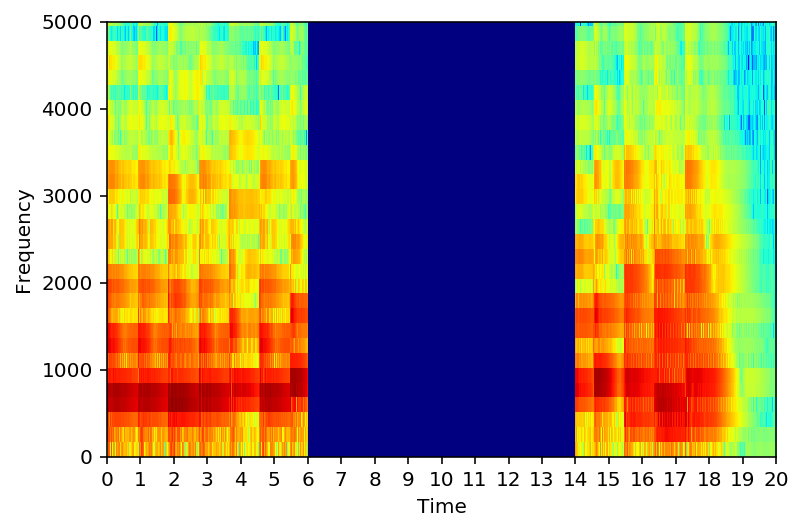

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-14.wav


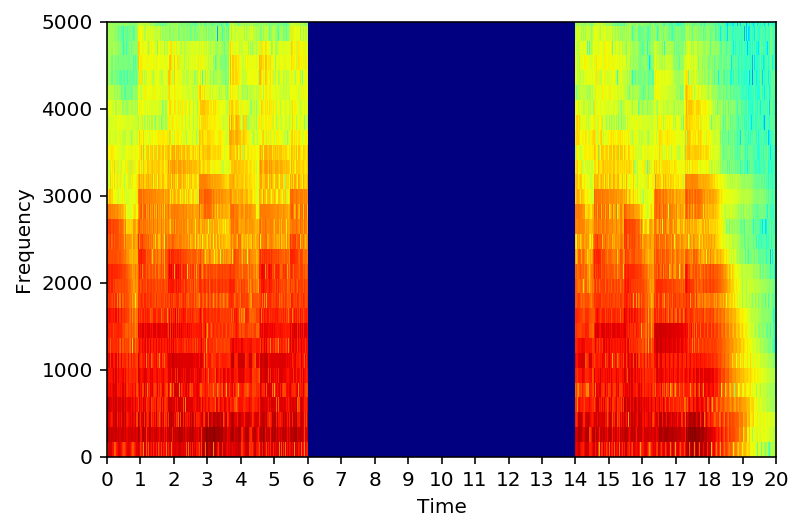

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-15.wav


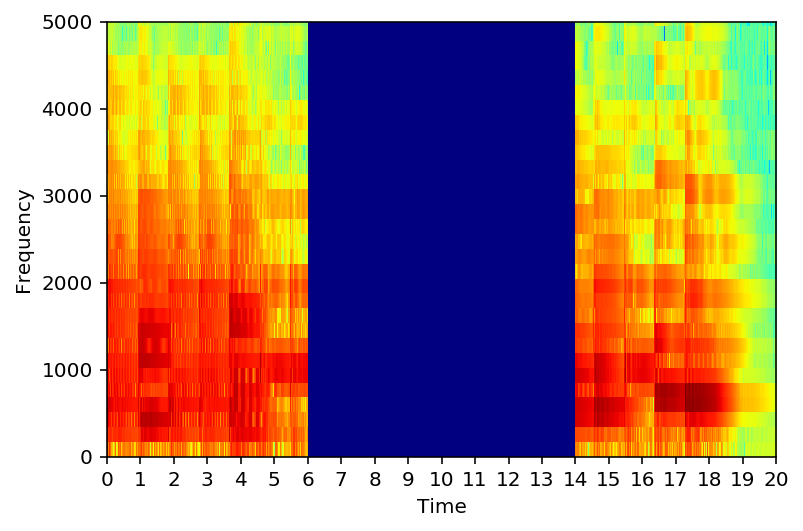

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-16.wav


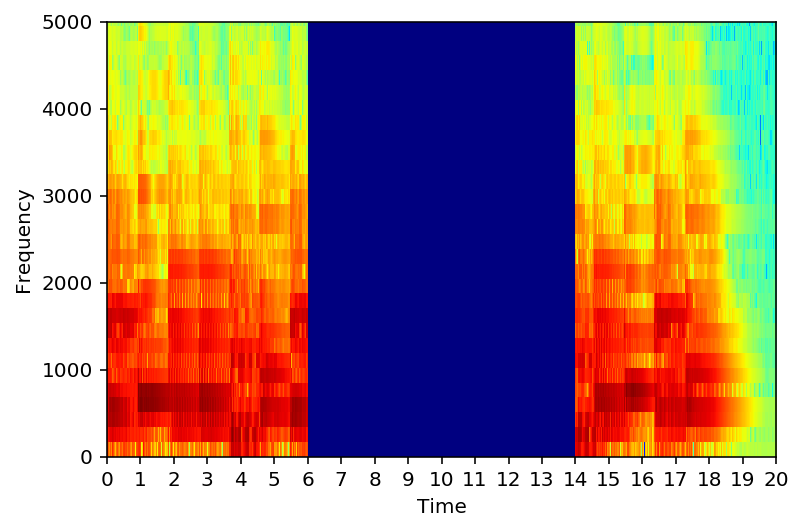

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-17.wav


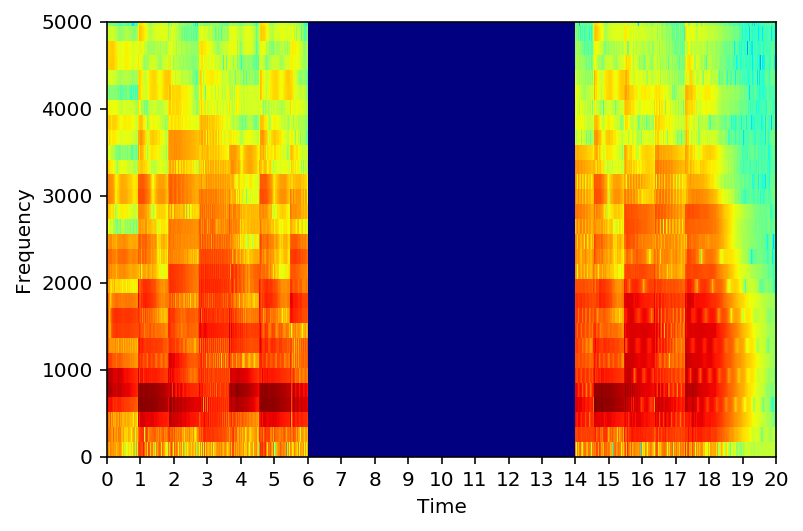

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-18.wav


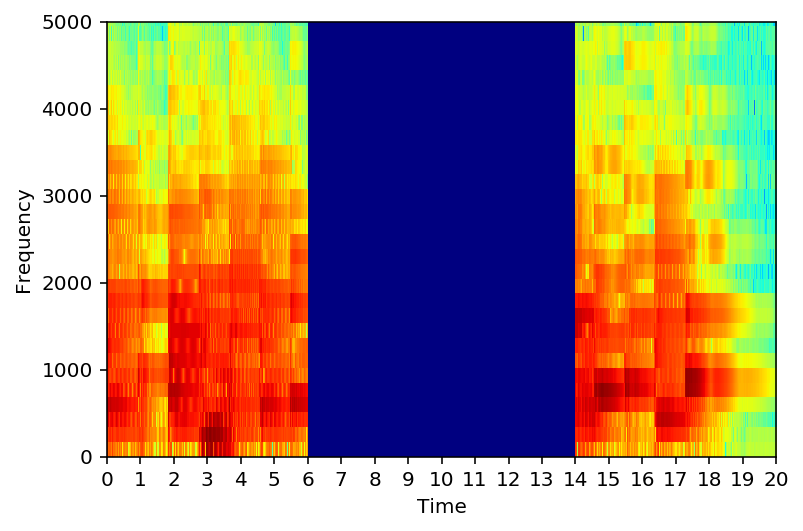

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/orig-19.wav


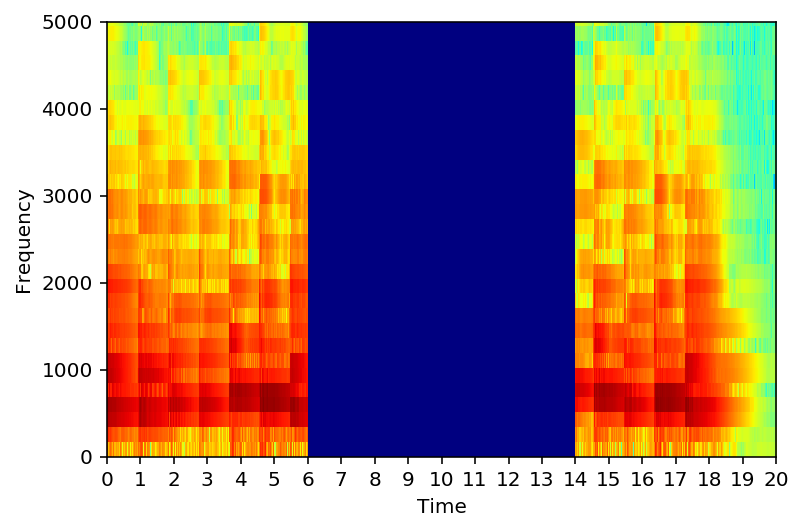

read ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-1.wav


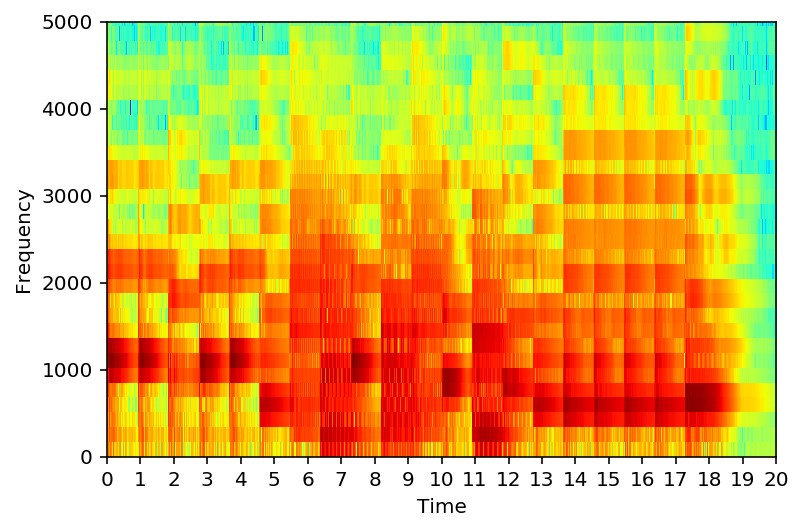

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-2.wav


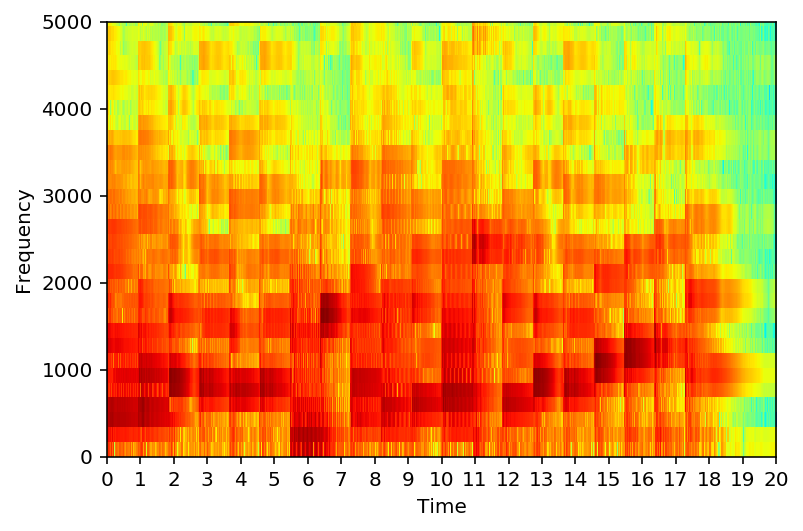

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-3.wav


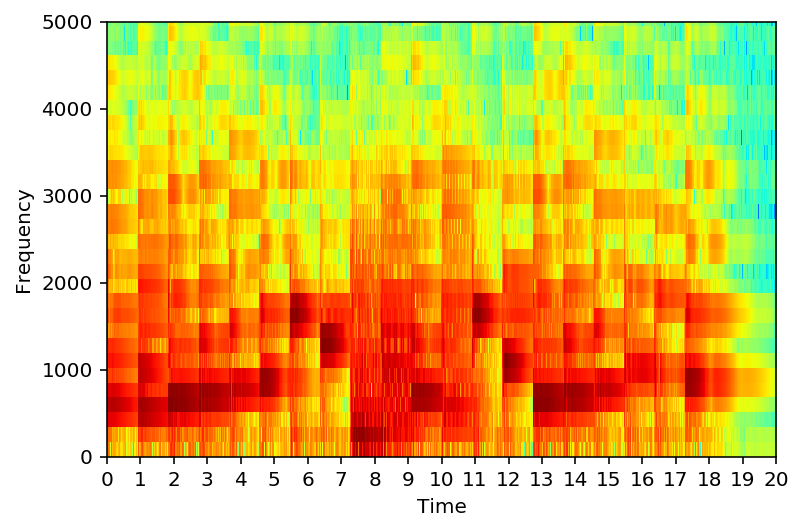

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-4.wav


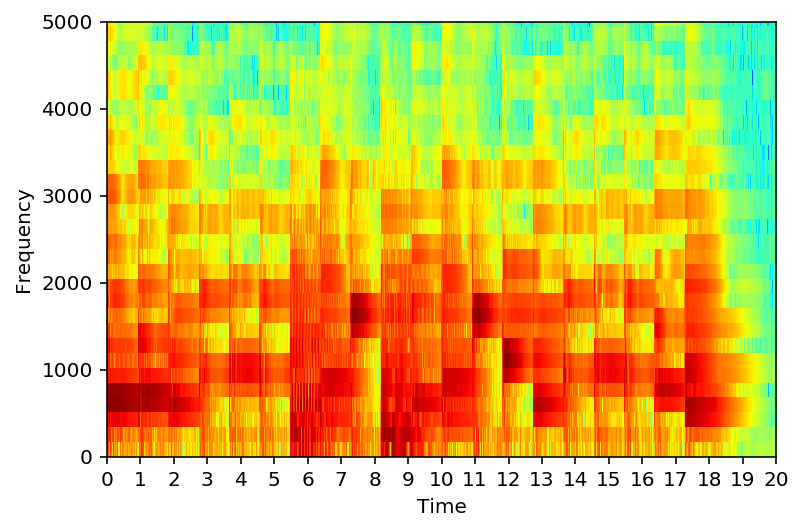

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-5.wav


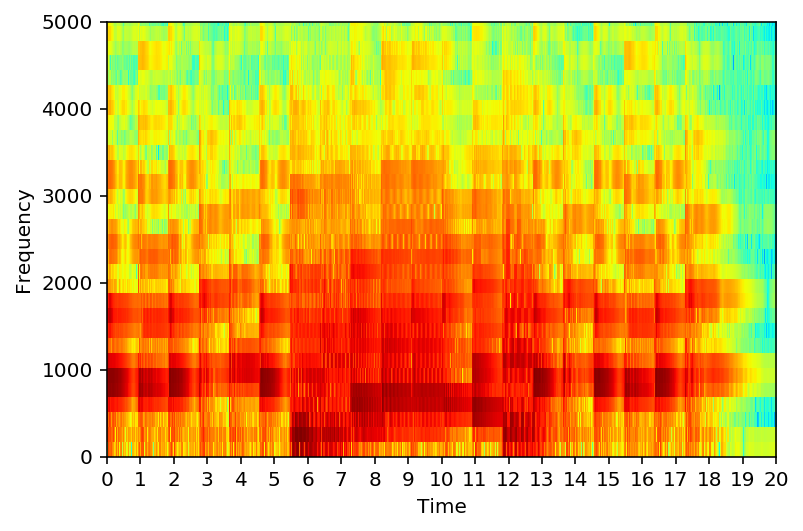

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-6.wav


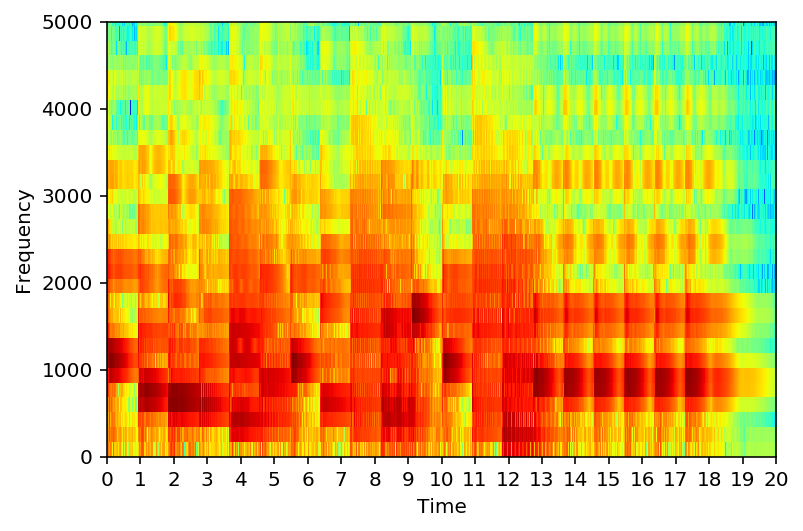

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-7.wav


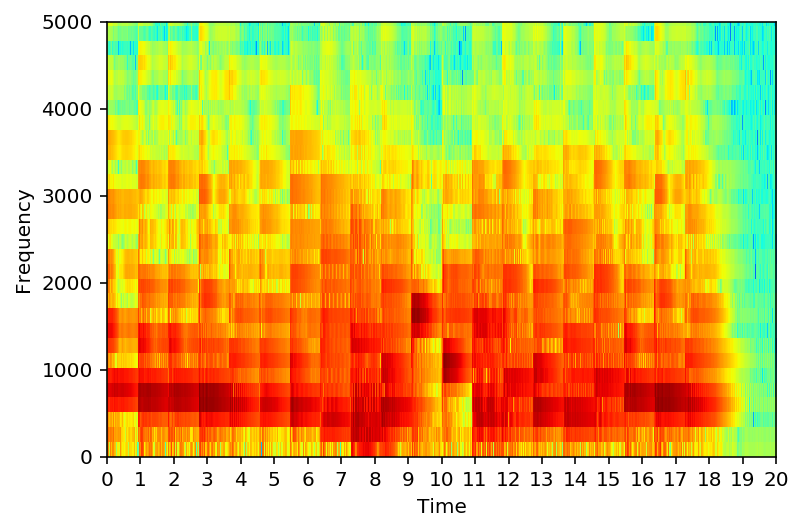

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-8.wav


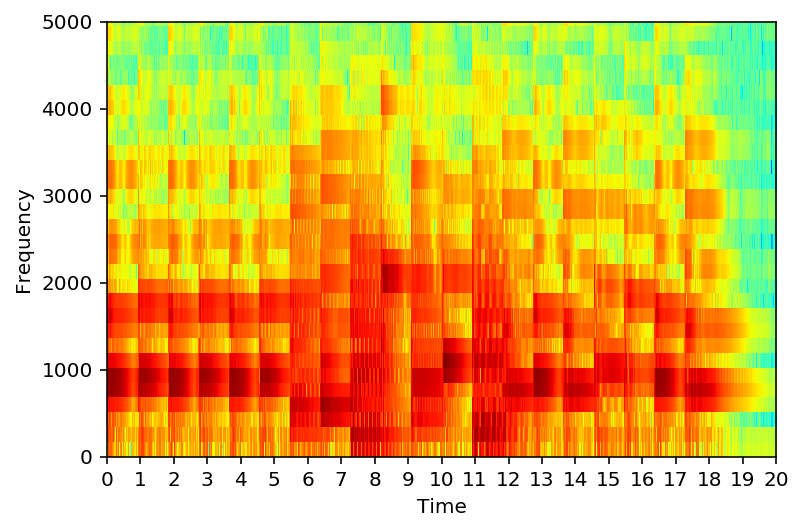

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-9.wav


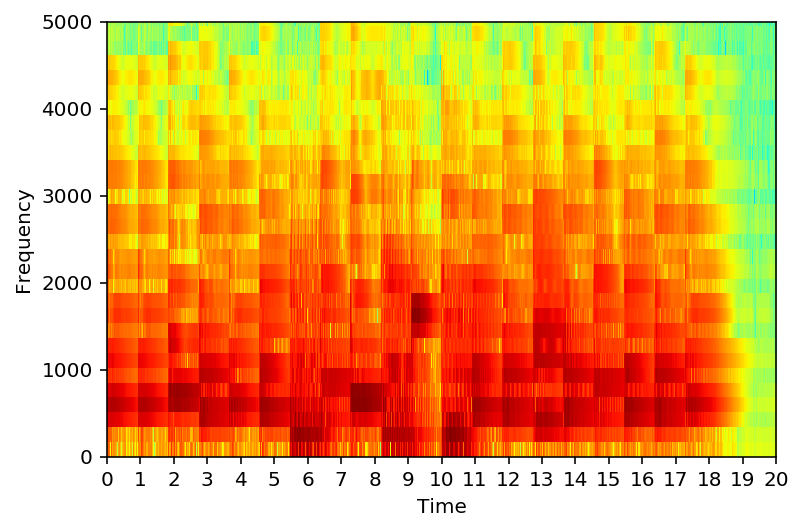

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-10.wav


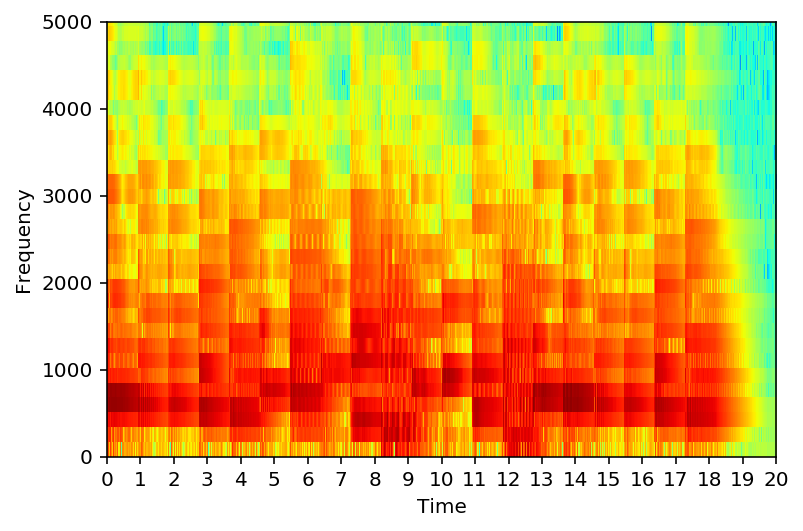

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-11.wav


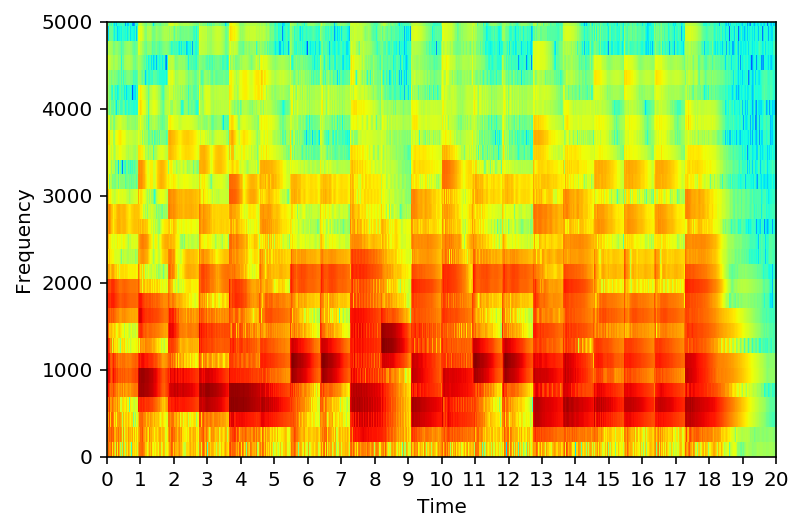

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-12.wav


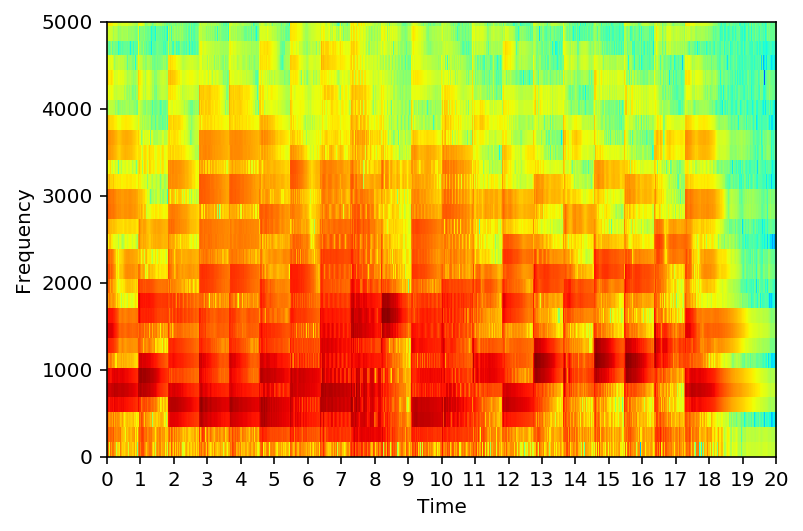

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-13.wav


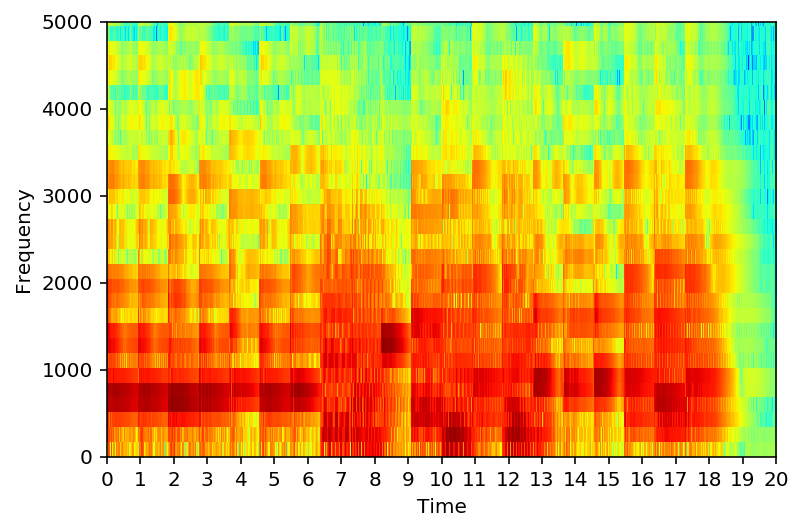

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-14.wav


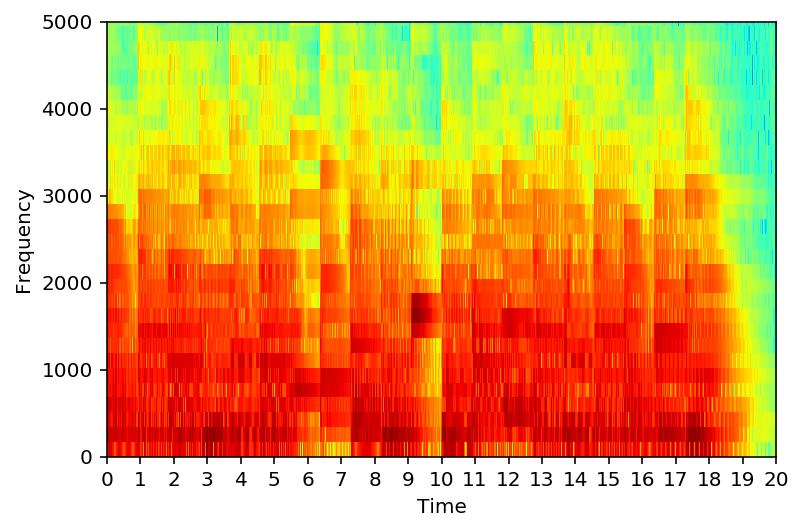

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-15.wav


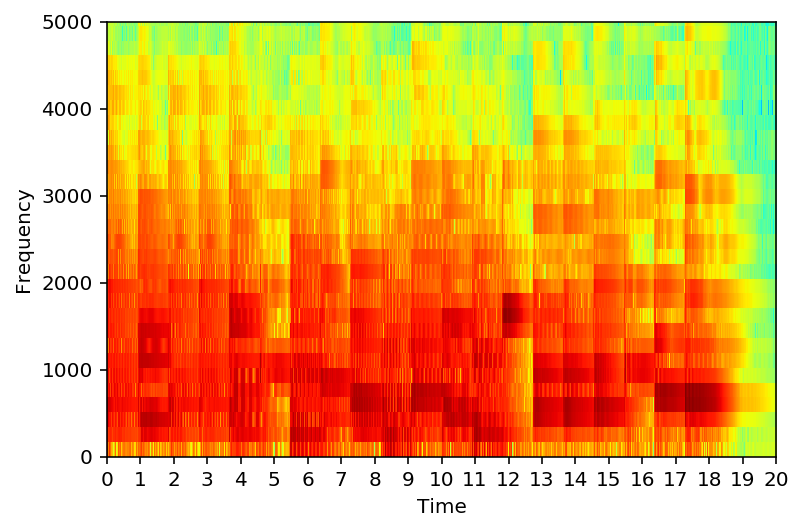

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-16.wav


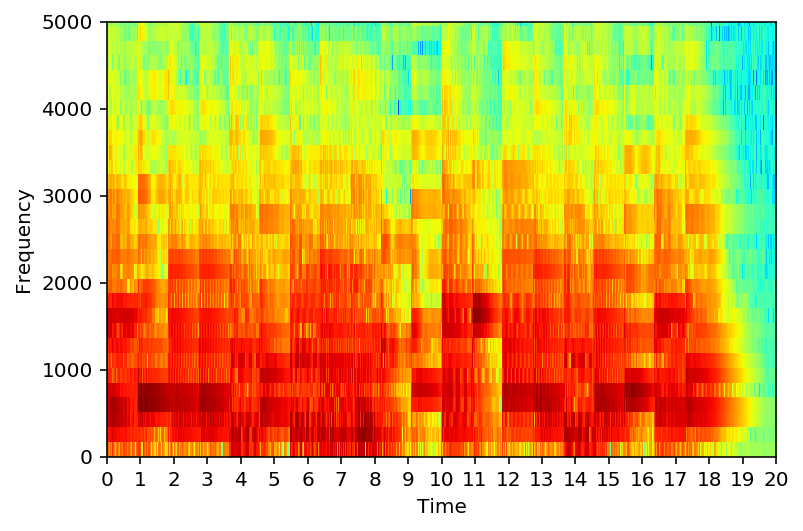

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-17.wav


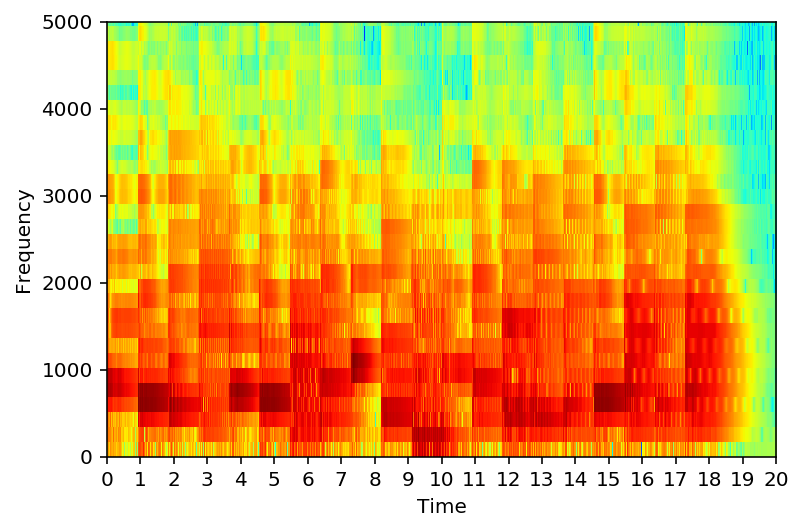

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-18.wav


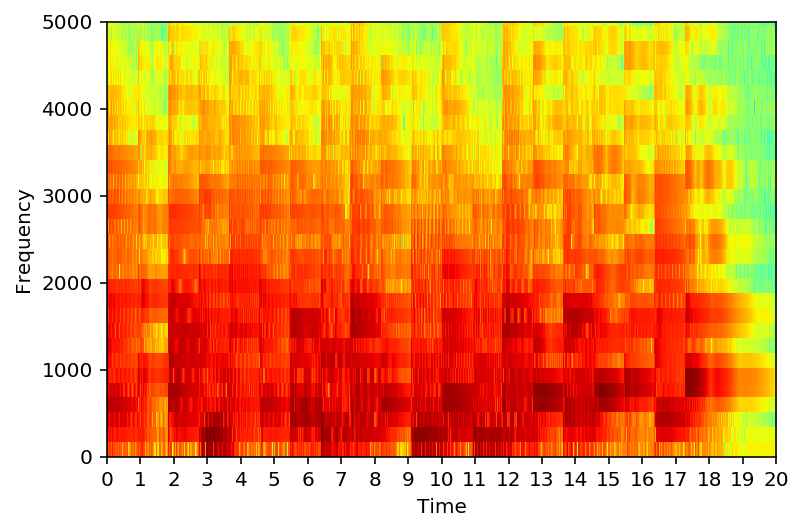

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/mozart/filled-19.wav


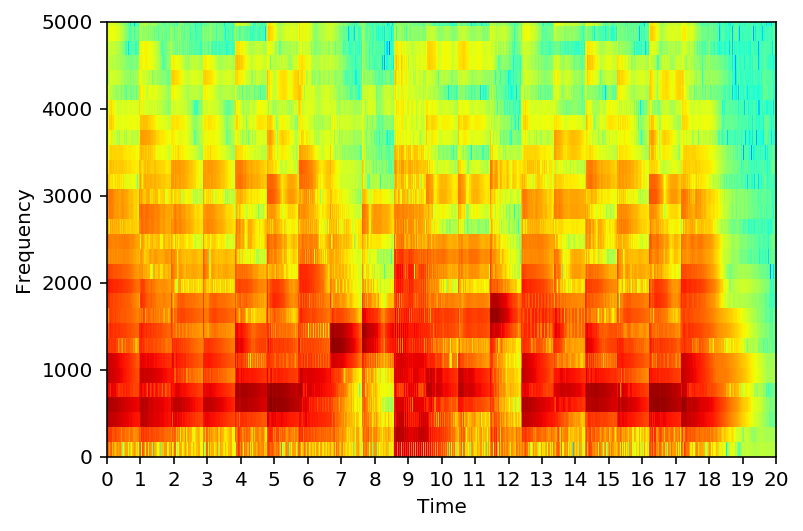

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/mono_orig.txt
C5 B4 C5 B4 C5 B4 C5 B4 C5 A4 G4 F#4 G4 D4 A4 G4 A4 D4 B-4 G4
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-1.wav


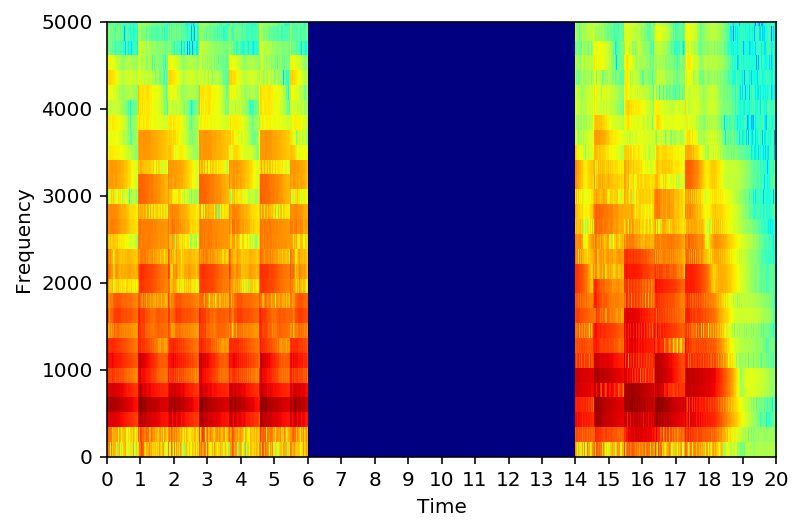

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-2.wav


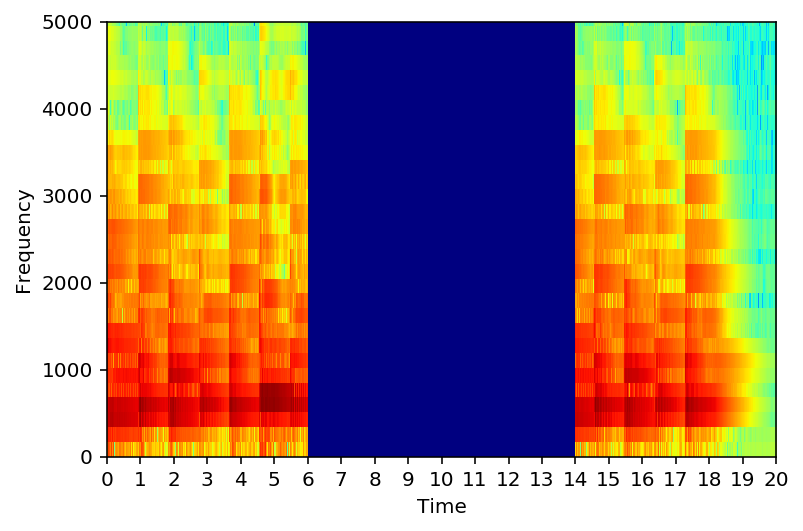

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-3.wav


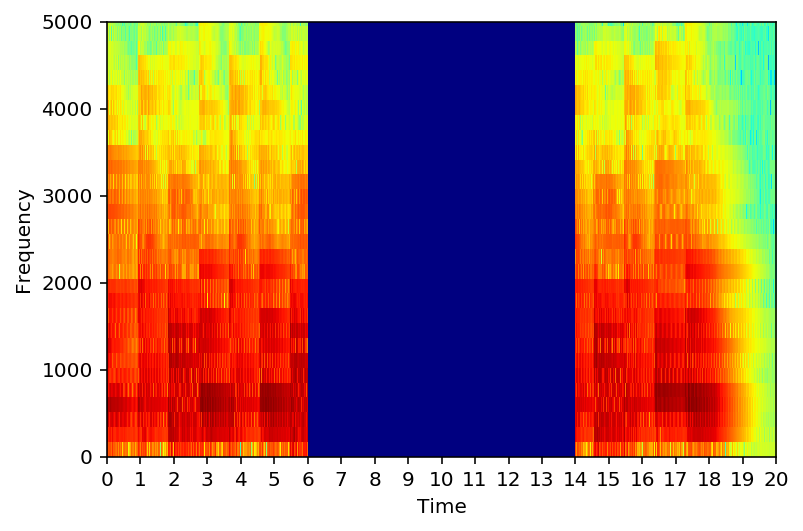

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-4.wav


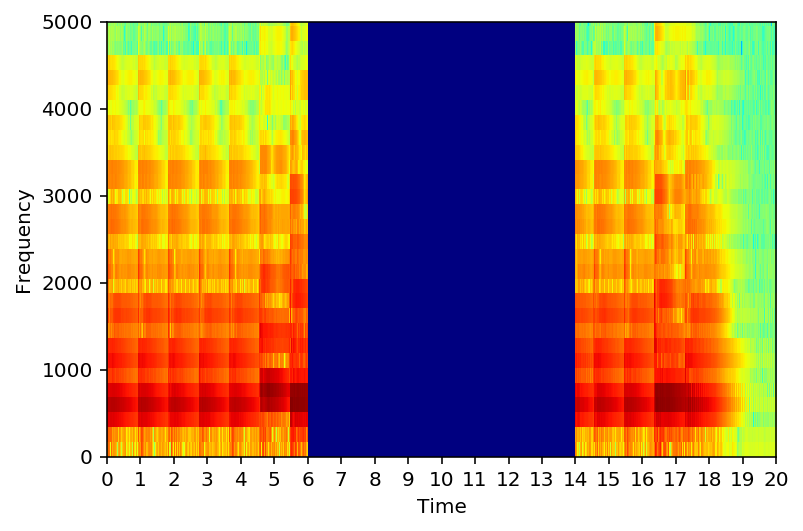

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-5.wav


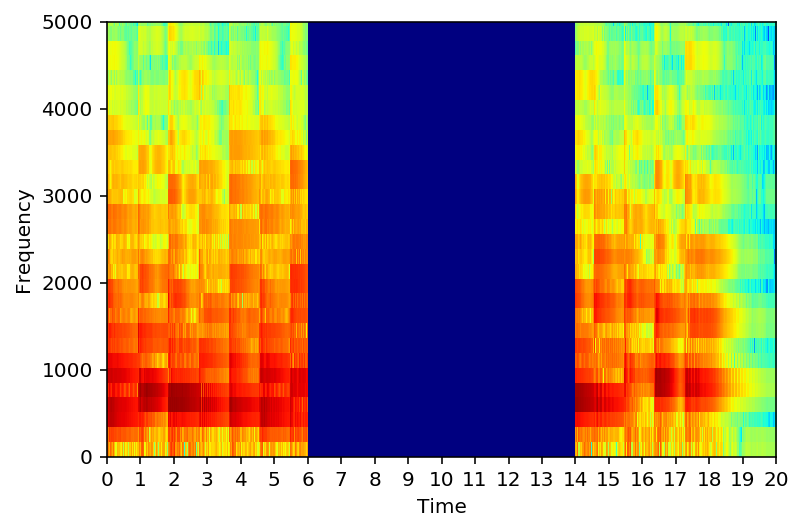

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-6.wav


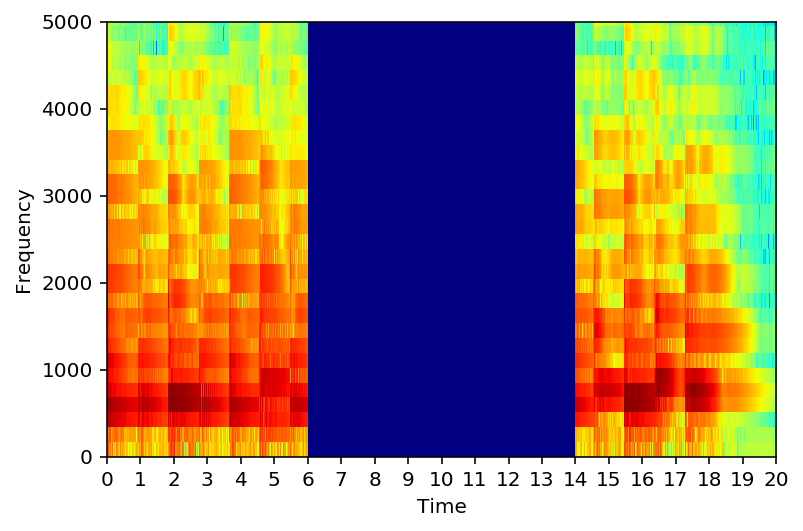

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-7.wav


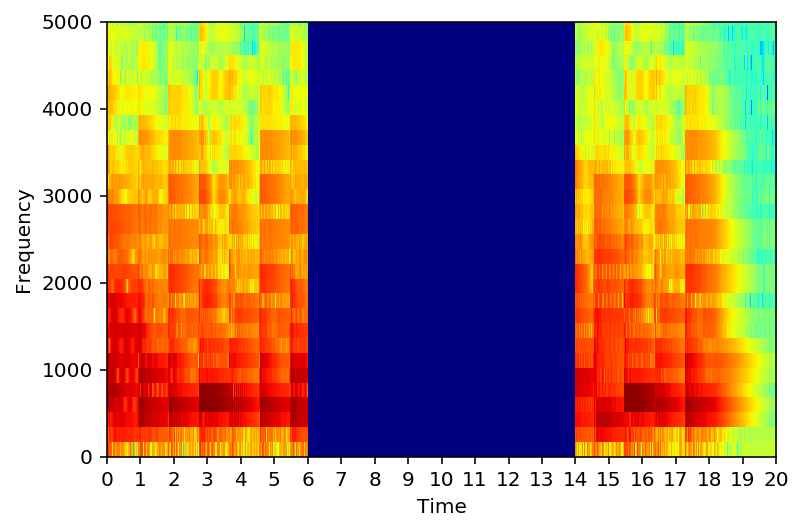

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-8.wav


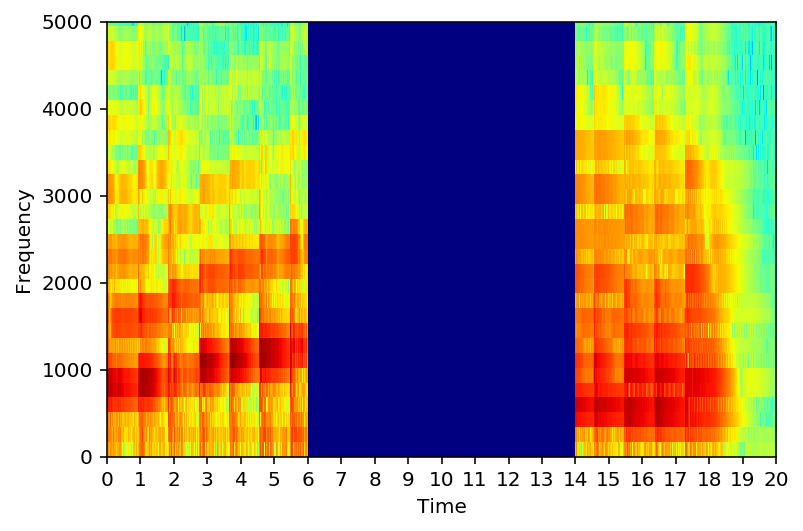

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-9.wav


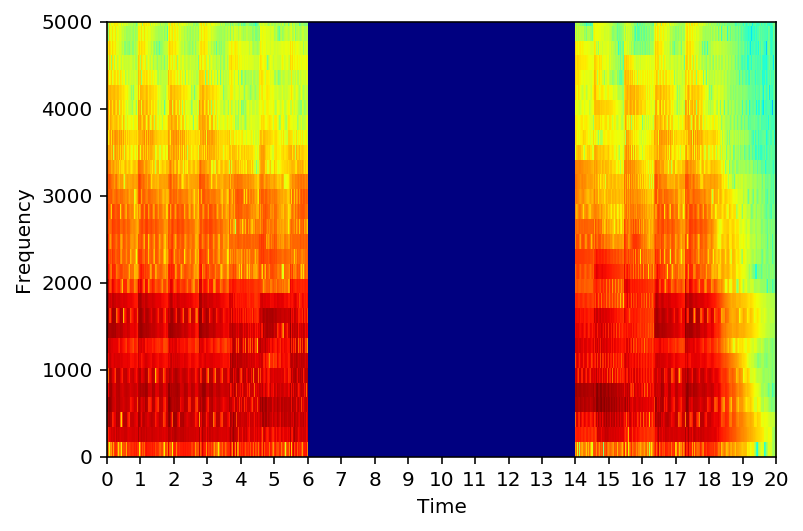

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-10.wav


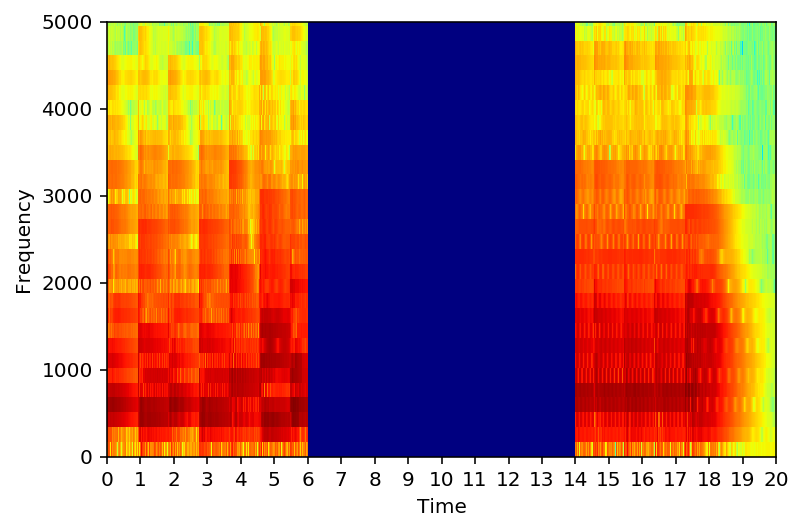

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-11.wav


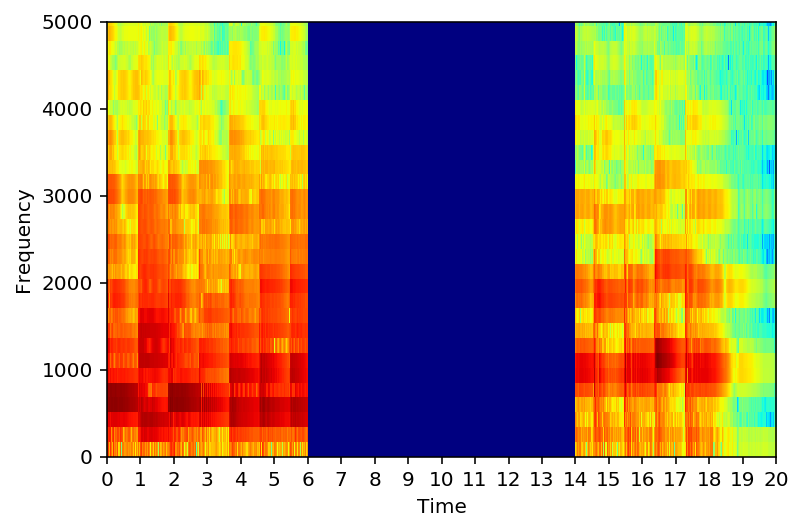

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-12.wav


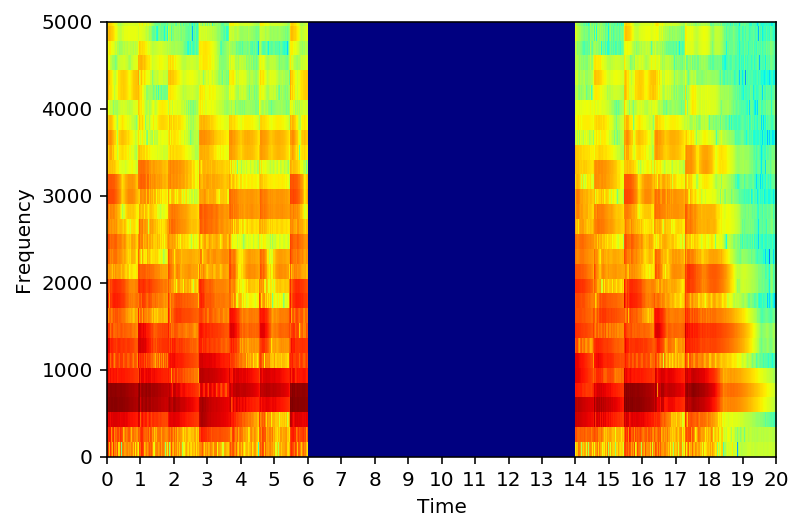

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-13.wav


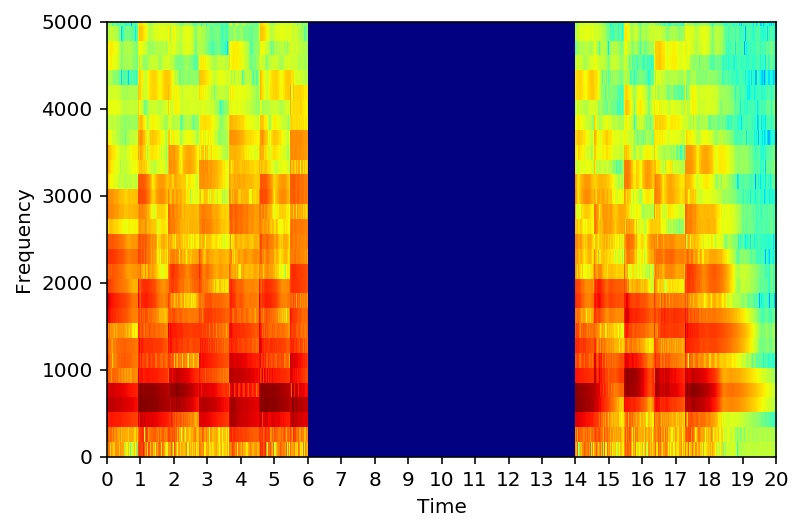

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-14.wav


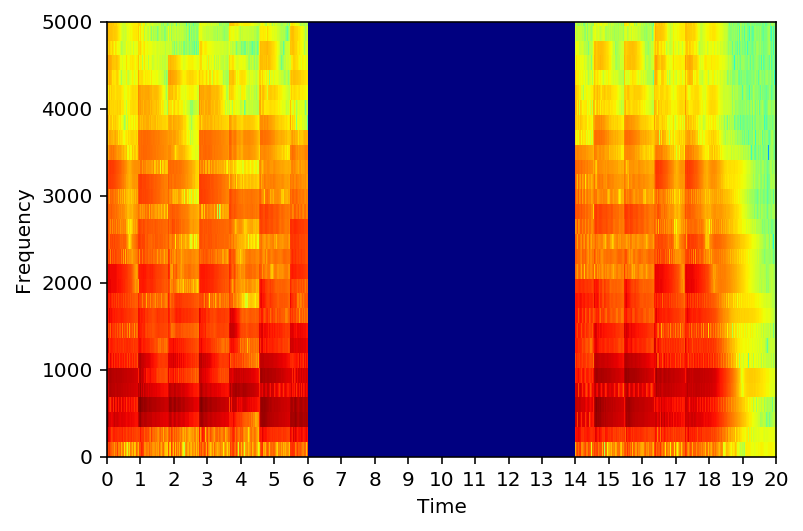

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-15.wav


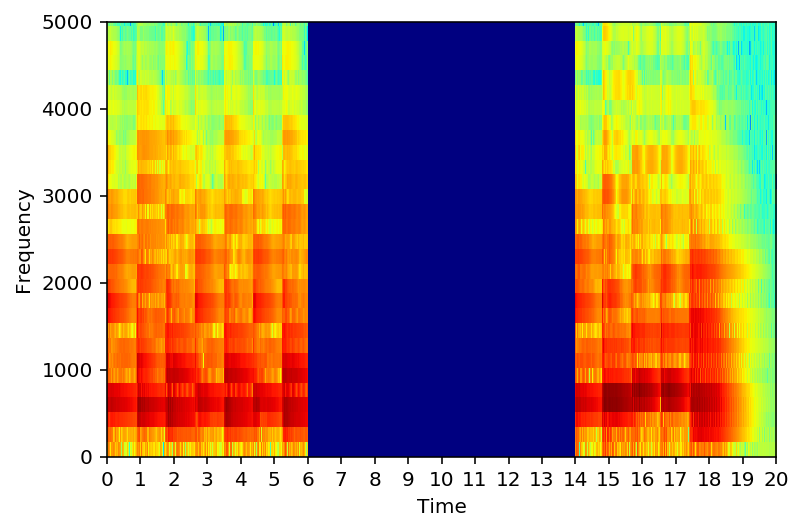

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-16.wav


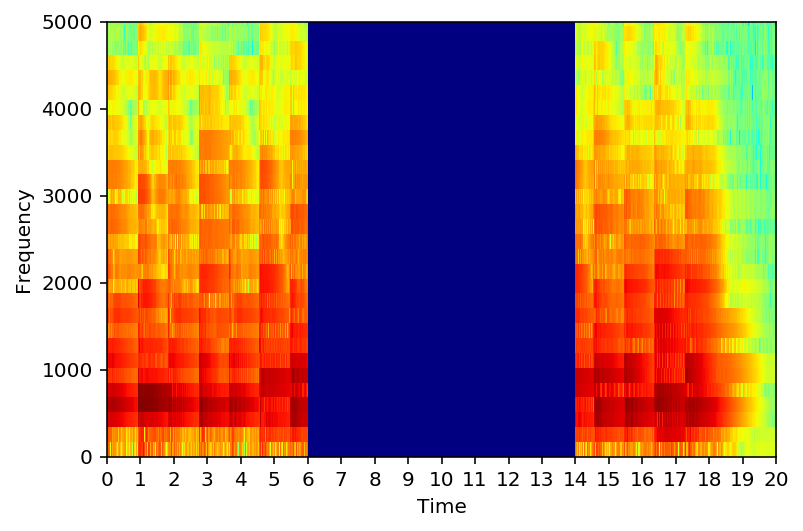

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-17.wav


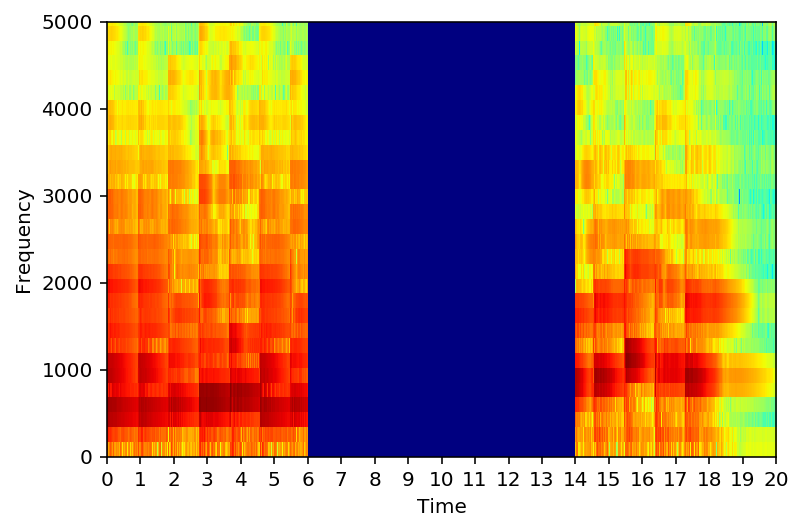

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-18.wav


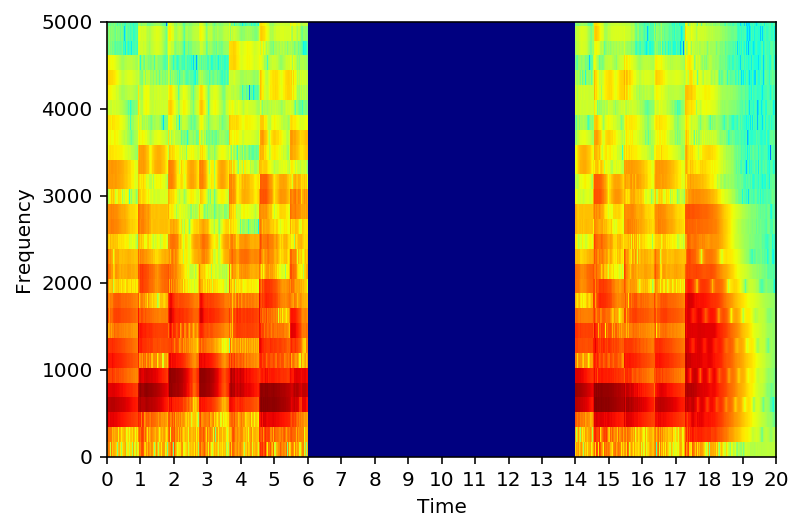

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/orig-19.wav


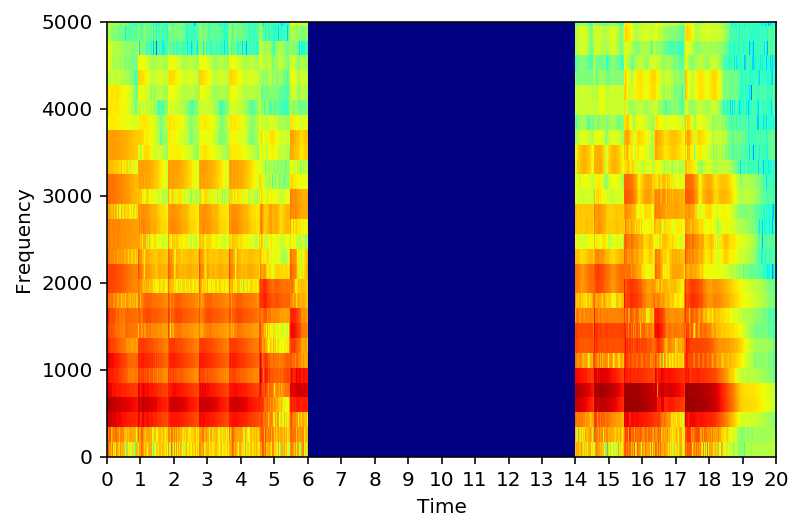

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-1.wav


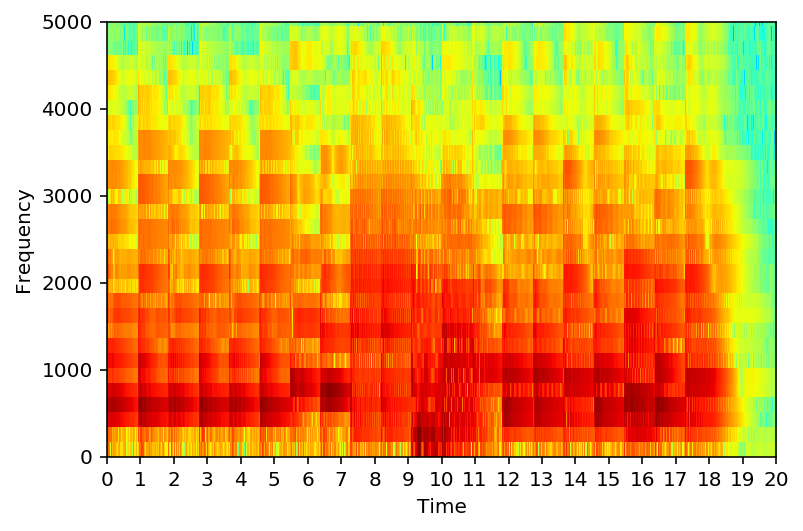

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-2.wav


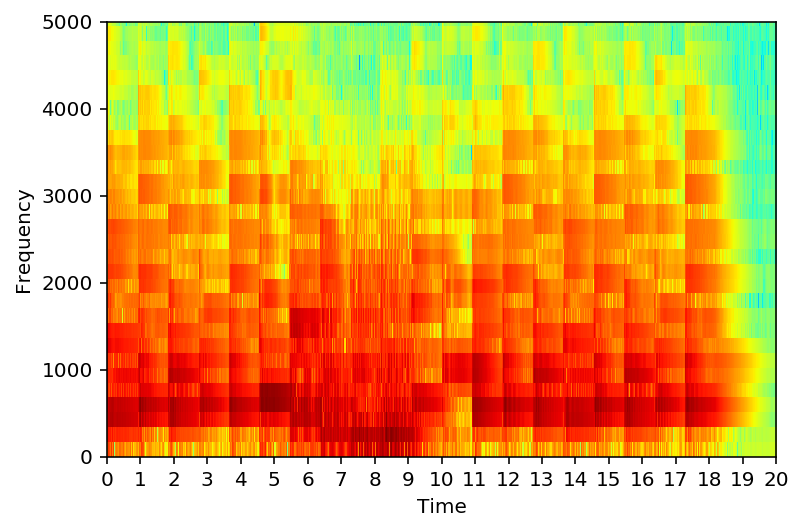

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-3.wav


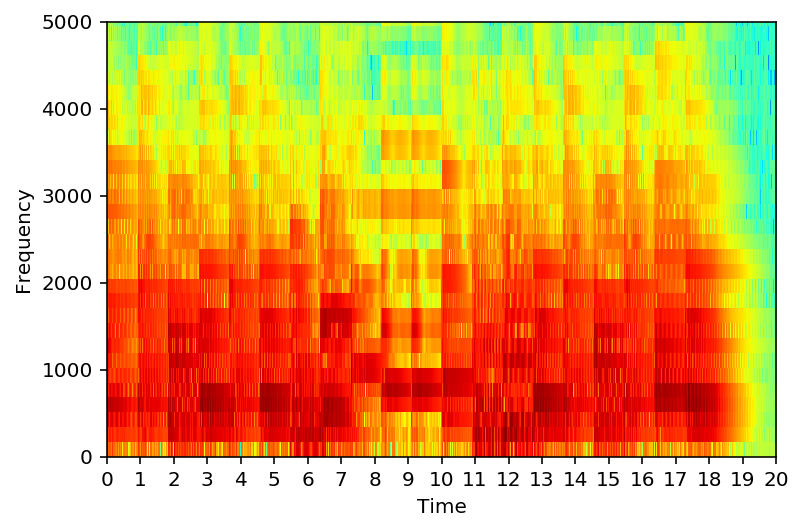

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-4.wav


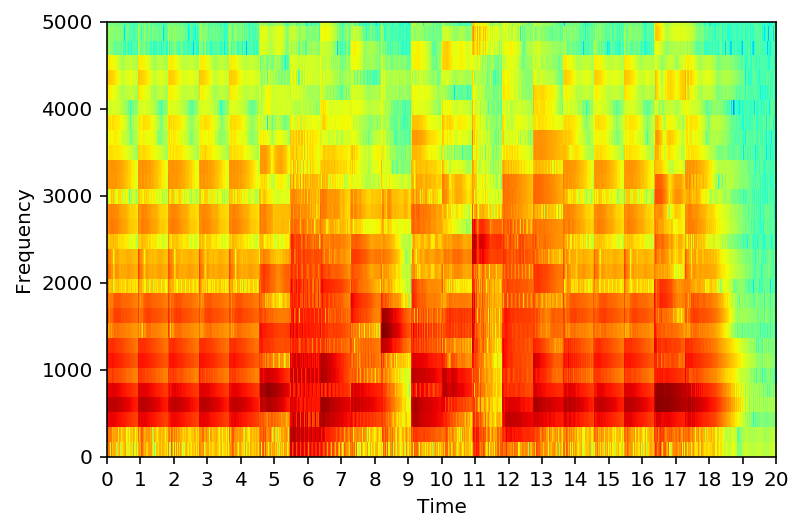

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-5.wav


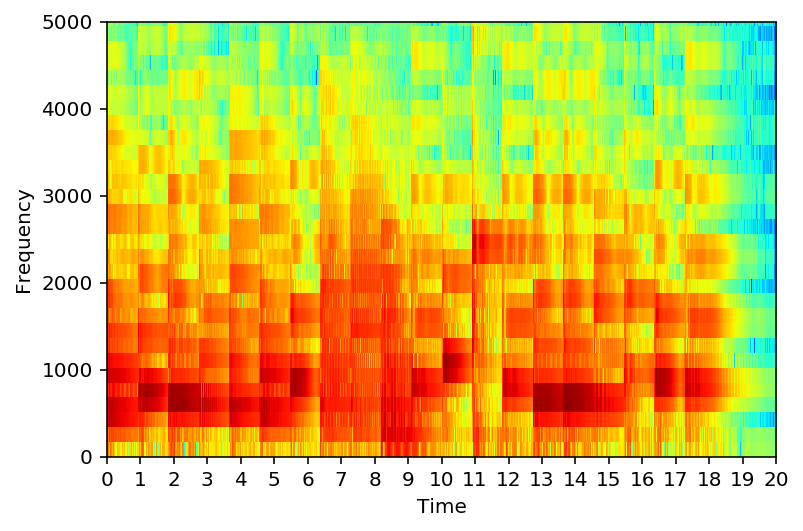

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-6.wav


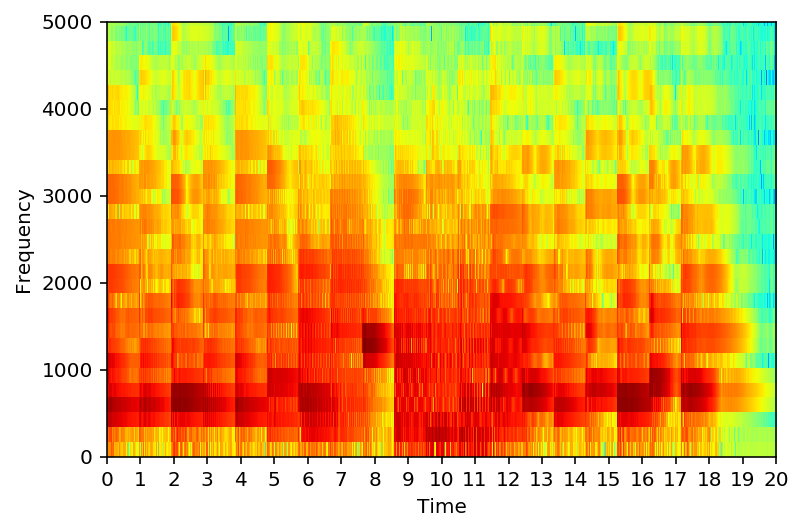

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-7.wav


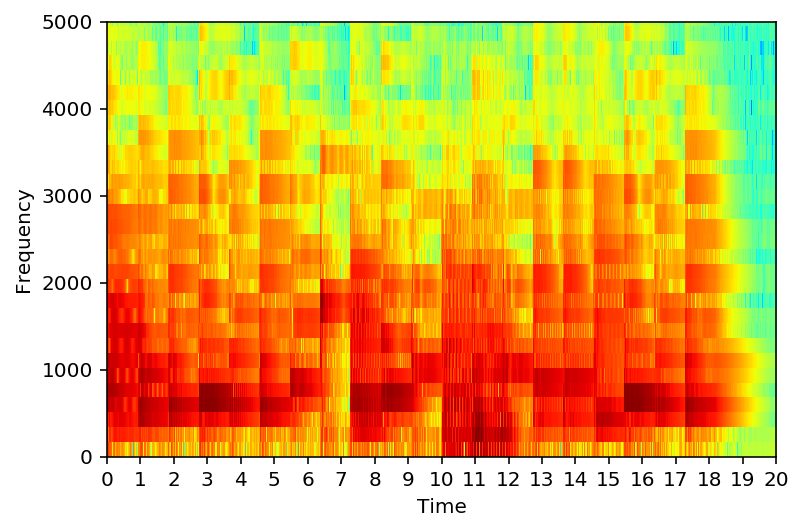

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-8.wav


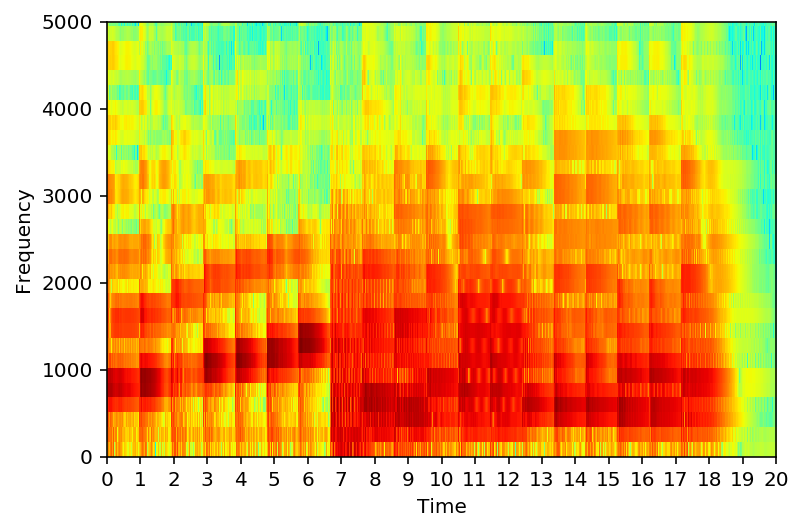

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-9.wav


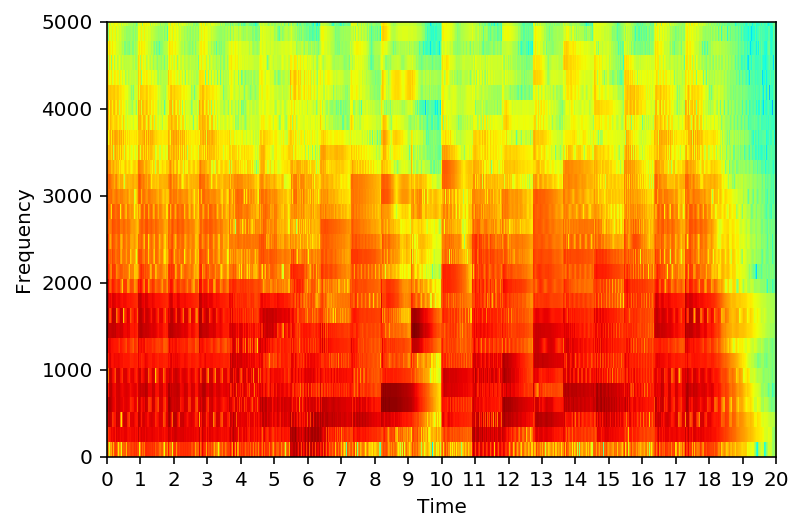

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-10.wav


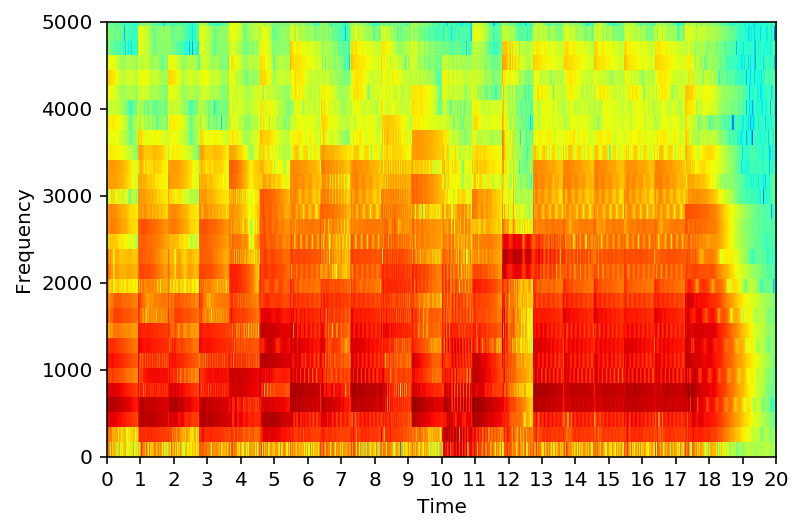

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-11.wav


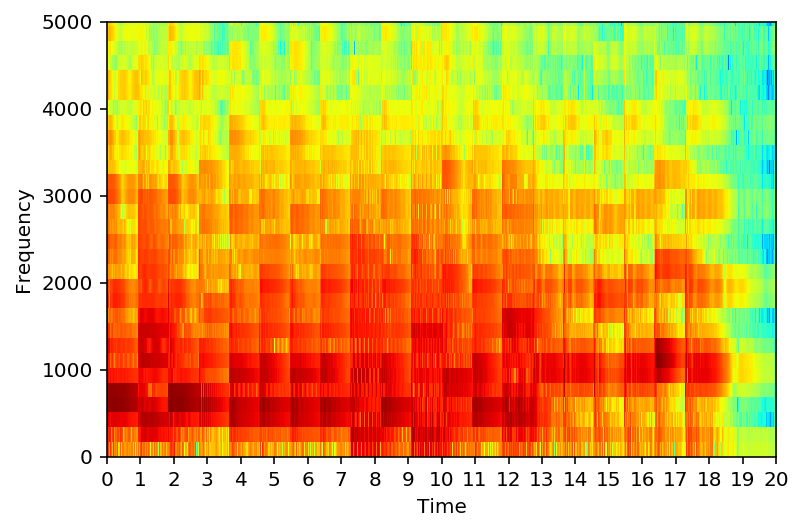

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-12.wav


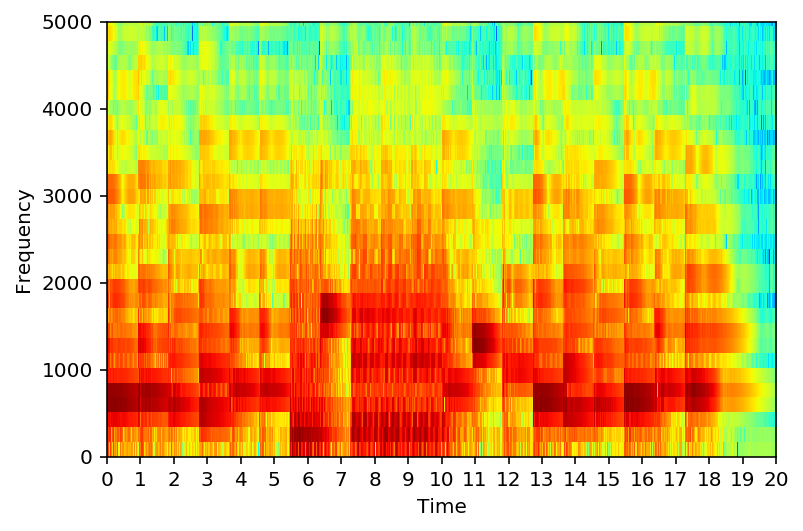

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-13.wav


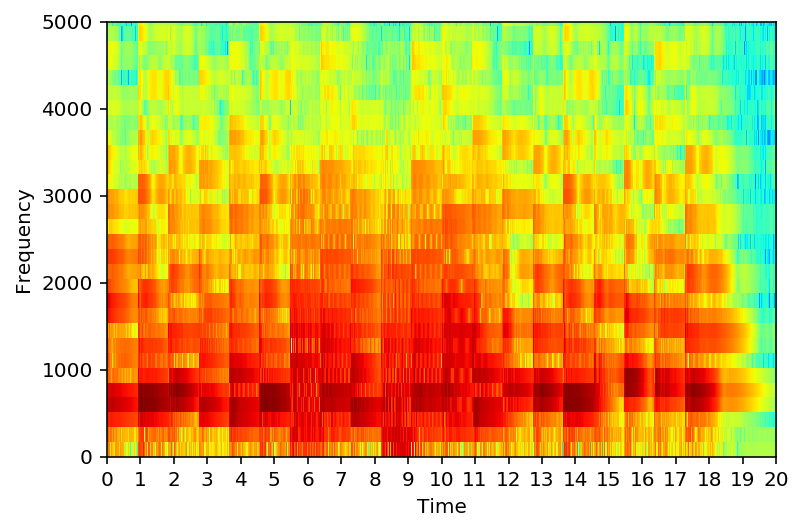

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-14.wav


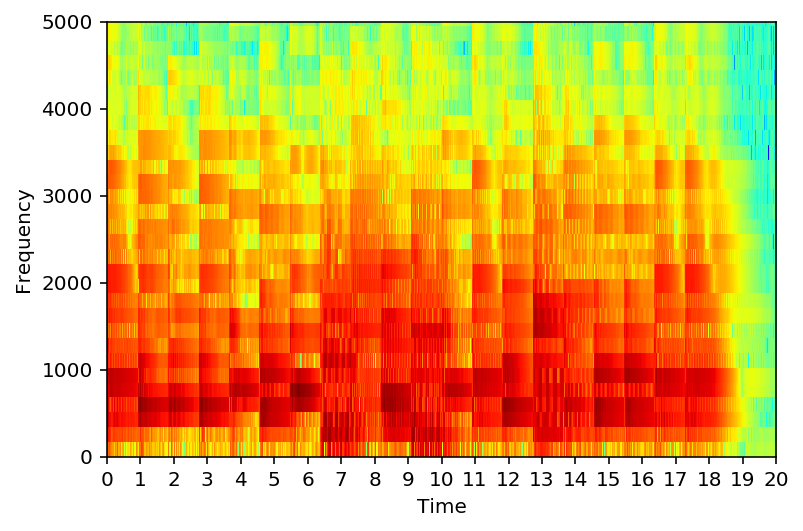

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-15.wav


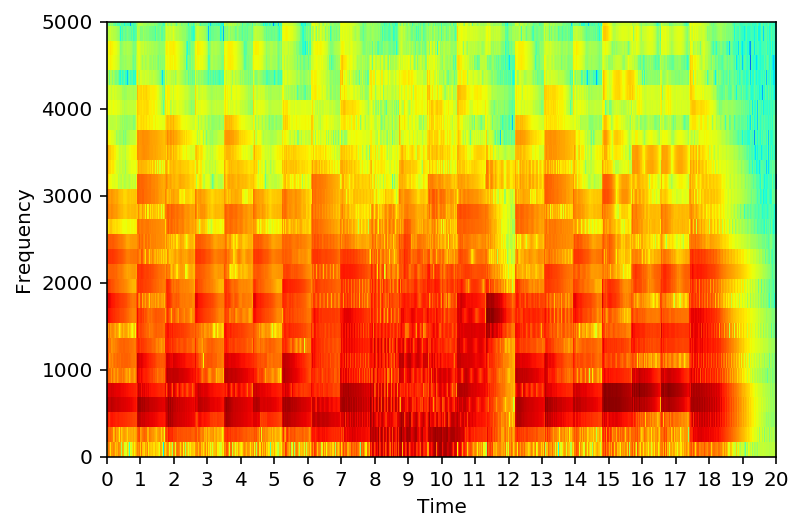

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-16.wav


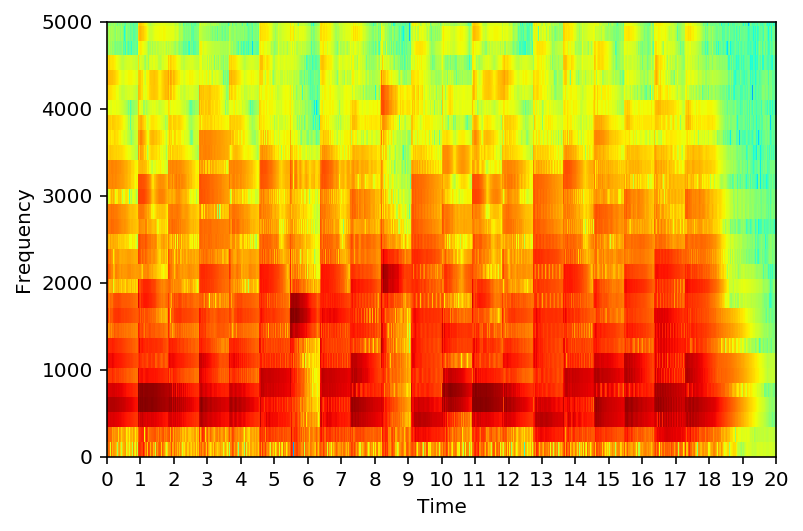

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-17.wav


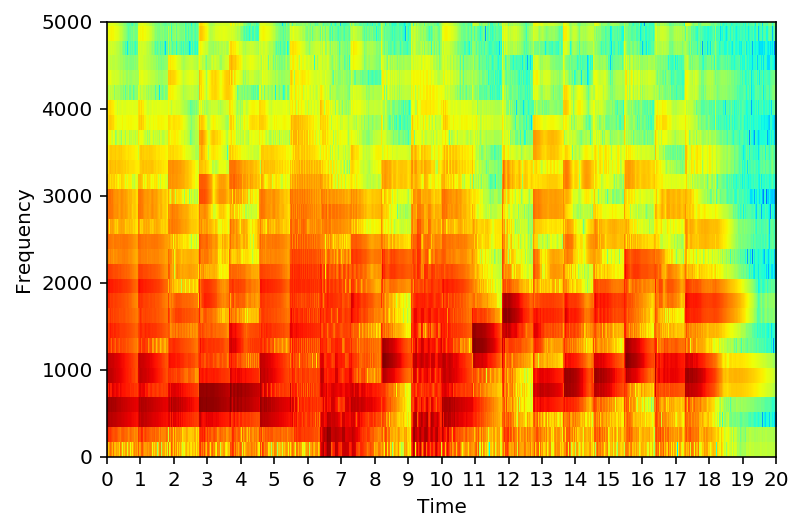

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-18.wav


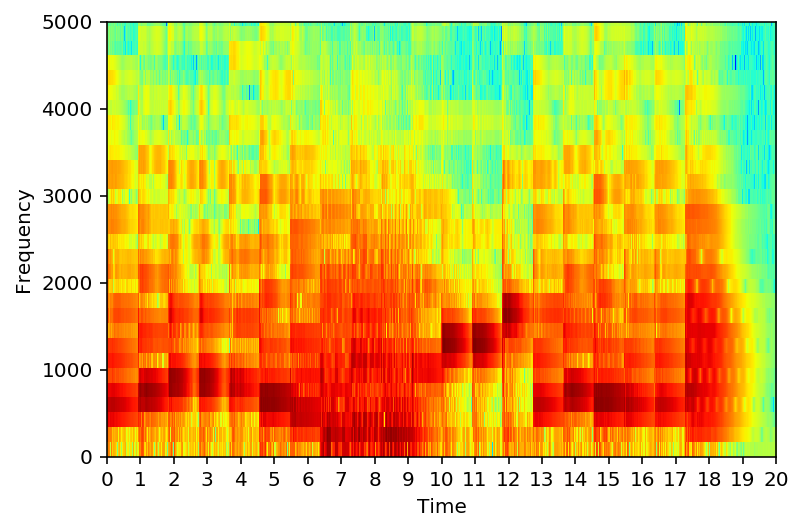

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/mozart/filled-19.wav


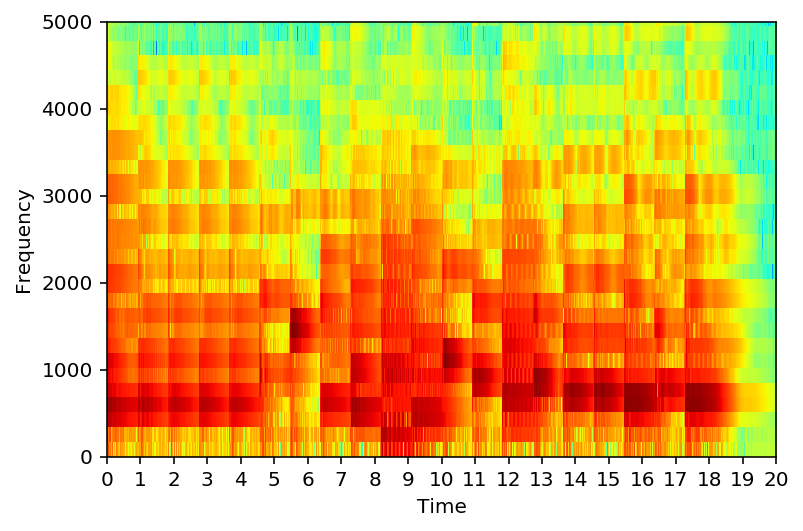

read ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/mono_orig.txt
A4 G#4 B4 A4 G#4 C#5 C#5 F#5 A4 G#4 A4 G#4 B4 A4 G#4 F#4 C#5 C#5 C#5 C#5
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-1.wav


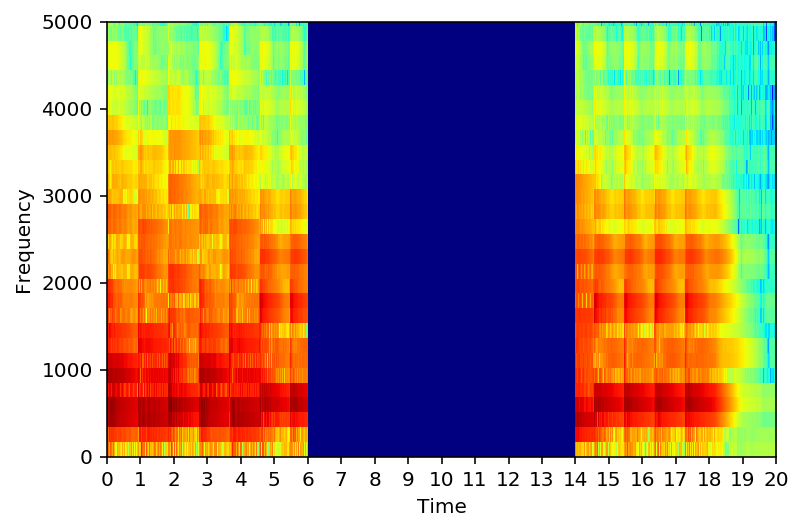

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-2.wav


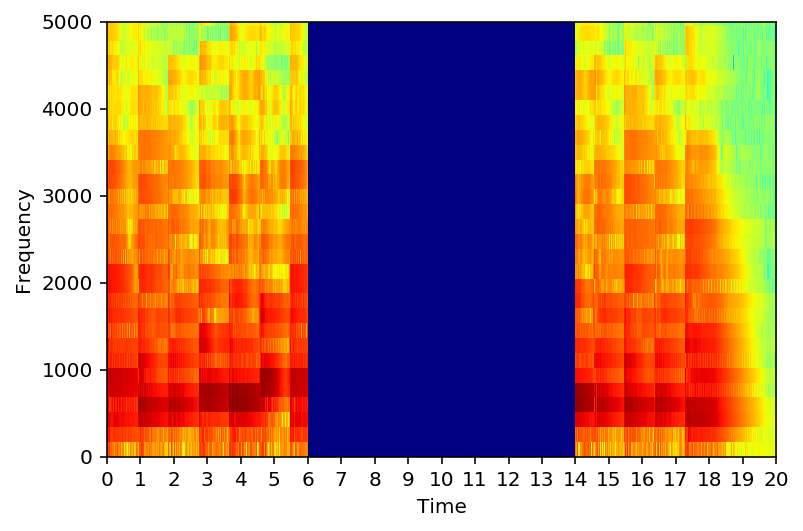

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-3.wav


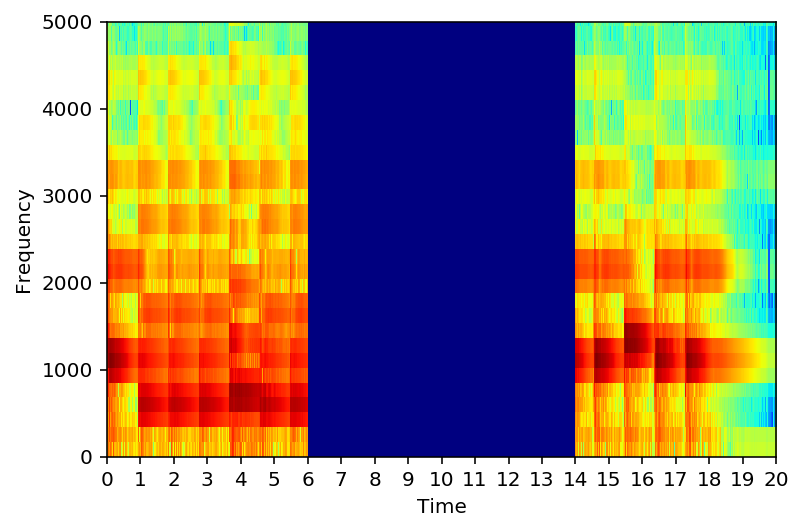

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-4.wav


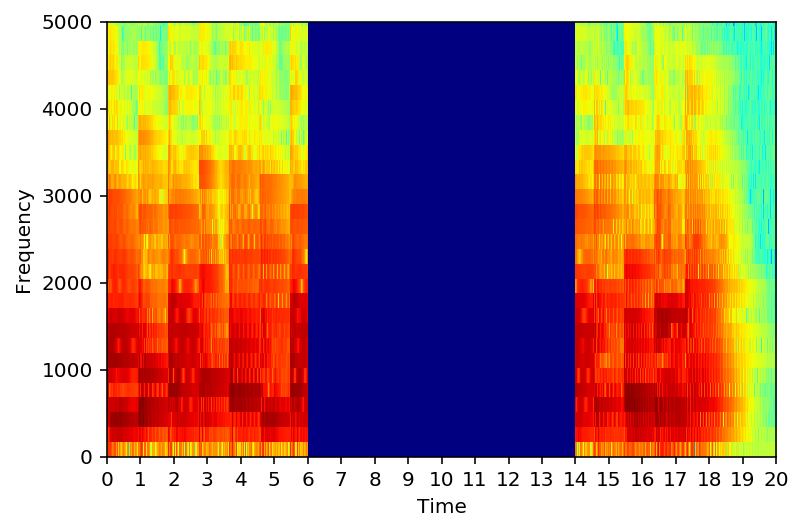

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-5.wav


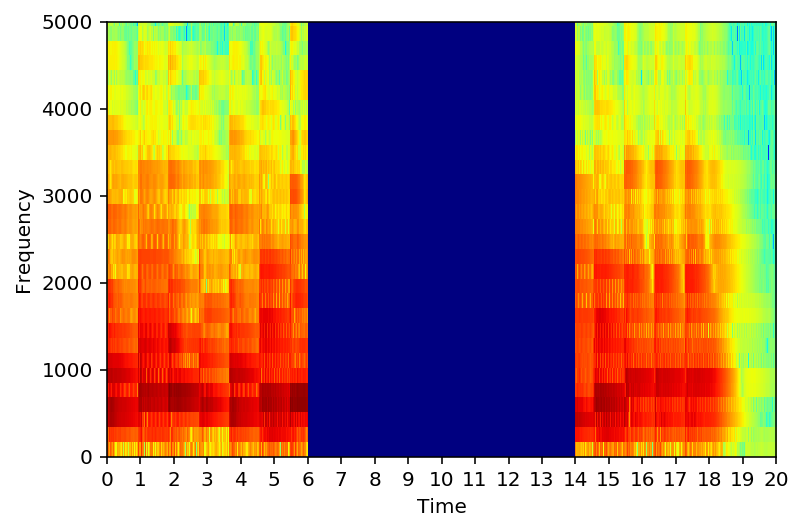

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-6.wav


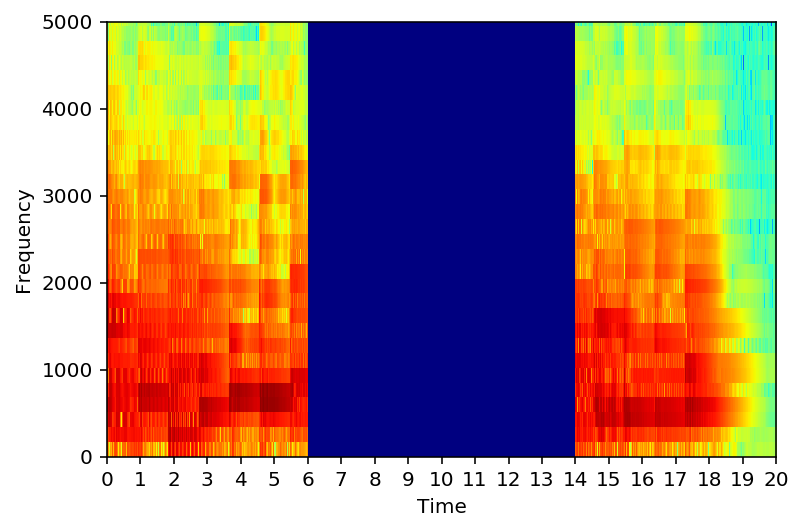

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-7.wav


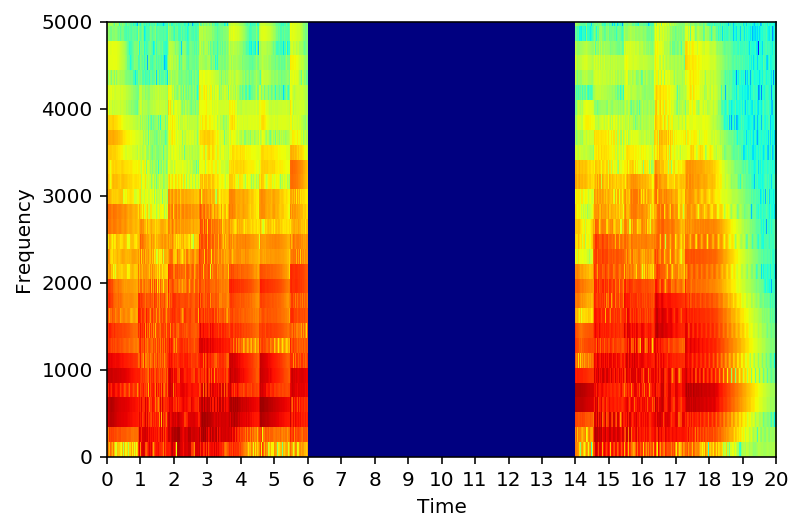

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-8.wav


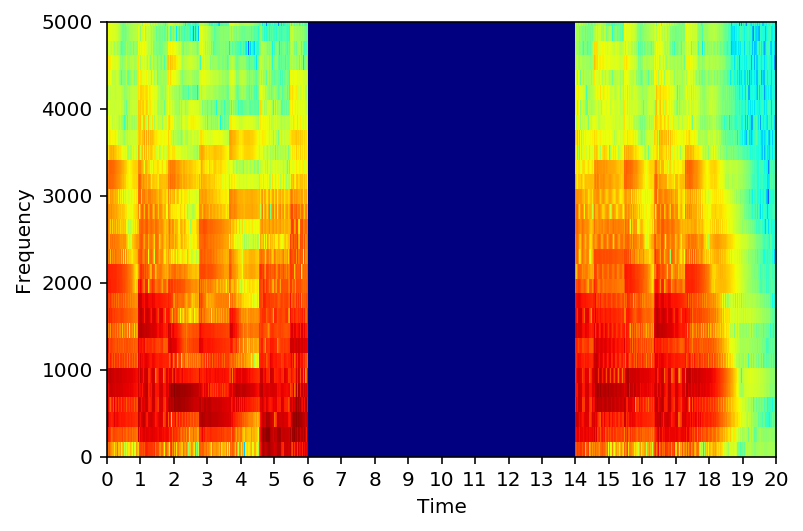

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-9.wav


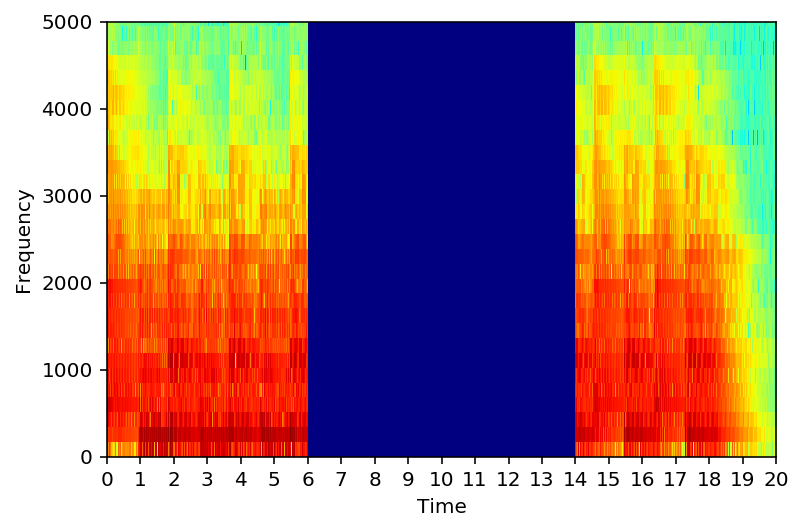

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-10.wav


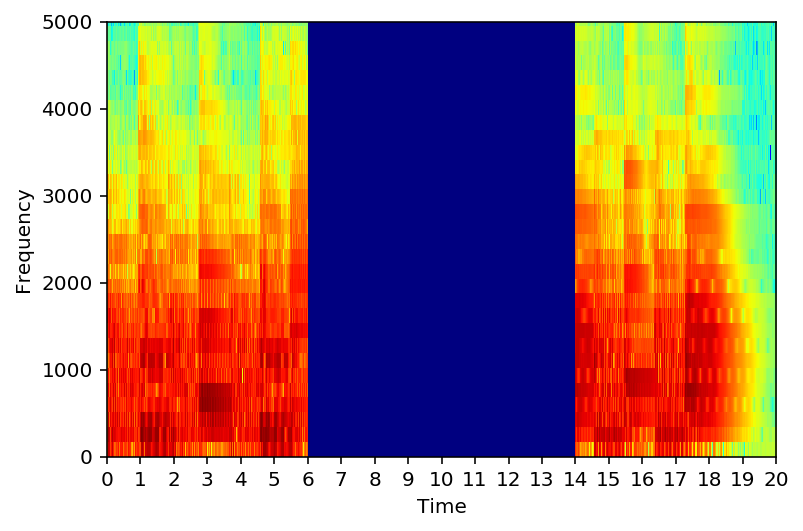

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-11.wav


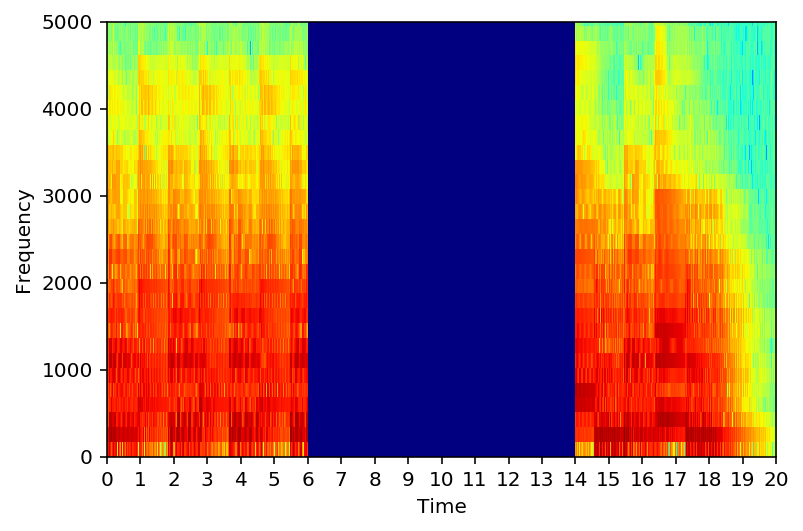

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-12.wav


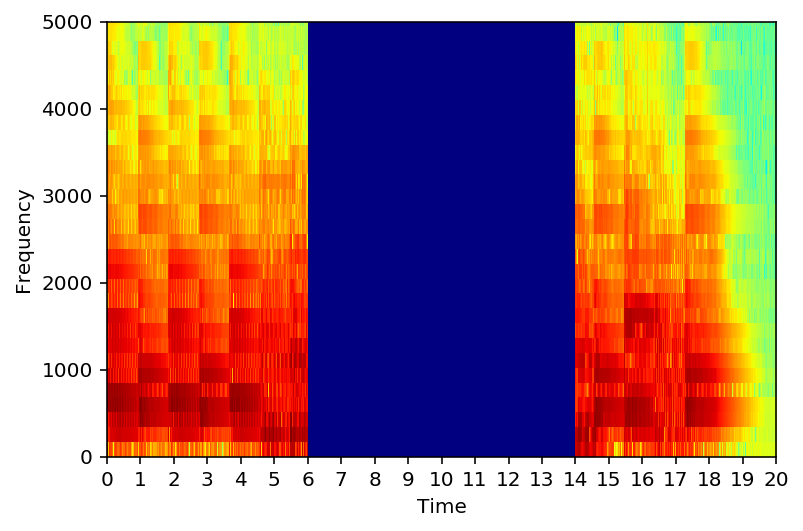

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-13.wav


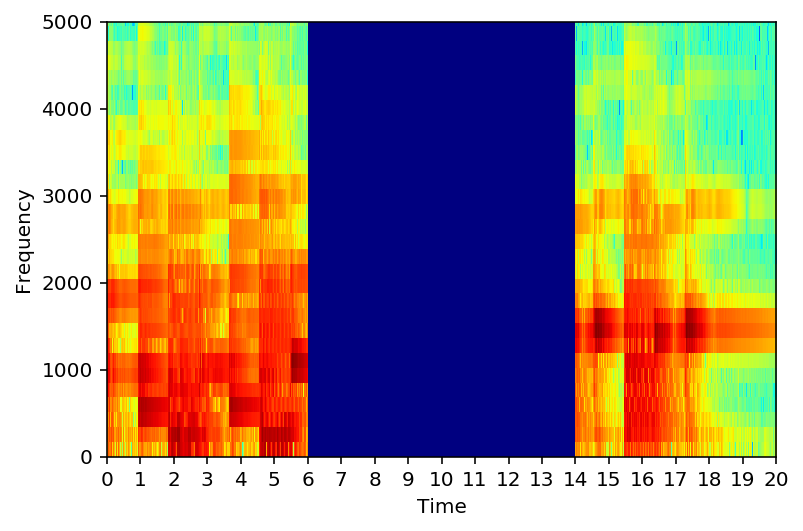

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-14.wav


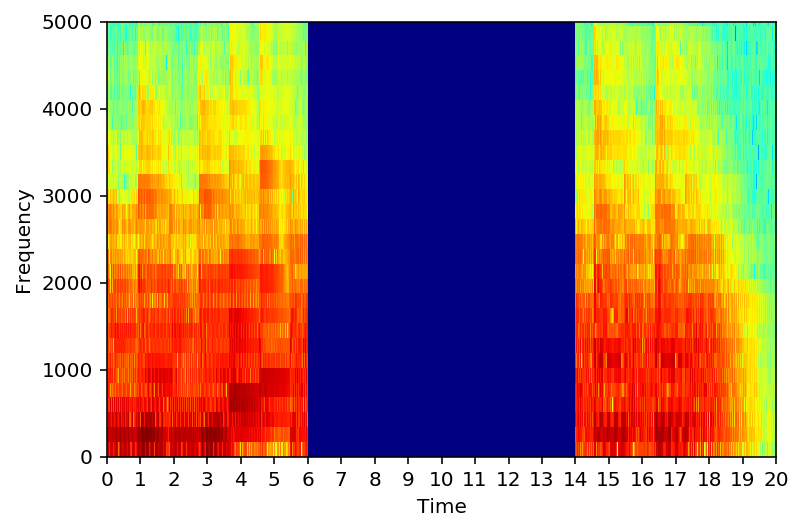

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-15.wav


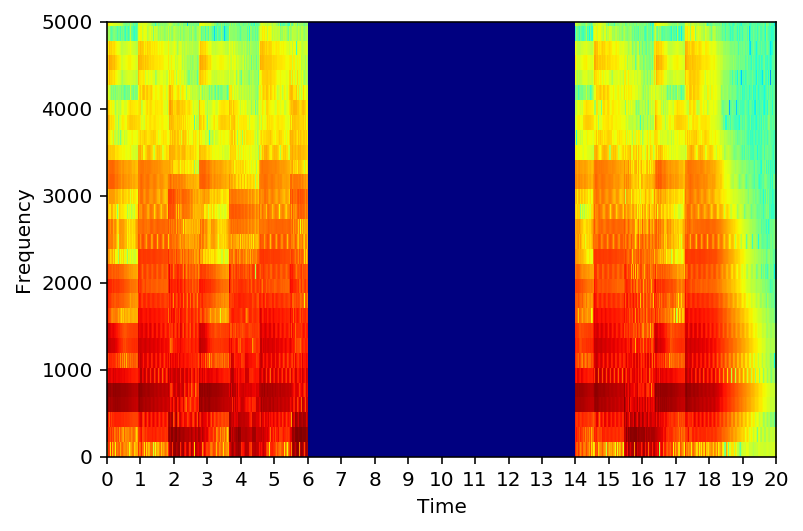

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-16.wav


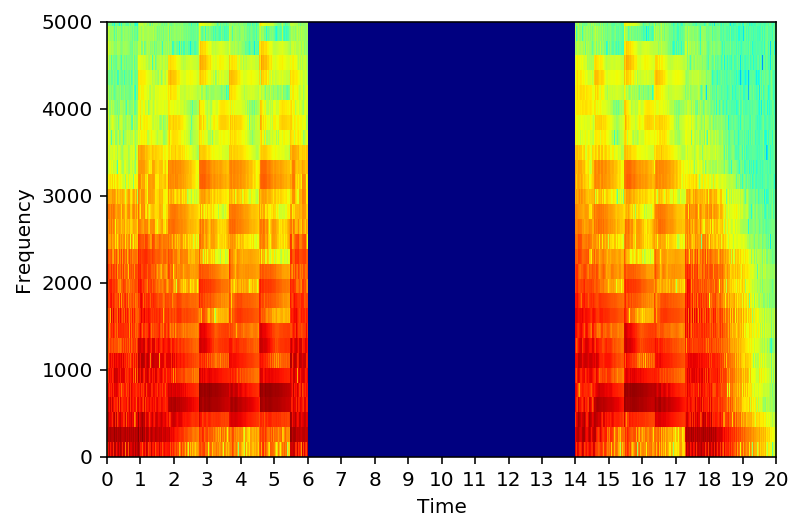

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-17.wav


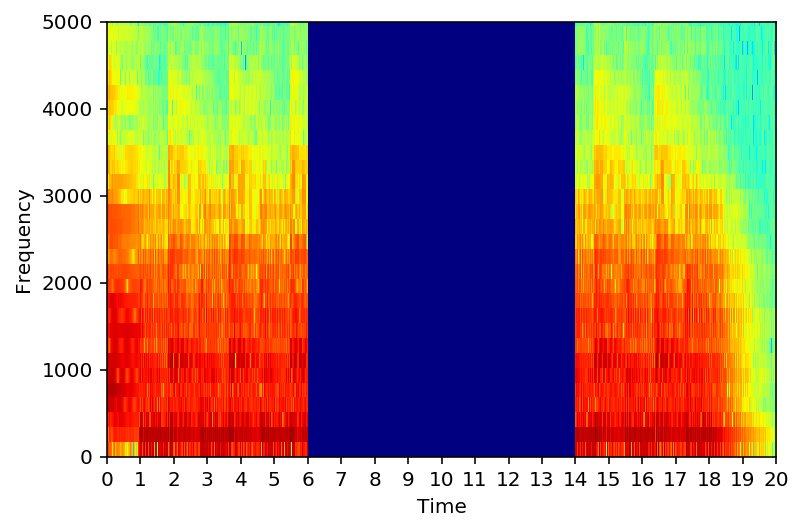

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-18.wav


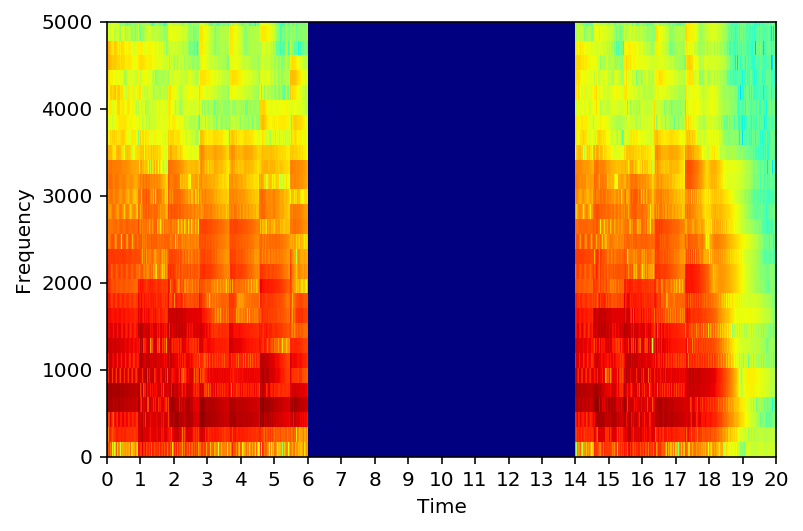

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/orig-19.wav


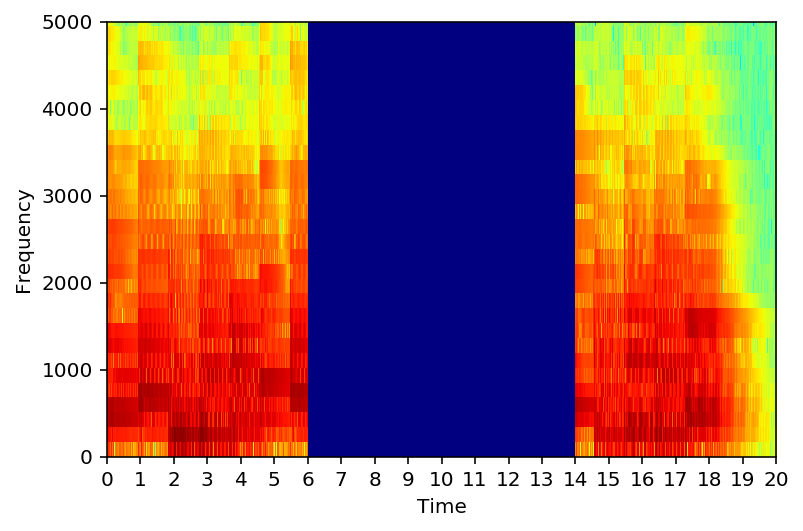

read ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-1.wav


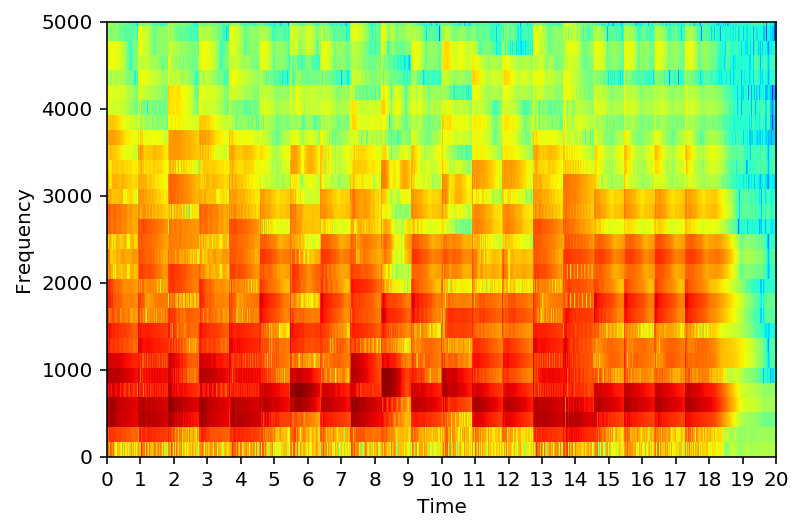

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-2.wav


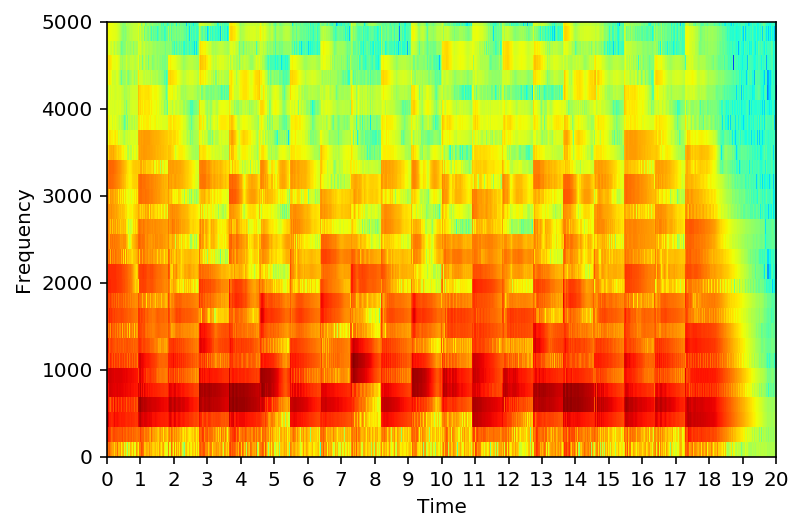

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-3.wav


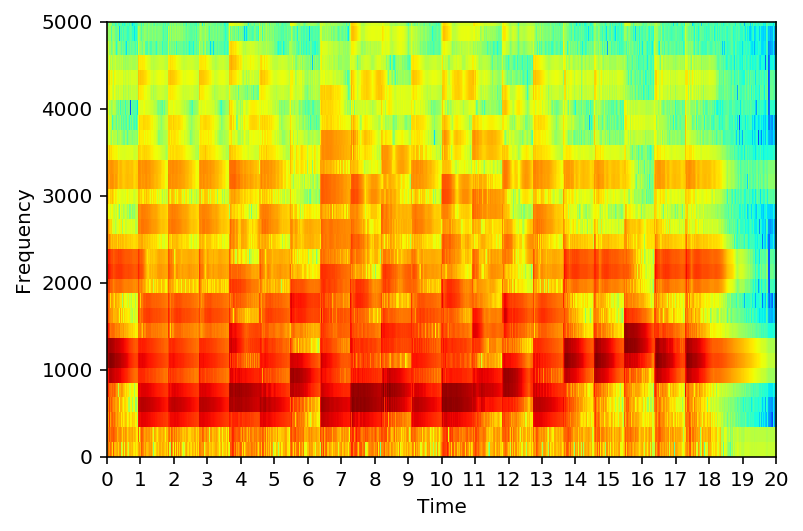

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-4.wav


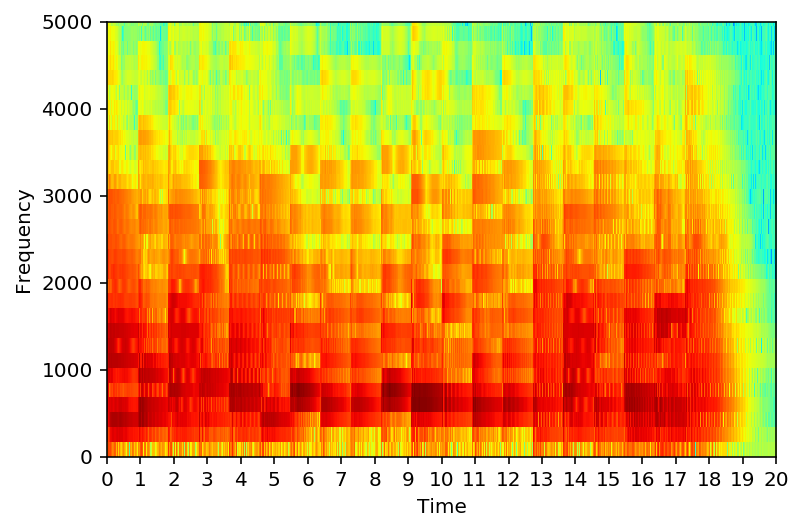

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-5.wav


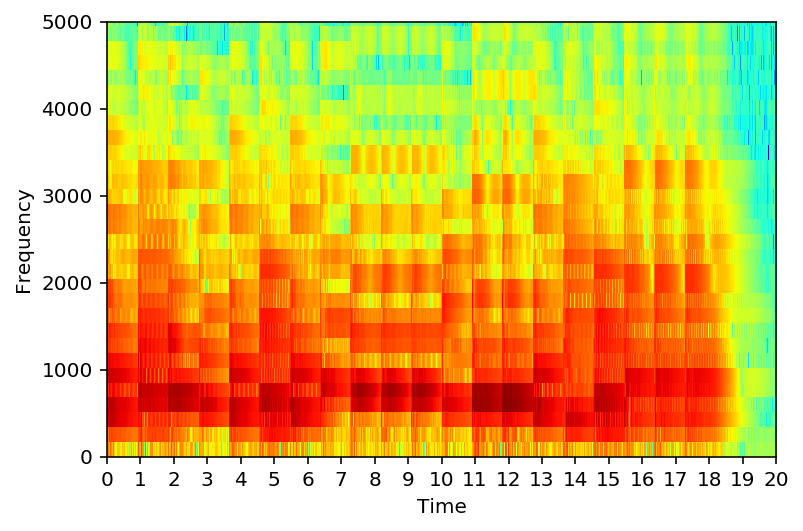

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-6.wav


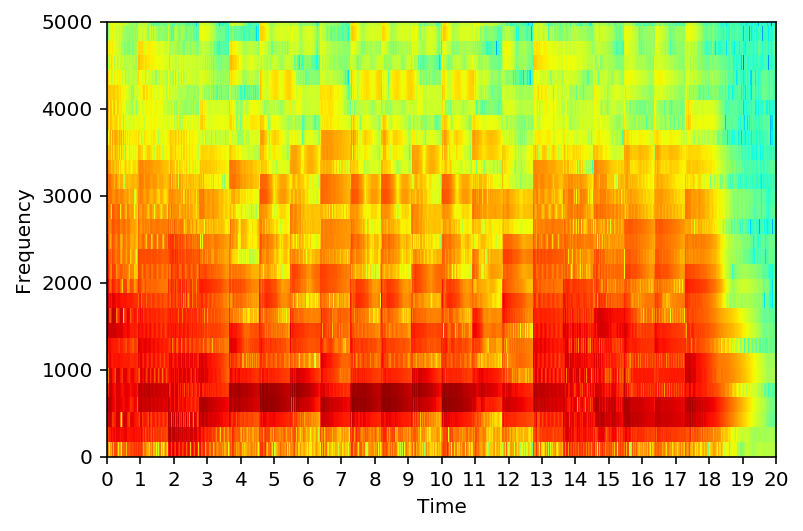

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-7.wav


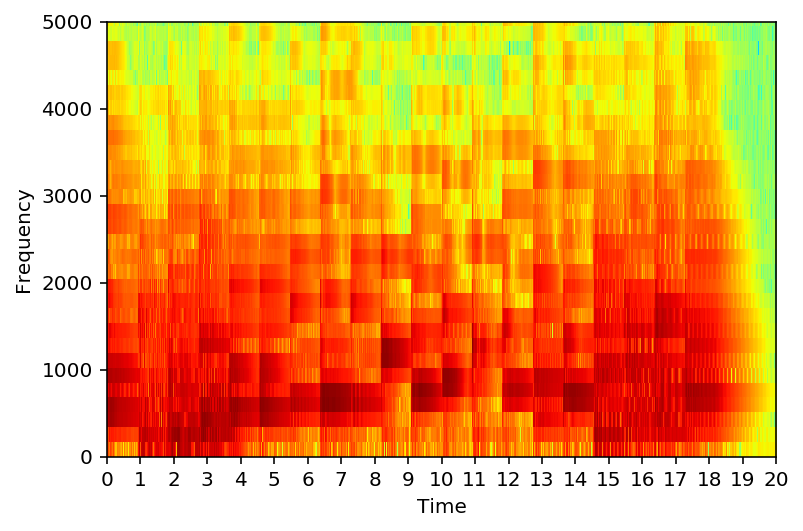

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-8.wav


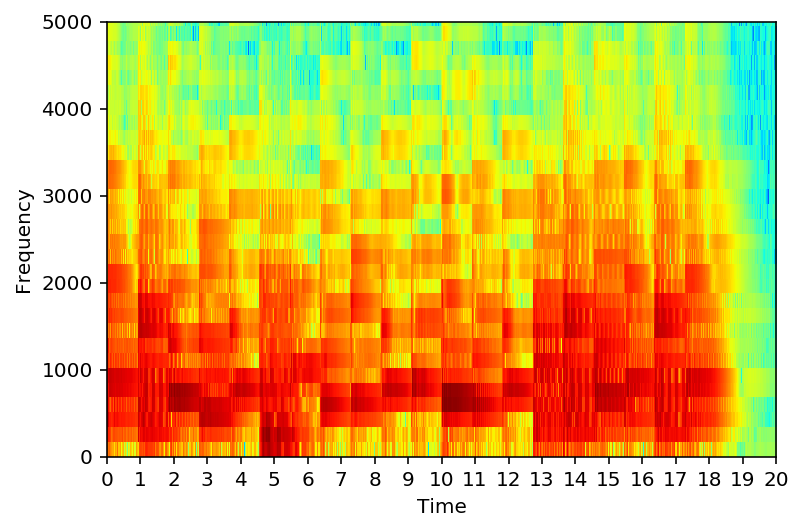

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-9.wav


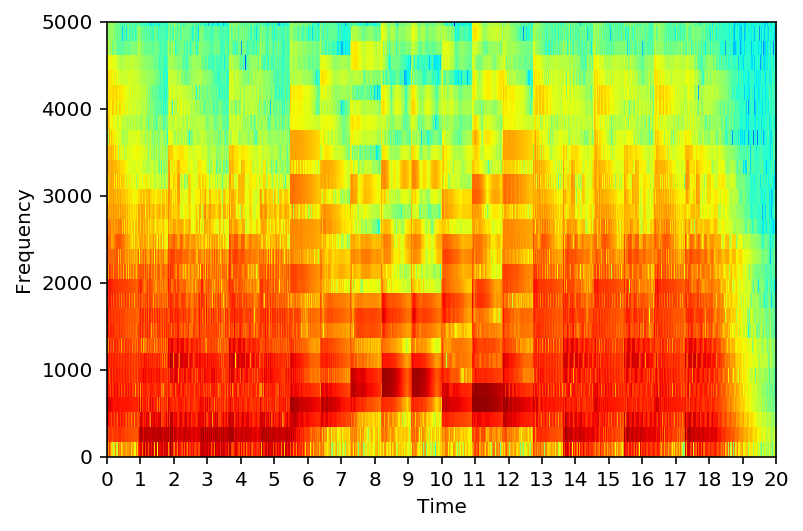

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-10.wav


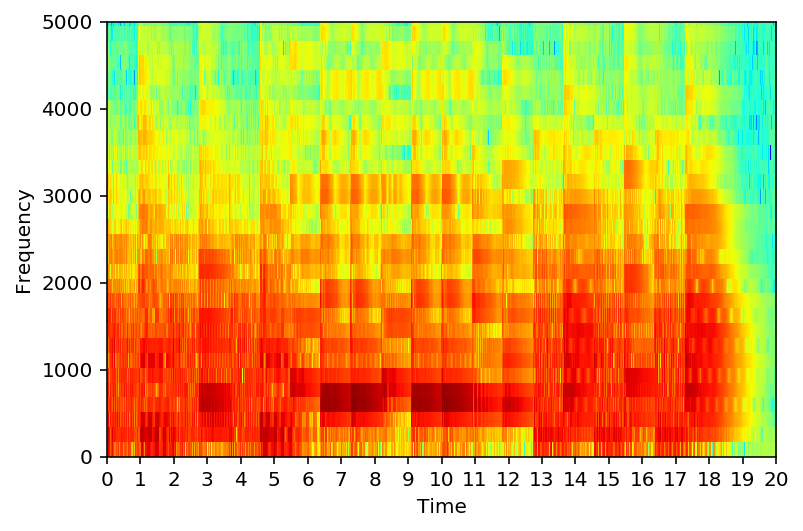

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-11.wav


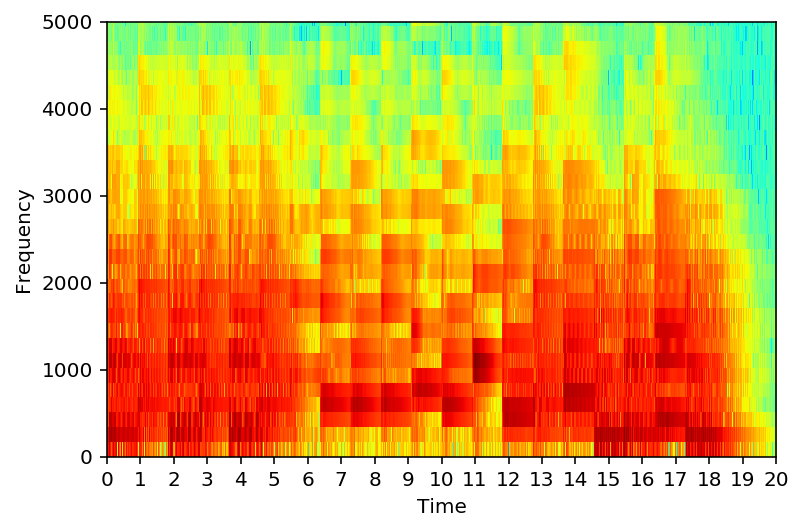

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-12.wav


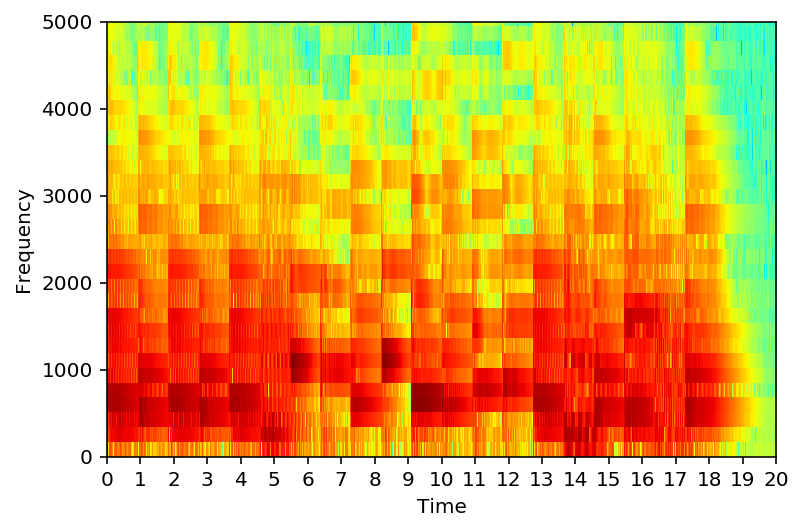

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-13.wav


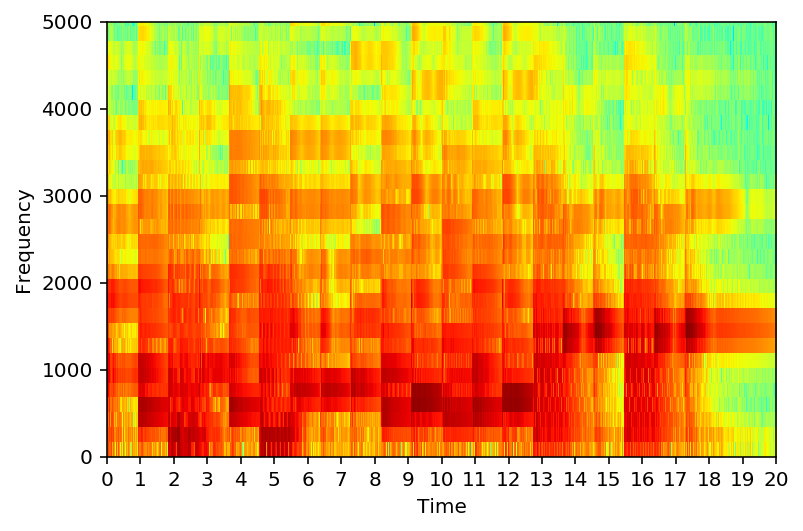

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-14.wav


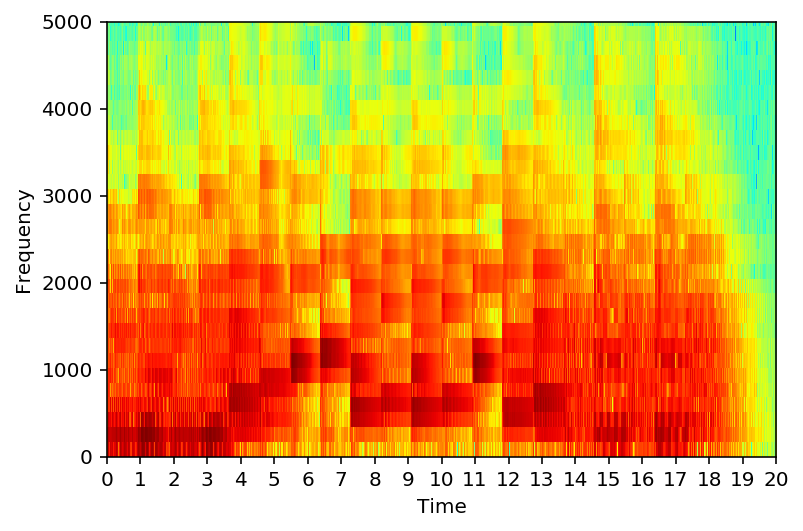

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-15.wav


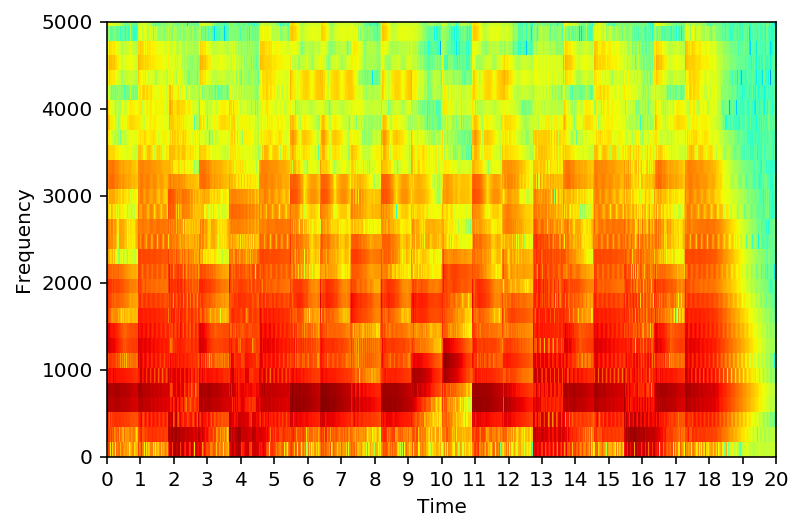

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-16.wav


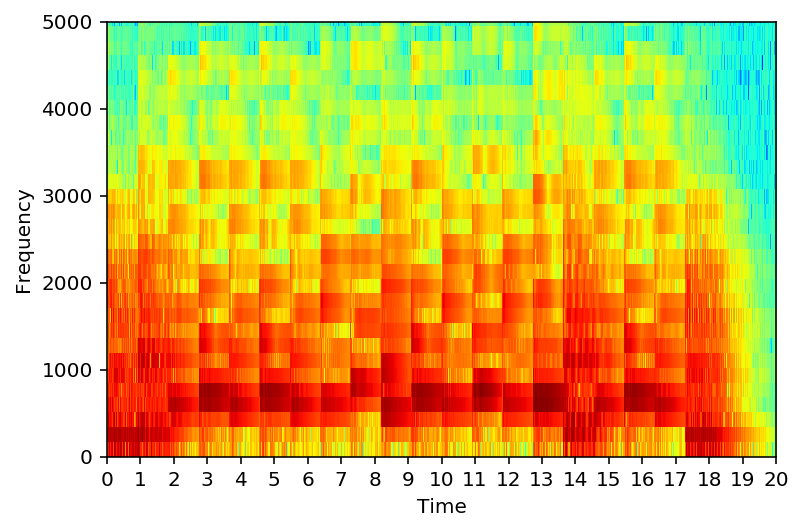

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-17.wav


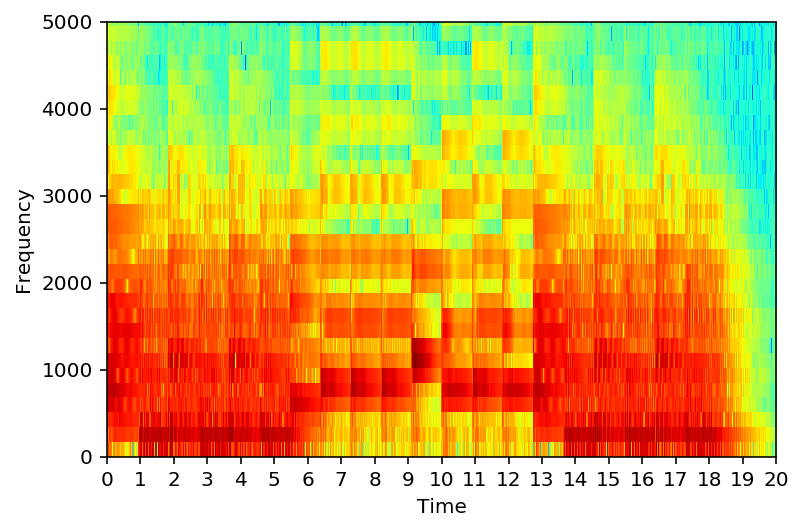

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-18.wav


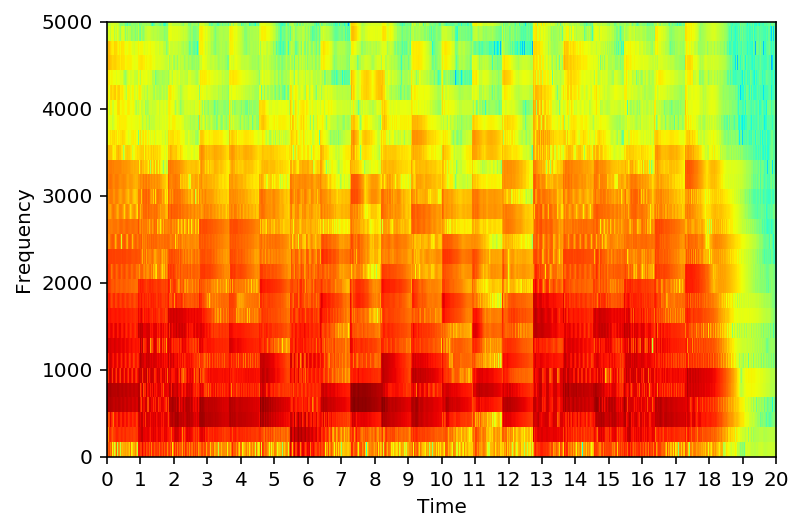

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/schubert/filled-19.wav


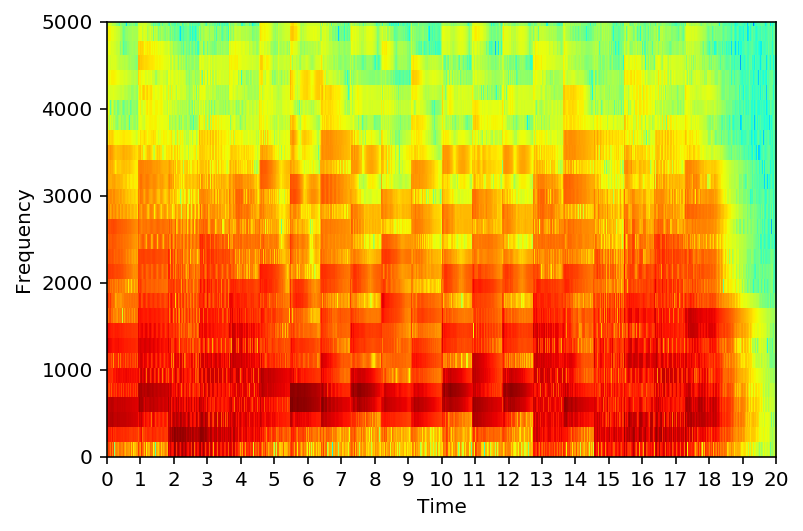

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/mono_orig.txt
C4 E-3 E3 G#1 E3 E3 E3 E3 E3 E4 E3 E3 E5 G#1 E4 E4 F5 B3 B3 B3
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-1.wav


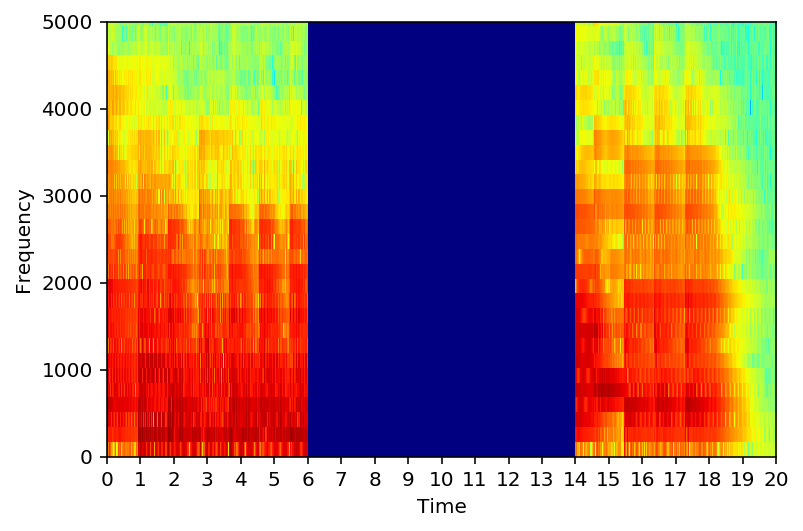

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-2.wav


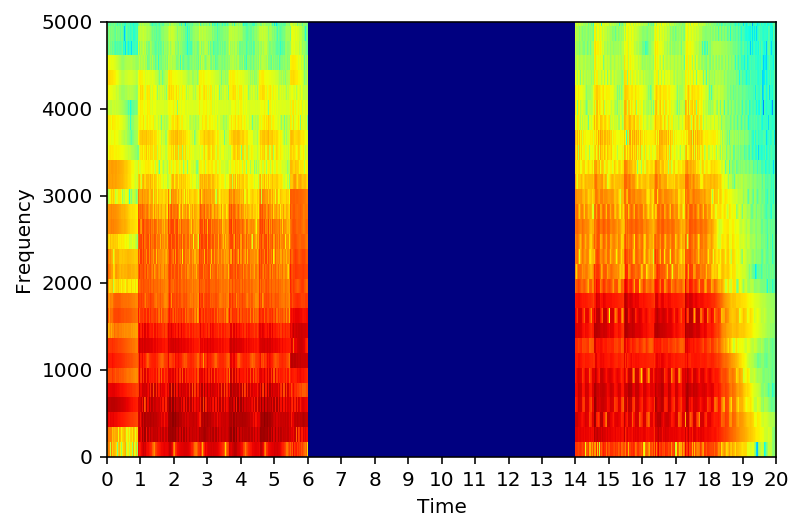

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-3.wav


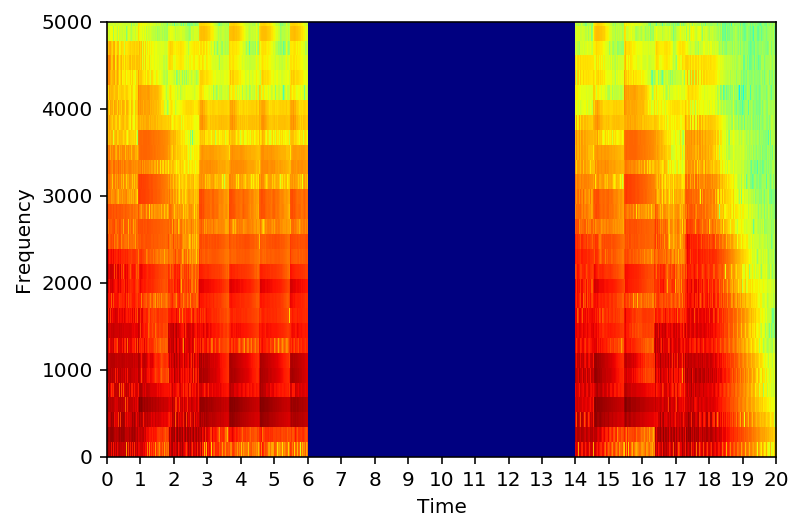

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-4.wav


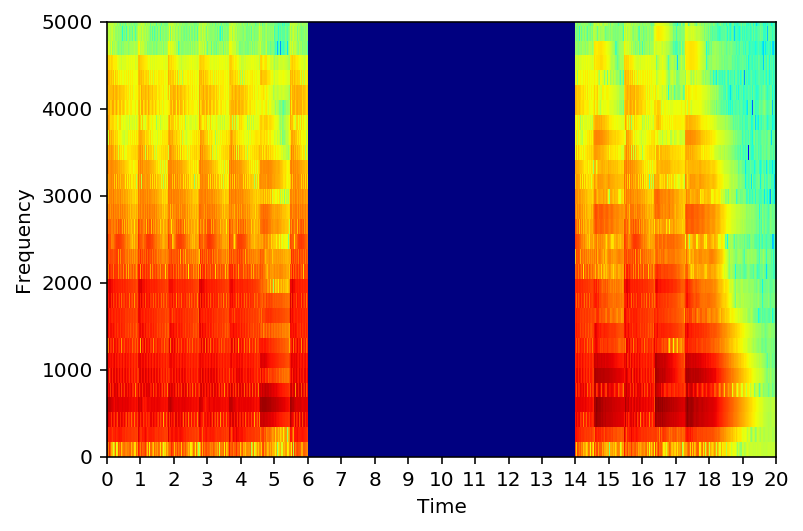

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-5.wav


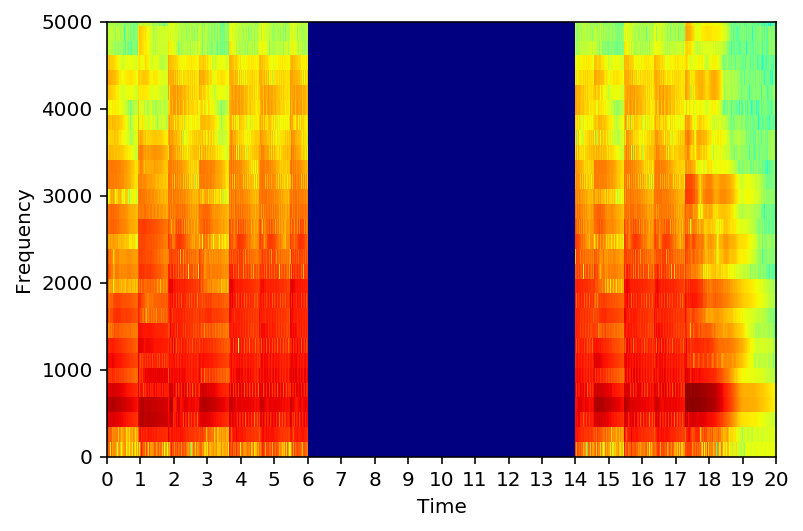

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-6.wav


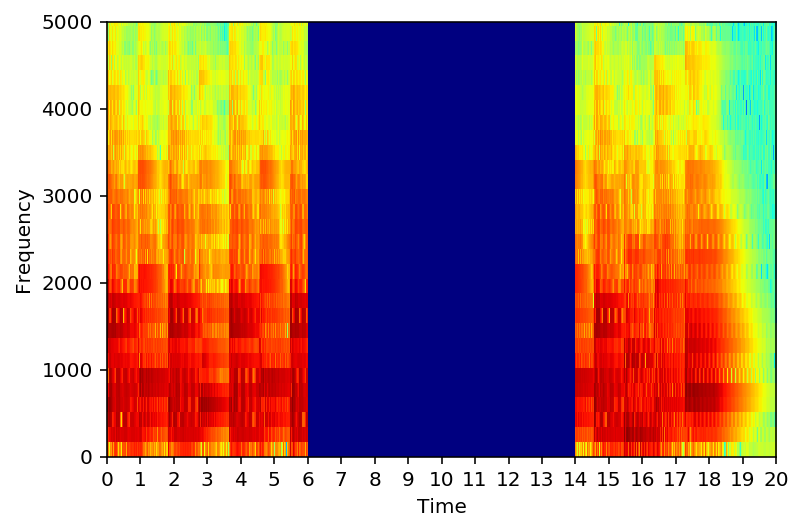

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-7.wav


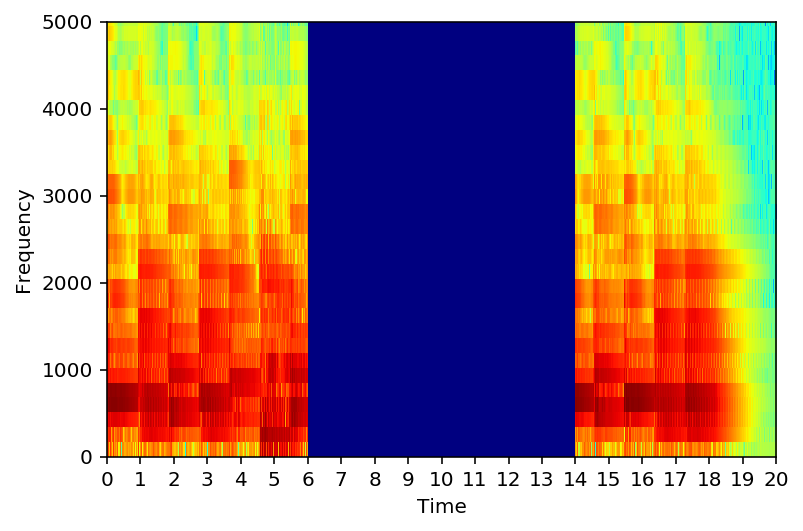

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-8.wav


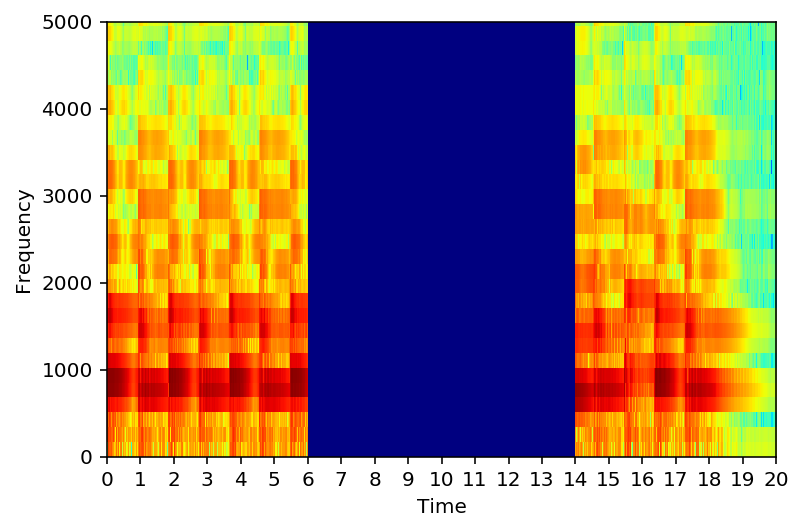

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-9.wav


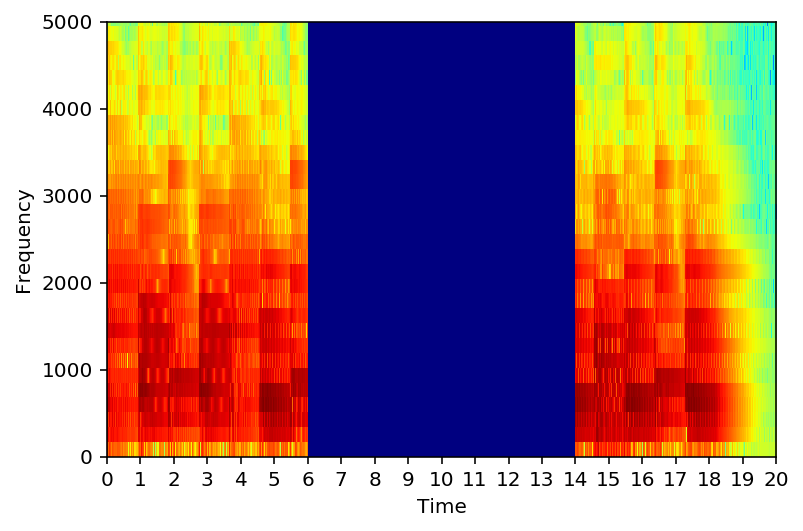

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-10.wav


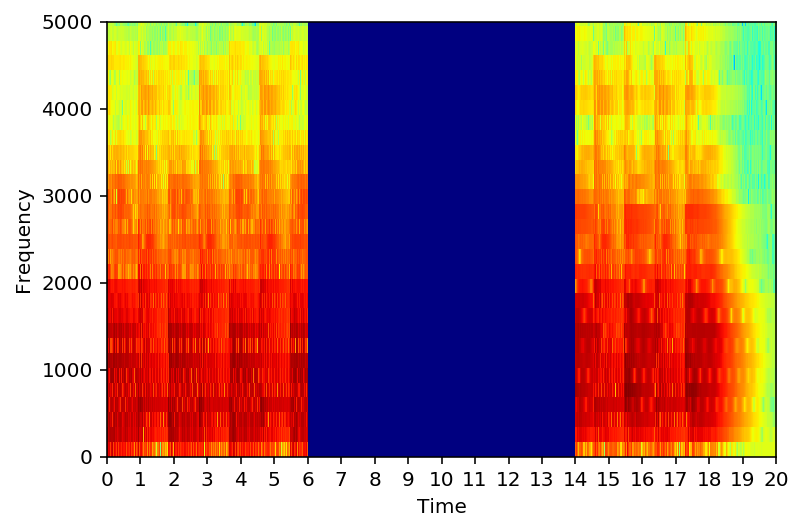

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-11.wav


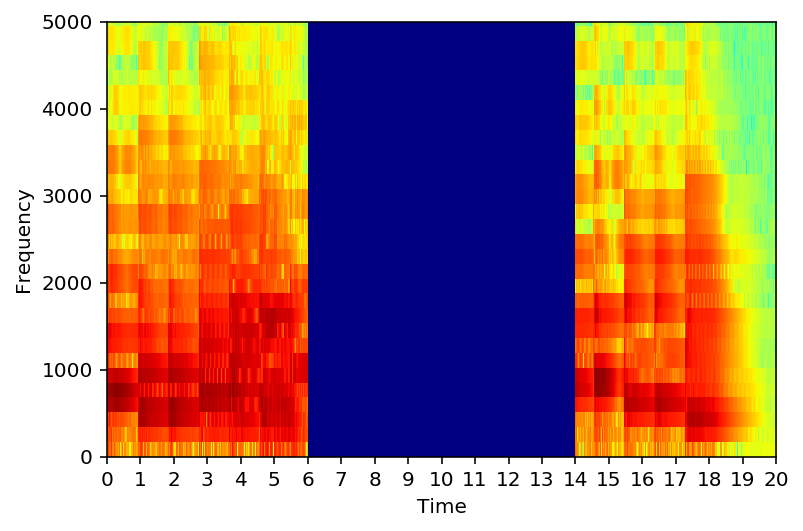

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-12.wav


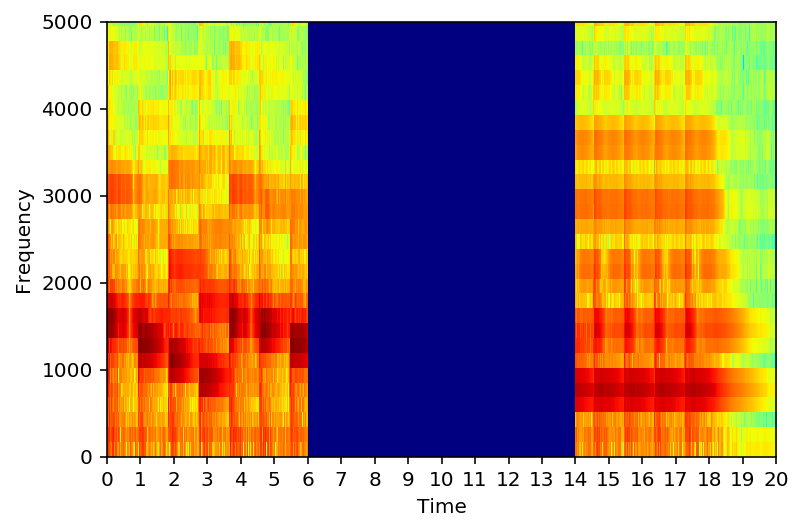

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-13.wav


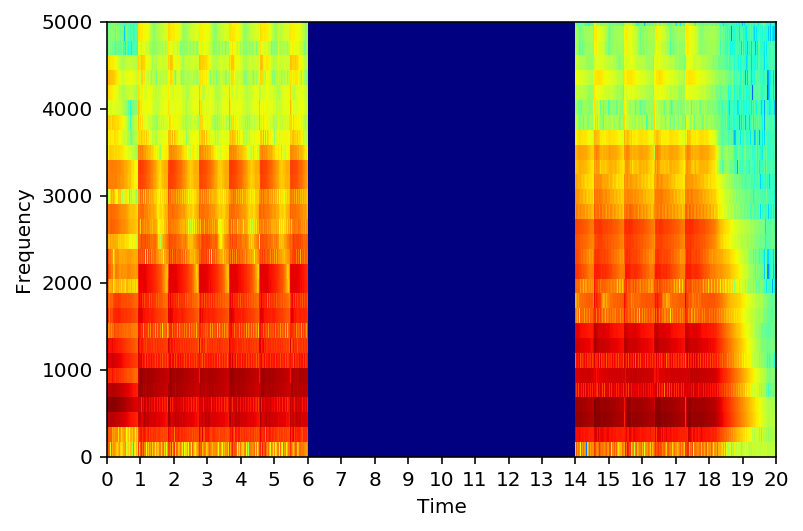

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-14.wav


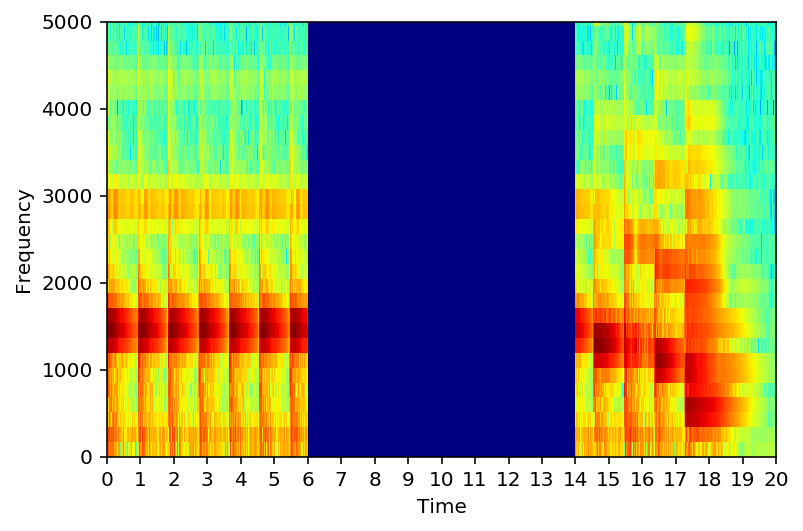

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-15.wav


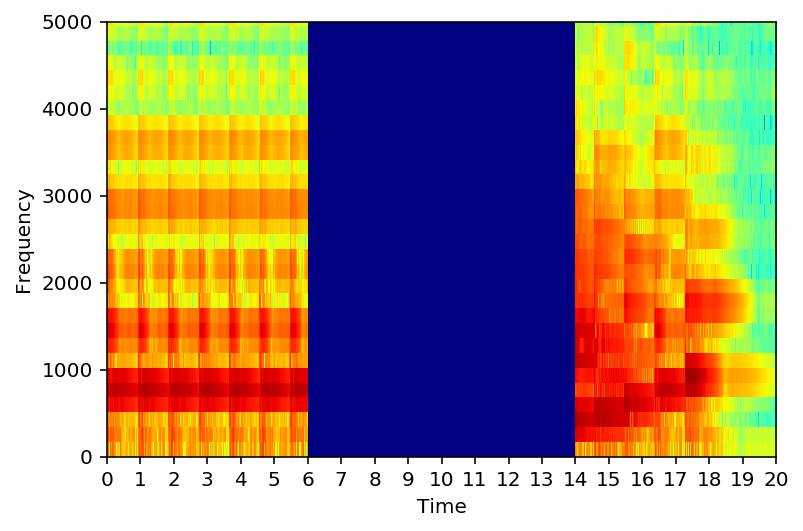

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-16.wav


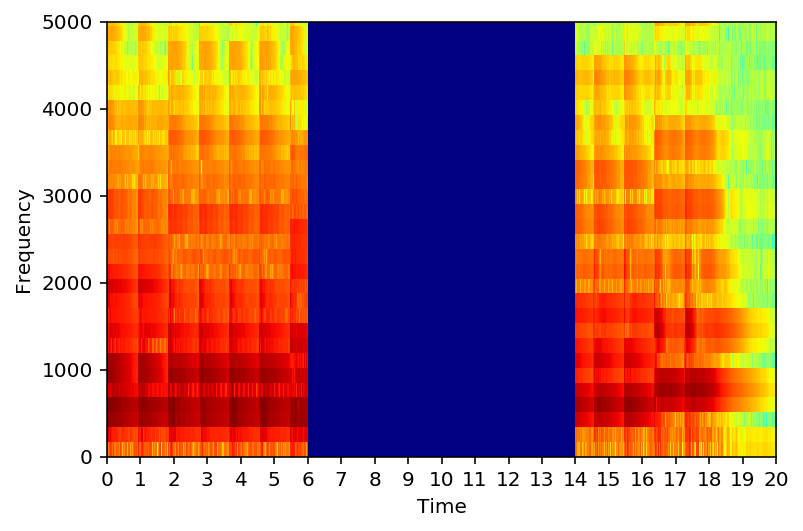

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-17.wav


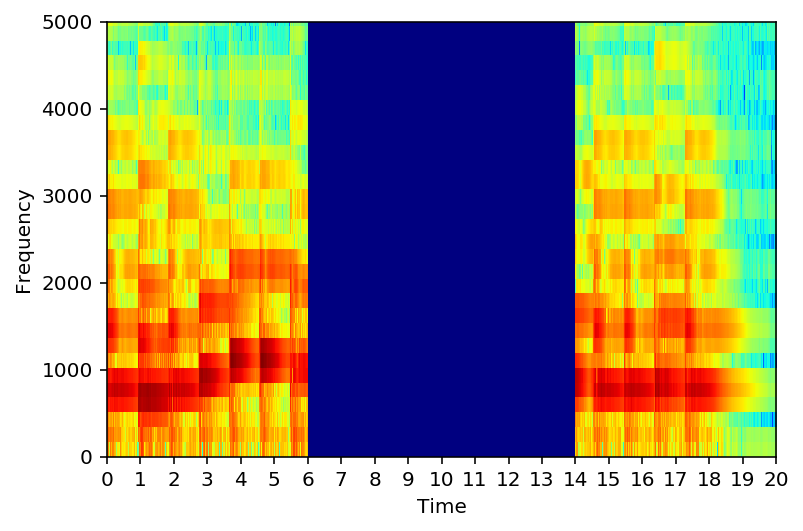

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-18.wav


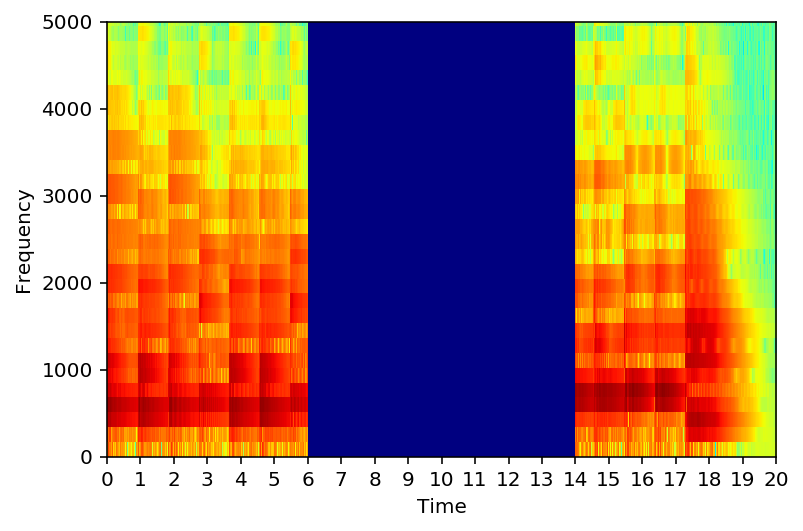

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/orig-19.wav


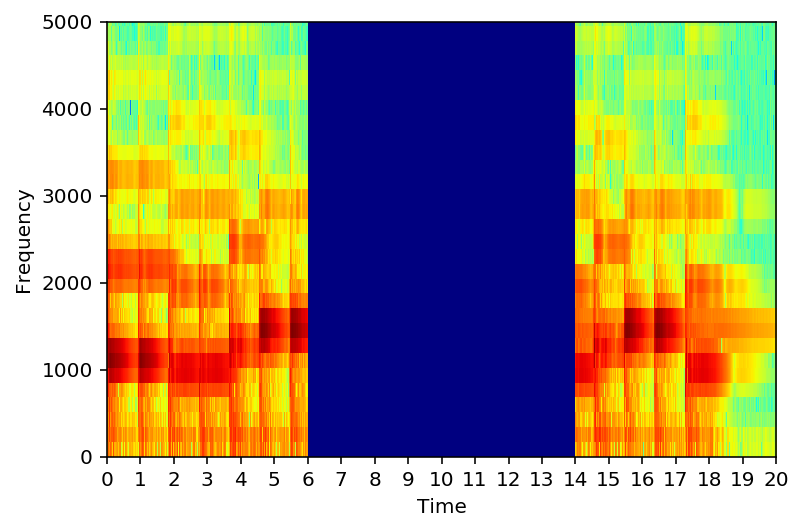

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-1.wav


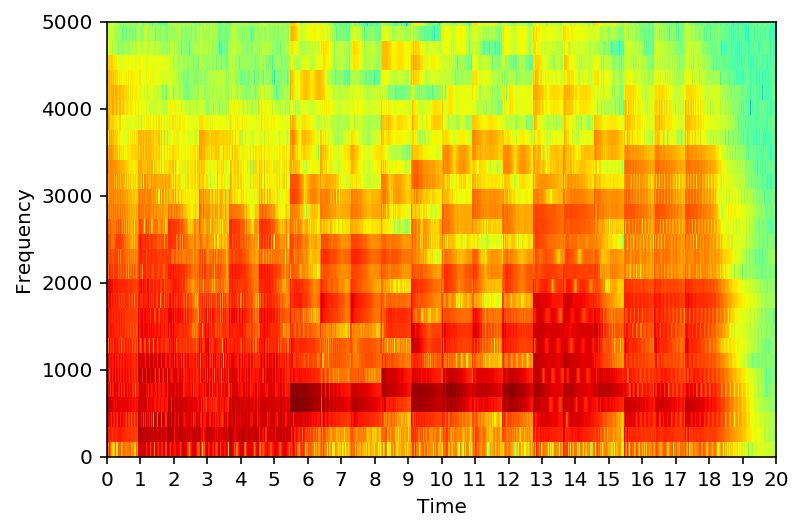

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-2.wav


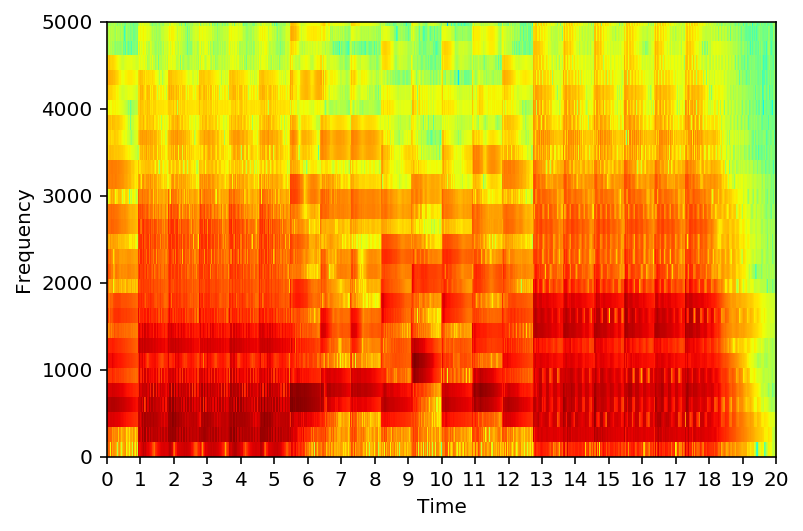

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-3.wav


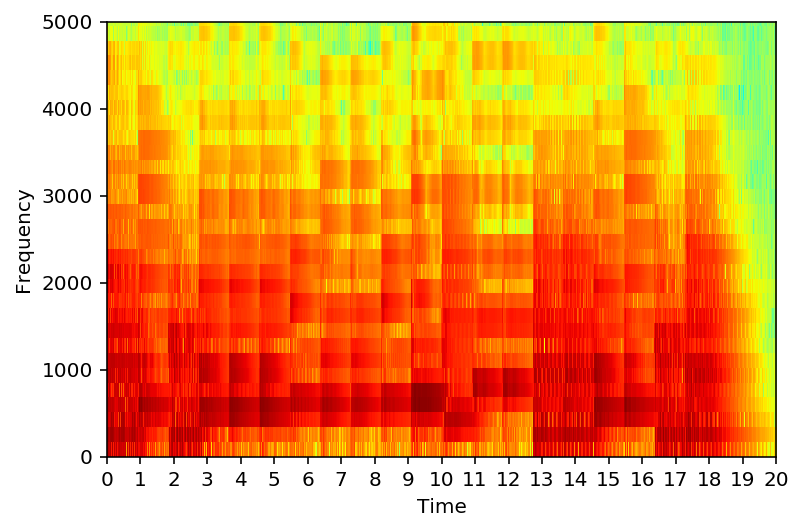

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-4.wav


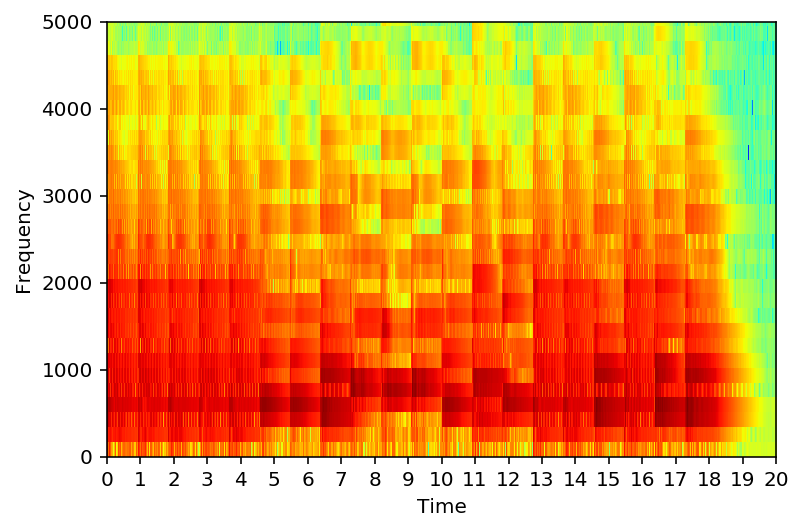

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-5.wav


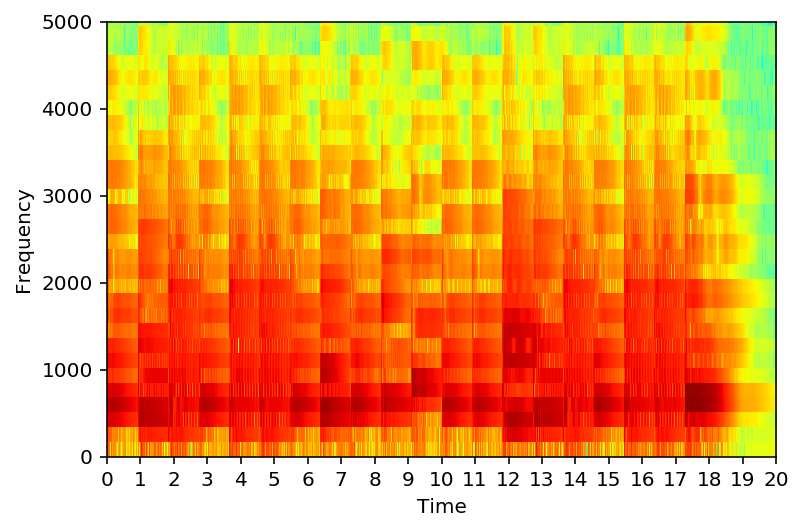

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-6.wav


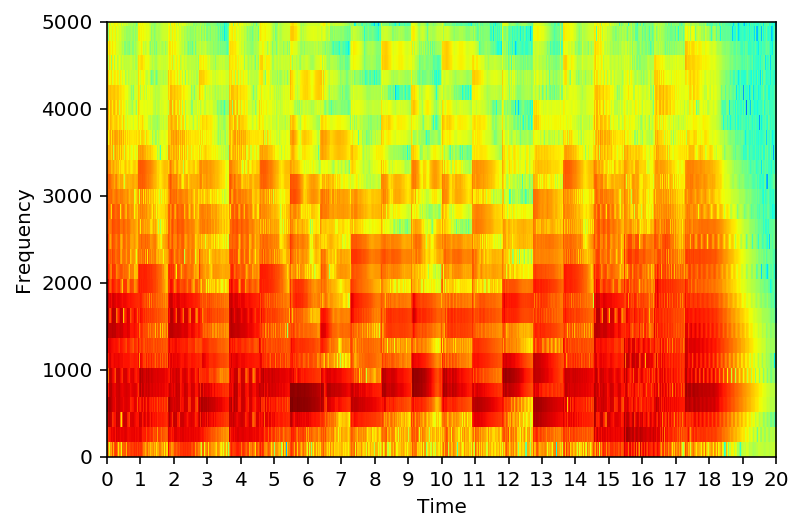

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-7.wav


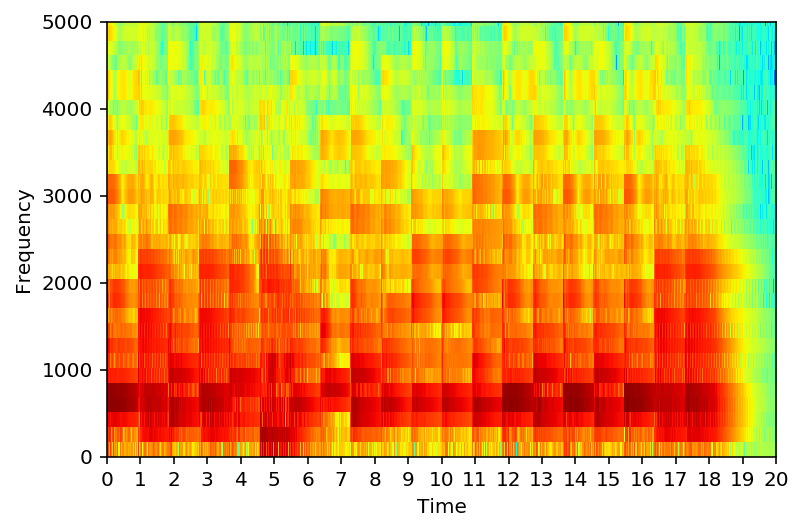

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-8.wav


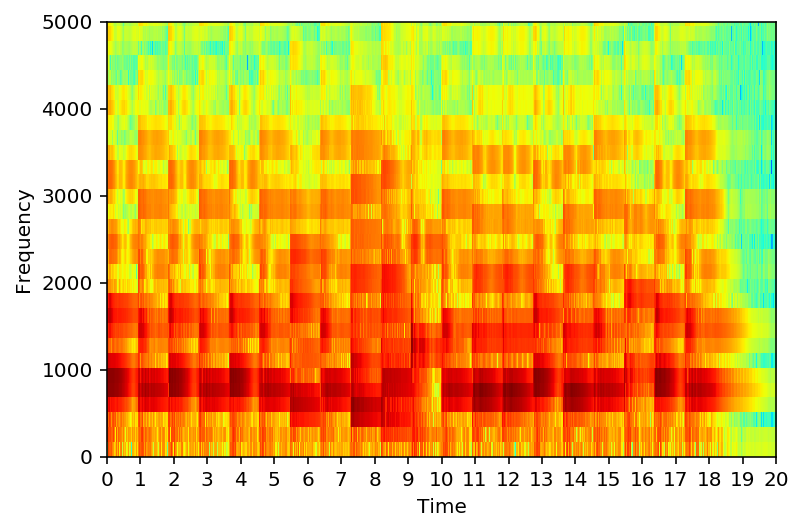

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-9.wav


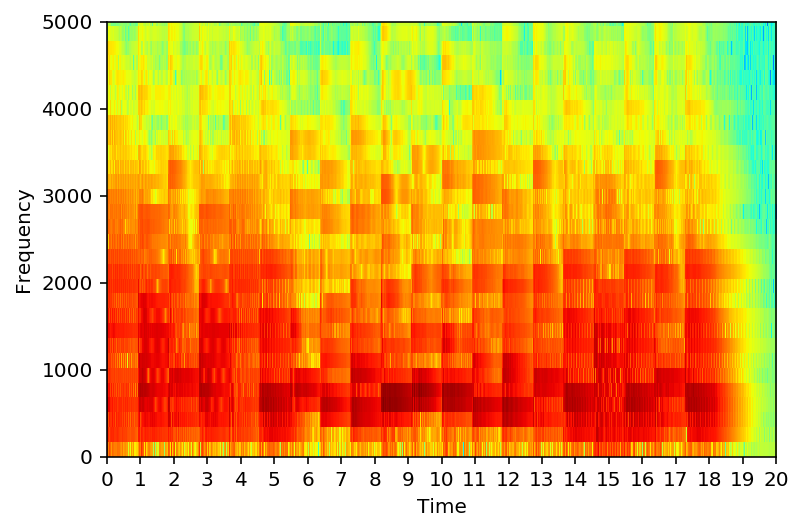

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-10.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-10.wav


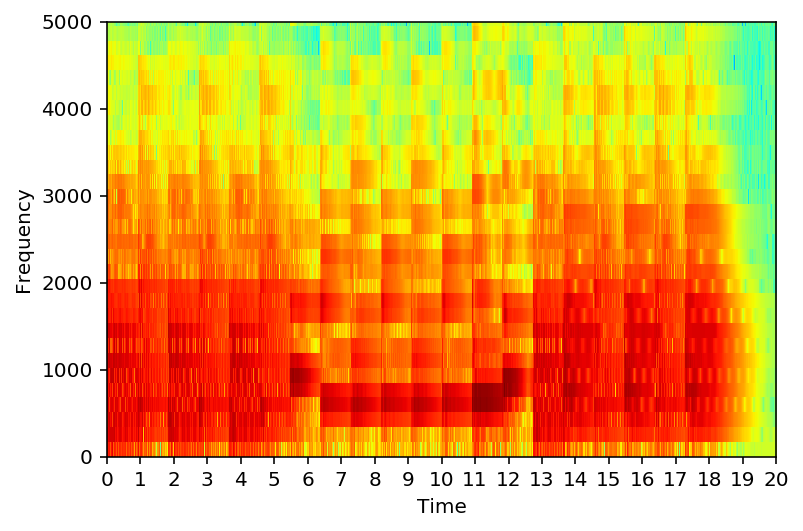

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-11.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-11.wav


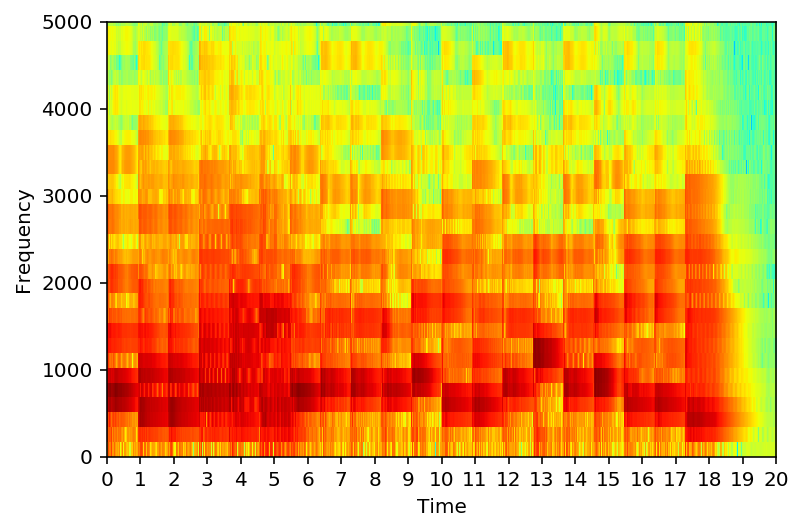

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-12.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-12.wav


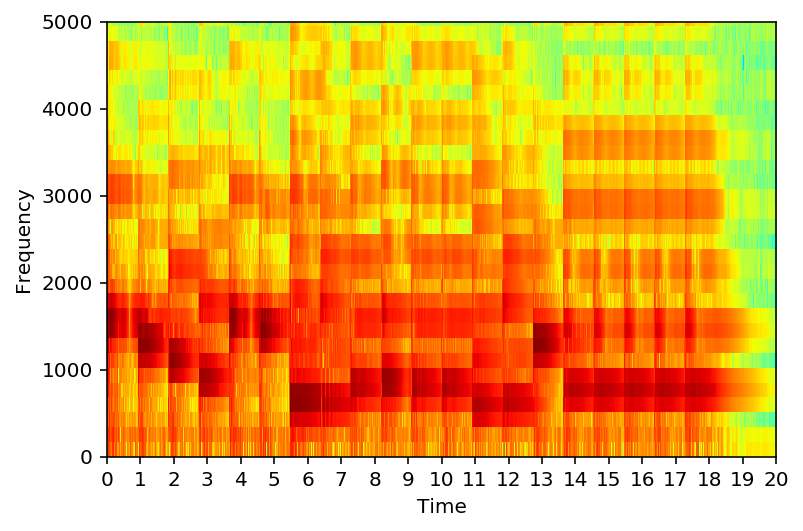

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-13.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-13.wav


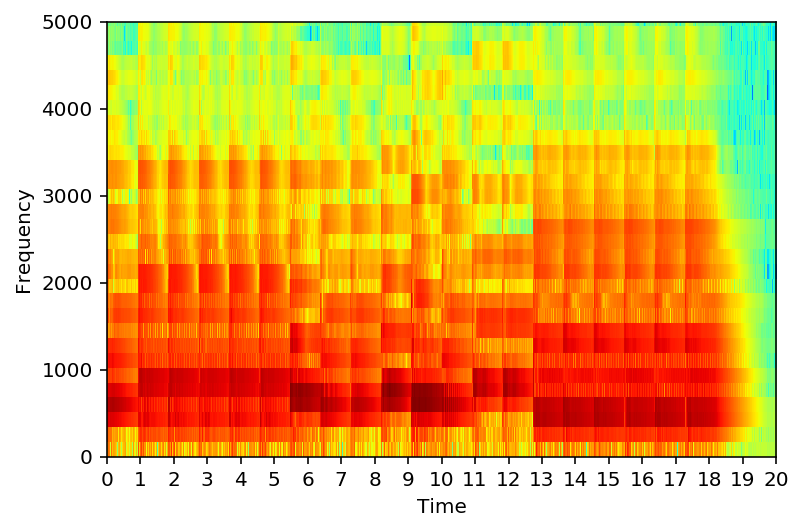

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-14.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-14.wav


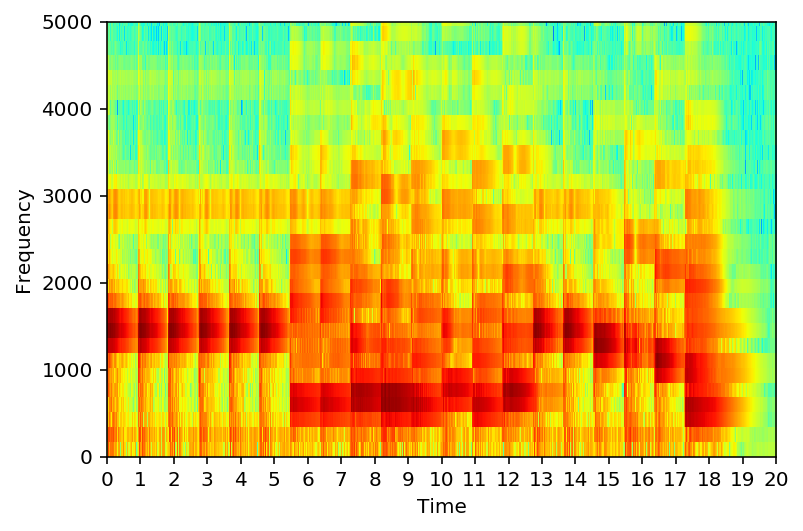

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-15.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-15.wav


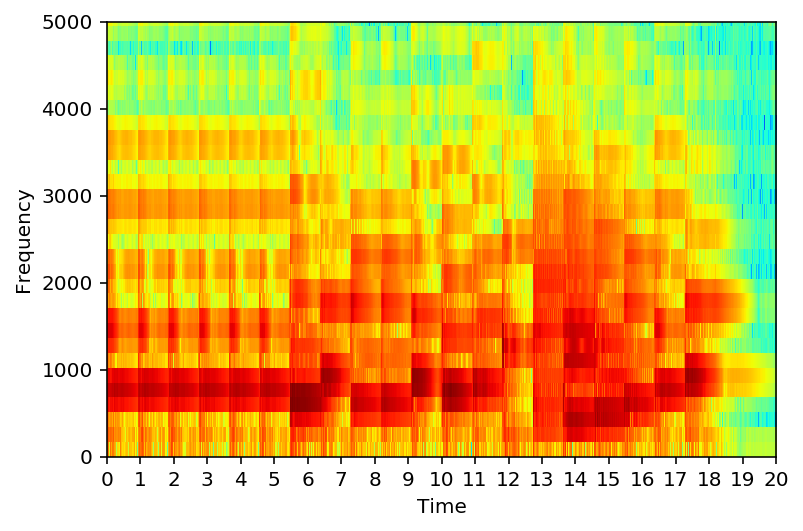

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-16.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-16.wav


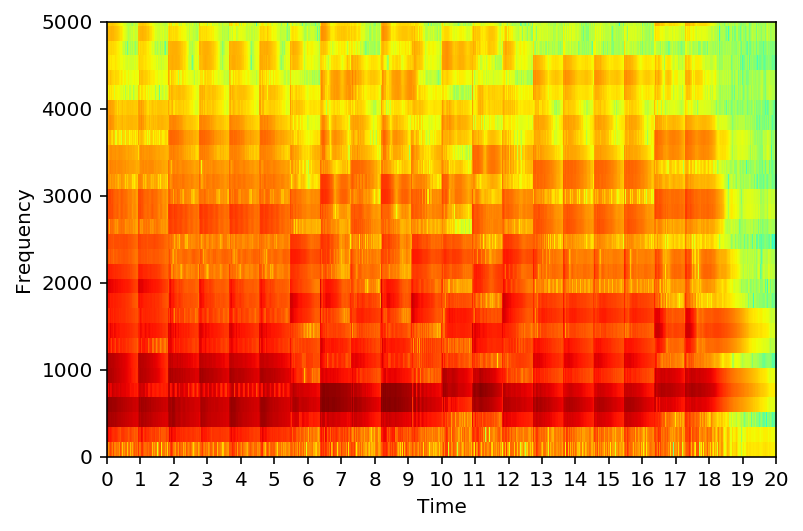

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-17.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-17.wav


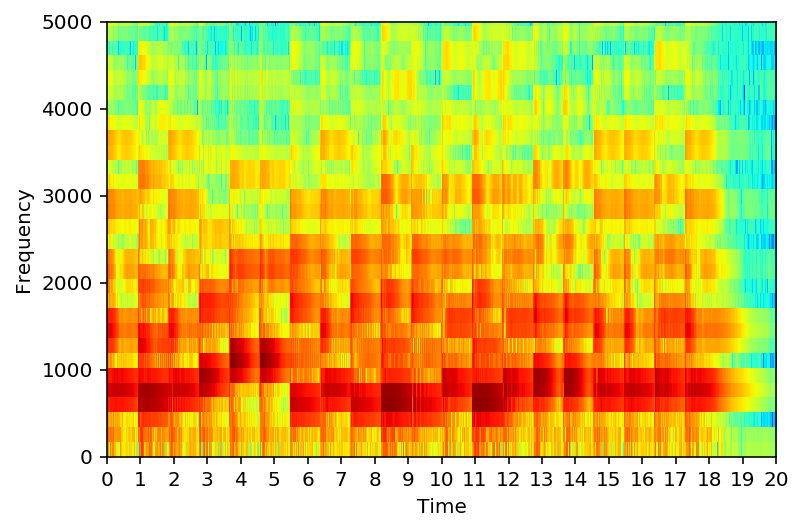

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-18.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-18.wav


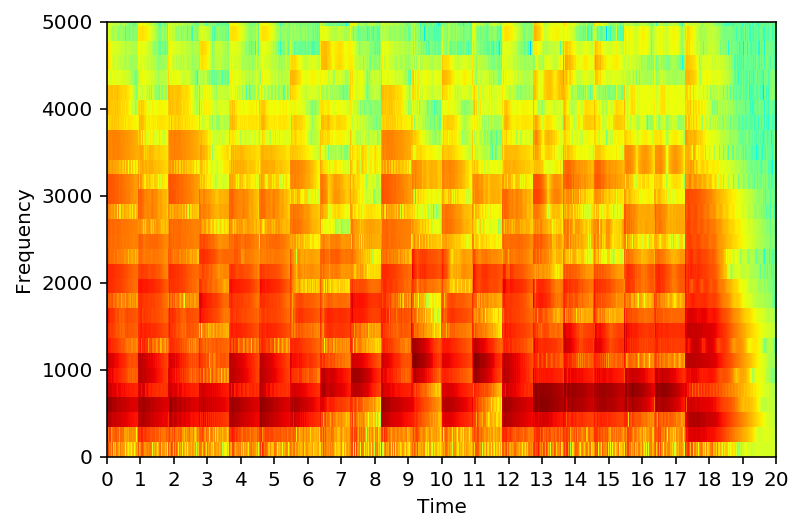

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-19.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/schubert/filled-19.wav


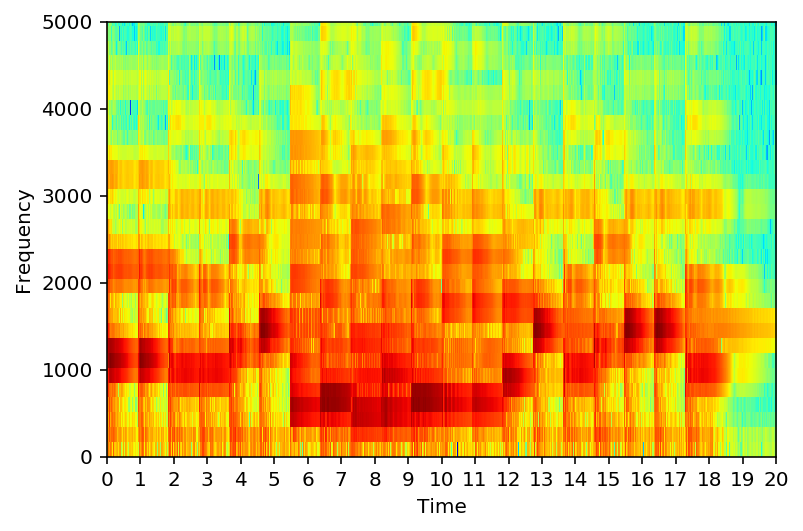

read ../../multi-model-musical-phrase-completion/maskgan-result/split/vivaldi/mono_orig.txt
F5 F5 F5 F5 F5 F5 B-5 B-5 B-5 B5 B5 B5 C5 C5 C5 C#5 C#5 C#5 C6 C6
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/vivaldi/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/vivaldi/orig-1.wav


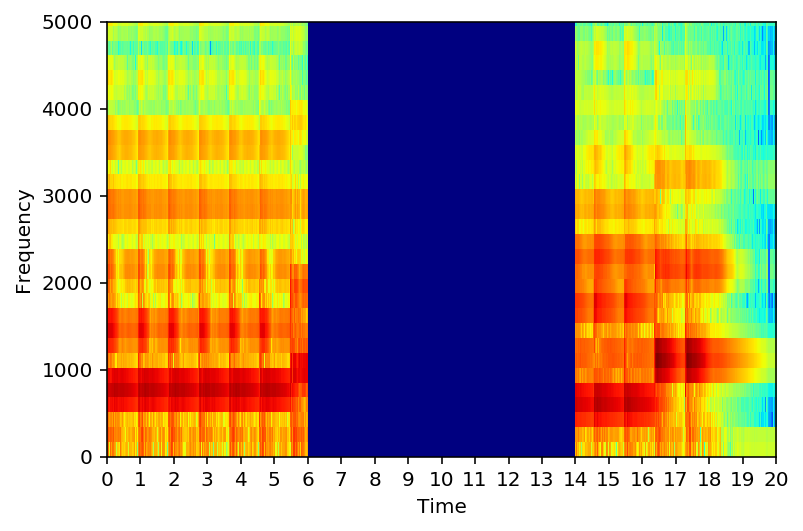

read ../../multi-model-musical-phrase-completion/maskgan-result/split/vivaldi/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/split/vivaldi/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/split/vivaldi/filled-1.wav


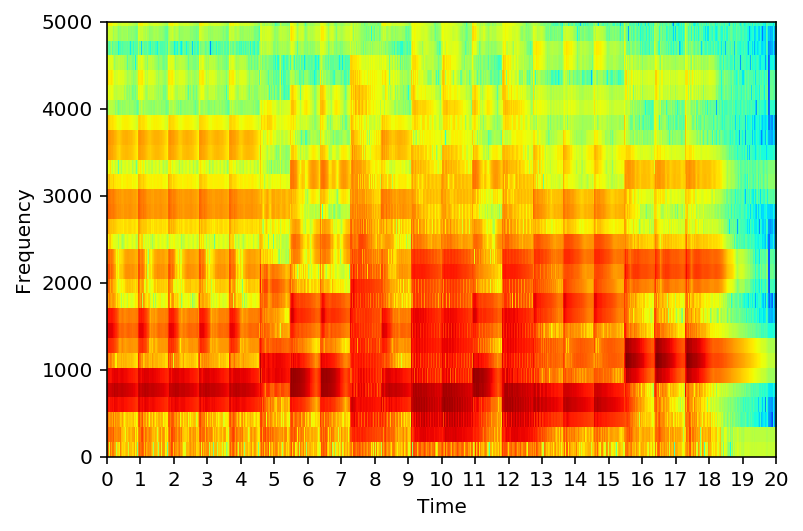

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/mono_orig.txt
C5 B4 B4 C5 B4 B4 B4 C5 C5 C5 C5 A4 A4 G4 G4 A4 B4 C5 B4 A4
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-1.wav


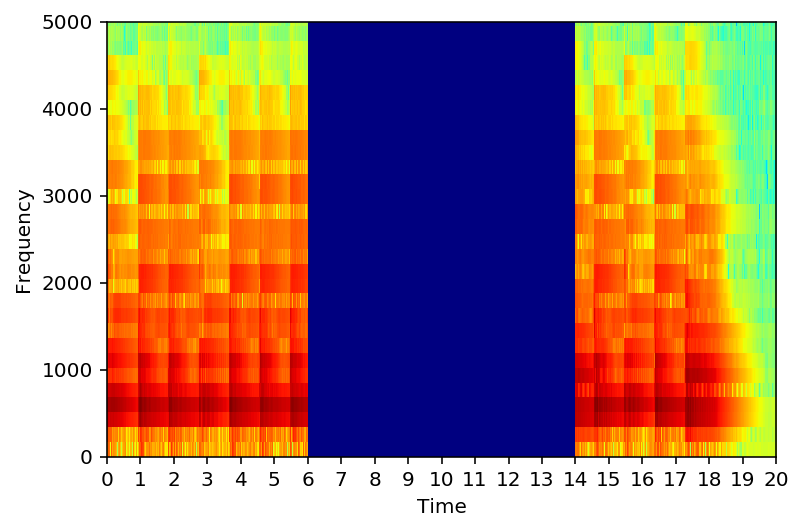

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-2.wav


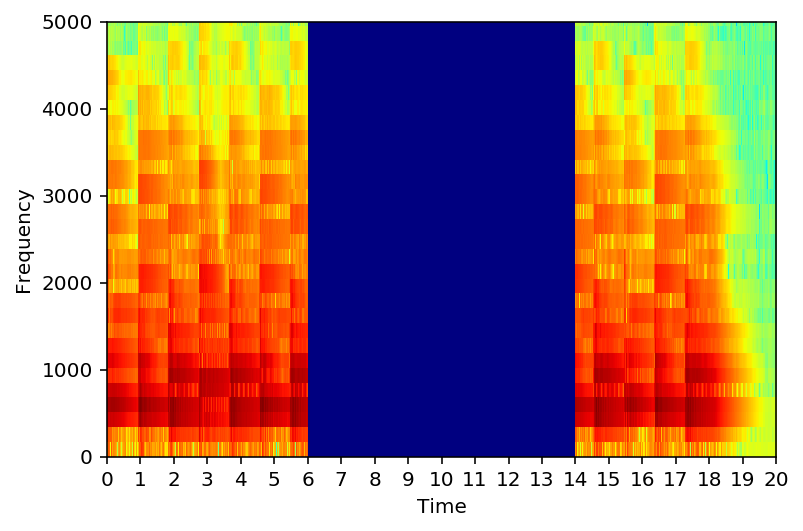

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-3.wav


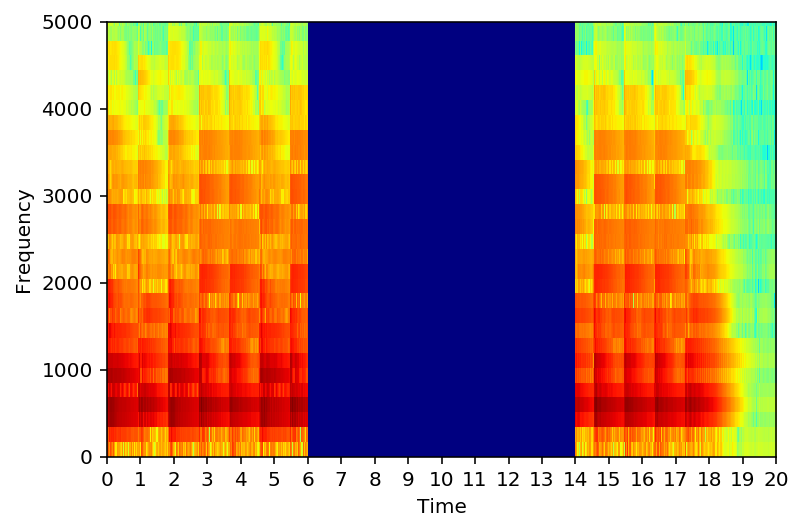

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-4.wav


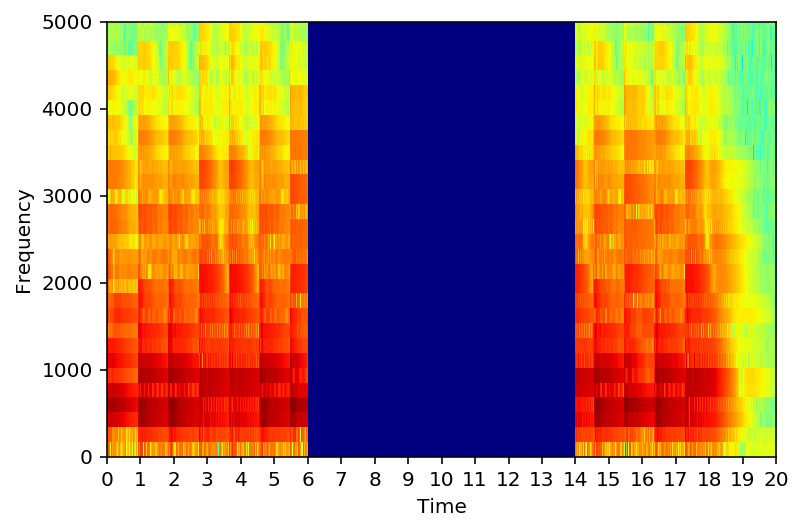

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-5.wav


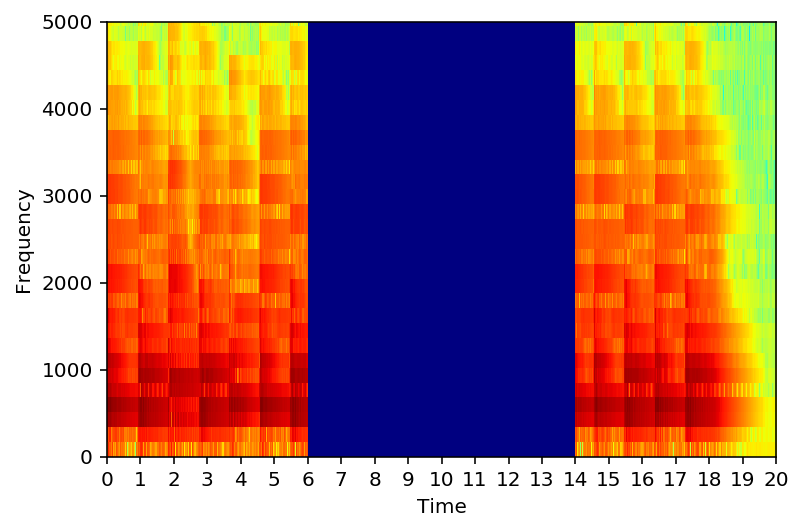

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-6.wav


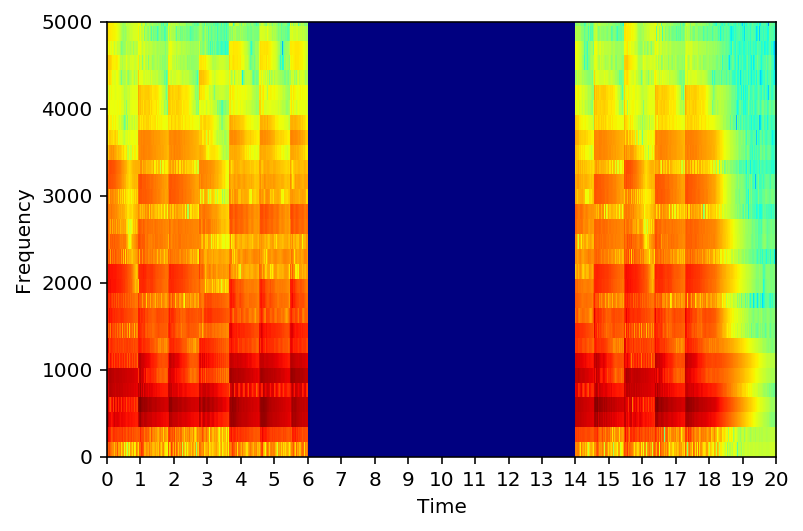

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-7.wav


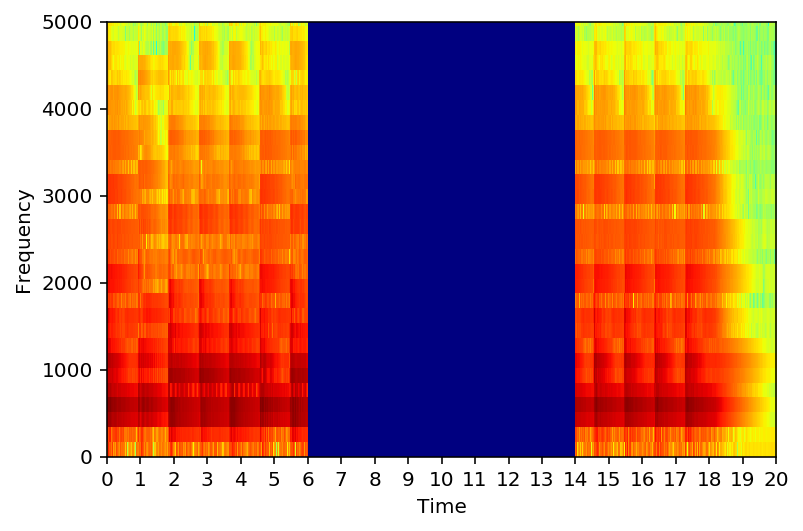

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-8.wav


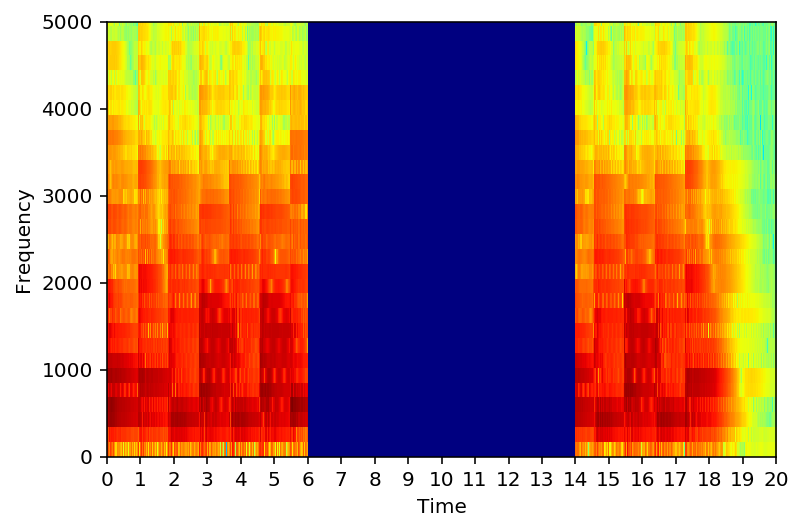

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/orig-9.wav


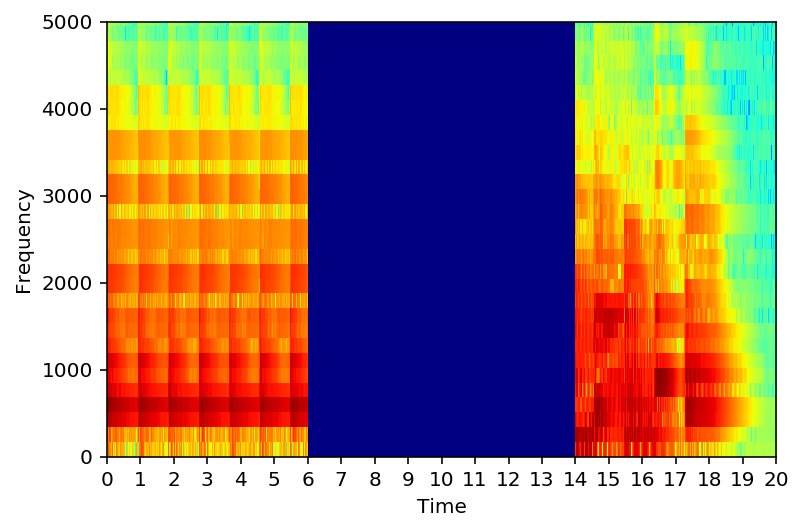

read ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/mono_filled.txt
Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-1.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-1.wav


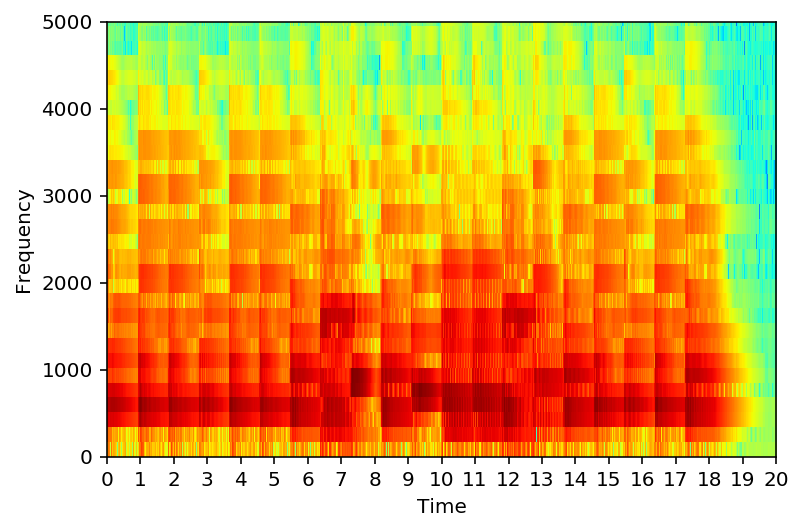

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-2.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-2.wav


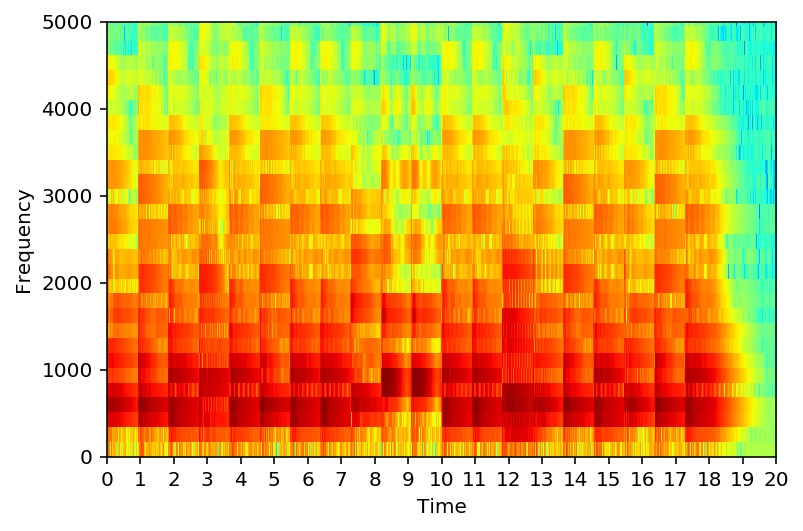

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-3.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-3.wav


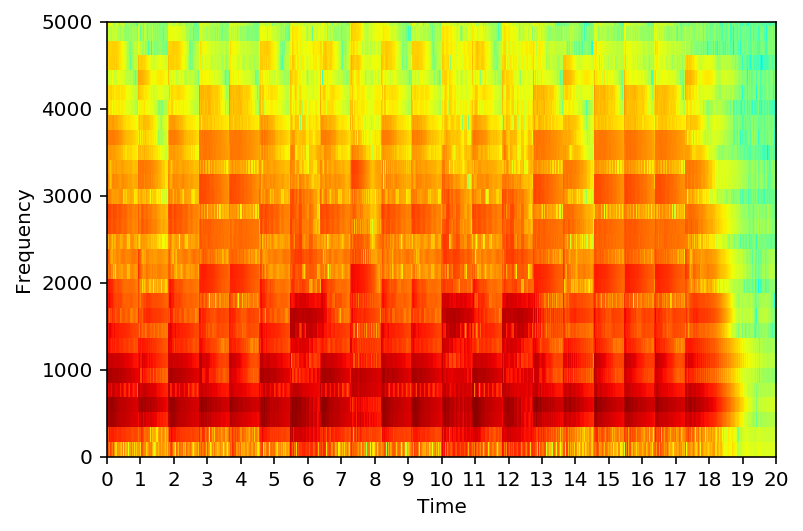

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-4.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-4.wav


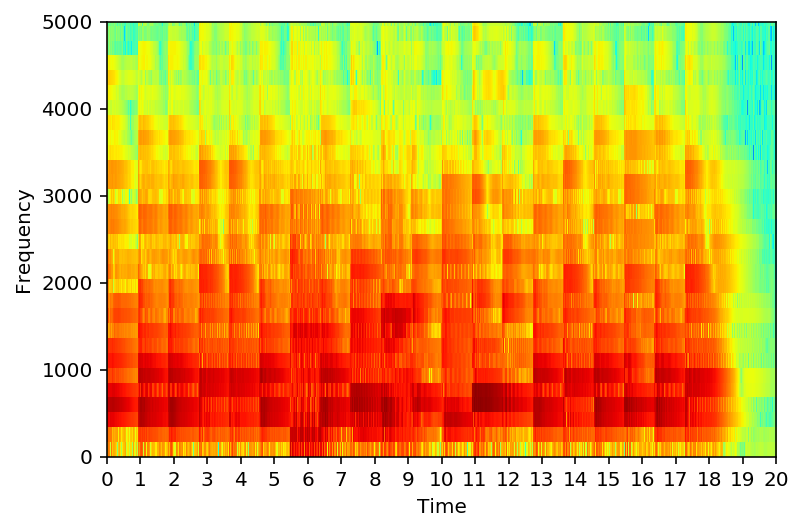

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-5.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-5.wav


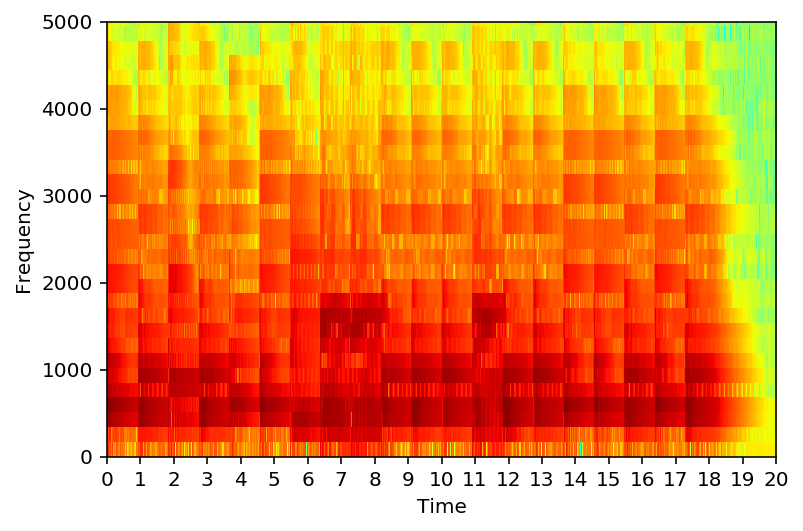

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-6.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-6.wav


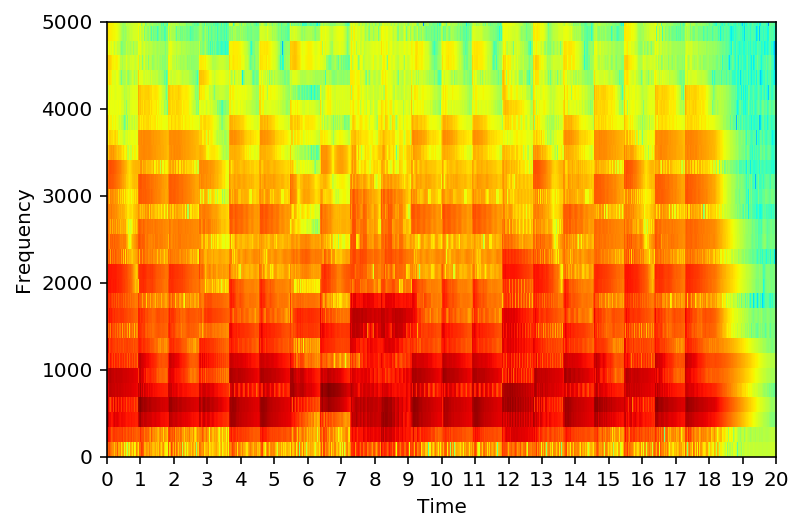

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-7.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-7.wav


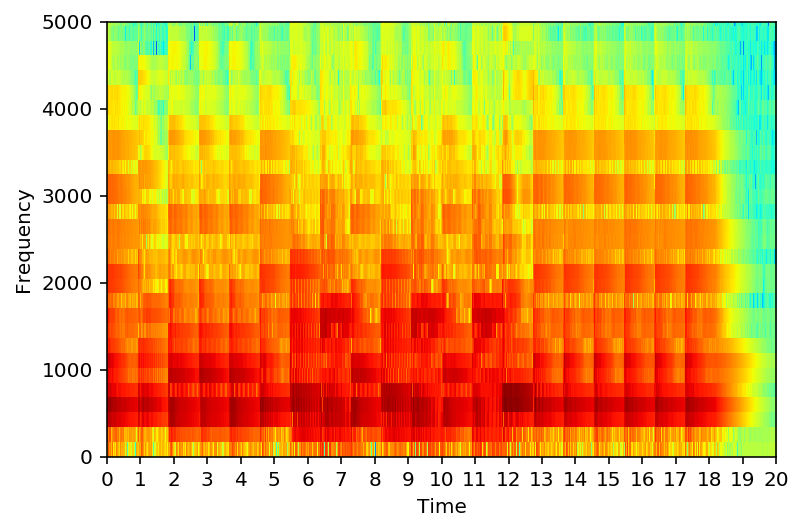

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-8.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-8.wav


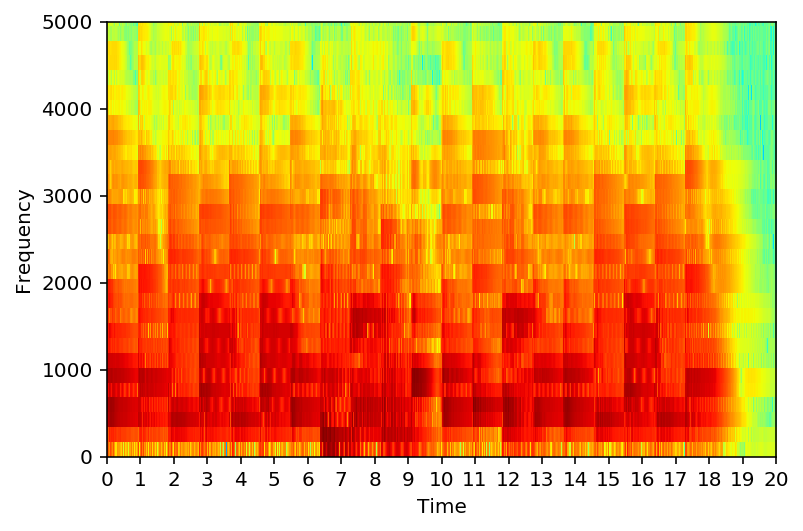

Created midi file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-9.mid
Created wav file  ../../multi-model-musical-phrase-completion/maskgan-result/holdout/vivaldi/filled-9.wav


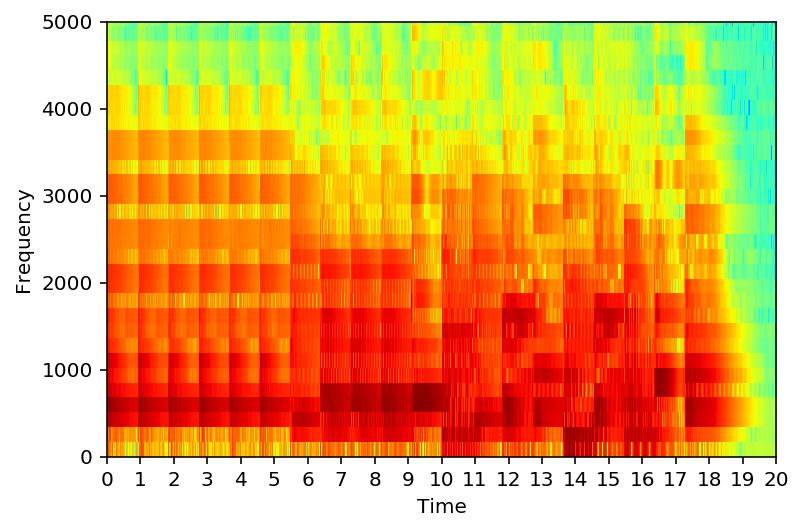

In [47]:
composers = ['bach','beethoven','brahms','haydn','handel','mozart','schubert','vivaldi']
#composers = ['vivaldi']
types = ['split','holdout']
for composer in composers:
    for typ in types:
        origNoteFile = './maskgan-result/' + typ + '/' + composer + '/mono_orig.txt'
        filledNoteFile = './maskgan-result/' + typ + '/' + composer + '/mono_filled.txt'
        specDir = './maskgan-result/' + typ + '/' + composer + '/'
        if not os.path.exists(specDir):
            os.makedirs(specDir)
    
        print('read ' + origNoteFile)
        contentLines = []
        with open(origNoteFile, 'r') as fp:
            content = fp.readline().strip()
            print(content)
            while content:
                contentLines.append(content)
                content = fp.readline().strip()
            convertToSpectrogram(contentLines, 'orig', specDir)

        print('read ' + filledNoteFile)
        contentLines = []
        with open(filledNoteFile, 'r') as fp:
            content = fp.readline().strip()
            while content:
                contentLines.append(content)
                content = fp.readline().strip()
            convertToSpectrogram(contentLines, 'filled', specDir)
